In [1]:
%load_ext autoreload
%autoreload 2

import time
import numpy as np

# Constants

In [2]:
sample_rate = 44100
hop_size = 441*2
hidden_mod = 3
maximum = 32
width = 4
ds_path = './datasets/VN/ds.pkl'
model_path = './models/VN/model08_'

# Data Class

In [3]:
import os
import re
import json
import math
import cv2
import subprocess as sp
from osr2mp4.EEnum.EReplay import Replays
from osr2mp4.osr2mp4 import Osr2mp4
import torch
import torchvision.io as vision
import torchvision.transforms as transforms

In [4]:
class OSR():
    def __init__(self, beatmap_dir, beatmap, sample_rate=44100, hop_size=441, hidden=False,
                 width=4,
                 tmp='./tmp', vtmp='./vid', atmp='./wav'):
        self.beatmap = beatmap
        self.beatmap_dir = beatmap_dir
        self.beatmap_path = os.path.join(self.beatmap_dir, self.beatmap)
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.rate = int(sample_rate / hop_size)
        self.fps = self.rate
        self.tmp = tmp
        self.vtmp = vtmp
        self.atmp = atmp
        self.width = 4
        self.hidden = hidden
        self.data_json = os.path.join(self.tmp, self.beatmap + '.json')
        hdn = 'hdn' if hidden else ''
        self.video_path = os.path.join(self.vtmp, self.beatmap + hdn + '.avi')
        
        self.replay_info = None
        self.osr2mp4 = None
        self.video = None
        self.hitobjects = None
        self.cursorstream = None
        self.timestamp = None
                
    def run_osr2mp4(self):
        d = json.load(open('data.json', 'r'))
        f = open(self.data_json, 'w')
        d['Beatmap path'] = self.beatmap_path
        if self.hidden is False:
            d['Skin path'] = './skin'
        else:
            d['Skin path'] = './skin_hidden'
        d['FPS'] = self.fps
        d['Output path'] = self.video_path
        json.dump(d, f)
        f.close()
                 
        self.osr2mp4 = Osr2mp4(filedata=self.data_json, filesettings='settings.json', filepp='ppsettings.json', 
                               filestrain='strainsettings.json', logtofile=True)
        while True:
            if self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_X] == 0 and self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_Y] == 0:
                self.osr2mp4.replay_info.play_data = self.osr2mp4.replay_info.play_data[0:-1]
            else:
                break
        
    def create_vid(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        cmd = ['python', 'create_vid.py', self.data_json]
        proc = sp.Popen(cmd)
        proc.wait()
        
    def parse_timings(self):
        if self.video is None:
            self.get_video()
        self.beat_len = []
        self.timestamp = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'BeatDivisor.*', l):
                self.BeatDivisor = int(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[TimingPoints\]', l):
                break
        for l in f:
            if l == "\n":
                break
            a = l.split(',')
            if float(a[1]) < 0:
                continue
            self.beat_len.append(float(a[1]))
            self.timestamp.append(float(a[0]))
        self.timestamp.append(int(self.video[1].shape[1] / self.video[2]['audio_fps'] * 1000))
        f.close()
    
    def parse_hitobjects(self):
        self.hitobjects = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'ApproachRate.*', l):
                AR = float(l.split(':')[1])
                if AR < 5.0:
                    preempt = 1200 + 600 * (5 - AR) / 5
                    fadein = 800 + 400 * (5 - AR) / 5
                else:
                    preempt = 1200 - 750 * (AR - 5) / 5
                    fadein = 800 - 500 * (AR - 5) / 5
                self.preempt = preempt - fadein*0.1
                break
        f.seek(0)
        for l in f:
            if re.match(r'SliderMultiplier.*', l):
                self.sliderMultiplier = float(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[HitObjects\]', l):
                break
        for l in f:
            self.hitobjects.append(l.split(','))
        f.close()
    
    def parse_beatmap(self):
        self.parse_timings()
        self.parse_hitobjects()
        
    def create_cursor_peak(self, y, i):
        alen = len(y)
        w = self.width/2/2
        
        def func(x):
            return math.exp(-j**2/w**2)
        
        j = 0 
        while i+j > 0 and abs(j) <= w*2:
            f = func(j)
            y[i+j][Replays.KEYS_PRESSED] = max(y[i+j][Replays.KEYS_PRESSED], f, 0)
            j -= 1
        j = 0
        while i+j < alen and abs(j) <= w*2:
            f = func(j)
            y[i+j][Replays.KEYS_PRESSED] = max(y[i+j][Replays.KEYS_PRESSED], f, 0)
            j += 1
    
    def process_beatobjects(self):
        pass
    
    def process_hitobjects(self):
        if self.hitobjects is None:
               self.parse_beatmap()
        self.hitobjStream = [None] * math.ceil(self.timestamp[-1] * 0.001 * self.rate)
    
    def process_clicks(self):
        pass
    
    def process_cursor(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        n = math.ceil((self.osr2mp4.replay_info.play_data[-1][Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)
        self.cursorstream = [None] * n
        #self.cursorstream = np.zeros((n, 3))
        
        for j in range(len(self.osr2mp4.replay_info.play_data) - 1):
            a = self.osr2mp4.replay_info.play_data[j]
            b = self.osr2mp4.replay_info.play_data[j+1]
            delta = (b[Replays.TIMES] - a[Replays.TIMES]) * 0.001 * self.fps
            xdist = b[Replays.CURSOR_X] - a[Replays.CURSOR_X]
            ydist = b[Replays.CURSOR_Y] - a[Replays.CURSOR_Y]
            stime = (a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps
            x = a[Replays.CURSOR_X]
            y = a[Replays.CURSOR_Y]
            
            e = np.array([0.0, 0.0, 0])
            if self.hidden is False:
                for t in range(math.ceil(delta)):
                    e[Replays.CURSOR_X] = x + xdist/delta*t
                    e[Replays.CURSOR_Y] = y + ydist/delta*t
                    self.cursorstream[int(stime + t)] = torch.tensor(e, dtype=torch.float)
            else:
                def f(x, dist):
                    if dist == 0:
                        return x
                    c = 20
                    o = dist/2
                    return o*2 * 1 / (1 + math.exp(-1 * c * (x - o) / o))
                for t in range(math.ceil(delta)):
                    e[Replays.CURSOR_X] = x + f(xdist/delta*t, xdist)
                    e[Replays.CURSOR_Y] = y + f(ydist/delta*t, ydist)
                    self.cursorstream[int(stime + t)] = torch.tensor(e, dtype=torch.float)
                
            e[Replays.KEYS_PRESSED] = a[Replays.KEYS_PRESSED]
            e[Replays.CURSOR_X] = a[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = a[Replays.CURSOR_Y]
            self.cursorstream[int((a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
            e[Replays.KEYS_PRESSED] = b[Replays.KEYS_PRESSED]
            e[Replays.CURSOR_X] = b[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = b[Replays.CURSOR_Y]
            self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
        
    def process_events(self):
        self.process_clicks()
        self.process_cursor()
        
    def read_video(self, scale=1):
        if not os.path.exists(self.video_path):
            self.create_vid()
        #self.video = vision.read_video(self.video_path)
        transform = transforms.ToTensor()
        frames = []
        vc = cv2.VideoCapture(self.video_path)
        while True:
            r, f = vc.read()
            f = cv2.resize(f, (0,0), fx=scale, fy=scale)
            frames.append(transform(f))
            if r is False:
                break
        return torch.stack(frames)
        
    def queue_vid(self):
        if not os.path.exists(self.video_path):
            self.create_vid()   
        return self.video_path
    
    def get_offset(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        return self.osr2mp4.replay_info.play_data[0][Replays.TIMES]
    
    def get_beatobjects(self):
        if self.beatobjStream is None:
            self.process_beatobjects()
        stream = [None] * len(self.beatobjStream)
        for i in range(len(self.beatobjStream)):
            if self.beatobjStream[i] == [] or self.beatobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.beatobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
        
    def get_hitobjects(self):
        if self.hitobjStream is None:
            self.process_hitobjects()
        stream = [None] * len(self.hitobjStream)
        for i in range(len(self.hitobjStream)):
            if self.hitobjStream[i] == [] or self.hitobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.hitobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
    
    def get_cursor(self):
        if self.cursorstream is None:
            self.process_events()
        return torch.stack(self.cursorstream)
        
    def get_video(self, scale=1):
        if self.video is None:
            self.read_video(scale=1)
        return self.video

# Dataset

In [5]:
import glob
import copy
import traceback
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset
import cv2
import matplotlib.pyplot as plt

In [6]:
class OSR_Dataset(Dataset):
    def __init__(self, beatmap_dir, sample_rate=44100, hop_size=441, seq_dur=10, scale=1, hidden_mod=0, maximum=100):
        self.beatmap_dir = beatmap_dir
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.seq_len = int(seq_dur * sample_rate / hop_size)
        self.hidden_mod = hidden_mod
        self.maximum = maximum
        self.scale = scale
        
        self.osrs = []
        
        if beatmap_dir is None:
            self.v = []
            self.c = []
            return
        
        j = 0
        def parse_beatmaps(j):
            for r, dirs, _ in os.walk(beatmap_dir):
                for dir in dirs:
                    for root, _, files in os.walk(os.path.join(r, dir)):
                        for f in files:
                            if re.match(r'.*osu$', f):
                                if self.hidden_mod == 0 or j % self.hidden_mod != 0:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size))
                                else:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size, hidden=True))
                                if j == self.maximum:
                                    return j
                                j += 1
            return j
        j = parse_beatmaps(j)
        
        self.v = [None] * j
        self.c = [None] * j
        
        def process(i):
            m = self.osrs[i]
            self.osrs[i] = None;
            try:
                print(str(i) + '/' + str(j-1), m.beatmap)
                self.v[i] = copy.deepcopy(m.queue_vid())
                self.c[i] = copy.deepcopy(m.get_cursor())
            except Exception as e:
                traceback.print_exc()
                print("pruning:", m.beatmap)
                self.v[i] = None
                self.c[i] = None
            del m
        
        list(map(process, range(j)))
        
        self.v = list(filter(lambda x: x is not None, self.v))
        self.c = list(filter(lambda x: x is not None, self.c))
        
    def take(self, ds, i, j):
        self.v = ds.v[i:j]
        self.c = ds.c[i:j]

    def __len__(self):
        return len(self.v)

    def __getitem__(self, i):
        if self.seq_len == 0:
            return None
        
        transform = transforms.ToTensor()
        j = np.random.randint(0, self.c[i].shape[0] - self.seq_len)
        vc = cv2.VideoCapture(self.v[i])
        vc.set(cv2.CAP_PROP_POS_FRAMES, j)
        #for k in range(j):
        #    _, _ = vc.read()
        
        f = [None] * self.seq_len
        for k in range(self.seq_len):
            frame = vc.read()[1]
            frame = cv2.resize(frame, (0,0), fx=self.scale, fy=self.scale)
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            f[k] = transform(frame)
        
        c = self.c[i][j: j+self.seq_len]
        cy = torch.div(c[:,Replays.CURSOR_Y], 384) #, dtype=c.type())
        c[:,1] = torch.div(c[:,Replays.CURSOR_X], 512) #, dtype=c.type())
        c[:,0] = cy
        
        return (torch.stack(f), c) #self.c[i][j: j+self.seq_len])256

# Testing

In [7]:
ds = OSR_Dataset('../ex/beatmaps', sample_rate=44100, hop_size=441*2, hidden_mod=0, maximum=1)

0/0 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu


(600, 1024, 3)
tensor(0.5409) tensor(0.5290)
(263, 158)


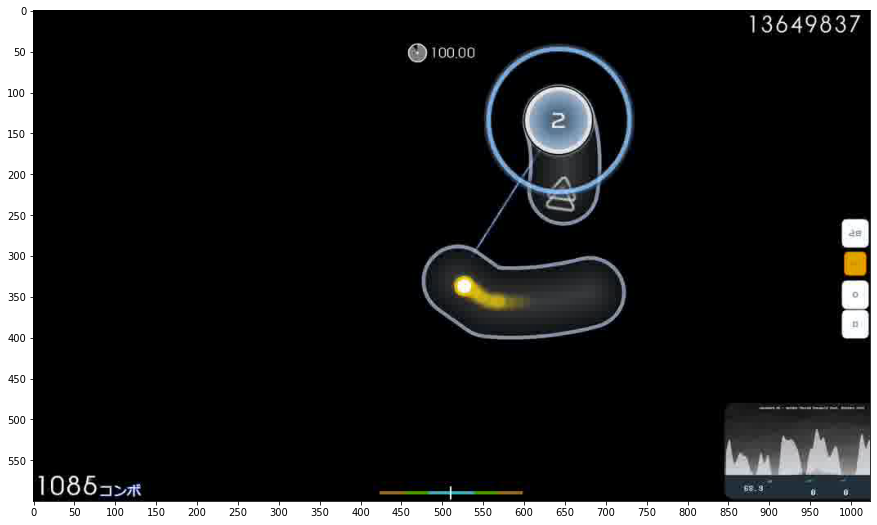

In [19]:
import matplotlib.pyplot as plt

import op

op.h = 600 / 2
op.w = 1024 / 2
op.calratio()

e = s[0]
print(e[0][0].permute(1, 2, 0).numpy().shape)

plt.rcParams["figure.figsize"] = (15, 15)

plt.xticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[1], 50))
plt.yticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[0], 50))

plt.imshow(cv2.cvtColor(e[0][0].permute(1, 2, 0).numpy(), cv2.COLOR_BGR2RGB))
print(e[1][0][1], e[1][0][0])
print(op.cor(e[1][0][1] * 512, e[1][0][0] * 384))
#print(op.cor(e[1][0][1], e[1][0][0]))
#for x in e[1][0:10]:
    #print(op.cor(x[0], x[1]))

# Process Data

In [7]:
import time

In [7]:
ds = OSR_Dataset('../beatmaps', sample_rate=sample_rate, hop_size=hop_size, hidden_mod=1, maximum=256)

0/255 Chata - Engage (Lasse) [Insane].osu
1/255 Mimi - Surrealism (feat. ZAT) (-Tatsuo) [no mania].osu
2/255 sana - kanojo wa tabi ni deru (Firika) [Insane].osu
3/255 Ishida Youko - To the Promised Sky ~The place that I was~ (caren) [Collabo].osu
4/255 StylipS - Prism Sympathy(Asterisk Remix) (iMage--) [Kaleid Liner].osu
5/255 Cranky - Chandelier - King (Mao) [Gero's Insane].osu
6/255 senya - Akatsuki no Suiheisen ni (Satellite) [Zweib's Insane].osu
7/255 Tadokoro Azusa - 1HOPE SNIPER (Sotarks) [NiNo's Insane].osu
8/255 fripSide - future gazer (TV Size) (alacat) [Insane].osu
9/255 cYsmix - bells! (Gero) [normal!].osu
10/255 Yazawa Nico (CV.Tokui Sora) - Nicopuri Joshidou (yf_bmp) [z1085684963's Insane].osu
11/255 Hamburgaga - Watame Internet Connection Race (CE6A) [Insane].osu
12/255 xi - Parousia -LAST JUDGMENT- (Zapy) [Retribution].osu
13/255 Shiena Nishizawa - Meaning (Taeyang) [xChippy's Insane].osu
14/255 namirin - Hitokoto no Kyori (sahuang) [Linadeft's Insane].osu
15/255 Narushi

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 7482 in argument 0, but got NoneType


pruning: Fujijo Seitokai Shikkou-bu - Best FriendS (sahuang) [N a s y a's Insane].osu
60/255 Omoi - Chiisana Koi no Uta (Synth Rock Cover) (val0108) [Marianna's Insane].osu
61/255 Natsumi Kiyoura - Tabi no Tochuu (Weinmagier) [Normal].osu
62/255 Nico Nico Douga - U.Nknown Goose (Borokuzu) [Insane].osu
63/255 Hatsune Miku - Moon (Saten ruiko) [Insane].osu
64/255 fripSide - black bullet (TV Size) (Chloe) [Insane].osu
65/255 Hatsune Miku - the last effect (Holoaz) [ringloid].osu
66/255 Gojou Kai - Touhou Youkai Komachi (James) [Normal].osu
67/255 REOL - Hibikase (Gero) [NiNo's Insane].osu
68/255 Kuba Oms - My Love (W h i t e) [Insane].osu
69/255 Yasuo - P - Electric Angel (- Ruby Rose -) [Insane].osu
70/255 Shimotsuki Haruka, Suzuyu - Fairy Wreath (ImpurePug) [Angraecum].osu
71/255 ClariS - Connect (TV Size) (browiec) [Mathew's Insane].osu
72/255 DIVELA feat. Hatsune Miku - BEAT SYNCER (Log Off Now) [Insane].osu
73/255 The Quick Brown Fox - The Big Black (Blue Dragon) [WHO'S AFRAID OF THE

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 6527 in argument 0, but got NoneType


75/255 toby fox - Nyeh Heh Heh! & Bonetrousle (DaxMasterix) [NORMAL].osu
76/255 ryo (supercell) - ODDS&ENDS (Short Ver.) (Betsuto) [Insane].osu
77/255 TRakker - Trail of Dust (Amamiya Yuko) [Trail of Star].osu
78/255 Police Piccadilly feat. Hatsune Miku - Kire Carry On (Sinnoh) [negusver's Insane].osu
79/255 MOSAIC.WAV - Zen Sekai Teki Touch Panel (Laurier) [CrystLer].osu
80/255 Aiobahn & Yunomi - Makuramoto ni Ghost (feat. Nicamoq) (Swan) [Swan's Melanzana].osu
81/255 Camellia - Routing (Shiirn) [pishi's Advanced].osu
82/255 seleP feat. Lily - Chloe-Five Decades Ago- (Duftende Pizza) [V].osu
83/255 dj TAKA - quaver (Monstrata) [Haru's Insane].osu
84/255 Silver Forest Feat. Aki & Sakura Mayuko - Summer time Heaven -after (RVMathew) [Ojou].osu
85/255 Van Darkholme - GachiMuchi circulation (Kr0n0s23) [Thank you, sir!].osu
86/255 Ariabl'eyeS - Senkou no Furea (Kibbleru) [Redemption].osu
87/255 ATeens - Gimme! Gimme! Gimme! (Nightcore Mix) (ShadowSoul) [Gimme!].osu
88/255 Tomoe Tamiyasu - 

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 512 in argument 0, but got NoneType


pruning: Tomoe Tamiyasu - Yamato Nadeshiko Hanakotoba (Lasse) [Insane].osu
89/255 Masayoshi Minoshima ft. nomico - Bad Apple!! (Ephemeral) [Normal].osu
90/255 solfa feat. Shimotsuki Haruka - Natsuiro Ramune (Lasse) [Bariton's Insane].osu
91/255 Nakagawa Shouko - Sorairo Days (Rizen) [Fizz's Insane].osu
92/255 LeaF - Calamity Fortune (Arphimigon) [BOOM].osu
93/255 cillia - Fairytale, (SkinnyJommy) [Pho's Insane].osu
94/255 Lindsey Stirling - Senbonzakura (MrSergio) [Insane].osu
95/255 Hatsune Miku - Senkouhanabi Aika (val0108) [Insane].osu
96/255 Hatsune Miku - Himitsu Keisatsu (Lalarun) [Insane].osu
97/255 MISATO - Necro Fantasia (WORSTPOLACKEU) [Cheesecake's Insane].osu
98/255 a_hisa - Cheshire,s dance (Muya) [Normal].osu
99/255 Roselia - The Everlasting Guilty Crown (Underdogs) [Insane].osu
100/255 40meter-P - Mousou sketch (Noways) [Insane!].osu
101/255 sasakure.UK x DECO27 - 39 (Finshie) [Insane].osu
102/255 Chata - len (Cami) [xiqingwa's Lunatic].osu
103/255 Fractal Dreamers - Fat

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


121/255 Sawai Miku - Colorful. (Asterisk DnB Remix) (Asfand) [Vibrant].osu
122/255 Yunomi & nicamoq - Indoor Kei Nara Trackmaker (dipperbee) [TrAcK MaKeR].osu
123/255 GTA feat. Sam Bruno - Red Lips (Mendus Remix) (Euny) [Natsu's Insane].osu
124/255 TrySail - Utsuroi (Short Ver.) (Log Off Now) [Nexus' Insane].osu
125/255 ZAQ - Seven Doors (eINess) [wkyik's Insane].osu
126/255 M2U - Stellar (Ultima Fox) [defiance's Insane].osu
127/255 SawanoHiroyuki[nZk]mizuki - aLIEz (jonathanlfj) [Trust's Normal].osu
128/255 YOASOBI - Yoru ni Kakeru (Petal) [Keirelia's Insane].osu
129/255 Usada Pekora - Discommunication Alien (Yugu) [XLT's Insane].osu
130/255 EastNewSound - Sadistic Paranoia (TicClick) [Vass-RJ's Hard].osu
131/255 Sound Souler - Paradise (kwk) [Mir's Insane].osu
132/255 Hatsune Miku - Subarashii Sekai (val0108) [Insane].osu
133/255 AAAA - carnation (Veridian) [noffy's normal].osu
134/255 Kamogawa rokkaazu (CVKubota Kaoru) - STONES (Pata-Mon) [GDInsane [placeholder]].osu
135/255 UNISON 

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


175/255 petit milady - Koi wa Milk Tea (Okoratu) [Normal].osu
176/255 Dark PHOENiX - Taketori Hishou (KanbeKotori) [Extra].osu
177/255 Mili - Origin (TV Size) (Ryuusei Aika) [kanor's Insane].osu
178/255 Hanataba - Night of Knights (v2b) [Normal].osu
179/255 Sagara Kokoro - Hoshizora no Ima (Star Stream) [Insane].osu
180/255 Hanatan - Uta ni Katachi wa Nai keredo (Asahina Momoko) [Recollection].osu
181/255 PinocchioP - SLoWMoTIoN (Short Ver.)feat.Hatsune Miku (lllmtklll) [Insane].osu
pruning: PinocchioP - SLoWMoTIoN (Short Ver.)feat.Hatsune Miku (lllmtklll) [Insane].osu
182/255 Yoko Takahashi - Zankoku Na Tenshi No These (TV. Size Version) (moph) [Ambient's Insane].osu
183/255 Noboru ft. Hatsune Miku - Shiroi Yuki No Princess Wa (Hokichi) [ShiraHoki's Light Insane].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


184/255 Chitose Sara - Arcadia (Short ver.) (Riven) [-Tochi's Insane].osu
185/255 eyemedia - Bloody Purity (tsuka) [Normal].osu
pruning: eyemedia - Bloody Purity (tsuka) [Normal].osu
186/255 Atoguru - Itoshi Kimi wo Mitsuke ni (Pizza Kun) [Insane].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


187/255 Hanasaka Yui(CV M.A.O) - Harumachi Clover (Naotoshi) [Light Insane].osu
188/255 Hatsune Miku - Ephemeral (Wishkey) [Fade Away].osu
189/255 emon - shake it! (kosiga) [Normal].osu
190/255 Suzuki Konomi - This game (TV Size) (Sekai-nyan) [Nyquill's Insane Game].osu
191/255 Warak - REANIMATE (iyasine) [xsrs's Extra].osu
192/255 Noriko Mitose - The Party of Seven Witches (Kibbleru) [Dereliction].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


pruning: Noriko Mitose - The Party of Seven Witches (Kibbleru) [Dereliction].osu
193/255 Kuroneko Dungeon - Ryoushi no Umi no Lindwurm (Crystal) [ak74's Insane].osu
194/255 Feint - Reprise (Secretpipe) [Sieg's Light Insane].osu
195/255 Umetora - Ifuudoudou (Nymph) [Insane].osu
196/255 Hana - Kuukirikigaku Shoujo to Shounen no Uta (Soleily Remix) (Koiyuki) [Yuki].osu
197/255 wowaka - Unknown Mother-Goose feat. Hatsune Miku (tutuhaha) [Insane].osu
198/255 Megurine Luka - LukaLuka Night Fever (samipale) [Normal+].osu
199/255 paraoka feat. harunya & amane - Trickstar (lahphnya) [Insane].osu
200/255 Silver Forest - PORUTA ~ gaisuto no himatsubushi (Eirene) [Normal].osu
201/255 rerulili - Noushou Sakuretsu Girl (NatsumeRin) [dksslqj Style].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


pruning: rerulili - Noushou Sakuretsu Girl (NatsumeRin) [dksslqj Style].osu
202/255 Yooh - MariannE (Yogurtt) [Extra].osu
203/255 Various Artists - IIDX collection (N a s y a) [V3].osu
204/255 CHiCO with HoneyWorks - Heart no Shuchou (Sotarks) [Yuitarks' Insane].osu
205/255 Demetori - Fall of Fall ~ The Door Into Summer (jonathanlfj) [Extra Stage].osu
206/255 u's - Baby Maybe Koi no Button (Asterisk DnB Remix) (jeydude) [Love Live!].osu
207/255 ALTIMA - Burst The Gravity (TV Size) (bes_joker) [Insane].osu
pruning: ALTIMA - Burst The Gravity (TV Size) (bes_joker) [Insane].osu
208/255 Chiyoko - Baby Fantastic! -Short ver.- (Zweib) [iMage's Insane].osu
209/255 Apocalyptica - Rage of Poseidon (pishifat) [Extreme].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


210/255 fripSide - snow blind -after- (Mordred) [Tears Like Snowflakes].osu
211/255 ryo (supercell) feat.Hatsune Miku - Tsumi no Namae (Monstrata) [Blooming].osu
212/255 Uehara Rena - Todokanai Koi '13 (TV EDIT) (Sellenite) [Rewrite].osu
213/255 Giga-P - LUVORATORRRRRY! (Selisi) [Insane].osu
214/255 Barbarian On The Groove feat. Takizawa Ichiru - Yoi ni Kanawazu (Shurelia) [Hard].osu
215/255 livetune feat.Hatsune Miku - Last Night, Good Night (Autumn) [Oyasumi].osu
216/255 MiddleIsland - Achromat (zxhzxhz) [Insane].osu
217/255 Tamura Yukari - MERRY MERRY MERRY MENU... Ne! (moonlightleaf) [wkyik's Insane].osu
218/255 Dreamcatcher - YOU AND I (Natsu) [Insane].osu
219/255 M2U - Dual Fractal (Hailie) [Insane].osu
220/255 EGOIST - Namae no Nai Kaibutsu (LunarSakuya) [lfj's Insane].osu
221/255 ginkiha - dawn(ginkiha hardcore remix) (Aka) [Kyubey's Insane].osu
222/255 seleP - Remember me (Avishay) [A's Extra].osu
223/255 Kano - Stella-rium (Kowari) [Insane].osu
224/255 IOSYS - Hakurei Jinja (

In [8]:
start = time.time()

torch.save(ds, ds_path)

end = time.time()
print(end - start, 'secs')

0.0817873477935791 secs


# Load Daaset

In [21]:
ds = torch.load(ds_path)

# Model

In [8]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as nnF

from attention.attention import SpatialAttn, ProjectorBlock

In [9]:
class VN(nn.Module):
    def __init__(self, dim_in, device):
        super(VN, self).__init__()
        
        self.device = device
        self.lstmA_size = 256
        self.lstmA_layers = 2
        self.dim_out = 2
        
        #self.convA1 = nn.Conv3d(1, 1, (3, 1, 1), stride=1, padding=0)
        self.convB1 = nn.Conv2d(1, 4, 3, stride=1, padding=1) 
        self.maxPB1 = nn.MaxPool2d(3, stride=2, padding=1)

        self.convC1 = nn.Conv2d(4, 8, 3, stride=1, padding=1) 
        self.maxPC1 = nn.MaxPool2d(3, stride=2, padding=1)
        
        #self.linear1 = nn.Linear(19456, 1024)
       
        self.lstmA = nn.LSTM(19456, hidden_size=self.lstmA_size, num_layers=self.lstmA_layers,
                             batch_first=True, bidirectional=False)
        self.linearA = nn.Linear(self.lstmA_size, self.lstmA_size)
        self.normA = nn.LayerNorm(self.lstmA_size)
        self.linearB = nn.Linear(self.lstmA_size, 32)
        self.normB = nn.LayerNorm(32)
        self.linearC = nn.Linear(32, self.dim_out)
        
        self.hiddenA = None
        
    def _make_layer(self, in_features, out_features, blocks, pool=False):
        layers = []
        for i in range(blocks):
            conv2d = nn.Conv2d(in_channels=in_features, out_channels=out_features, kernel_size=3, padding=1, bias=False)
            layers += [conv2d, nn.BatchNorm2d(out_features), nn.ReLU(inplace=True)]
            in_features = out_features
            if pool:
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
        return nn.Sequential(*layers)
        
    def init_hidden(self, batch_size):
        h = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        c = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        self.hiddenA = (h, c)
 
    def forward(self, x):
        s = x.shape
        x = torch.reshape(x, (s[0] * s[1], s[2], s[3], s[4]))
        
        #x = x.unsqueeze(1)
        #x = self.convA1(x)
        #x = nnF.relu(x)
        #x = x.squeeze(1)
        x = self.convB1(x)
        x = nnF.relu(x)
        x = self.maxPB1(x)
        x = self.convC1(x)
        x = nnF.relu(x)
        x = self.maxPC1(x)
        
        x = torch.flatten(x, start_dim=1)
        x = torch.reshape(x, (s[0], s[1], x.shape[-1]))
        
        #x = self.linear1(x)
        
        x, self.hiddenA = self.lstmA(x, self.hiddenA)
        x = self.linearA(x)
        x = self.normA(x)
        x = nnF.tanh(x)
        x = self.linearB(x)
        x = self.normB(x)
        x = nnF.tanh(x)
        x = self.linearC(x)
        x = nnF.sigmoid(x)
        
        return x

# Training

In [10]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt
import op

In [11]:
batch_size = 1
scale = 1/4
dim_in = (int(600 * scale), int(1024 * scale))
seq_dur = 2

In [12]:
device = torch.device('cuda')

In [13]:
epoch_cum = 0
best_loss = 9999
best_weights = None
val_hist = []
train_hist = []
vn = VN(dim_in=dim_in, device=device)
vn.to(device)

VN(
  (convB1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPB1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (convC1): Conv2d(4, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPC1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (lstmA): LSTM(19456, 256, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=256, out_features=256, bias=True)
  (normA): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
  (linearB): Linear(in_features=256, out_features=32, bias=True)
  (normB): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
  (linearC): Linear(in_features=32, out_features=2, bias=True)
)

In [14]:
vn.init_hidden(1)
summary(vn, input_size=(1, 1, 1, dim_in[0], dim_in[1]), col_width=16,
           col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


Layer (type:depth-idx)                   Input Shape      Output Shape     Param #          Kernel Shape     Mult-Adds
VN                                       --               --               --               --               --
├─Conv2d: 1-1                            [1, 1, 150, 256] [1, 4, 150, 256] 40               [1, 4, 3, 3]     1,536,000
├─MaxPool2d: 1-2                         [1, 4, 150, 256] [1, 4, 75, 128]  --               --               --
├─Conv2d: 1-3                            [1, 4, 75, 128]  [1, 8, 75, 128]  296              [4, 8, 3, 3]     2,841,600
├─MaxPool2d: 1-4                         [1, 8, 75, 128]  [1, 8, 38, 64]   --               --               --
├─LSTM: 1-5                              [1, 1, 19456]    [1, 1, 256]      20,713,472       --               20,713,472
├─Linear: 1-6                            [1, 1, 256]      [1, 1, 256]      65,792           [256, 256]       65,792
├─LayerNorm: 1-7                         [1, 1, 256]      [1, 1, 256]  

In [35]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

In [36]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(vn.parameters(), lr=0.001)

In [37]:
op.h = dim_in[0]
op.w = dim_in[1]
op.calratio()

def trainVN():
    global epoch_cum
    global best_loss, best_weights
    global v, c, PV, pv, g, gt, MP, MC
    
    print(1, 'of', epochs+epoch_cum)    
    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for i, (v, c) in enumerate(val_ldr):
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()
            print("\r                                                           ", end="\r")
            print("\rval:", str(i) + '/' + str(len(val_ds)), "loss:", f'{loss.item():.4f}', end="\r")
        print('')

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 3)
        
        e = v[0][-32].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[1] * 512, pv[0] * 384)
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[1] * 512, gt[0] * 384)
        p[1].set_xlim([0, 512])
        p[1].set_ylim([-128, 384])
        p[1].invert_yaxis()
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        plt.show()
        
        print("\n", epoch+epoch_cum+1, 'of', epochs+epoch_cum)

        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = vn.state_dict().copy()

    epoch_cum += epochs

In [38]:
def trainVNRecurse():
    global epoch_cum
    global best_loss, best_weights
    global v, c, PV, pv, g, gt, MP, MC

    loss_avg = 1
    print(1, 'of', epochs+epoch_cum)
    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        rv = []
        rc = []
        tloss = []
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            tloss.append(loss.item())
            if loss.item() > loss_avg+loss_thresh:
                if torch.max(c[:,:2]) > 0:
                    rv.append(v)
                    rc.append(c)
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})    
        loss_avg = train_loss/len(train_ldr)
        print('avg:', loss_avg)
        
        i = 0
        print('outliers:', len(rc))
        while len(rc) > rnum_min:
            if i >= len(rc):
                i = 0
            V, C = rv[i].to(device), rc[i].to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            if loss.item() < loss_avg+loss_thresh:
                del rc[i]
                del rv[i]
            else:
                i += 1
            print("\r                           ", end="\r")
            print("\rretrain:", len(rc), end='')
        print('')

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for i, (v, c) in enumerate(val_ldr):
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()
            print("\r                                                           ", end="\r")
            print("\rval:", str(i+1) + '/' + str(len(val_ds)), "loss:", f'{loss.item():.4f}', end="\r")
        print('')

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 4)
        
        e = v[0][-32].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[1] * 512, pv[0] * 384)
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[1] * 512, gt[0] * 384)
        p[1].set_xlim([0, 512])
        p[1].set_ylim([-128, 384])
        p[1].invert_yaxis()
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        p[3].plot(tloss)
        plt.show()
        
        print("\n", epoch+epoch_cum+1, 'of', epochs+epoch_cum)
        
        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = vn.state_dict().copy()
    epoch_cum += epochs

1 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.96it/s  0.0145                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

val: 49/50 loss: 0.0128                                    
pred: 0.3003944754600525 0.6918874382972717
gt: 0.16585446894168854 0.7299553751945496
(73, 102)


<Figure size 1080x360 with 0 Axes>

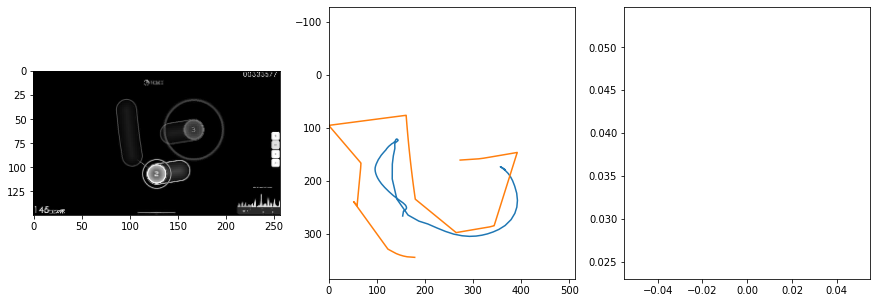


 1 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0077                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 0.0215                                    
pred: 0.5067098736763 0.5869559049606323
gt: 0.587090253829956 0.5589091181755066
(139, 83)


<Figure size 1080x360 with 0 Axes>

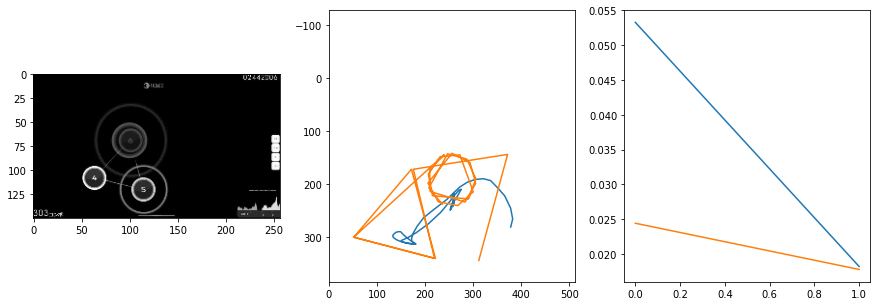


 2 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.70it/s  0.0095                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 0.0129                                    
pred: 0.796225368976593 0.6970139145851135
gt: 0.7890365123748779 0.8002490401268005
(170, 111)


<Figure size 1080x360 with 0 Axes>

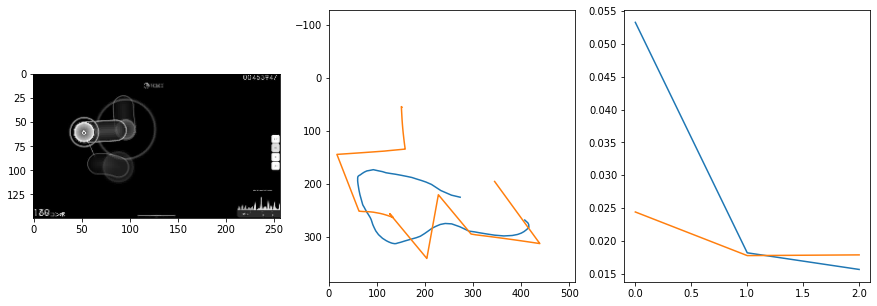


 3 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.68it/s  0.0301                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 0.0252                                    
pred: 0.4294830560684204 0.4854958951473236
gt: 0.28016576170921326 0.28279387950897217
(91, 50)


<Figure size 1080x360 with 0 Axes>

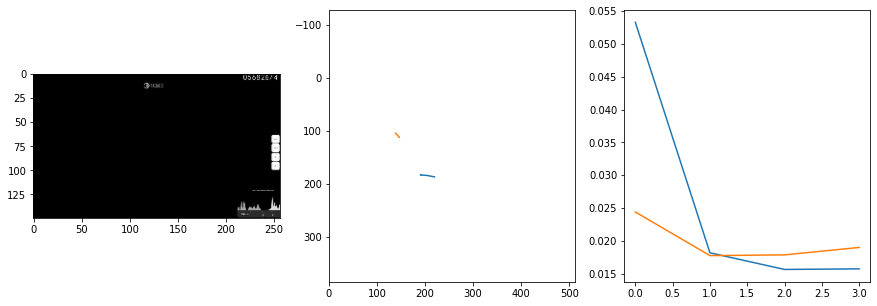


 4 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.69it/s  0.0029                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 0.0092                                    
pred: 0.19418099522590637 0.7337220907211304
gt: 0.17578132450580597 0.8697916865348816
(75, 119)


<Figure size 1080x360 with 0 Axes>

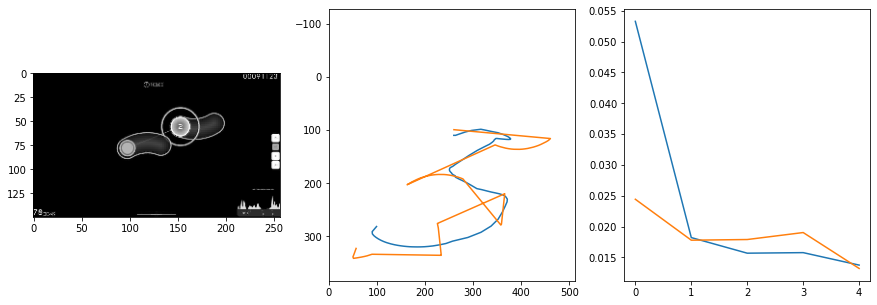


 5 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.56it/s  0.0057                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 0.0098                                    
pred: 0.27633967995643616 0.6319750547409058
gt: 0.2812531590461731 0.628477156162262
(91, 91)


<Figure size 1080x360 with 0 Axes>

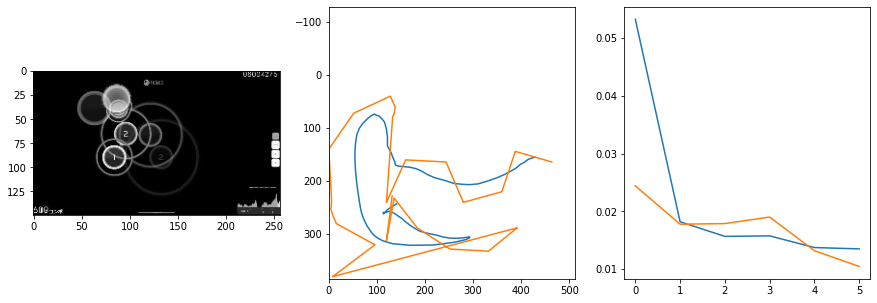


 6 of 6
192.3753798007965 secs


In [39]:
start = time.time()

epochs = 6
trainVN()

end = time.time()
print(end - start, 'secs')

In [40]:
train_hist = []
val_hist = []

1 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.56it/s  0.0072                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.012460486160882876
outliers: 0

val: 50/50 loss: 0.0055                                    
pred: 0.411129355430603 0.5508873462677002
gt: 0.4999784231185913 0.687441885471344
(125, 97)


<Figure size 1080x360 with 0 Axes>

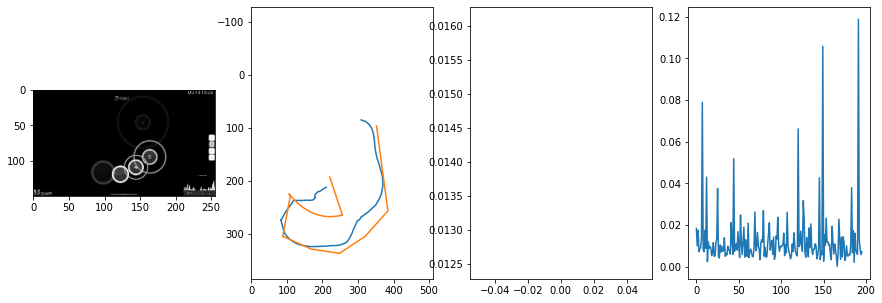


 7 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.61it/s  0.0069                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011882202745366567
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0258                                    
pred: 0.5309993028640747 0.6854308843612671
gt: 0.5708556771278381 0.7850198745727539
(136, 109)


<Figure size 1080x360 with 0 Axes>

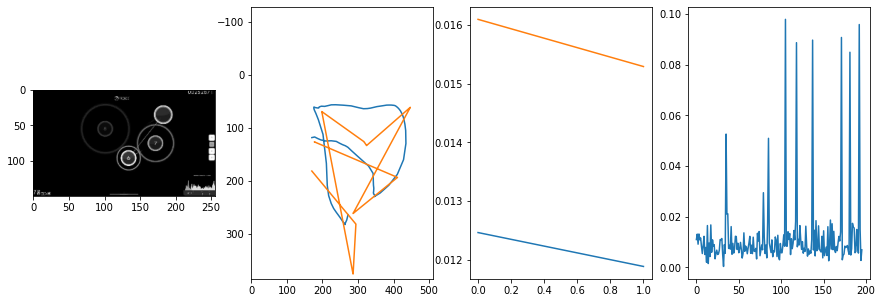


 8 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0096                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.015115582642465597
outliers: 75
retrain: 8                 
val: 50/50 loss: 0.0279                                    
pred: 0.7124753594398499 0.4486986994743347
gt: 0.41601619124412537 0.04948028549551964
(112, 23)


<Figure size 1080x360 with 0 Axes>

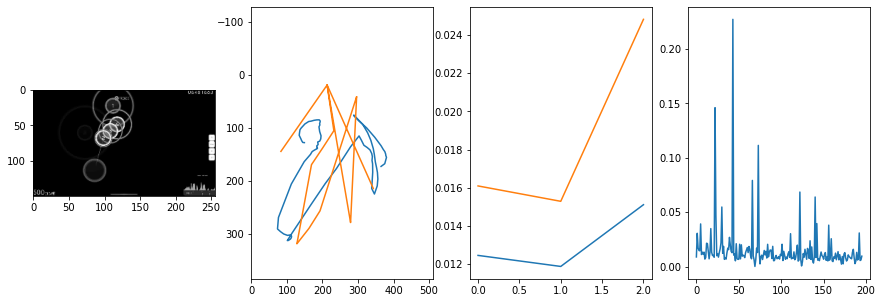


 9 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.50it/s  0.0065                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.013078659414123667
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0098                                    
pred: 0.30957457423210144 0.24371899664402008
gt: 0.345598042011261 0.25729644298553467
(101, 47)


<Figure size 1080x360 with 0 Axes>

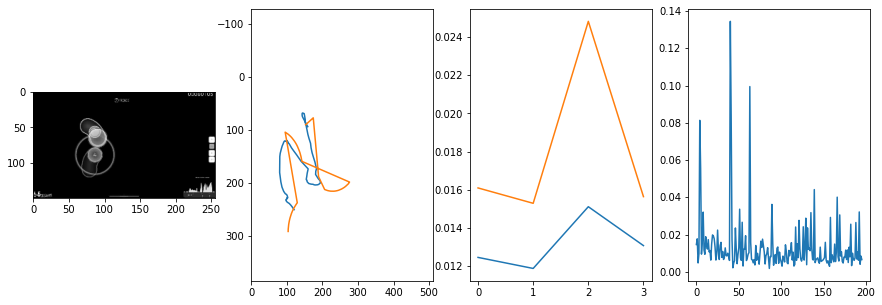


 10 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.52it/s  0.0046                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011079826775334813
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0097                                    
pred: 0.478636771440506 0.5437318086624146
gt: 0.3672043979167938 0.8020679950714111
(104, 111)


<Figure size 1080x360 with 0 Axes>

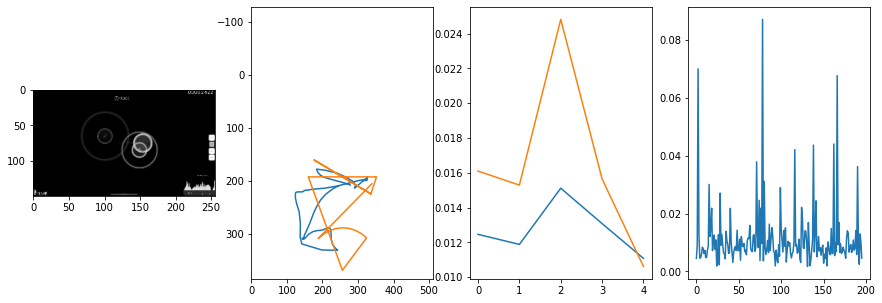


 11 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0741                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01669890261421512
outliers: 70
retrain: 8                 
val: 50/50 loss: 0.0110                                    
pred: 0.5048761367797852 0.6273819208145142
gt: 0.5 0.5
(125, 76)


<Figure size 1080x360 with 0 Axes>

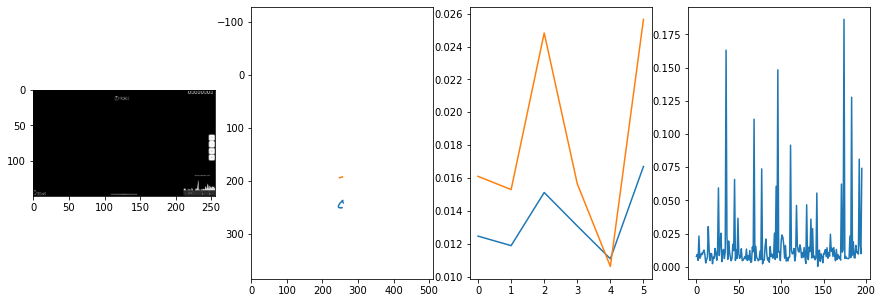


 12 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0113                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.012158539902587535
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0051                                    
pred: 0.6675552725791931 0.6318988800048828
gt: 0.807027280330658 0.7912003397941589
(173, 110)


<Figure size 1080x360 with 0 Axes>

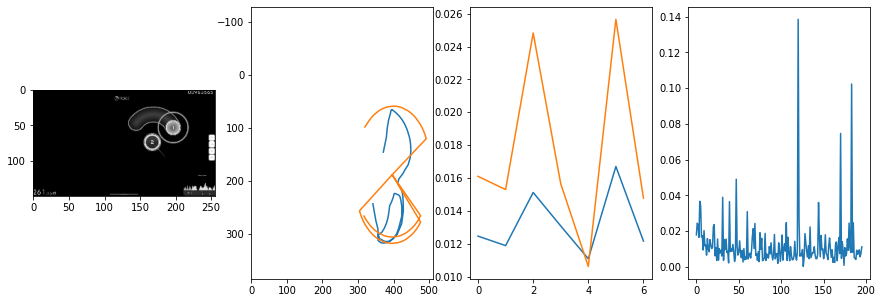


 13 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0061                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010775105067295954
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.0107                                    
pred: 0.5812462568283081 0.45179107785224915
gt: 0.5000031590461731 0.500002920627594
(125, 76)


<Figure size 1080x360 with 0 Axes>

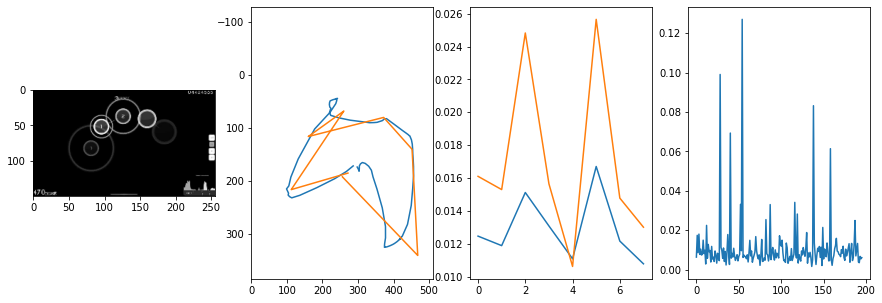


 14 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0056                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011242271735385174
outliers: 55
retrain: 8                 
val: 50/50 loss: 0.0104                                    
pred: 0.4620744287967682 0.47751161456108093
gt: 0.4082030951976776 0.5182291269302368
(111, 78)


<Figure size 1080x360 with 0 Axes>

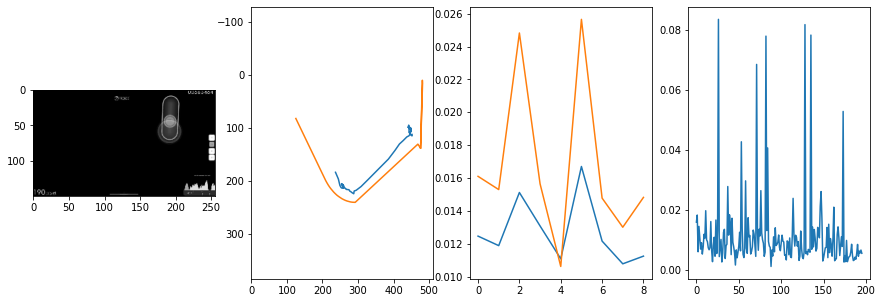


 15 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0079                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010865352276893218
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0093                                    
pred: 0.6677707433700562 0.2987646162509918
gt: 0.5703125596046448 0.5781248807907104
(136, 85)


<Figure size 1080x360 with 0 Axes>

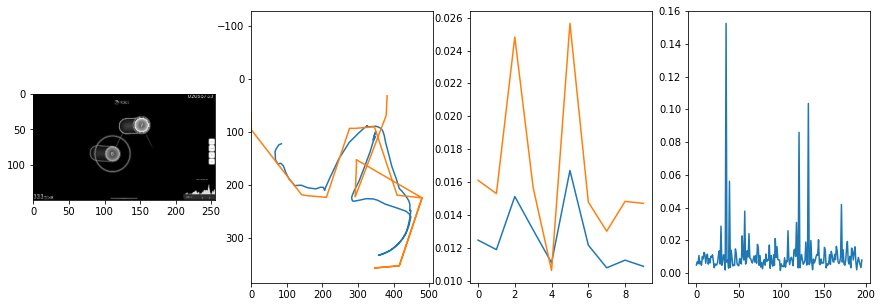


 16 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0038                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011019144244064406
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0087                                    
pred: 0.27433404326438904 0.3626023530960083
gt: 0.4453122615814209 0.11458364874124527
(117, 31)


<Figure size 1080x360 with 0 Axes>

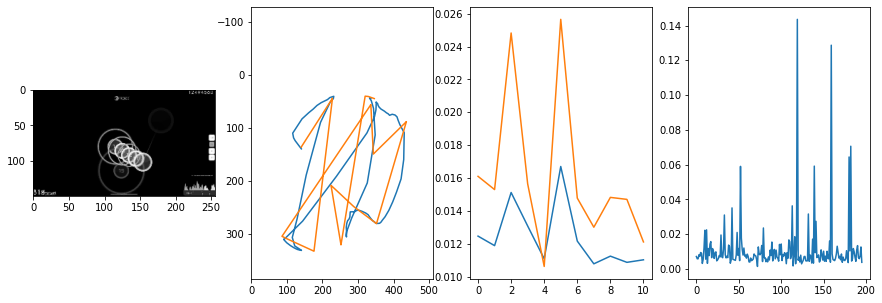


 17 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0190                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010280733552704356
outliers: 42
retrain: 8                 
val: 50/50 loss: 0.0058                                    
pred: 0.20353490114212036 0.2889781892299652
gt: 0.11523442715406418 0.26562508940696716
(65, 48)


<Figure size 1080x360 with 0 Axes>

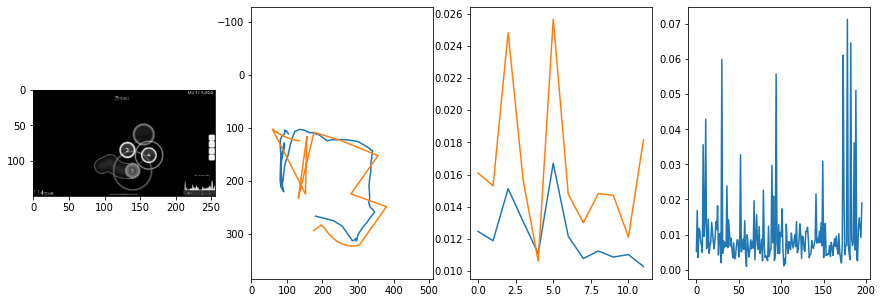


 18 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.93it/s  0.0051                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.012922268600811308
outliers: 60
retrain: 8                 
val: 50/50 loss: 0.0066                                    
pred: 0.8060575723648071 0.7949678301811218
gt: 0.923828125 0.8203125
(191, 113)


<Figure size 1080x360 with 0 Axes>

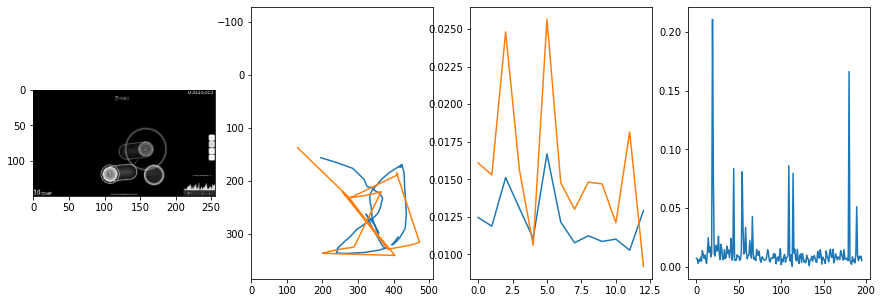


 19 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0045                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010958456046456394
outliers: 23
retrain: 8                 
val: 50/50 loss: 0.0135                                    
pred: 0.18381451070308685 0.2710528075695038
gt: 0.3124992847442627 0.2291683405637741
(96, 44)


<Figure size 1080x360 with 0 Axes>

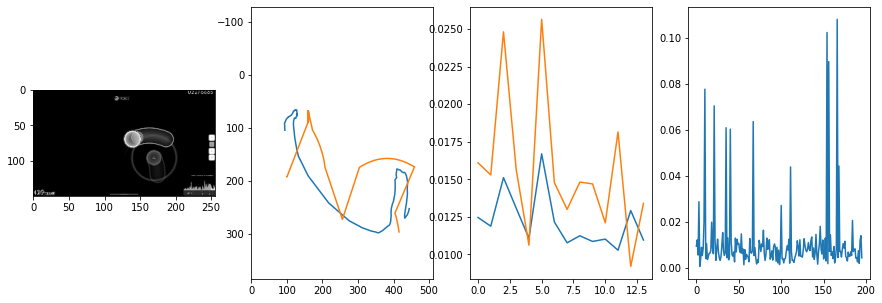


 20 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0072                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01176417083895233
outliers: 46
retrain: 8                 
val: 50/50 loss: 0.0047                                    
pred: 0.13418962061405182 0.7910091876983643
gt: 0.244140625 0.7760416865348816
(85, 108)


<Figure size 1080x360 with 0 Axes>

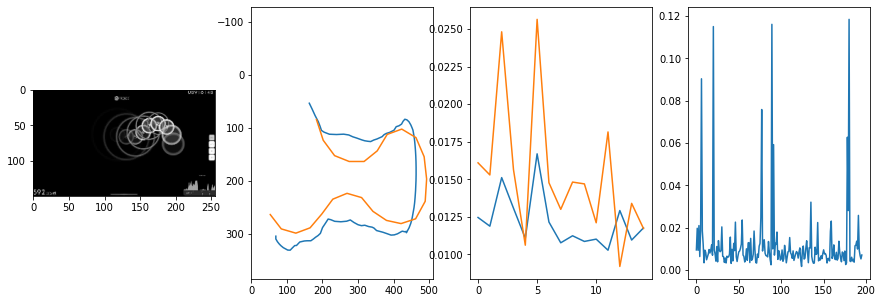


 21 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0086                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01009801997059519
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0068                                    
pred: 0.0900753065943718 0.40285345911979675
gt: 0.10893910378217697 0.26592084765434265
(64, 48)


<Figure size 1080x360 with 0 Axes>

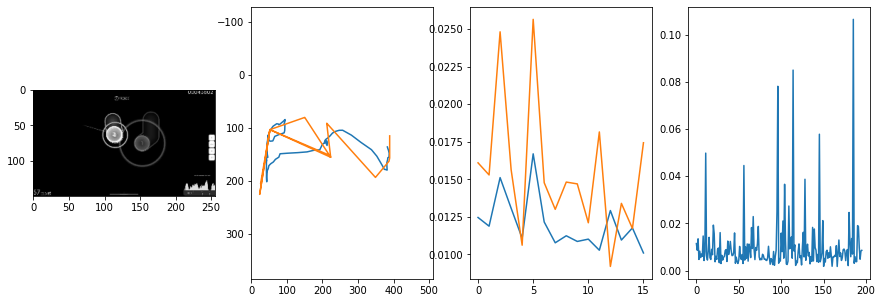


 22 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0088                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01233608866875459
outliers: 47
retrain: 8                 
val: 50/50 loss: 0.0191                                    
pred: 0.47634387016296387 0.7804989814758301
gt: 0.43749821186065674 0.9687467217445374
(115, 130)


<Figure size 1080x360 with 0 Axes>

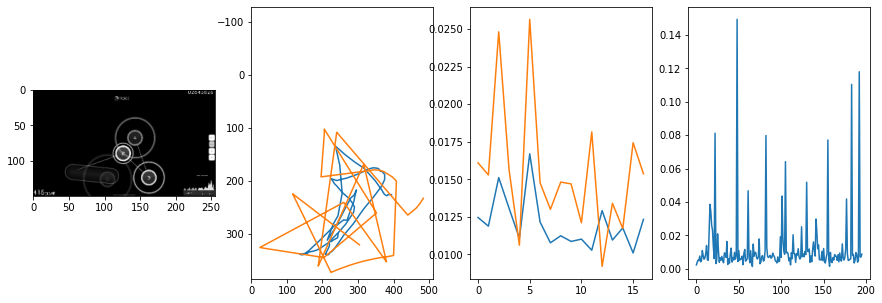


 23 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0068                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010803935432816115
outliers: 21
retrain: 8                 
val: 50/50 loss: 0.0124                                    
pred: 0.36388835310935974 0.7484536170959473
gt: 0.2866789400577545 0.457476943731308
(92, 71)


<Figure size 1080x360 with 0 Axes>

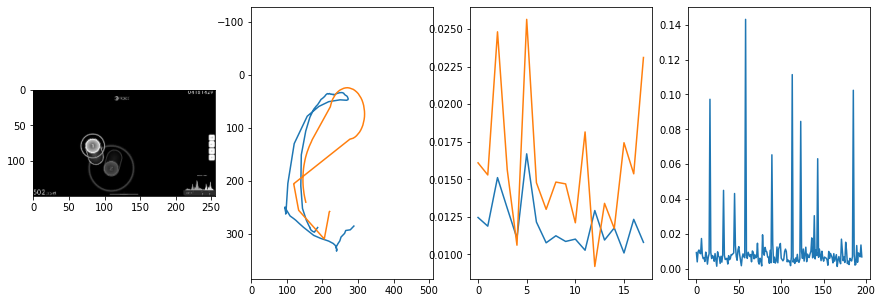


 24 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0036                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010914070114620476
outliers: 44
retrain: 8                 
val: 50/50 loss: 0.0089                                    
pred: 0.49814343452453613 0.5358909368515015
gt: 0.5499711036682129 0.6118699908256531
(133, 89)


<Figure size 1080x360 with 0 Axes>

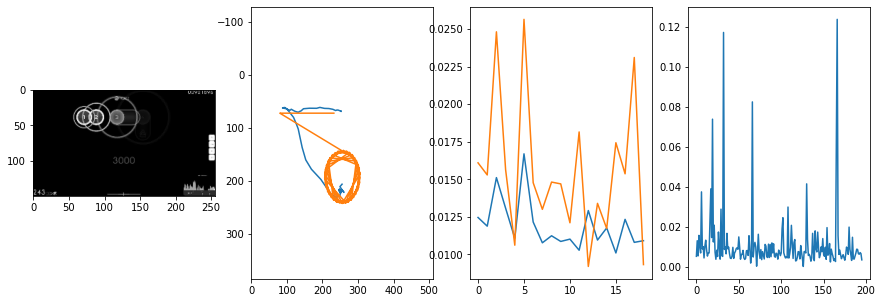


 25 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0054                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009315389176422008
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0051                                    
pred: 0.16368509829044342 0.22916105389595032
gt: 0.19014061987400055 0.26393750309944153
(77, 48)


<Figure size 1080x360 with 0 Axes>

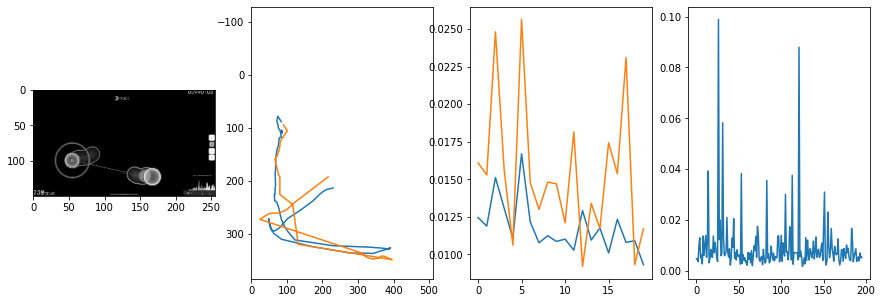


 26 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0081                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010197269669092469
outliers: 46
retrain: 8                 
val: 50/50 loss: 0.1179                                    
pred: 0.4996074438095093 0.6263294219970703
gt: 0.8533921241760254 0.40441009402275085
(180, 65)


<Figure size 1080x360 with 0 Axes>

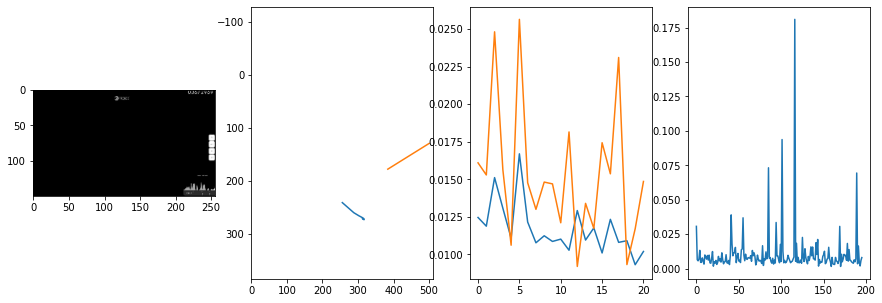


 27 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0118                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010468500106814032
outliers: 44
retrain: 8                 
val: 50/50 loss: 0.0101                                    
pred: 0.1686524599790573 0.14169134199619293
gt: 0.3143976628780365 0.19320587813854218
(96, 40)


<Figure size 1080x360 with 0 Axes>

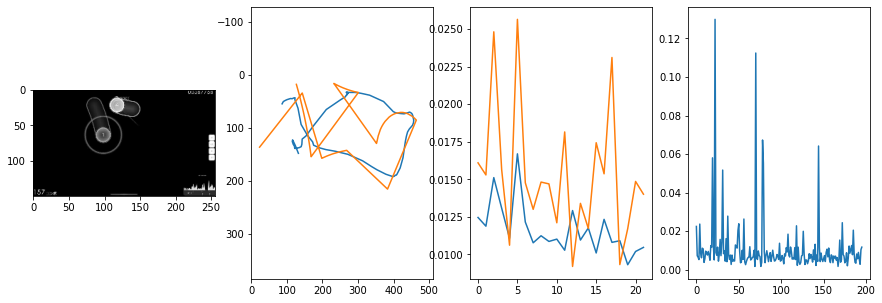


 28 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0045                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01099064649315551
outliers: 42
retrain: 8                 
val: 50/50 loss: 0.0096                                    
pred: 0.7003012895584106 0.30912789702415466
gt: 0.7226485013961792 0.3640731871128082
(160, 60)


<Figure size 1080x360 with 0 Axes>

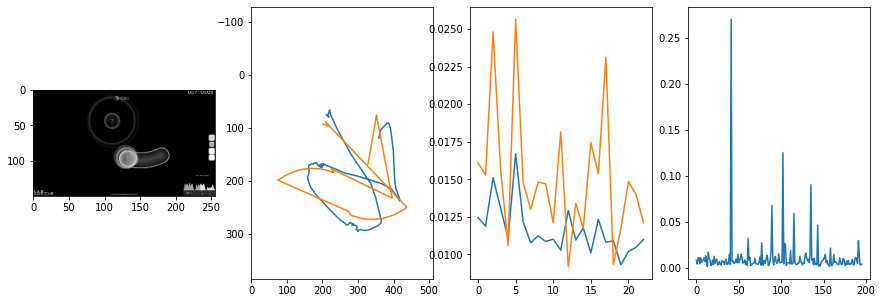


 29 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0086                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01015018039960319
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0033                                    
pred: 0.3537108600139618 0.49669304490089417
gt: 0.3060254156589508 0.6022692322731018
(95, 88)


<Figure size 1080x360 with 0 Axes>

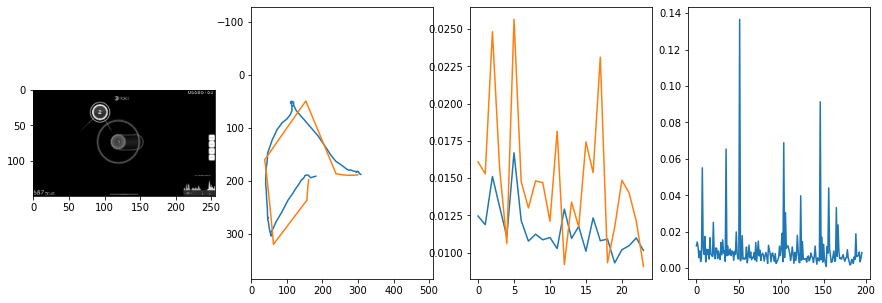


 30 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0136                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00843468625739939
outliers: 41
retrain: 8                 
val: 50/50 loss: 0.0100                                    
pred: 0.6314207911491394 0.5185420513153076
gt: 0.6255044937133789 0.6685931086540222
(145, 95)


<Figure size 1080x360 with 0 Axes>

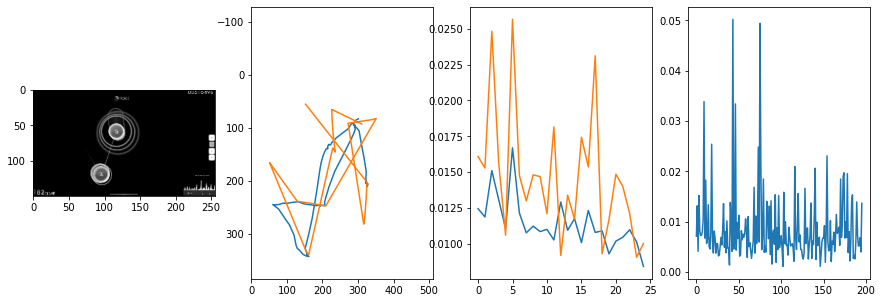


 31 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.95it/s  0.0048                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009383662897580879
outliers: 44
retrain: 8                 
val: 50/50 loss: 0.0076                                    
pred: 0.856994092464447 0.5543398857116699
gt: 0.84375 0.4349803030490875
(178, 68)


<Figure size 1080x360 with 0 Axes>

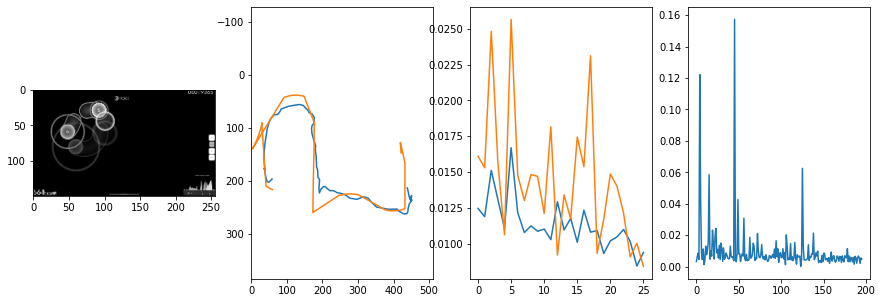


 32 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0019                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01118004288434108
outliers: 42
retrain: 8                 
val: 50/50 loss: 0.0112                                    
pred: 0.7021037340164185 0.2483586072921753
gt: 0.7121552228927612 0.1854335516691208
(158, 39)


<Figure size 1080x360 with 0 Axes>

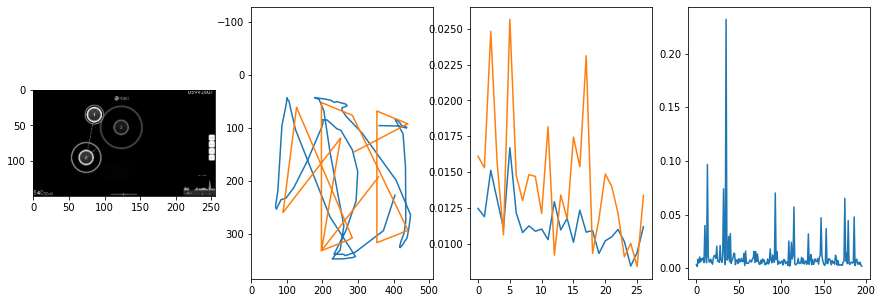


 33 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0100                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009434937634885463
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0096                                    
pred: 0.6554566621780396 0.8208682537078857
gt: 0.9318808913230896 0.18697489798069
(192, 39)


<Figure size 1080x360 with 0 Axes>

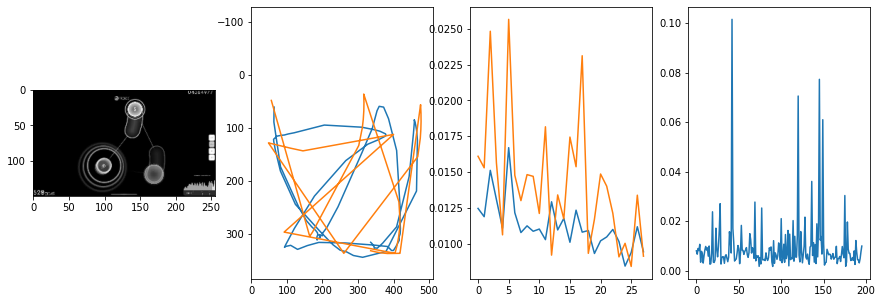


 34 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0032                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009811670801540533
outliers: 49
retrain: 8                 
val: 50/50 loss: 0.0085                                    
pred: 0.5649935603141785 0.7096171379089355
gt: 0.7671855688095093 0.6849464774131775
(166, 97)


<Figure size 1080x360 with 0 Axes>

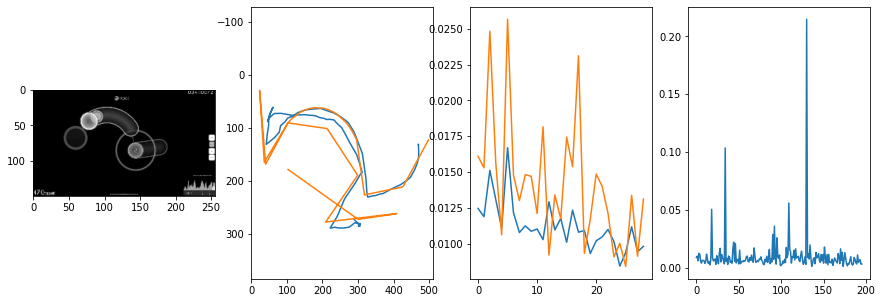


 35 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0500                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011579251378936199
outliers: 51
retrain: 8                 
val: 50/50 loss: 0.0083                                    
pred: 0.46677926182746887 0.6317772269248962
gt: 0.30468764901161194 0.5000001788139343
(95, 76)


<Figure size 1080x360 with 0 Axes>

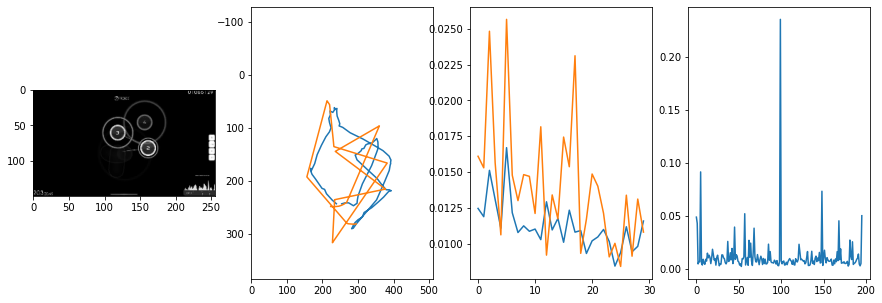


 36 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0061                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011359855748846062
outliers: 41
retrain: 8                 
val: 50/50 loss: 0.0065                                    
pred: 0.6173530220985413 0.4247629642486572
gt: 0.5837400555610657 0.43558549880981445
(138, 68)


<Figure size 1080x360 with 0 Axes>

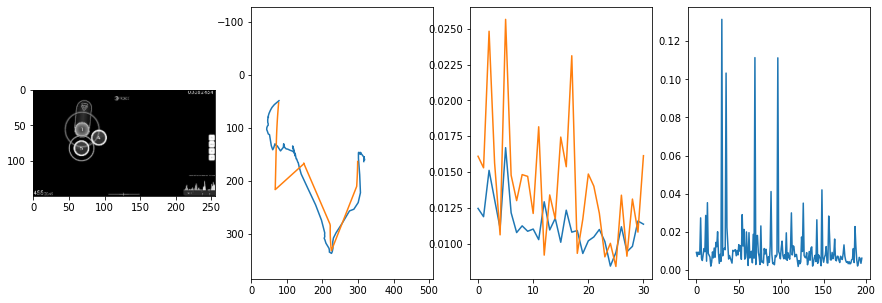


 37 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0072                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010226565228456783
outliers: 30
retrain: 8                 
val: 50/50 loss: 0.0104                                    
pred: 0.8107532262802124 0.36803343892097473
gt: 0.7127705812454224 0.29927775263786316
(158, 52)


<Figure size 1080x360 with 0 Axes>

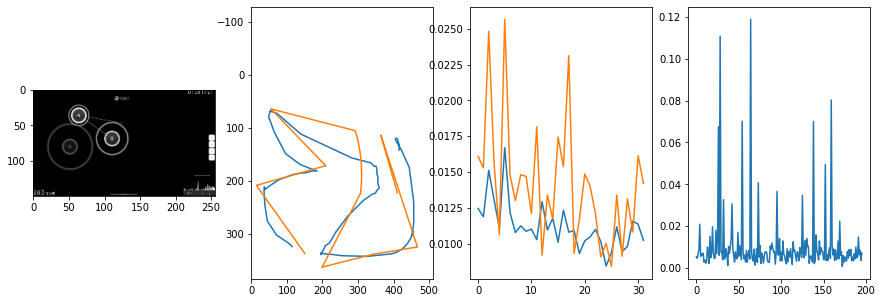


 38 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0050                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010292662652708324
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.0087                                    
pred: 0.07742583751678467 0.5379916429519653
gt: 0.12915898859500885 0.37997791171073914
(68, 62)


<Figure size 1080x360 with 0 Axes>

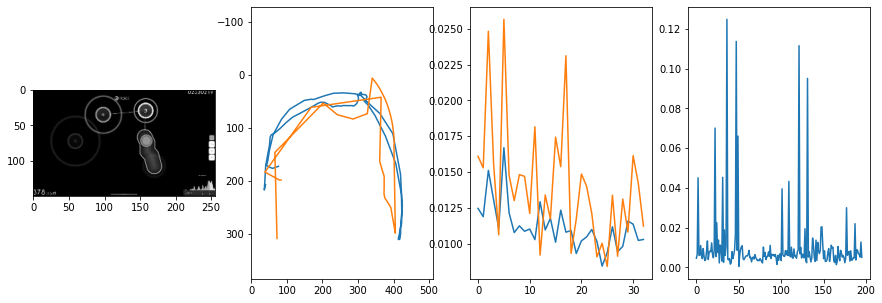


 39 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  0.0025                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009459730482432155
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0067                                    
pred: 0.28291207551956177 0.09984984993934631
gt: 0.5944733619689941 0.40768858790397644
(140, 65)


<Figure size 1080x360 with 0 Axes>

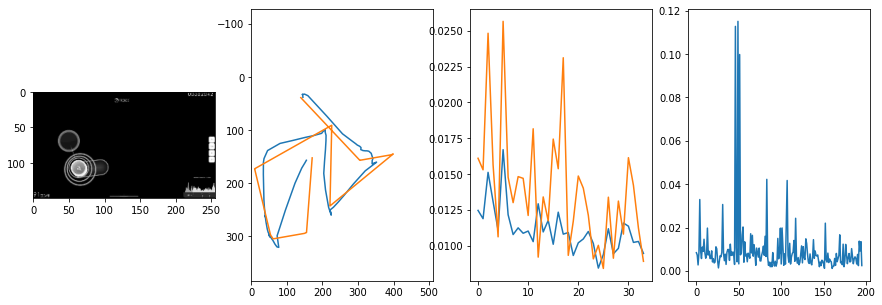


 40 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0021                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011038074018053559
outliers: 48
retrain: 8                 
val: 50/50 loss: 0.0109                                    
pred: 0.13327345252037048 0.8230884671211243
gt: 0.1535477340221405 0.52012699842453
(71, 78)


<Figure size 1080x360 with 0 Axes>

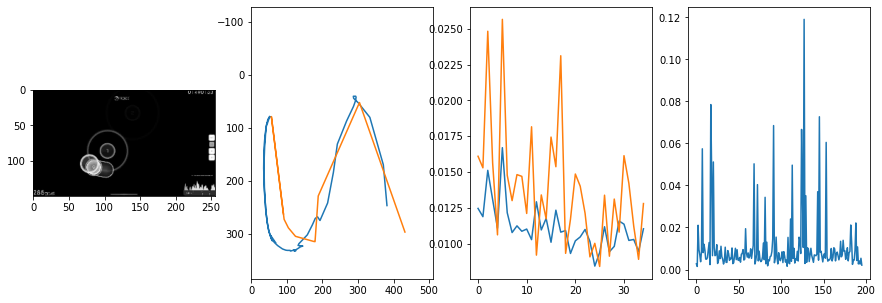


 41 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.94it/s  0.0112                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010235472386275247
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0075                                    
pred: 0.5724226832389832 0.46219632029533386
gt: 0.3767614960670471 0.8623137474060059
(106, 118)


<Figure size 1080x360 with 0 Axes>

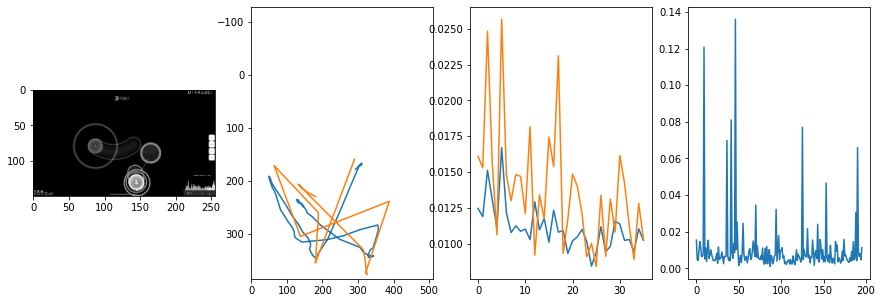


 42 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0045                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009090655063378758
outliers: 24
retrain: 8                 
val: 50/50 loss: 0.0151                                    
pred: 0.6106482744216919 0.5349090099334717
gt: 0.5978537797927856 0.6508067846298218
(140, 93)


<Figure size 1080x360 with 0 Axes>

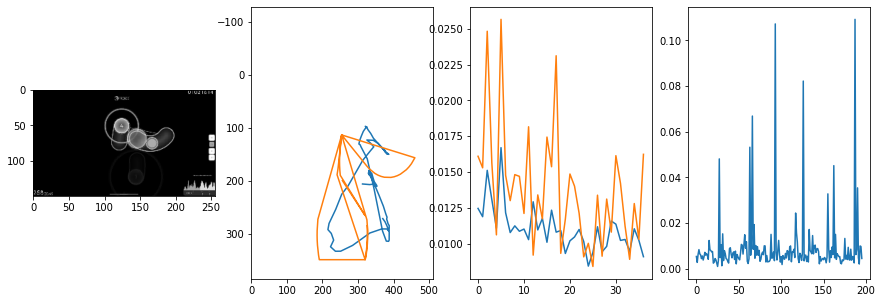


 43 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  8.04it/s  0.0087                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00917634621977673
outliers: 46
retrain: 8                 
val: 50/50 loss: 0.0065                                    
pred: 0.7119515538215637 0.42149817943573
gt: 0.78125 0.2786458432674408
(169, 50)


<Figure size 1080x360 with 0 Axes>

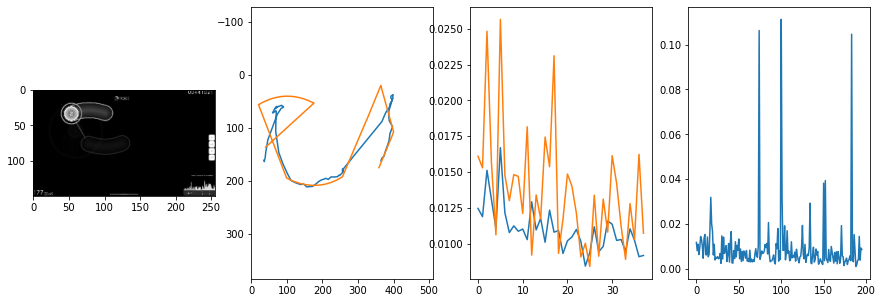


 44 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  8.02it/s  0.0027                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009704322583274916
outliers: 37
retrain: 8                 
val: 50/50 loss: 0.0830                                    
pred: 0.451907217502594 0.5343929529190063
gt: 0.0468941330909729 0.5433350205421448
(55, 81)


<Figure size 1080x360 with 0 Axes>

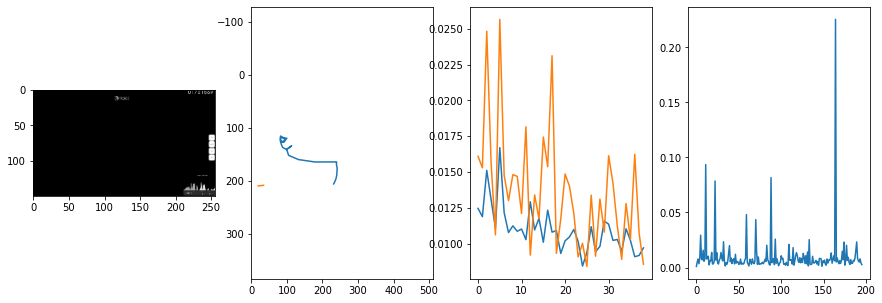


 45 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0113                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009172242816076709
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0331                                    
pred: 0.6333198547363281 0.4697932302951813
gt: 0.13929474353790283 0.7027338147163391
(69, 99)


<Figure size 1080x360 with 0 Axes>

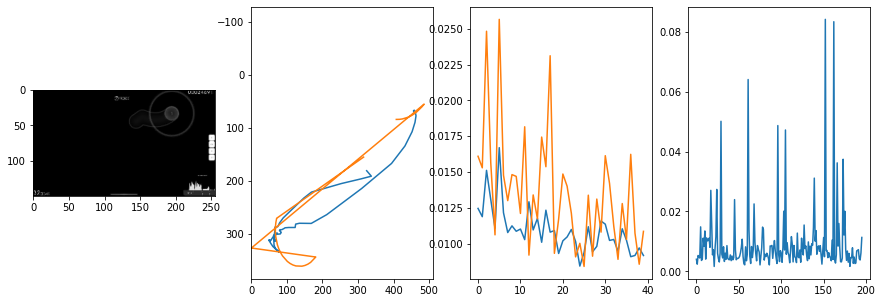


 46 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0041                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007697109304064391
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0061                                    
pred: 0.4788106381893158 0.49715253710746765
gt: 0.5953512191772461 0.5281233191490173
(140, 79)


<Figure size 1080x360 with 0 Axes>

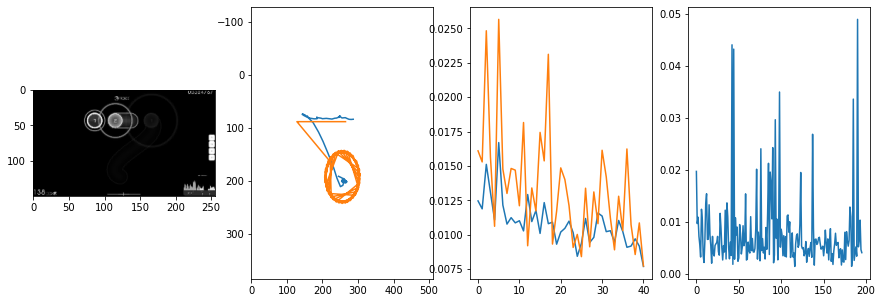


 47 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0034                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009527889976030861
outliers: 47
retrain: 8                 
val: 50/50 loss: 0.0100                                    
pred: 0.7602978348731995 0.8543538451194763
gt: 0.7586368322372437 0.6727946400642395
(165, 96)


<Figure size 1080x360 with 0 Axes>

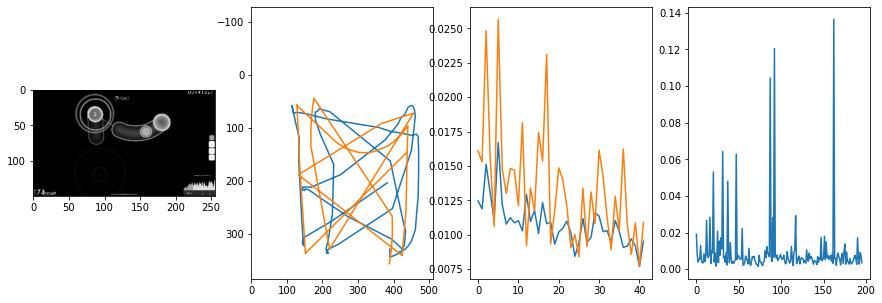


 48 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.93it/s  0.0028                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010081817046145206
outliers: 36
retrain: 8                 
val: 50/50 loss: 0.0114                                    
pred: 0.8445138335227966 0.141115203499794
gt: 0.6011235117912292 0.13354985415935516
(141, 33)


<Figure size 1080x360 with 0 Axes>

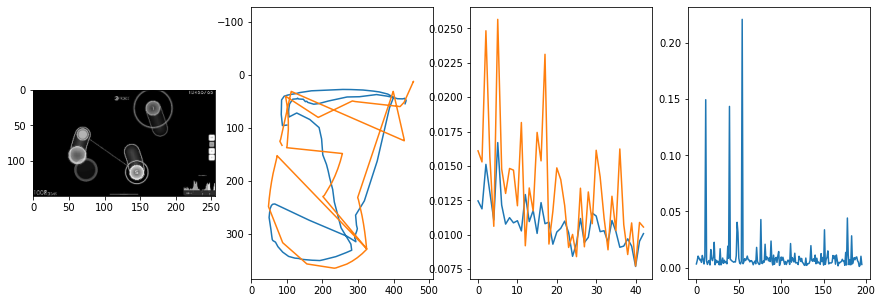


 49 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  0.0069                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009875663170087323
outliers: 44
retrain: 8                 
val: 50/50 loss: 0.0229                                    
pred: 0.13623778522014618 0.5146611928939819
gt: 0.09178996086120605 0.5549823641777039
(62, 82)


<Figure size 1080x360 with 0 Axes>

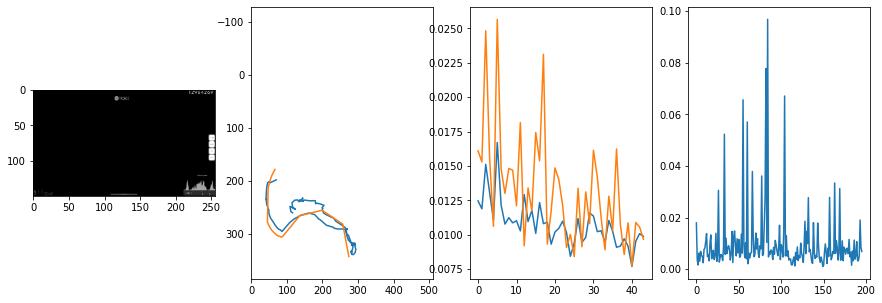


 50 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0127                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00854736743779967
outliers: 30
retrain: 8                 
val: 50/50 loss: 0.0095                                    
pred: 0.09631655365228653 0.7754032611846924
gt: 0.2949218153953552 0.513020932674408
(93, 77)


<Figure size 1080x360 with 0 Axes>

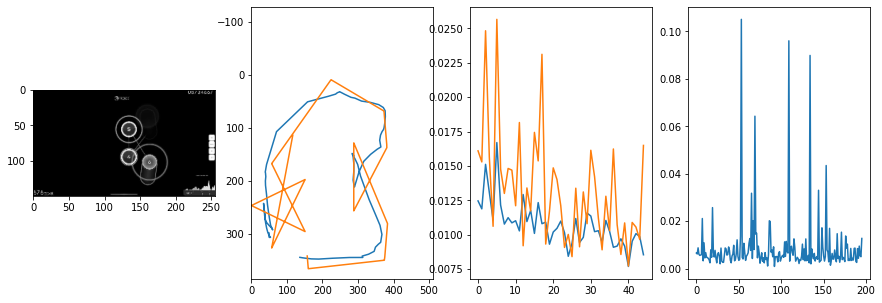


 51 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.95it/s  0.0035                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008643366687465459
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0093                                    
pred: 0.44763460755348206 0.5536017417907715
gt: 0.5369119048118591 0.379451185464859
(131, 62)


<Figure size 1080x360 with 0 Axes>

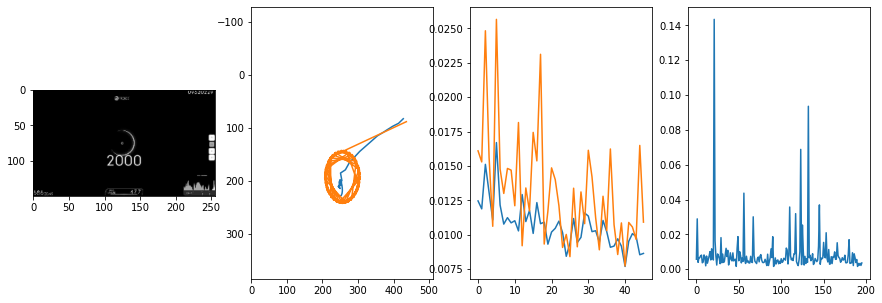


 52 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0099                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009124694266463439
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0047                                    
pred: 0.5807029008865356 0.5104484558105469
gt: 0.6644073724746704 0.622749388217926
(151, 90)


<Figure size 1080x360 with 0 Axes>

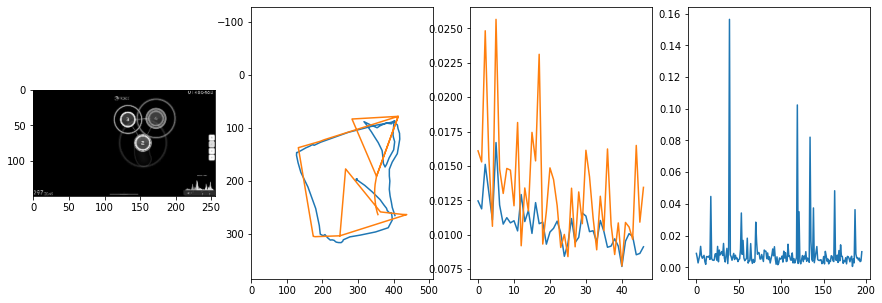


 53 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0035                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008353980125358082
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0078                                    
pred: 0.2593047320842743 0.7067462801933289
gt: 0.4160155653953552 0.43750008940696716
(112, 68)


<Figure size 1080x360 with 0 Axes>

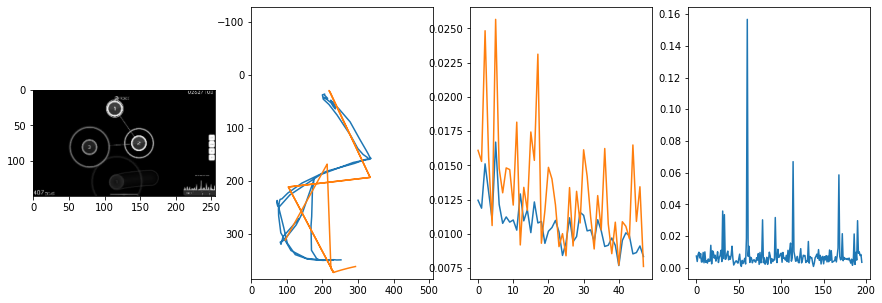


 54 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0070                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009700254984413825
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0122                                    
pred: 0.5013847351074219 0.3055923581123352
gt: 0.21886982023715973 0.47920918464660645
(81, 73)


<Figure size 1080x360 with 0 Axes>

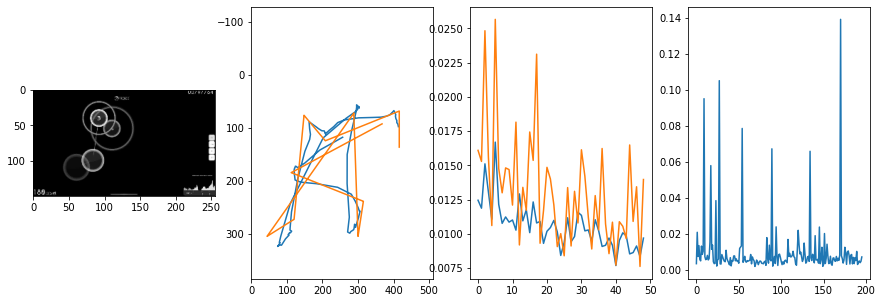


 55 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0141                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010914272167220978
outliers: 41
retrain: 8                 
val: 50/50 loss: 0.0137                                    
pred: 0.5261670351028442 0.35894814133644104
gt: 0.5310600399971008 0.5098046660423279
(130, 77)


<Figure size 1080x360 with 0 Axes>

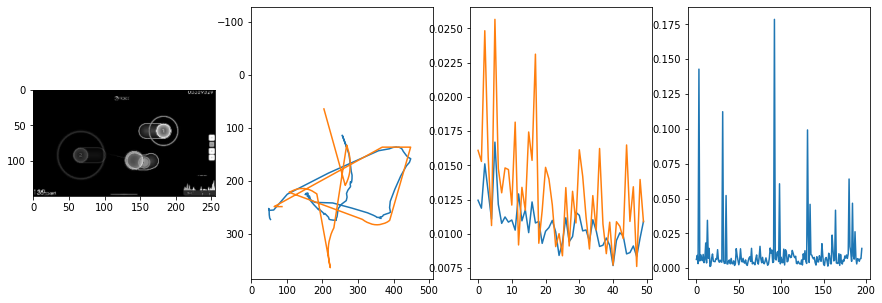


 56 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0146                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01199942029898568
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0086                                    
pred: 0.6179912686347961 0.788542628288269
gt: 0.4608595669269562 0.3965337574481964
(119, 64)


<Figure size 1080x360 with 0 Axes>

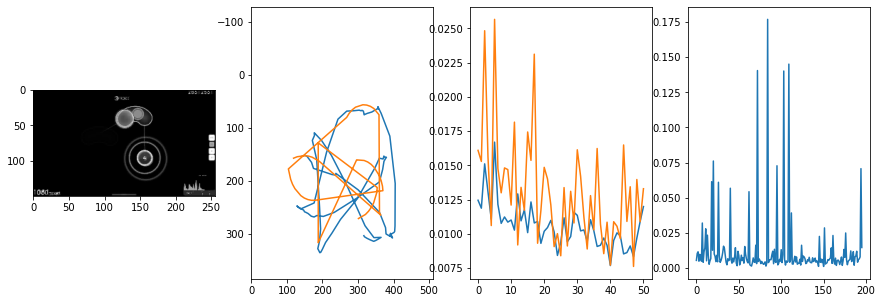


 57 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0053                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00994537944702921
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0043                                    
pred: 0.43889540433883667 0.18891777098178864
gt: 0.44142815470695496 0.10418268293142319
(116, 30)


<Figure size 1080x360 with 0 Axes>

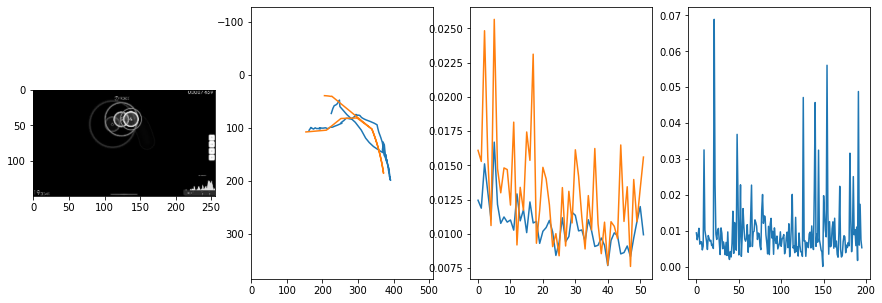


 58 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.1878                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010932464653576193
outliers: 46
retrain: 8                 
val: 50/50 loss: 0.0516                                    
pred: 0.36705493927001953 0.3841352164745331
gt: 0.5 0.10416687279939651
(125, 30)


<Figure size 1080x360 with 0 Axes>

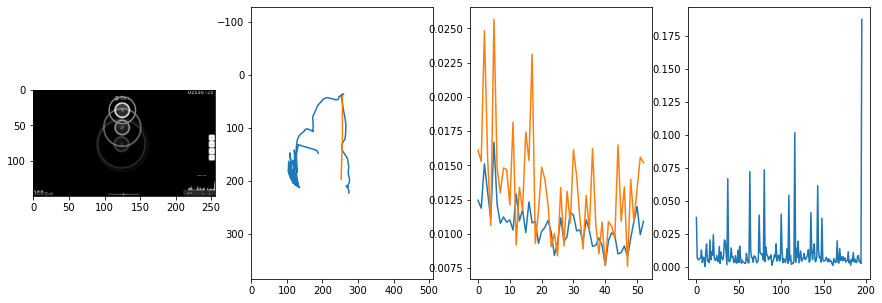


 59 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0238                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008958663979405063
outliers: 32
retrain: 8                 
val: 50/50 loss: 0.0056                                    
pred: 0.6613490581512451 0.2103503793478012
gt: 0.47566887736320496 0.2828892171382904
(121, 50)


<Figure size 1080x360 with 0 Axes>

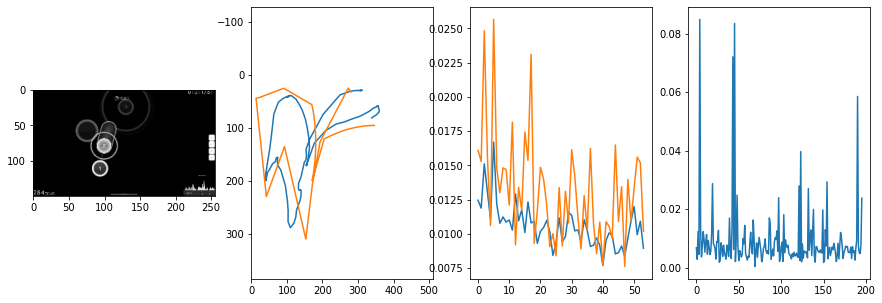


 60 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0094                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009096590701991938
outliers: 46
retrain: 8                 
val: 50/50 loss: 0.0021                                    
pred: 0.9005248546600342 0.39136162400245667
gt: 0.6054689288139343 0.526041567325592
(141, 79)


<Figure size 1080x360 with 0 Axes>

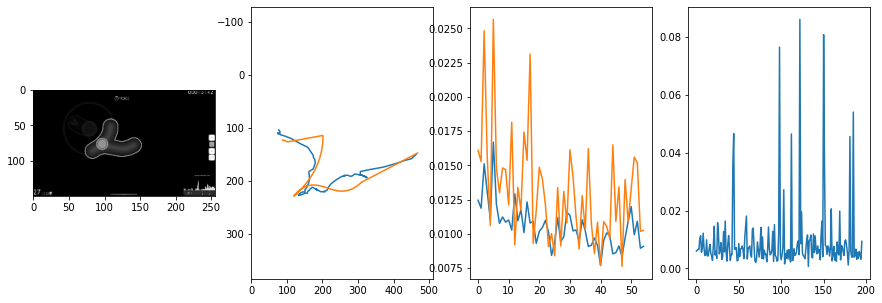


 61 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0054                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008955070223274395
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0059                                    
pred: 0.6068206429481506 0.7918587327003479
gt: 0.40625011920928955 0.8333333134651184
(111, 114)


<Figure size 1080x360 with 0 Axes>

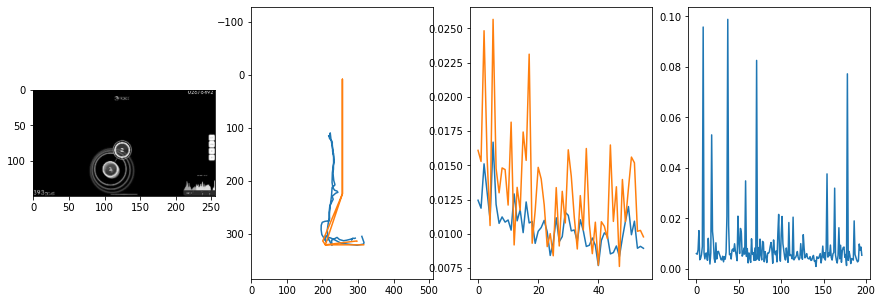


 62 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0587                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008727332706294708
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0028                                    
pred: 0.8719974160194397 0.6405823826789856
gt: 0.8841374516487122 0.6469298005104065
(185, 93)


<Figure size 1080x360 with 0 Axes>

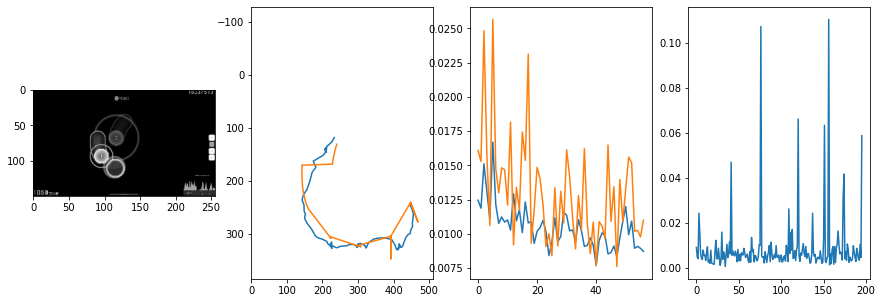


 63 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0046                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008473942688267146
outliers: 28
retrain: 8                 
val: 50/50 loss: 0.0042                                    
pred: 0.315525621175766 0.7922603487968445
gt: 0.2874559462070465 0.8359588980674744
(92, 115)


<Figure size 1080x360 with 0 Axes>

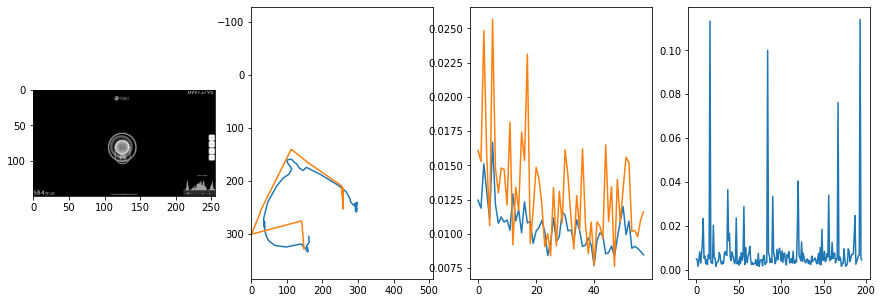


 64 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0097                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008886699255897986
outliers: 42
retrain: 8                 
val: 50/50 loss: 0.0096                                    
pred: 0.8248541355133057 0.4428541958332062
gt: 0.8486030697822571 0.44814741611480713
(179, 70)


<Figure size 1080x360 with 0 Axes>

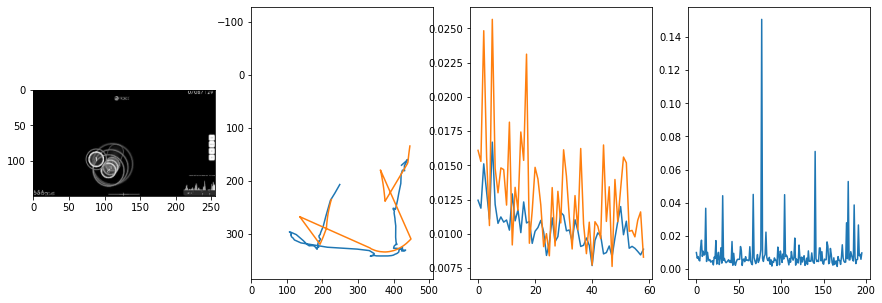


 65 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0062                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007865520530351798
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0053                                    
pred: 0.2345963418483734 0.2373611181974411
gt: 0.1953125 0.375
(78, 61)


<Figure size 1080x360 with 0 Axes>

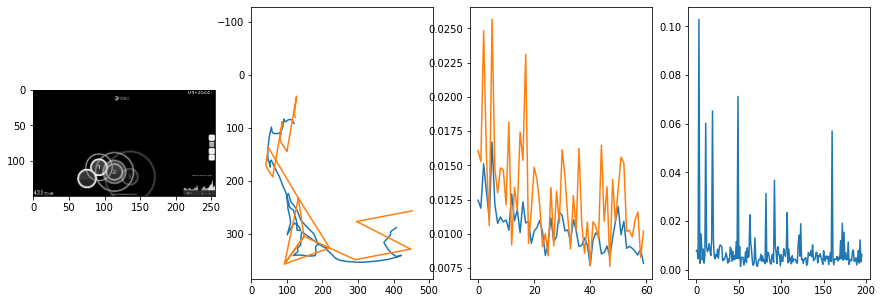


 66 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0063                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008226176815307034
outliers: 47
retrain: 8                 
val: 50/50 loss: 0.0053                                    
pred: 0.7258480191230774 0.8328534364700317
gt: 0.726856529712677 0.8733815550804138
(160, 119)


<Figure size 1080x360 with 0 Axes>

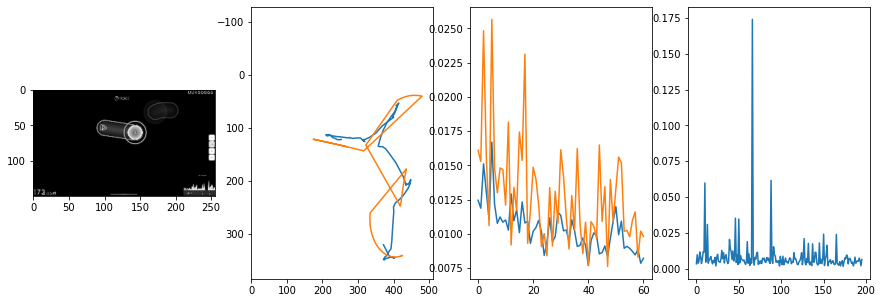


 67 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0063                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009852505326437364
outliers: 51
retrain: 8                 
val: 50/50 loss: 0.0058                                    
pred: 0.5271314978599548 0.6914162635803223
gt: 0.4491974711418152 0.7304873466491699
(117, 102)


<Figure size 1080x360 with 0 Axes>

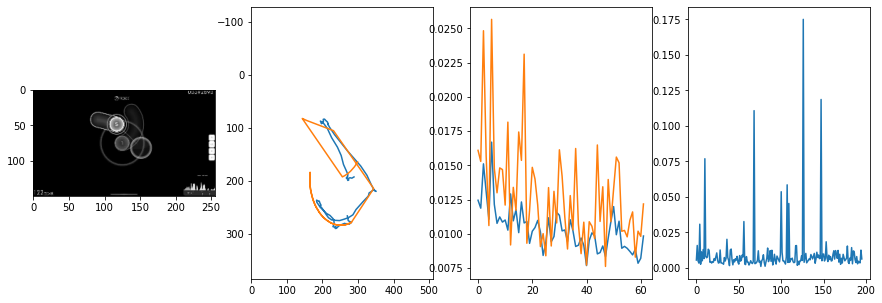


 68 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0049                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00886347971361235
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0089                                    
pred: 0.7288533449172974 0.6608735918998718
gt: 0.791015625 0.7135416865348816
(170, 100)


<Figure size 1080x360 with 0 Axes>

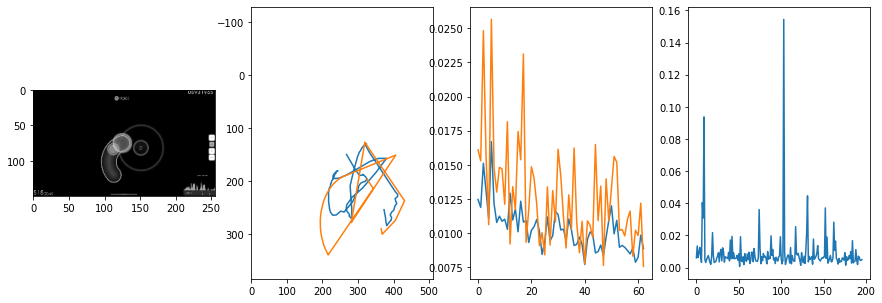


 69 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0040                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01017585860467896
outliers: 42
retrain: 8                 
val: 50/50 loss: 0.0026                                    
pred: 0.501598060131073 0.3824400305747986
gt: 0.39453125 0.3203125
(109, 55)


<Figure size 1080x360 with 0 Axes>

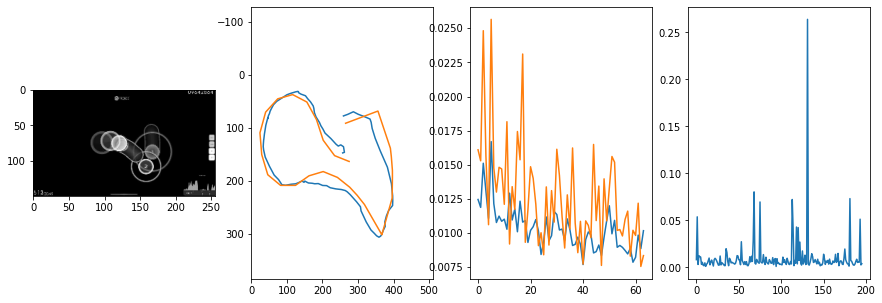


 70 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  8.02it/s  0.0020                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007913672089652747
outliers: 23
retrain: 8                 
val: 50/50 loss: 0.0072                                    
pred: 0.6353076100349426 0.8045555353164673
gt: 0.6453463435173035 0.48643577098846436
(148, 74)


<Figure size 1080x360 with 0 Axes>

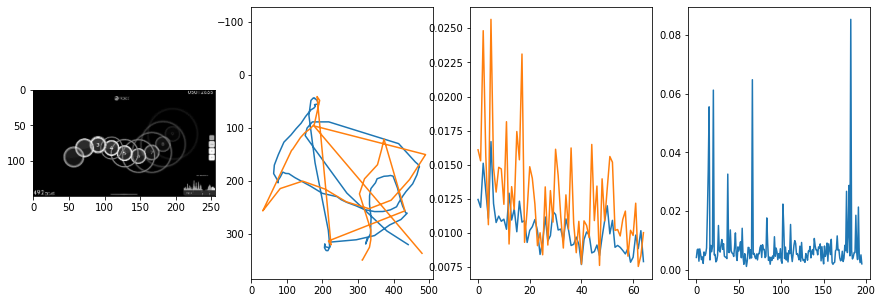


 71 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0062                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009792788152592448
outliers: 48
retrain: 8                 
val: 50/50 loss: 0.0048                                    
pred: 0.20674628019332886 0.3718816936016083
gt: 0.19531628489494324 0.3229233920574188
(78, 55)


<Figure size 1080x360 with 0 Axes>

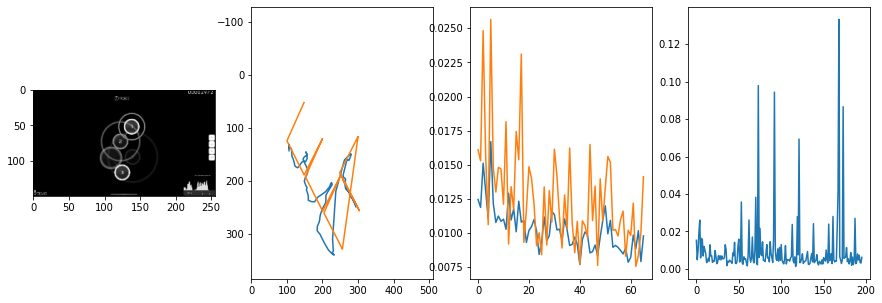


 72 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0215                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009372603243254885
outliers: 29
retrain: 8                 
val: 50/50 loss: 0.0056                                    
pred: 0.7727622985839844 0.3352366089820862
gt: 0.6388453245162964 0.319450706243515
(147, 55)


<Figure size 1080x360 with 0 Axes>

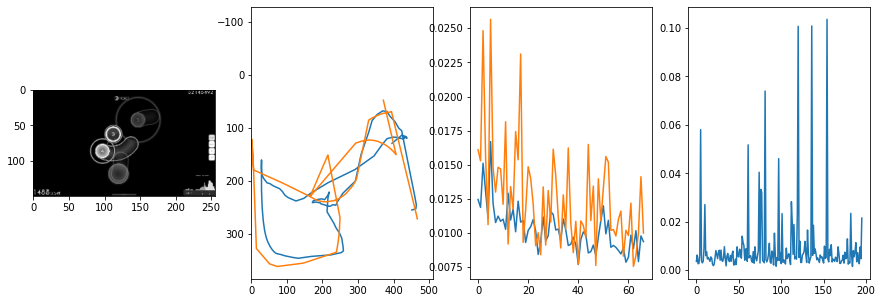


 73 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0058                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009830188300764682
outliers: 37
retrain: 8                 
val: 50/50 loss: 0.0131                                    
pred: 0.8417680859565735 0.5016778111457825
gt: 0.8033019304275513 0.4626016318798065
(172, 71)


<Figure size 1080x360 with 0 Axes>

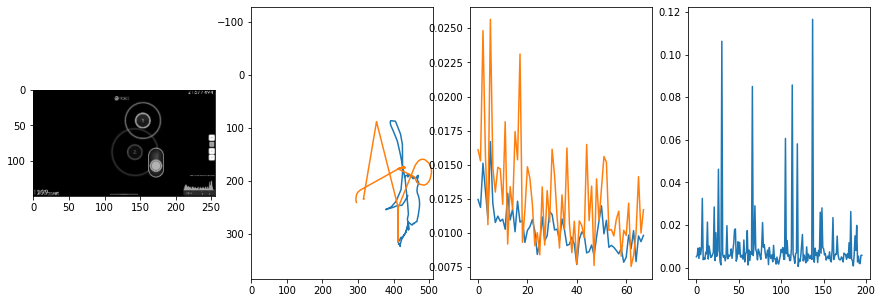


 74 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0170                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008829081441128475
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0106                                    
pred: 0.5690127015113831 0.9183638095855713
gt: 0.759765625 0.9296875
(165, 126)


<Figure size 1080x360 with 0 Axes>

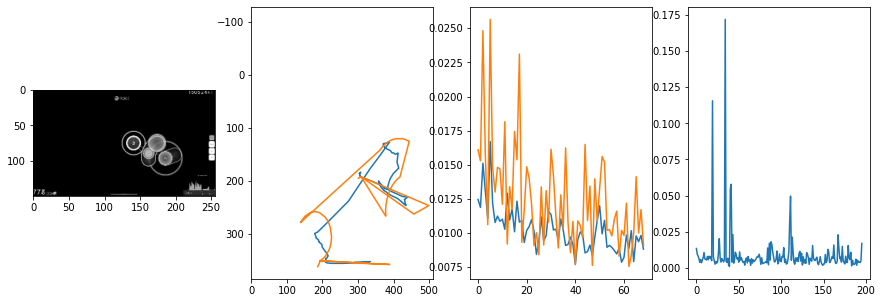


 75 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0023                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007696947944706914
outliers: 28
retrain: 8                 
val: 50/50 loss: 0.0025                                    
pred: 0.21477019786834717 0.461548388004303
gt: 0.24999038875102997 0.5208291411399841
(86, 78)


<Figure size 1080x360 with 0 Axes>

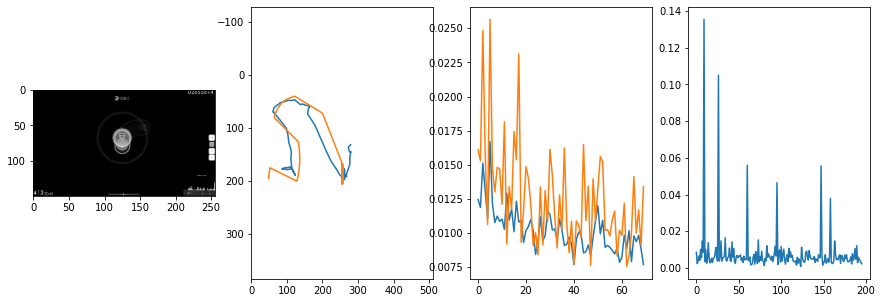


 76 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0036                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009011377505031509
outliers: 43
retrain: 8                 
val: 50/50 loss: 0.0053                                    
pred: 0.331590473651886 0.5450559854507446
gt: 0.7651170492172241 0.8122546076774597
(166, 112)


<Figure size 1080x360 with 0 Axes>

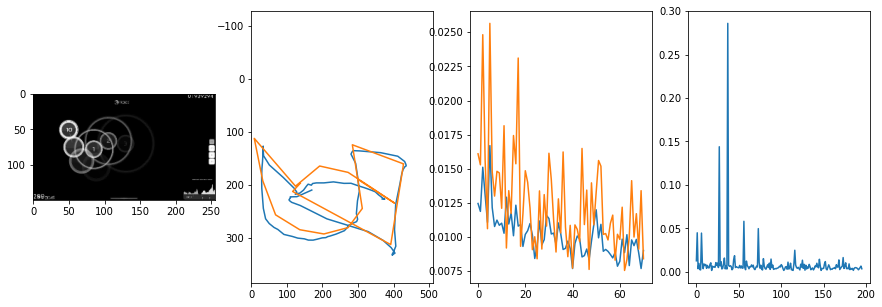


 77 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0068                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007668544686214086
outliers: 32
retrain: 8                 
val: 50/50 loss: 0.0049                                    
pred: 0.38791024684906006 0.5238826870918274
gt: 0.48177188634872437 0.5989657044410706
(122, 87)


<Figure size 1080x360 with 0 Axes>

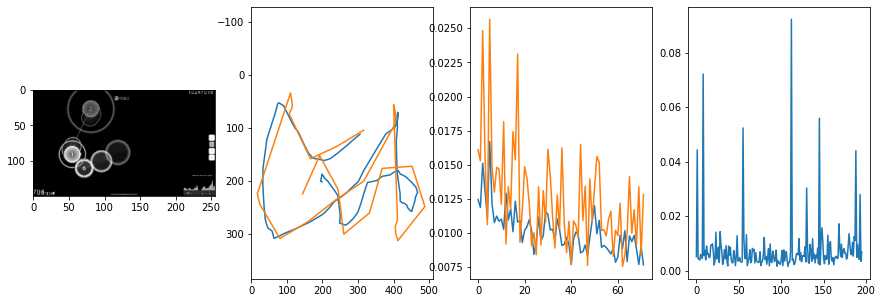


 78 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0066                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007493050484466652
outliers: 47
retrain: 8                 
val: 50/50 loss: 0.0049                                    
pred: 0.8556593656539917 0.13755778968334198
gt: 0.8750007748603821 0.27083438634872437
(183, 49)


<Figure size 1080x360 with 0 Axes>

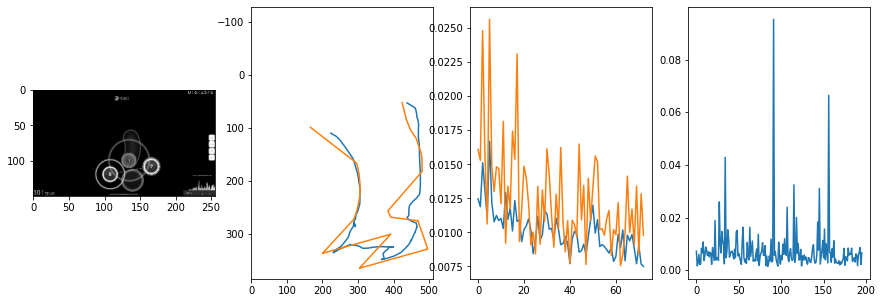


 79 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0048                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008535411414376706
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0195                                    
pred: 0.50461345911026 0.5711882710456848
gt: 0.49415579438209534 0.700541079044342
(124, 99)


<Figure size 1080x360 with 0 Axes>

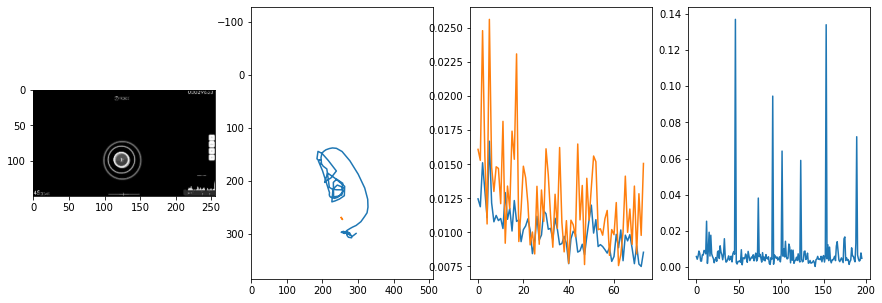


 80 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.93it/s  0.0022                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008445679590555042
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.0094                                    
pred: 0.2858175039291382 0.8607642650604248
gt: 0.16997596621513367 0.7474091053009033
(74, 104)


<Figure size 1080x360 with 0 Axes>

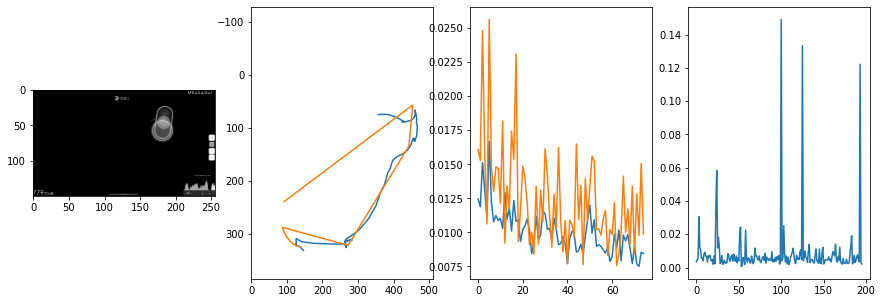


 81 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0044                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008110683838413952
outliers: 38
retrain: 8                 
val: 50/50 loss: 0.0044                                    
pred: 0.8067858815193176 0.858839750289917
gt: 0.78515625 0.5729166269302368
(169, 84)


<Figure size 1080x360 with 0 Axes>

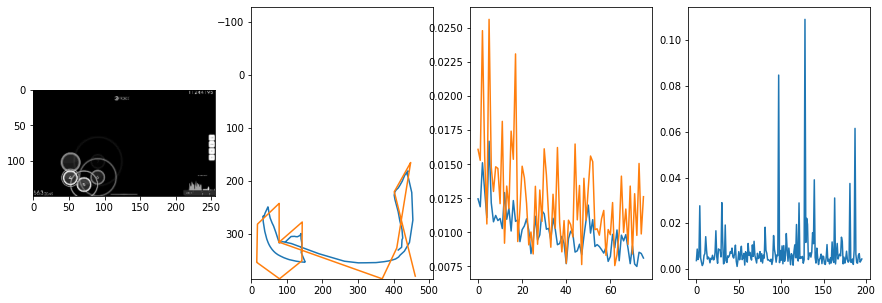


 82 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0031                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.013874935956163409
outliers: 70
retrain: 8                 
val: 50/50 loss: 0.0084                                    
pred: 0.8849713206291199 0.6761010885238647
gt: 0.8281177878379822 0.5286558270454407
(176, 79)


<Figure size 1080x360 with 0 Axes>

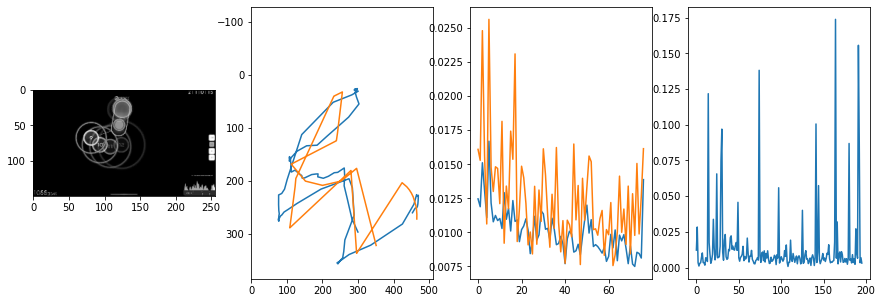


 83 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0027                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009992455200016575
outliers: 21
retrain: 8                 
val: 50/50 loss: 0.0084                                    
pred: 0.42871877551078796 0.23958152532577515
gt: 0.32204458117485046 0.20605595409870148
(97, 41)


<Figure size 1080x360 with 0 Axes>

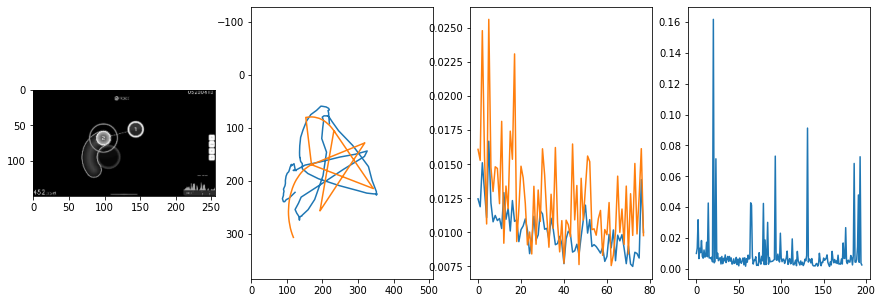


 84 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0130                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010618536904150126
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0066                                    
pred: 0.25486648082733154 0.8140093684196472
gt: 0.37109375 0.7760416865348816
(105, 108)


<Figure size 1080x360 with 0 Axes>

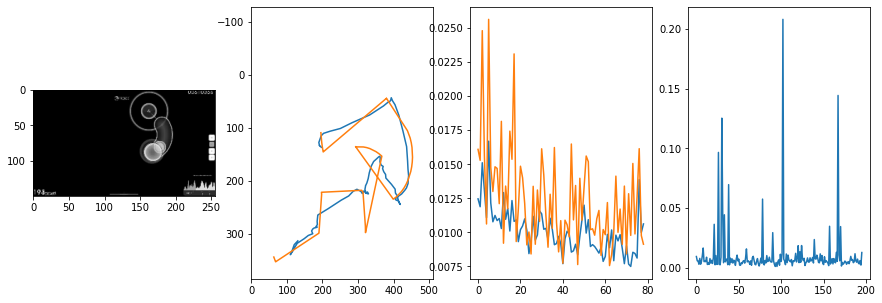


 85 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0050                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01244497713211173
outliers: 28
retrain: 8                 
val: 50/50 loss: 0.0060                                    
pred: 0.4845234155654907 0.5360252857208252
gt: 0.4236373007297516 0.5811635255813599
(113, 85)


<Figure size 1080x360 with 0 Axes>

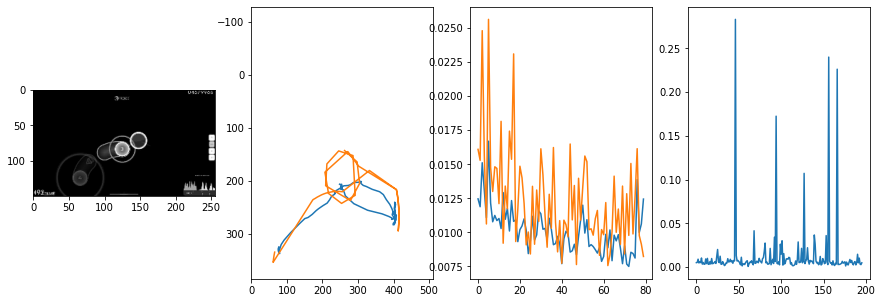


 86 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0066                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009858605022451897
outliers: 22
retrain: 8                 
val: 50/50 loss: 0.0124                                    
pred: 0.29568418860435486 0.183044895529747
gt: 0.25406500697135925 0.16310974955558777
(87, 36)


<Figure size 1080x360 with 0 Axes>

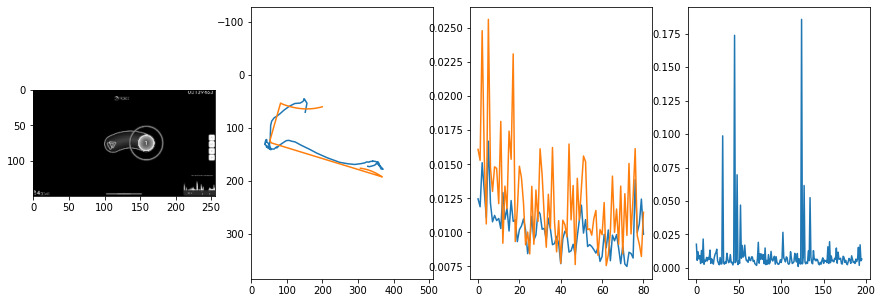


 87 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0047                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007288375605083052
outliers: 20
retrain: 8                 
val: 50/50 loss: 0.0079                                    
pred: 0.38929927349090576 0.4414186179637909
gt: 0.2910219132900238 0.40625452995300293
(93, 65)


<Figure size 1080x360 with 0 Axes>

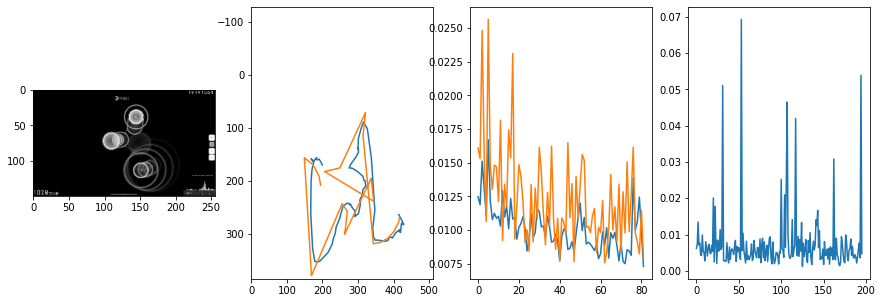


 88 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  0.0018                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009321952731068226
outliers: 48
retrain: 8                 
val: 50/50 loss: 0.0035                                    
pred: 0.1993025243282318 0.4836258292198181
gt: 0.23046875 0.6432291865348816
(83, 92)


<Figure size 1080x360 with 0 Axes>

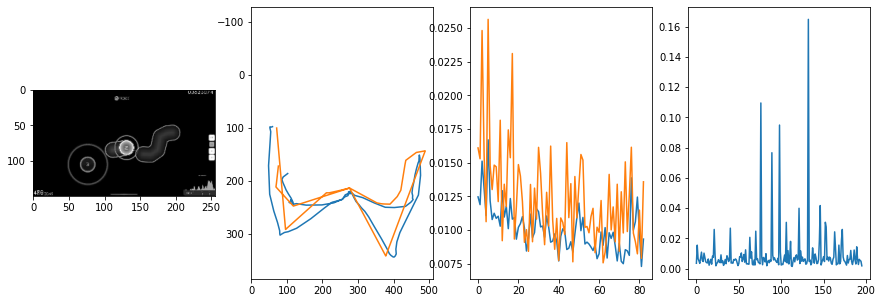


 89 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.0069                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00869511818716407
outliers: 34
retrain: 8                 
val: 50/50 loss: 0.0038                                    
pred: 0.7352082133293152 0.8978525996208191
gt: 0.3906251788139343 0.875
(108, 119)


<Figure size 1080x360 with 0 Axes>

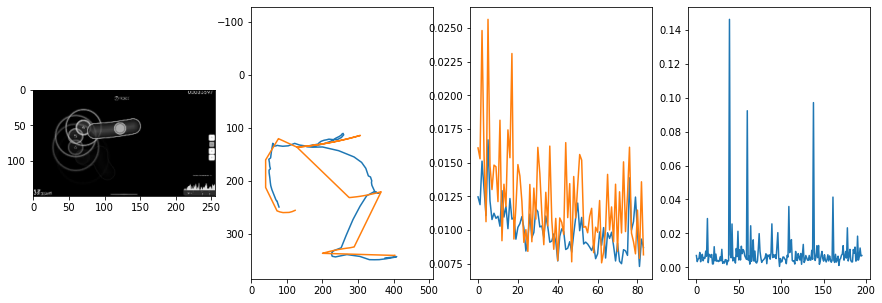


 90 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0066                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009893140428324173
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0043                                    
pred: 0.46493610739707947 0.5492481589317322
gt: 0.5260891318321228 0.5134745836257935
(129, 77)


<Figure size 1080x360 with 0 Axes>

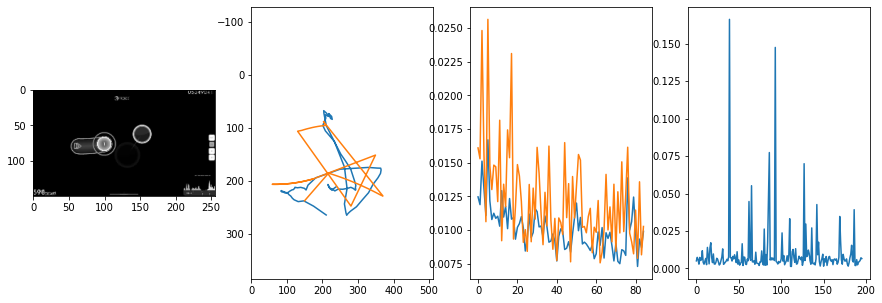


 91 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0079                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007923967272698956
outliers: 23
retrain: 8                 
val: 50/50 loss: 0.0015                                    
pred: 0.4840632975101471 0.7715339660644531
gt: 0.5234366059303284 0.6119894981384277
(129, 89)


<Figure size 1080x360 with 0 Axes>

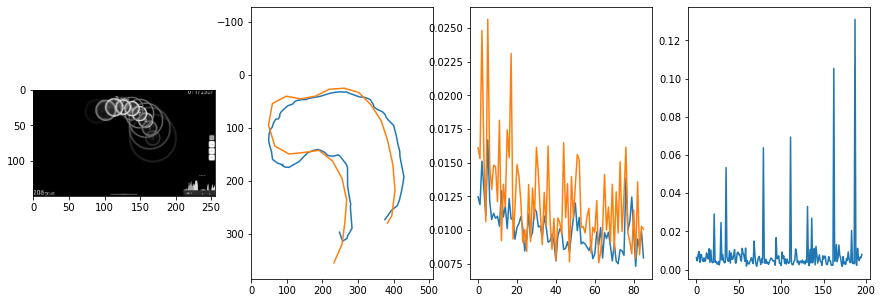


 92 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0037                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00749479582751816
outliers: 35
retrain: 8                 
val: 50/50 loss: 0.0017                                    
pred: 0.45883768796920776 0.10052003711462021
gt: 0.059605251997709274 0.545781135559082
(57, 81)


<Figure size 1080x360 with 0 Axes>

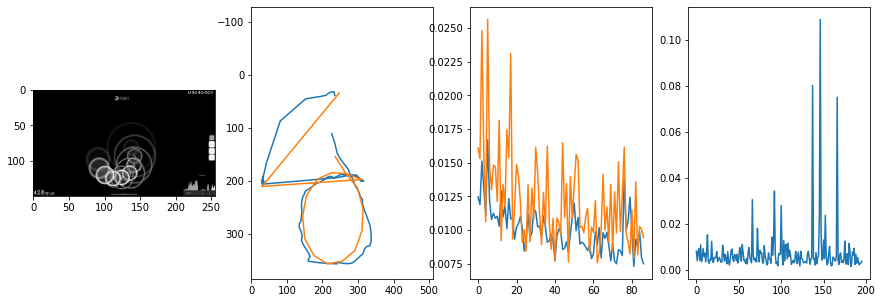


 93 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0120                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008831012540268806
outliers: 57
retrain: 8                 
val: 50/50 loss: 0.0100                                    
pred: 0.45336803793907166 0.5942780375480652
gt: 0.3006649315357208 0.7109375
(94, 100)


<Figure size 1080x360 with 0 Axes>

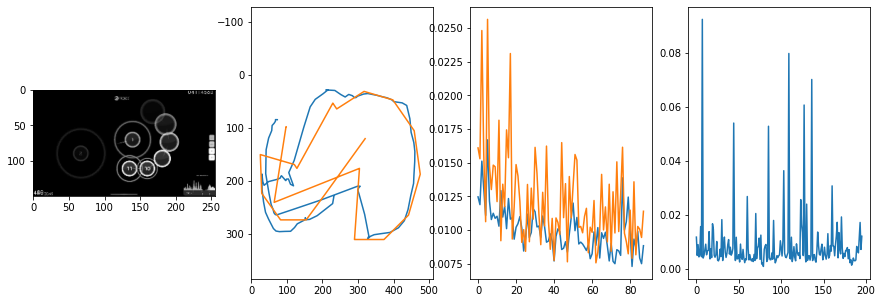


 94 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0085                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007491335611343764
outliers: 24
retrain: 8                 
val: 50/50 loss: 0.0027                                    
pred: 0.7340627312660217 0.5896822214126587
gt: 0.8047460317611694 0.5803458094596863
(172, 85)


<Figure size 1080x360 with 0 Axes>

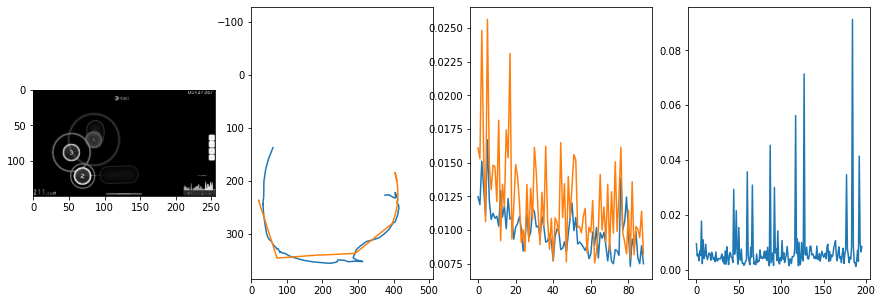


 95 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0037                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00590148658063429
outliers: 28
retrain: 8                 
val: 50/50 loss: 0.0026                                    
pred: 0.6028671264648438 0.8897270560264587
gt: 0.5234376192092896 0.8645715713500977
(129, 118)


<Figure size 1080x360 with 0 Axes>

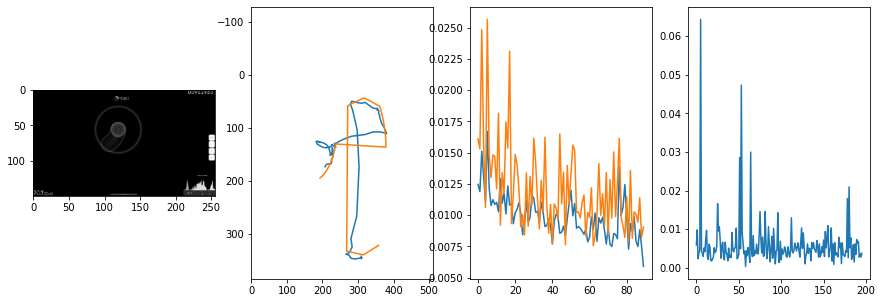


 96 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0072                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007191424267853572
outliers: 47
retrain: 8                 
val: 50/50 loss: 0.0108                                    
pred: 0.44951575994491577 0.46394601464271545
gt: 0.44774553179740906 0.6099997162818909
(117, 88)


<Figure size 1080x360 with 0 Axes>

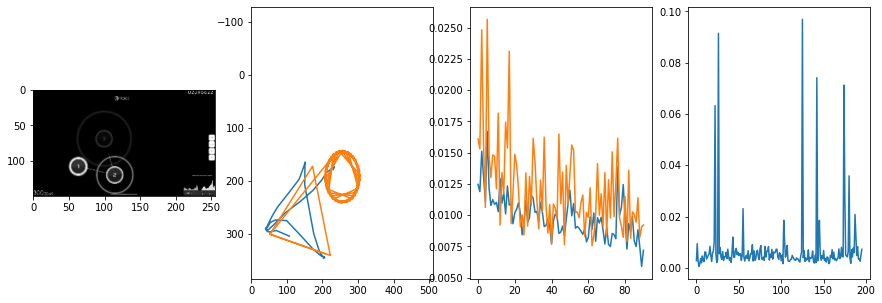


 97 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0045                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007494279128506457
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0022                                    
pred: 0.7118360996246338 0.5011460781097412
gt: 0.7164146304130554 0.519437849521637
(159, 78)


<Figure size 1080x360 with 0 Axes>

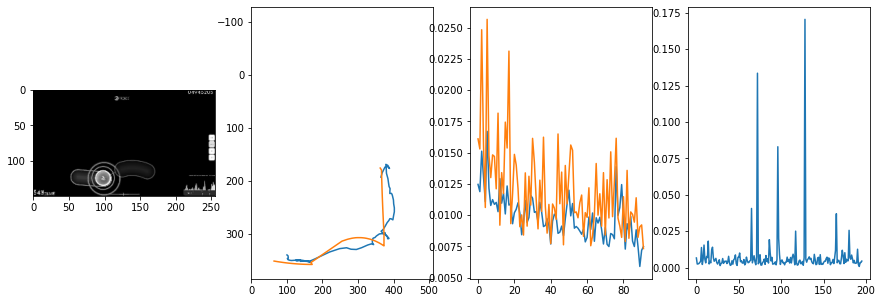


 98 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0041                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007963539448647514
outliers: 43
retrain: 8                 
val: 50/50 loss: 0.2087                                    
pred: 0.47211313247680664 0.6723857522010803
gt: 0.8164500594139099 0.42494678497314453
(174, 67)


<Figure size 1080x360 with 0 Axes>

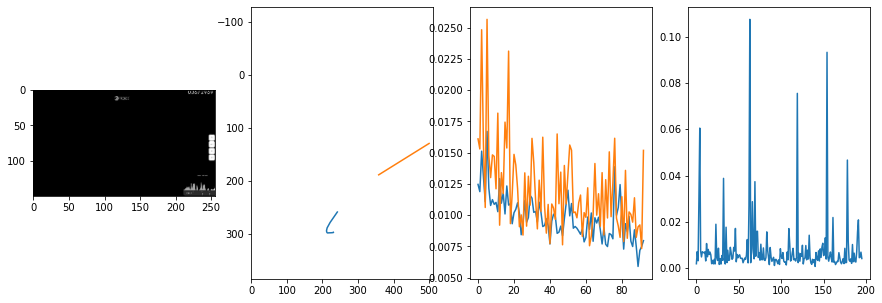


 99 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0022                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0062559859019975005
outliers: 32
retrain: 8                 
val: 50/50 loss: 0.0096                                    
pred: 0.4507197141647339 0.5301351547241211
gt: 0.45454302430152893 0.5145491361618042
(118, 77)


<Figure size 1080x360 with 0 Axes>

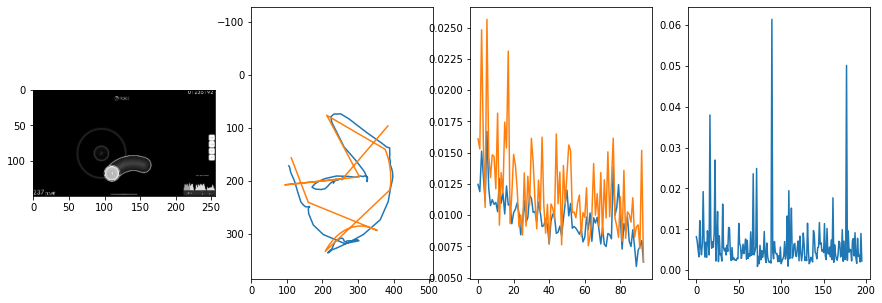


 100 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.89it/s  0.0026                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006940734413825451
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0031                                    
pred: 0.36473003029823303 0.9060822129249573
gt: 0.4314940869808197 0.9130372405052185
(114, 124)


<Figure size 1080x360 with 0 Axes>

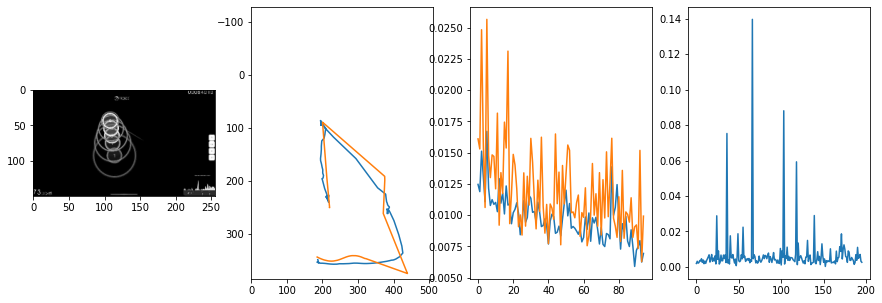


 101 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  0.0035                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0065996077996251
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.0050                                    
pred: 0.4828806221485138 0.7240926623344421
gt: 0.65625 0.6875
(149, 97)


<Figure size 1080x360 with 0 Axes>

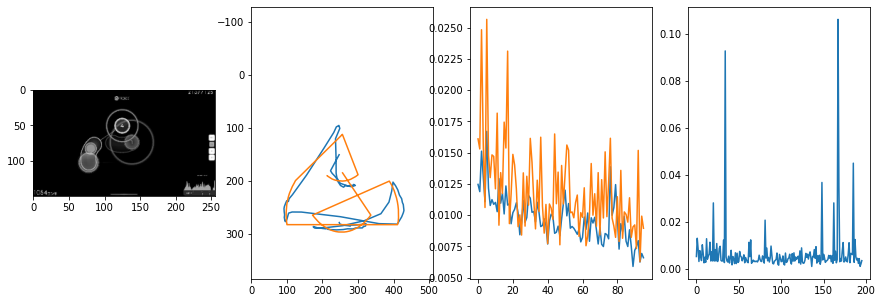


 102 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0029                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009371275625403077
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0035                                    
pred: 0.6171979308128357 0.4948596954345703
gt: 0.6094092130661011 0.3542122542858124
(142, 59)


<Figure size 1080x360 with 0 Axes>

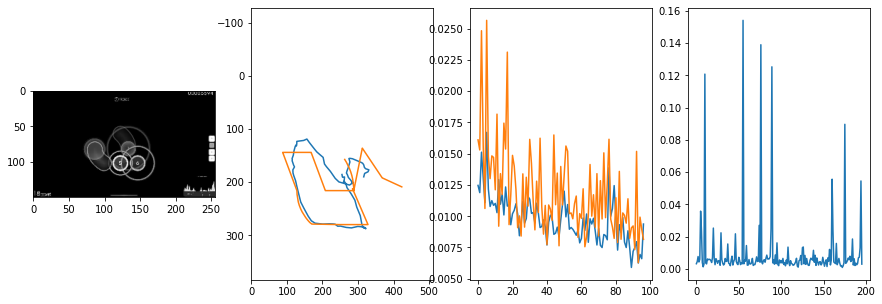


 103 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0037                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009170114169638527
outliers: 26
retrain: 8                 
val: 50/50 loss: 0.0028                                    
pred: 0.5439493656158447 0.5894153714179993
gt: 0.5481728911399841 0.4787348508834839
(133, 73)


<Figure size 1080x360 with 0 Axes>

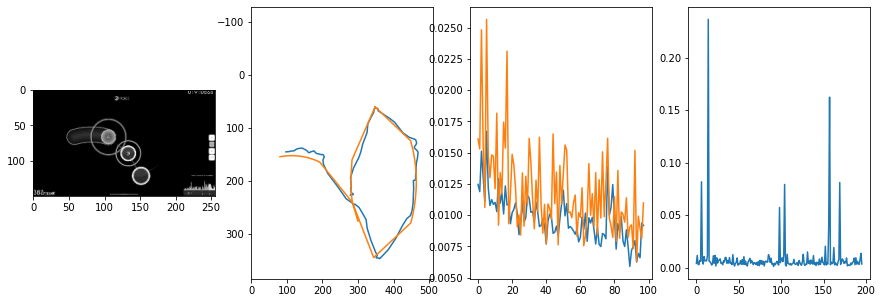


 104 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  0.0230                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006040007908286869
outliers: 16
retrain: 8                 
val: 50/50 loss: 0.0009                                    
pred: 0.8368105888366699 0.593782365322113
gt: 0.689453125 0.5807291865348816
(154, 85)


<Figure size 1080x360 with 0 Axes>

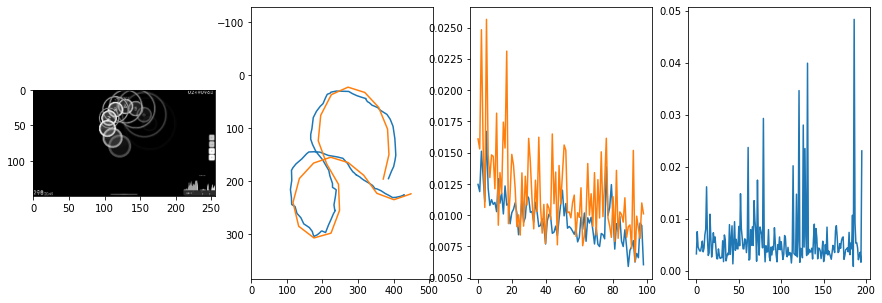


 105 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0027                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007010128056245609
outliers: 42
retrain: 8                 
val: 50/50 loss: 0.0096                                    
pred: 0.4972611665725708 0.6502535939216614
gt: 0.5447500944137573 0.7214080691337585
(132, 101)


<Figure size 1080x360 with 0 Axes>

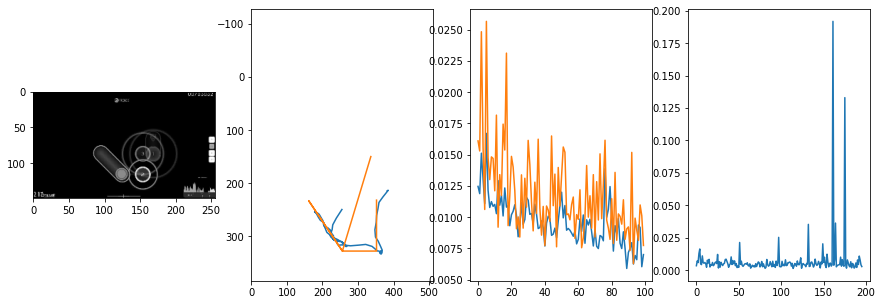


 106 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  0.0033                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007798201945605592
outliers: 44
retrain: 8                 
val: 50/50 loss: 0.0088                                    
pred: 0.2666148245334625 0.6107490658760071
gt: 0.38142499327659607 0.9311010837554932
(107, 126)


<Figure size 1080x360 with 0 Axes>

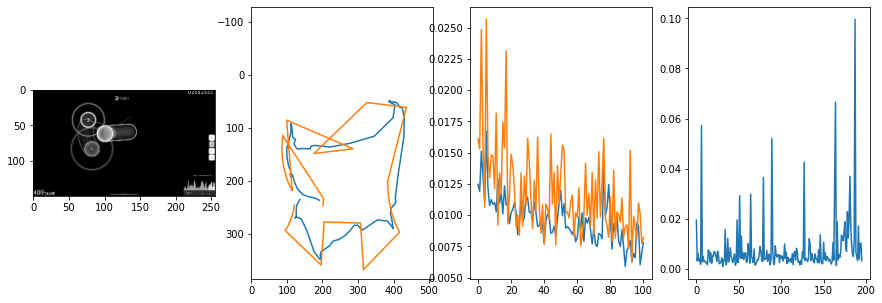


 107 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  0.0027                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007732729792205274
outliers: 40
retrain: 8                 
val: 50/50 loss: 0.0075                                    
pred: 0.34816697239875793 0.41077420115470886
gt: 0.58203125 0.5572916269302368
(138, 82)


<Figure size 1080x360 with 0 Axes>

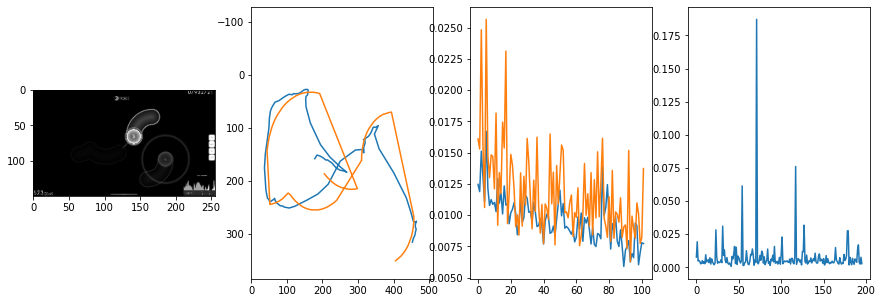


 108 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  0.0041                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007208301511127502
outliers: 29
retrain: 8                 
val: 50/50 loss: 0.0053                                    
pred: 0.2621414363384247 0.3624609112739563
gt: 0.2860172986984253 0.3684192895889282
(92, 60)


<Figure size 1080x360 with 0 Axes>

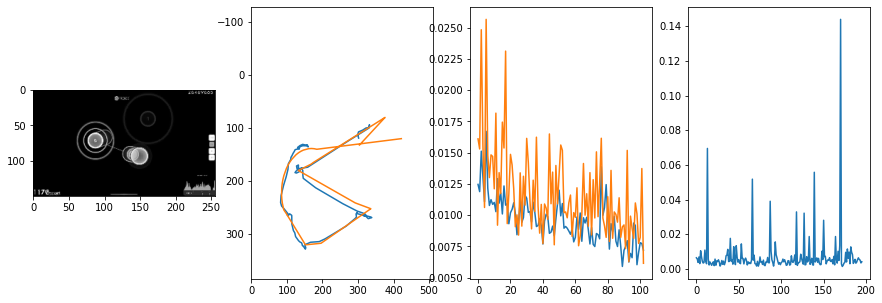


 109 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0028                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008316111406109447
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0078                                    
pred: 0.22425413131713867 0.17685307562351227
gt: 0.21093730628490448 0.4010452926158905
(80, 64)


<Figure size 1080x360 with 0 Axes>

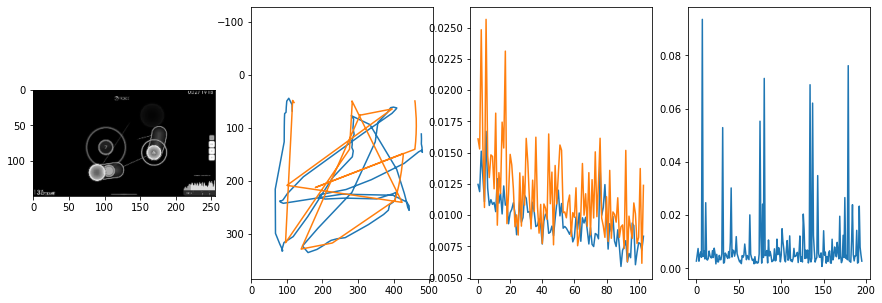


 110 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  0.0028                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007123187505069892
outliers: 23
retrain: 8                 
val: 50/50 loss: 0.0054                                    
pred: 0.48432299494743347 0.5088567137718201
gt: 0.29350918531417847 0.38440999388694763
(93, 62)


<Figure size 1080x360 with 0 Axes>

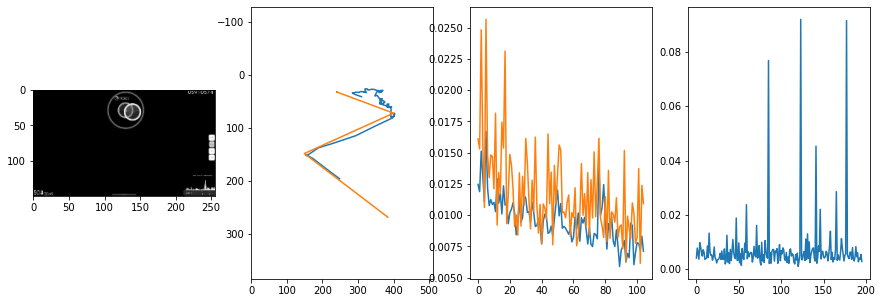


 111 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0047                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011319579162791714
outliers: 41
retrain: 8                 
val: 50/50 loss: 0.0075                                    
pred: 0.30298638343811035 0.8045433163642883
gt: 0.544921875 0.3463541567325592
(132, 58)


<Figure size 1080x360 with 0 Axes>

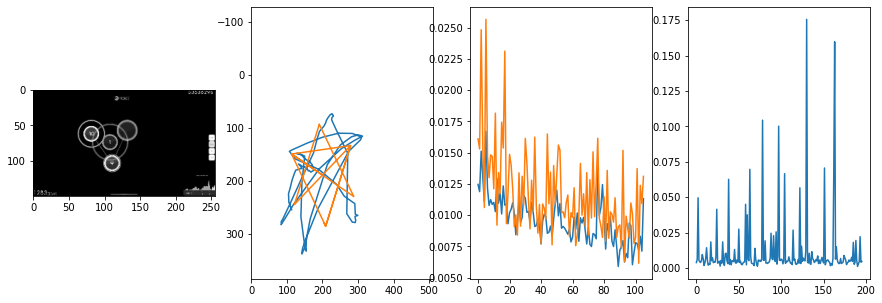


 112 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0055                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008714802102280818
outliers: 25
retrain: 8                 
val: 50/50 loss: 0.0185                                    
pred: 0.556251585483551 0.30457693338394165
gt: 0.7125895619392395 0.26776599884033203
(158, 49)


<Figure size 1080x360 with 0 Axes>

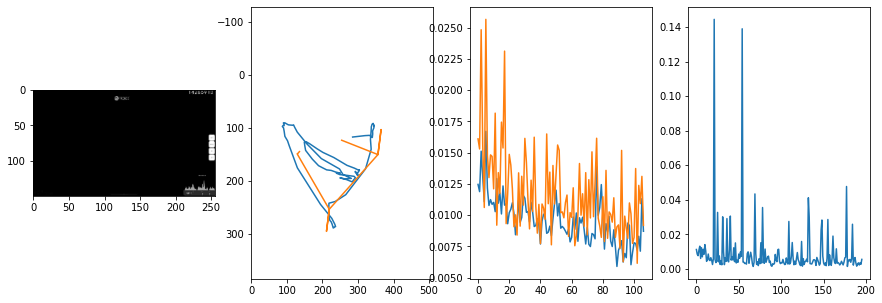


 113 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.91it/s  0.0028                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007649352437548092
outliers: 30
retrain: 8                 
val: 50/50 loss: 0.0029                                    
pred: 0.596062958240509 0.6356261968612671
gt: 0.5537498593330383 0.6864755153656006
(133, 97)


<Figure size 1080x360 with 0 Axes>

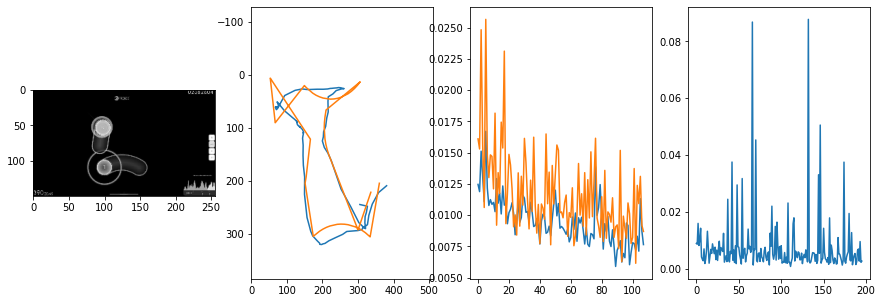


 114 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0090                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006908908768495241
outliers: 28
retrain: 8                 
val: 50/50 loss: 0.0106                                    
pred: 0.43580788373947144 0.7296236157417297
gt: 0.04687555134296417 0.9088463187217712
(55, 123)


<Figure size 1080x360 with 0 Axes>

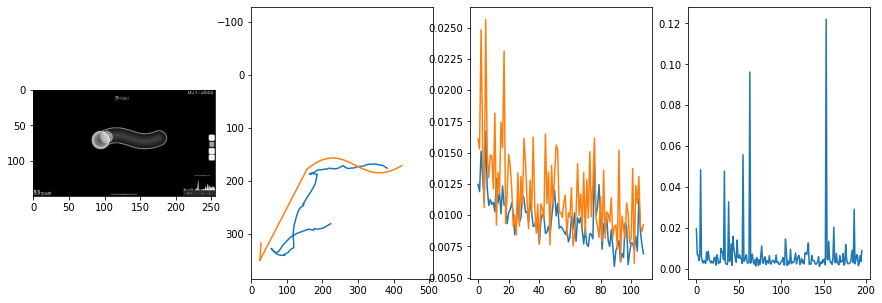


 115 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  0.0048                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006507700313909018
outliers: 39
retrain: 8                 
val: 50/50 loss: 0.0060                                    
pred: 0.6919893622398376 0.8738296031951904
gt: 0.22460941970348358 0.35937511920928955
(82, 59)


<Figure size 1080x360 with 0 Axes>

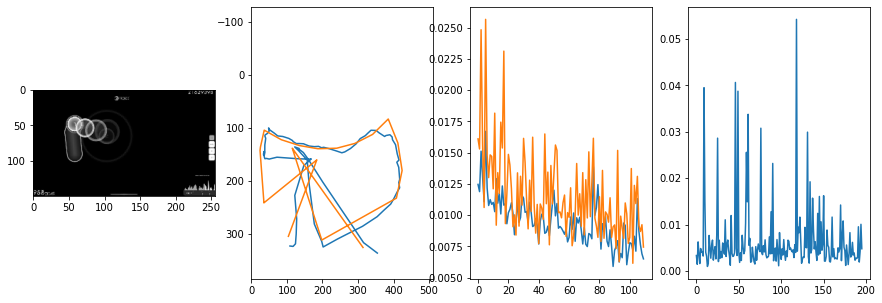


 116 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  0.0097                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008526625981844239
outliers: 48
retrain: 8                 
val: 50/50 loss: 0.0030                                    
pred: 0.5984448194503784 0.6210460066795349
gt: 0.5564700365066528 0.5062663555145264
(134, 76)


<Figure size 1080x360 with 0 Axes>

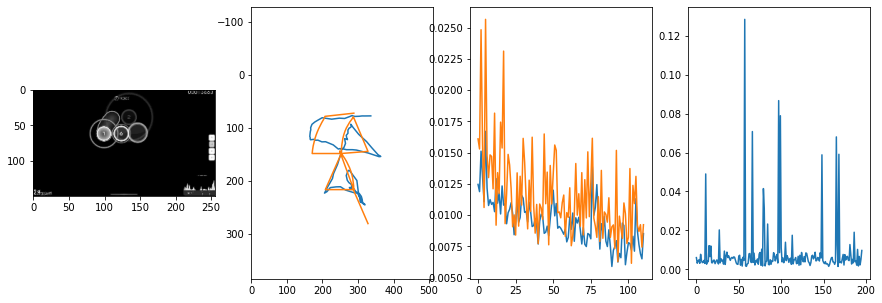


 117 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0089                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0072830633025103226
outliers: 23
retrain: 8                 
val: 50/50 loss: 0.0063                                    
pred: 0.1289239525794983 0.25502175092697144
gt: 0.14980904757976532 0.7202427983283997
(71, 101)


<Figure size 1080x360 with 0 Axes>

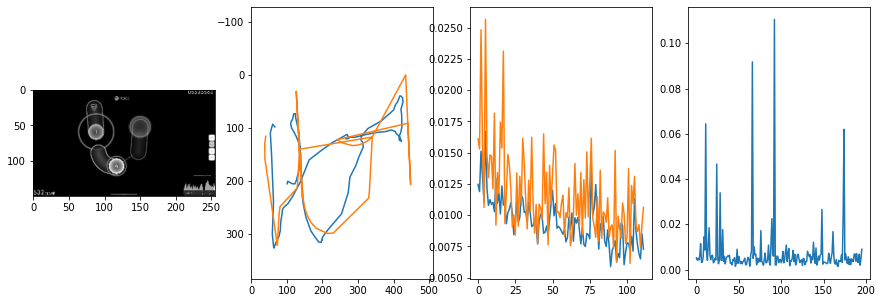


 118 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0100                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008742463841502155
outliers: 51
retrain: 8                 
val: 50/50 loss: 0.0048                                    
pred: 0.8518796563148499 0.3738122880458832
gt: 0.7160079479217529 0.3257027864456177
(159, 55)


<Figure size 1080x360 with 0 Axes>

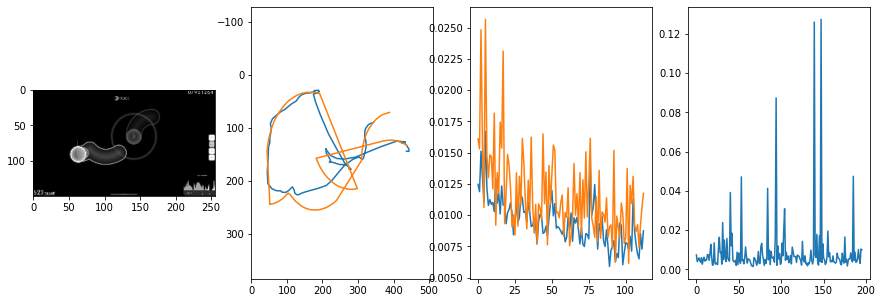


 119 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0018                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007219908803841575
outliers: 26
retrain: 8                 
val: 50/50 loss: 0.0127                                    
pred: 0.14535722136497498 0.5911720395088196
gt: 0.23240765929222107 0.3674542009830475
(84, 60)


<Figure size 1080x360 with 0 Axes>

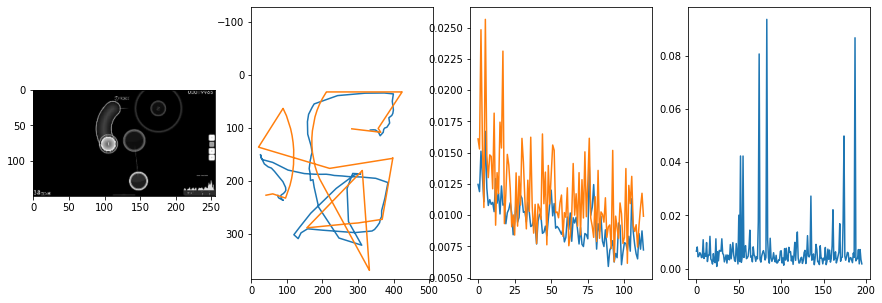


 120 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0046                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006500051779154574
outliers: 26
retrain: 8                 
val: 50/50 loss: 0.0107                                    
pred: 0.8478501439094543 0.5411806702613831
gt: 0.7467275857925415 0.7918913960456848
(163, 110)


<Figure size 1080x360 with 0 Axes>

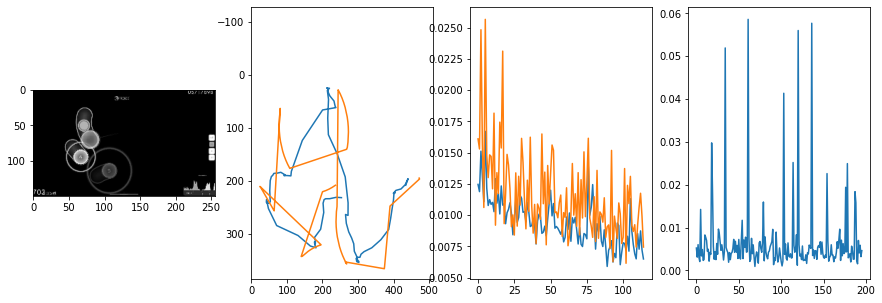


 121 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  0.0046                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007331778572121521
outliers: 54
retrain: 8                 
val: 50/50 loss: 0.0108                                    
pred: 0.34829533100128174 0.23693779110908508
gt: 0.5283594131469727 0.3148791193962097
(129, 54)


<Figure size 1080x360 with 0 Axes>

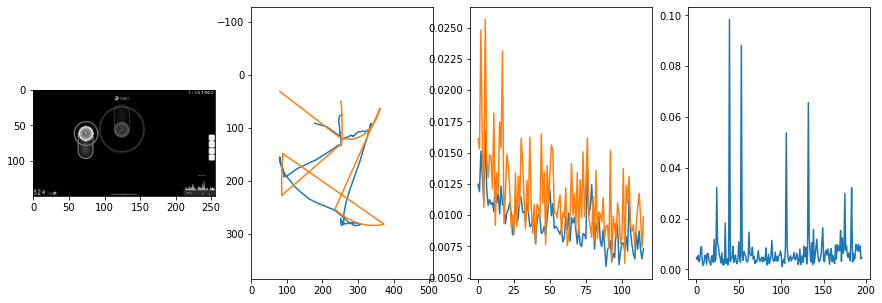


 122 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0186                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006764355968809877
outliers: 33
retrain: 8                 
val: 50/50 loss: 0.0063                                    
pred: 0.5968858599662781 0.7266994118690491
gt: 0.578125 0.625
(137, 90)


<Figure size 1080x360 with 0 Axes>

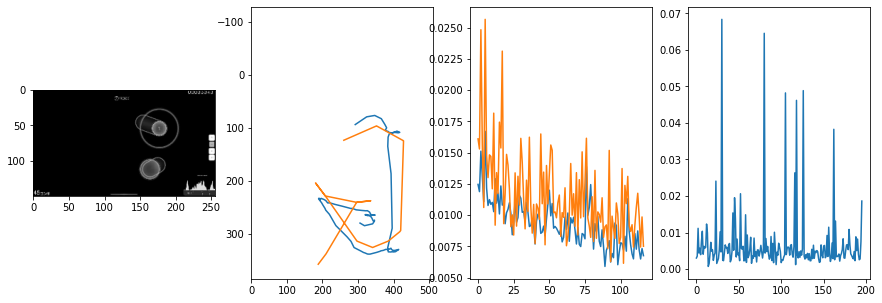


 123 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0068                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006516710495129608
outliers: 29
retrain: 8                 
val: 50/50 loss: 0.0061                                    
pred: 0.20109228789806366 0.3903169631958008
gt: 0.13476921617984772 0.2161625772714615
(68, 43)


<Figure size 1080x360 with 0 Axes>

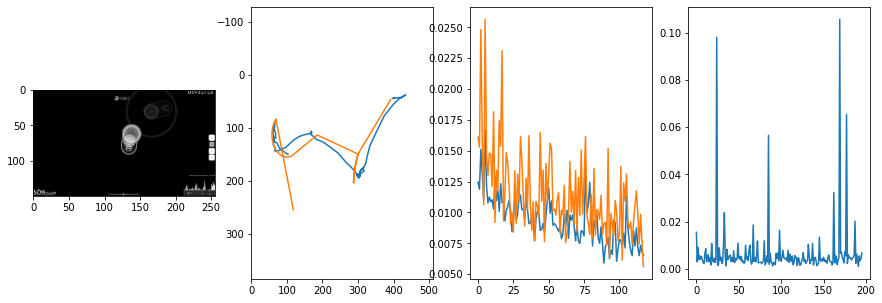


 124 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.84it/s  0.0036                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006148800004406699
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0025                                    
pred: 0.6501545906066895 0.8906027674674988
gt: 0.5736322402954102 0.9244126677513123
(136, 125)


<Figure size 1080x360 with 0 Axes>

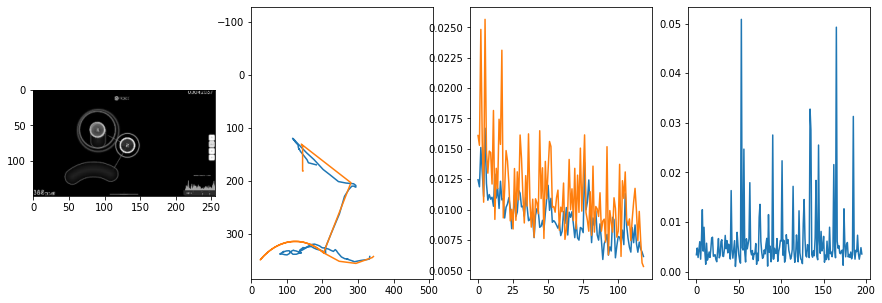


 125 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0032                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009397848223559368
outliers: 58
retrain: 8                 
val: 50/50 loss: 0.0058                                    
pred: 0.25404486060142517 0.18212324380874634
gt: 0.10378608852624893 0.07062361389398575
(64, 26)


<Figure size 1080x360 with 0 Axes>

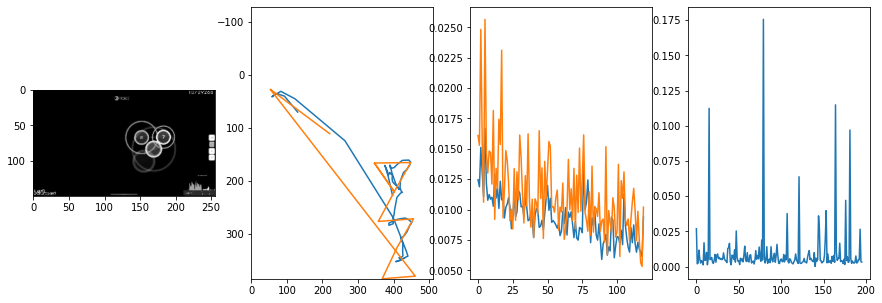


 126 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  0.0032                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0076054881400504735
outliers: 22
retrain: 8                 
val: 50/50 loss: 0.0042                                    
pred: 0.15376323461532593 0.30421558022499084
gt: 0.14566336572170258 0.27675148844718933
(70, 50)


<Figure size 1080x360 with 0 Axes>

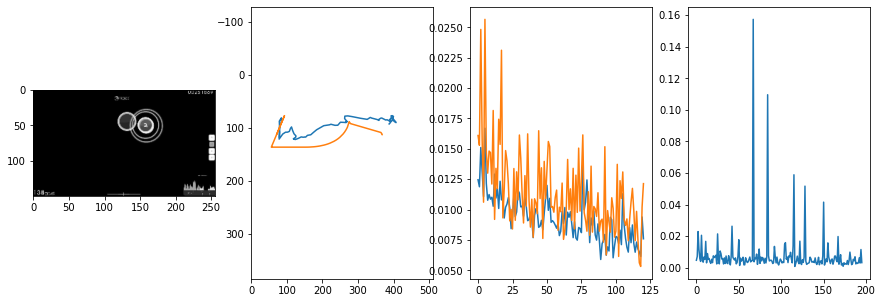


 127 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  0.0035                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010479773163714692
outliers: 37
retrain: 8                 
val: 50/50 loss: 0.0072                                    
pred: 0.253123939037323 0.7895250916481018
gt: 0.258255273103714 0.15747766196727753
(88, 36)


<Figure size 1080x360 with 0 Axes>

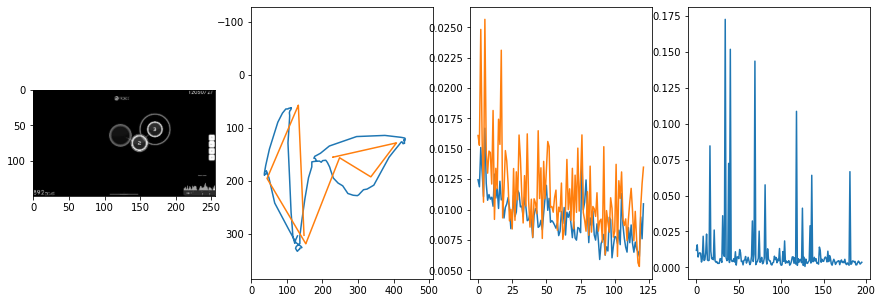


 128 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.88it/s  0.0069                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.01022297684673448
outliers: 24
retrain: 8                 
val: 50/50 loss: 0.0039                                    
pred: 0.36940068006515503 0.22234709560871124
gt: 0.3749942481517792 0.27607378363609314
(106, 50)


<Figure size 1080x360 with 0 Axes>

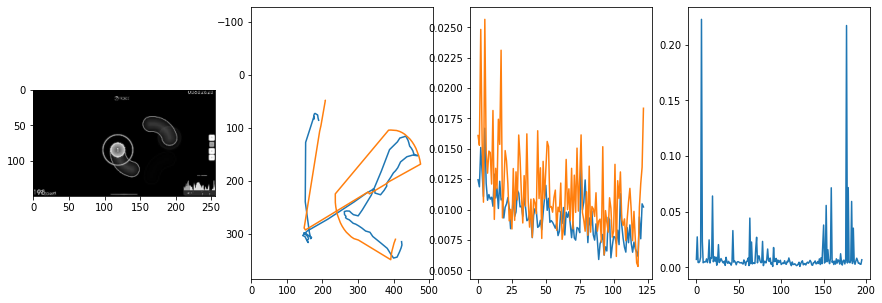


 129 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  0.0083                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0052374062242404535
outliers: 13
retrain: 8                 
val: 50/50 loss: 0.0254                                    
pred: 0.3541957139968872 0.6297902464866638
gt: 0.4999749958515167 0.4999755620956421
(125, 76)


<Figure size 1080x360 with 0 Axes>

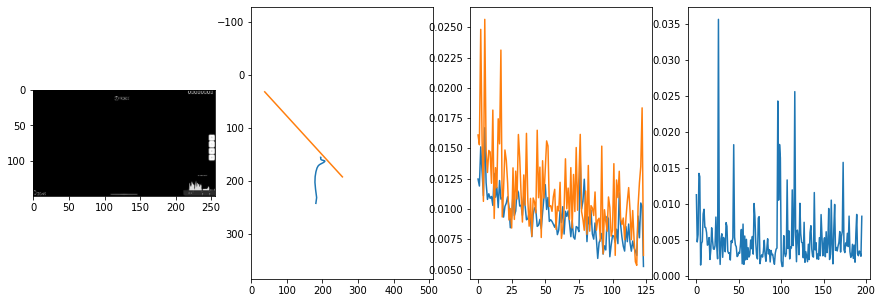


 130 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.87it/s  0.0017                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010165385197793437
outliers: 78
retrain: 8                 
val: 50/50 loss: 0.0037                                    
pred: 0.2087741643190384 0.19260211288928986
gt: 0.33569544553756714 0.22007574141025543
(100, 43)


<Figure size 1080x360 with 0 Axes>

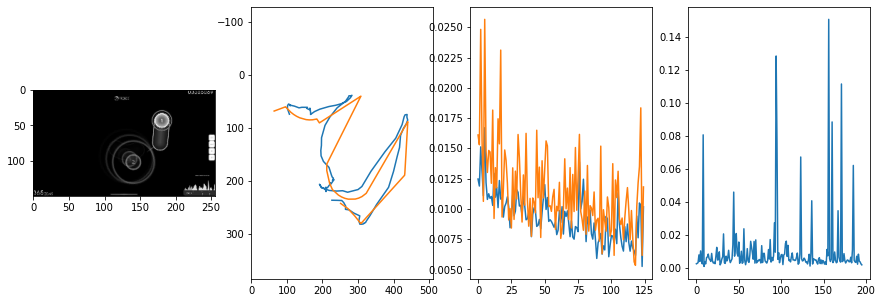


 131 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  0.0026                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007398258674918313
outliers: 23
retrain: 8                 
val: 50/50 loss: 0.0042                                    
pred: 0.8756609559059143 0.8403634428977966
gt: 0.8886067867279053 0.39421483874320984
(185, 63)


<Figure size 1080x360 with 0 Axes>

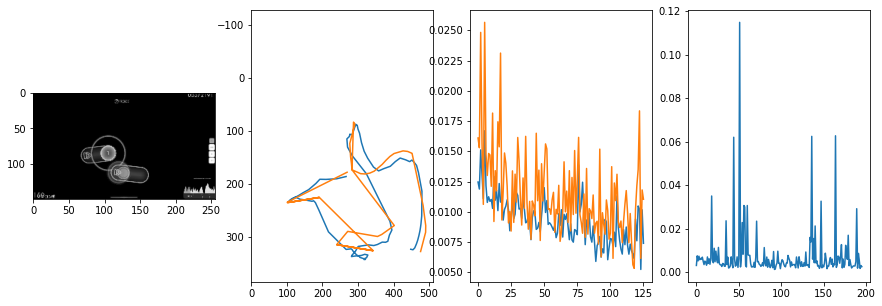


 132 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.65it/s  0.0023                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005974390032007454
outliers: 31
retrain: 8                 
val: 50/50 loss: 0.0039                                    
pred: 0.651252806186676 0.09381621330976486
gt: 0.736328125 0.0911458358168602
(162, 28)


<Figure size 1080x360 with 0 Axes>

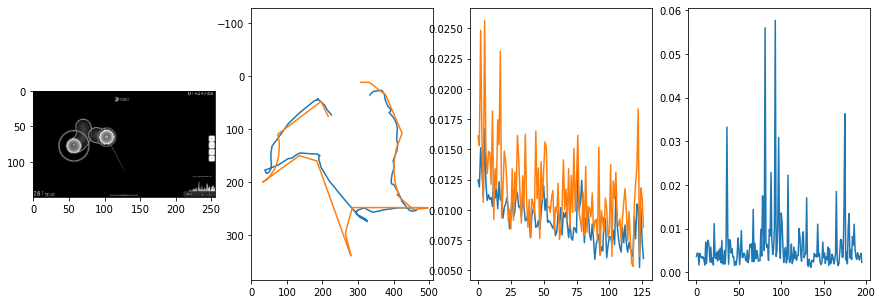


 133 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.93it/s  0.0597                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007656540867471022
outliers: 49
retrain: 8                 
val: 50/50 loss: 0.0072                                    
pred: 0.5222004652023315 0.5364383459091187
gt: 0.871654748916626 0.12834525108337402
(183, 32)


<Figure size 1080x360 with 0 Axes>

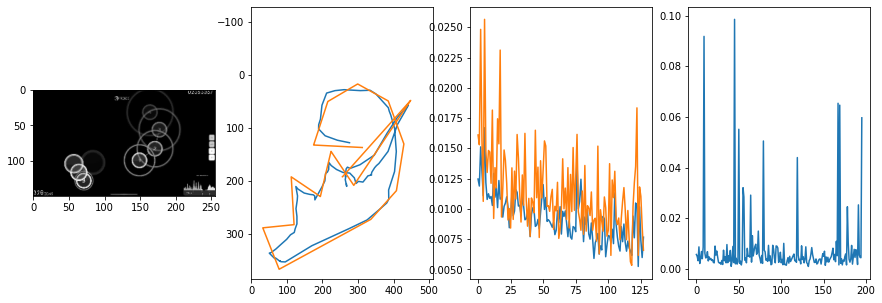


 134 of 134
4381.17630815506 secs


In [41]:
start = time.time()

epochs = 128
loss_thresh = 0.0005
rnum_min = 8
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [42]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

0.005328830602811649


In [43]:
seq_dur = 1
best_loss = 9999

In [44]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

1 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.32it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007295235201813832
outliers: 0

val: 50/50 loss: 0.0030                                    
pred: 0.3157106041908264 0.713738203048706
gt: 0.17182406783103943 0.39341720938682556
(74, 63)


<Figure size 1080x360 with 0 Axes>

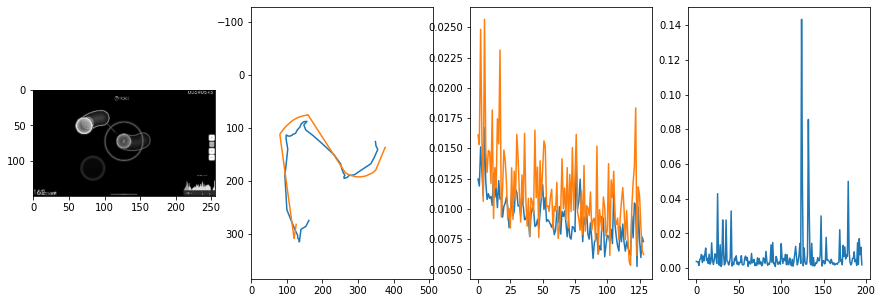


 135 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0018                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006063075590348917
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0033                                    
pred: 0.34892362356185913 0.7580224275588989
gt: 0.28392237424850464 0.7932997345924377
(92, 110)


<Figure size 1080x360 with 0 Axes>

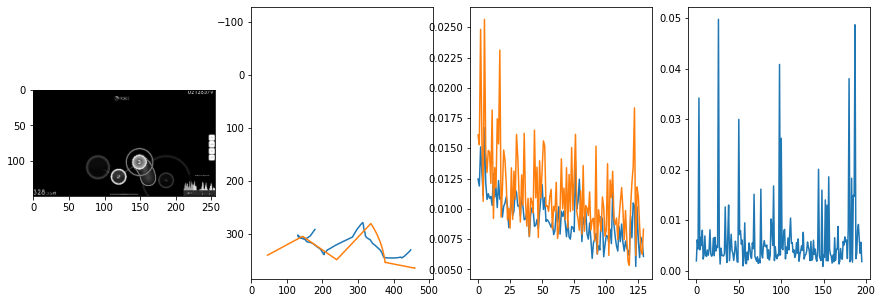


 136 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  0.0082                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00649542744421134
outliers: 53
retrain: 4                 
val: 50/50 loss: 0.0065                                    
pred: 0.374405175447464 0.4367290735244751
gt: 0.3359375298023224 0.21875004470348358
(100, 43)


<Figure size 1080x360 with 0 Axes>

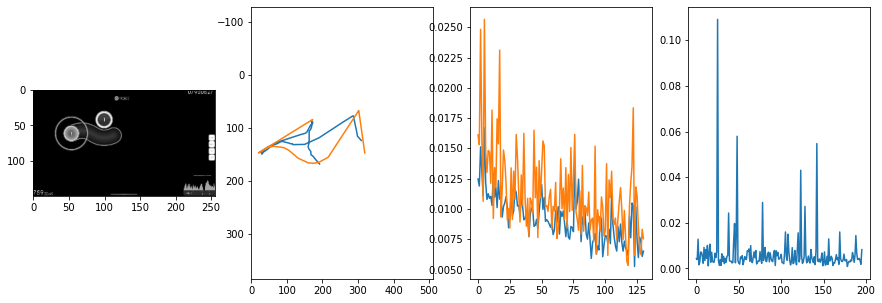


 137 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0025                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005989599335351863
outliers: 47
retrain: 4                 
val: 50/50 loss: 0.0055                                    
pred: 0.42347633838653564 0.4180925786495209
gt: 0.46875 0.08333335071802139
(120, 27)


<Figure size 1080x360 with 0 Axes>

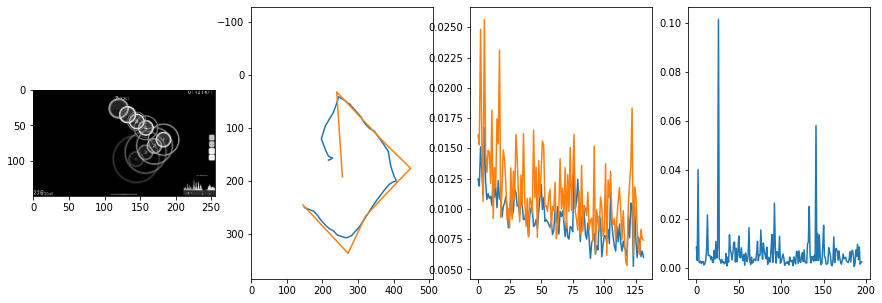


 138 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0408                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007519257880927881
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.0015                                    
pred: 0.45968401432037354 0.2185867875814438
gt: 0.31640625 0.2005208283662796
(97, 41)


<Figure size 1080x360 with 0 Axes>

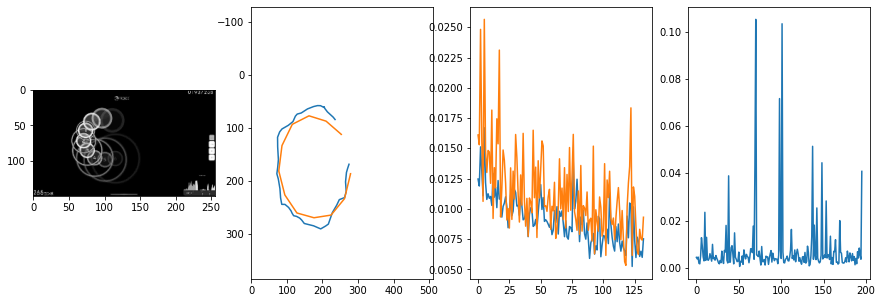


 139 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.0117                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0065776287139707
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.0122                                    
pred: 0.3118019104003906 0.53544682264328
gt: 0.53125 0.3567708432674408
(130, 59)


<Figure size 1080x360 with 0 Axes>

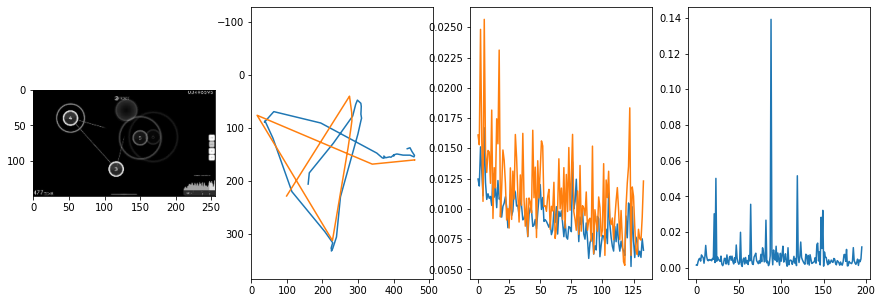


 140 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.0124                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008583028333045408
outliers: 57
retrain: 4                 
val: 50/50 loss: 0.0218                                    
pred: 0.6843598484992981 0.8080272674560547
gt: 0.3542029559612274 0.6151500940322876
(102, 89)


<Figure size 1080x360 with 0 Axes>

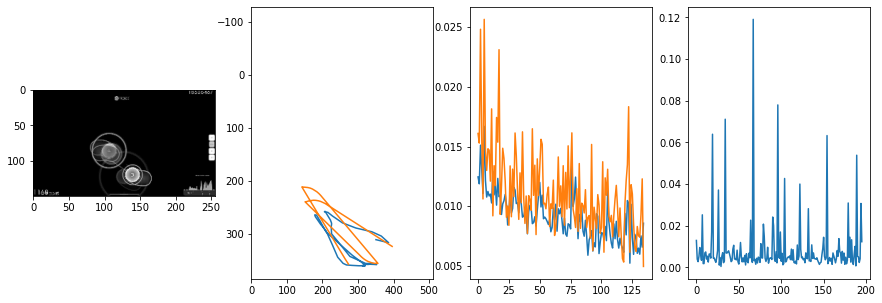


 141 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0046                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007510766341548166
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.0052                                    
pred: 0.7760564088821411 0.6089653968811035
gt: 0.8045799136161804 0.5918644070625305
(172, 86)


<Figure size 1080x360 with 0 Axes>

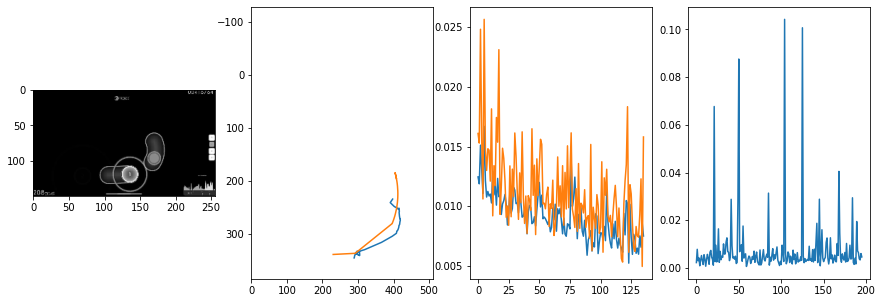


 142 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0150                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00992950885372512
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.0068                                    
pred: 0.40544983744621277 0.155382439494133
gt: 0.3736250698566437 0.23514579236507416
(105, 45)


<Figure size 1080x360 with 0 Axes>

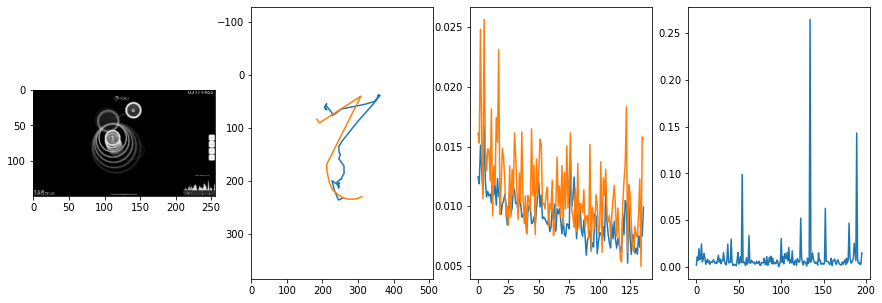


 143 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00840820092054521
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0041                                    
pred: 0.33384793996810913 0.2396100014448166
gt: 0.2005840688943863 0.2367856502532959
(79, 45)


<Figure size 1080x360 with 0 Axes>

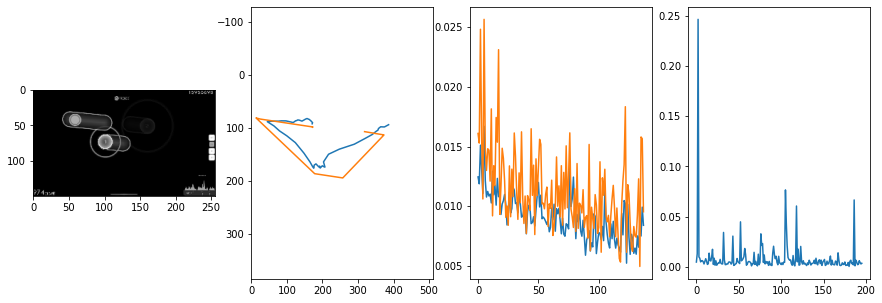


 144 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.0038                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007365578815533437
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0042                                    
pred: 0.31005027890205383 0.9052924513816833
gt: 0.21650755405426025 0.8913002014160156
(81, 121)


<Figure size 1080x360 with 0 Axes>

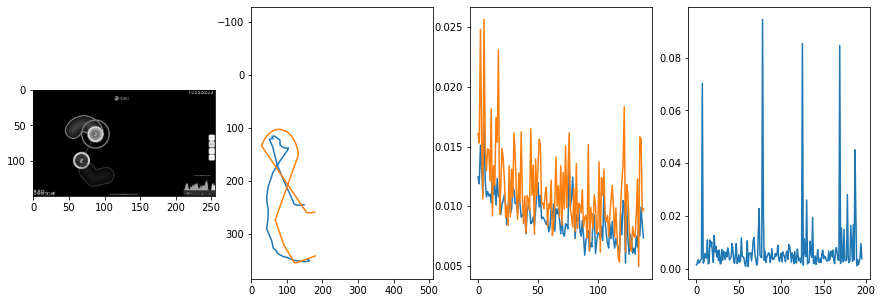


 145 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.81it/s  0.0255                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00939777438149892
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0102                                    
pred: 0.23569411039352417 0.35992446541786194
gt: 0.505141019821167 0.3922314941883087
(126, 63)


<Figure size 1080x360 with 0 Axes>

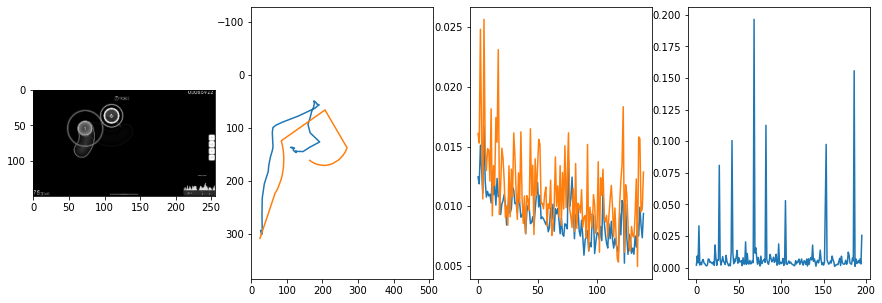


 146 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.0105                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007906463546904127
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0131                                    
pred: 0.47412312030792236 0.3959452211856842
gt: 0.2500019371509552 0.3020833730697632
(86, 53)


<Figure size 1080x360 with 0 Axes>

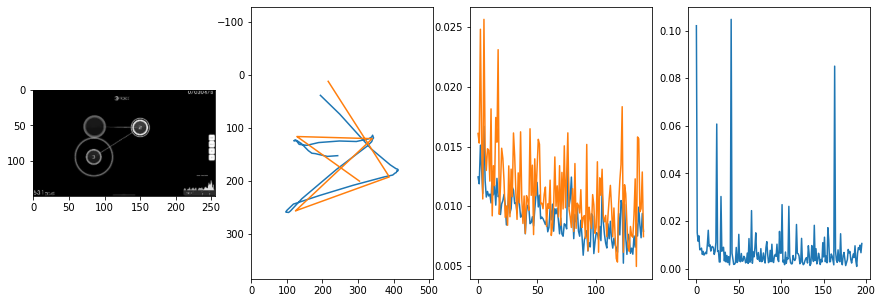


 147 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0025                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006311301982424659
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0010                                    
pred: 0.813521146774292 0.42035552859306335
gt: 0.3924158811569214 0.3028964698314667
(108, 53)


<Figure size 1080x360 with 0 Axes>

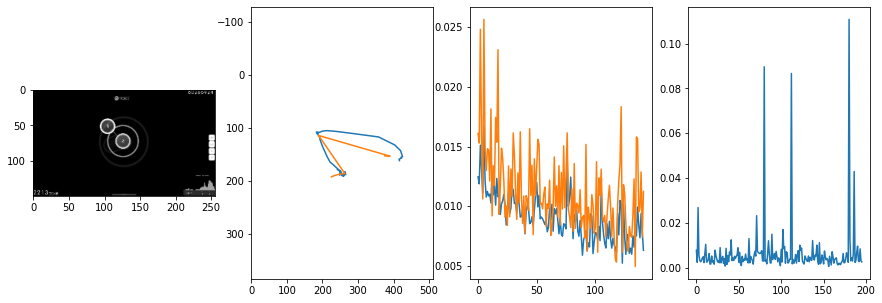


 148 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0026                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007333869244000513
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.0211                                    
pred: 0.362557977437973 0.4048132002353668
gt: 0.5 0.5000001192092896
(125, 76)


<Figure size 1080x360 with 0 Axes>

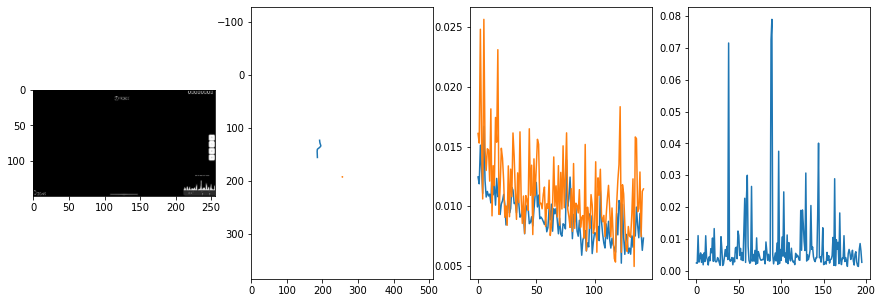


 149 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006614765431791335
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0019                                    
pred: 0.25012633204460144 0.5158374905586243
gt: 0.11050000041723251 0.1979166716337204
(65, 41)


<Figure size 1080x360 with 0 Axes>

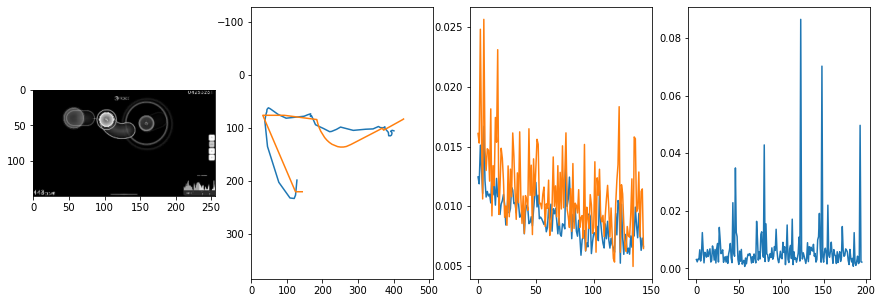


 150 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  0.0060                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006866181729752238
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0044                                    
pred: 0.5221026539802551 0.8248264789581299
gt: 0.12500008940696716 0.9999999403953552
(67, 134)


<Figure size 1080x360 with 0 Axes>

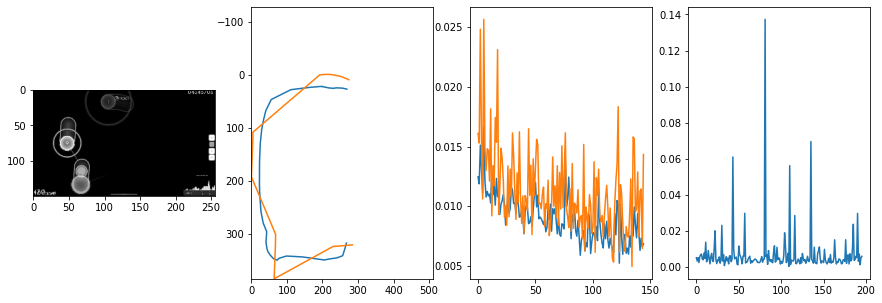


 151 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006845194789668906
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.7495521306991577 0.5441509485244751
gt: 0.7371611595153809 0.47028085589408875
(162, 72)


<Figure size 1080x360 with 0 Axes>

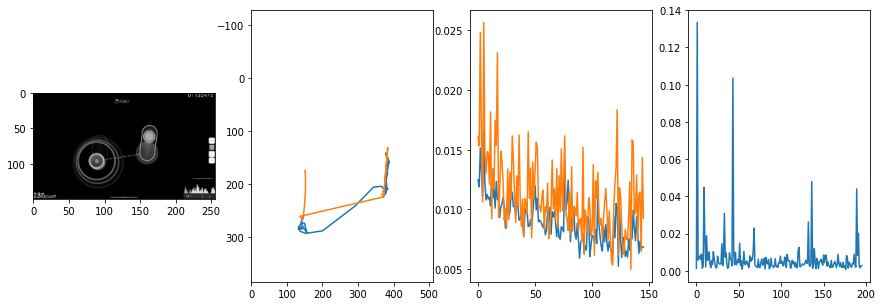


 152 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0074                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007636651838060507
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.0074                                    
pred: 0.3404602110385895 0.4802049398422241
gt: 0.84375 0.4166666567325592
(178, 66)


<Figure size 1080x360 with 0 Axes>

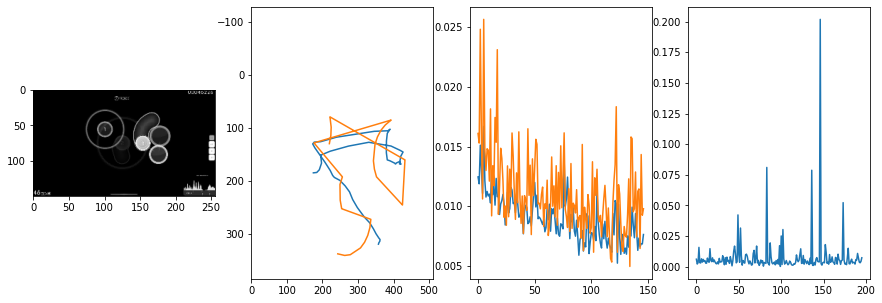


 153 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0048                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008249878979582643
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0067                                    
pred: 0.43328994512557983 0.16715435683727264
gt: 0.041015755385160446 0.7968747019767761
(54, 110)


<Figure size 1080x360 with 0 Axes>

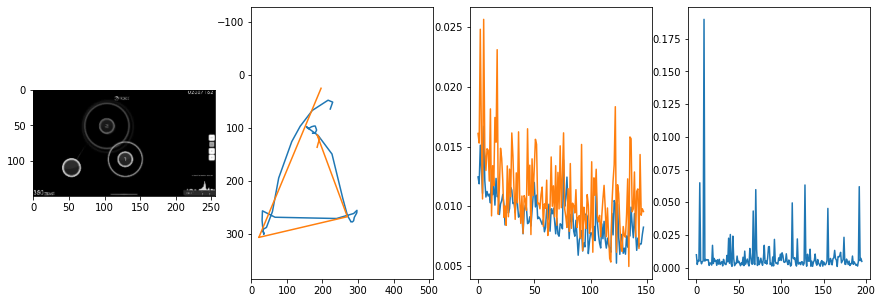


 154 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007719090839489173
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0092                                    
pred: 0.7566700577735901 0.8330581188201904
gt: 0.6862343549728394 0.8394582867622375
(154, 115)


<Figure size 1080x360 with 0 Axes>

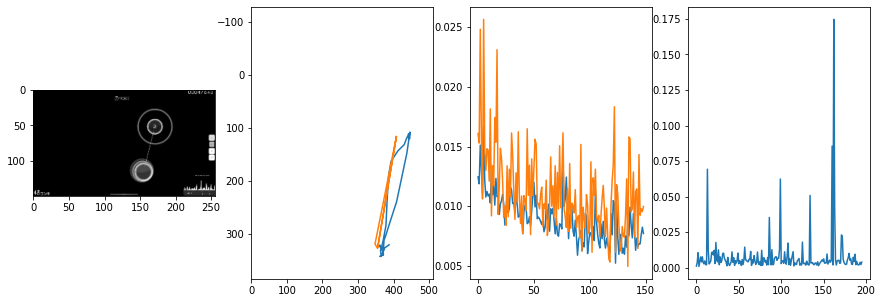


 155 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0066497361166307665
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0040                                    
pred: 0.5005345940589905 0.6253520846366882
gt: 0.4183124899864197 0.578583300113678
(112, 85)


<Figure size 1080x360 with 0 Axes>

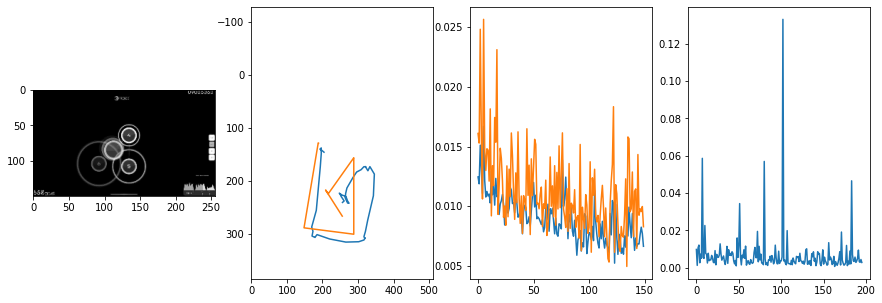


 156 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0072                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009408339768219311
outliers: 55
retrain: 4                 
val: 50/50 loss: 0.0152                                    
pred: 0.4537692964076996 0.21664777398109436
gt: 0.7984488010406494 0.6905059218406677
(171, 98)


<Figure size 1080x360 with 0 Axes>

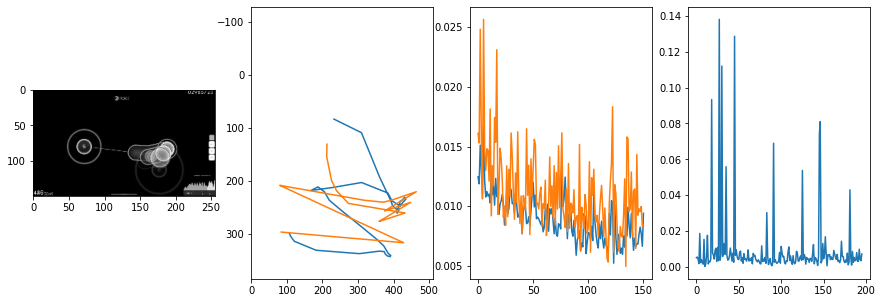


 157 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.0075                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006964946827347562
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0025                                    
pred: 0.30054569244384766 0.8849412202835083
gt: 0.4070894122123718 0.9301897883415222
(111, 126)


<Figure size 1080x360 with 0 Axes>

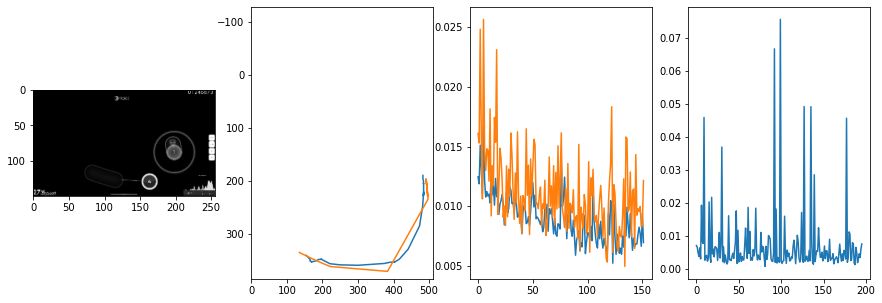


 158 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0048                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008275113138607798
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0055                                    
pred: 0.20298528671264648 0.6745705008506775
gt: 0.5066721439361572 0.8692574501037598
(126, 119)


<Figure size 1080x360 with 0 Axes>

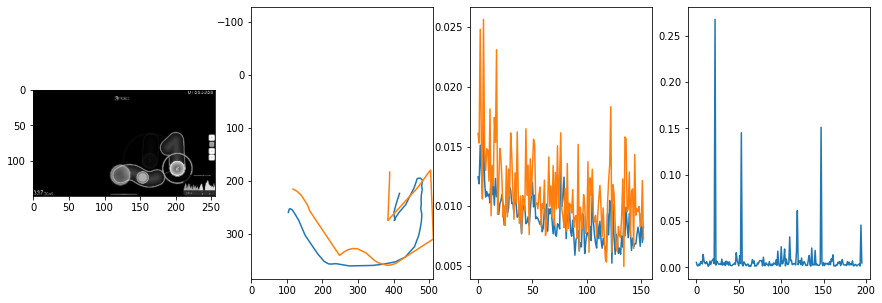


 159 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0100                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009628412947213106
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.0047                                    
pred: 0.5079501867294312 0.4854057729244232
gt: 0.3997226357460022 0.2552727162837982
(109, 47)


<Figure size 1080x360 with 0 Axes>

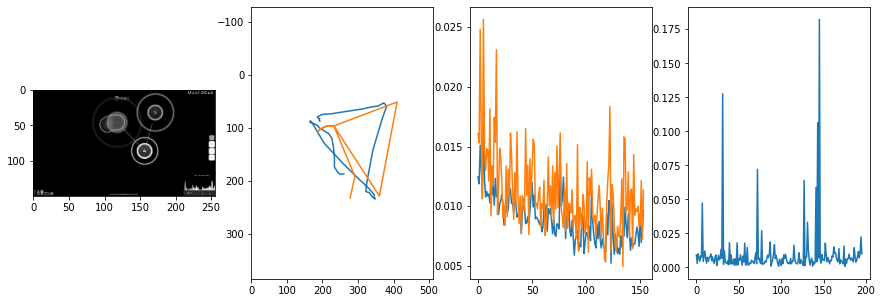


 160 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007379278425383857
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0397                                    
pred: 0.43889549374580383 0.4217148423194885
gt: 0.5625001192092896 0.19791674613952637
(135, 41)


<Figure size 1080x360 with 0 Axes>

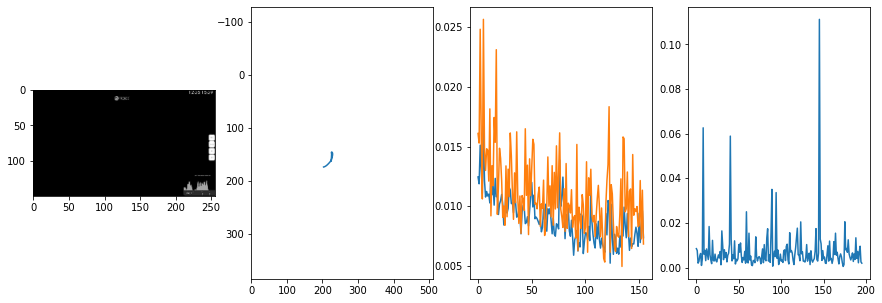


 161 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0086                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008198577741384315
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.0045                                    
pred: 0.2721861004829407 0.6974121332168579
gt: 0.2713136374950409 0.5875368714332581
(90, 86)


<Figure size 1080x360 with 0 Axes>

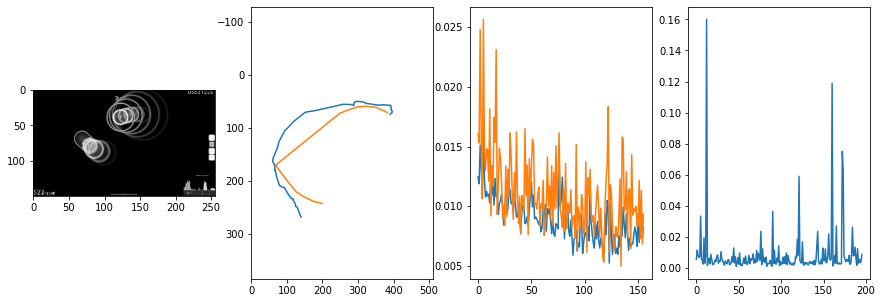


 162 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007162906495588166
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0045                                    
pred: 0.4827724099159241 0.5640120506286621
gt: 0.18254880607128143 0.4899301528930664
(76, 74)


<Figure size 1080x360 with 0 Axes>

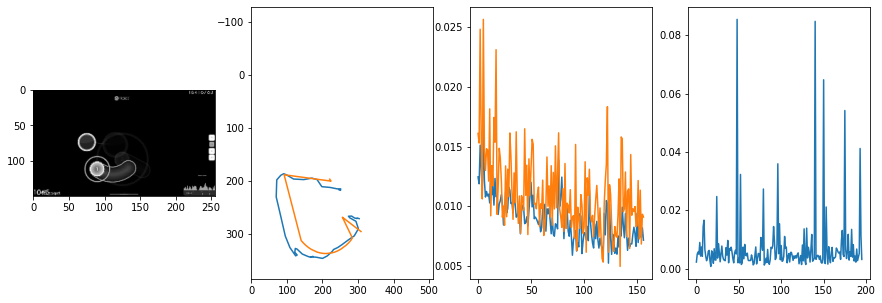


 163 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0098                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006572126251424434
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0267                                    
pred: 0.8461780548095703 0.855042576789856
gt: 0.6615443825721741 0.06700368225574493
(150, 25)


<Figure size 1080x360 with 0 Axes>

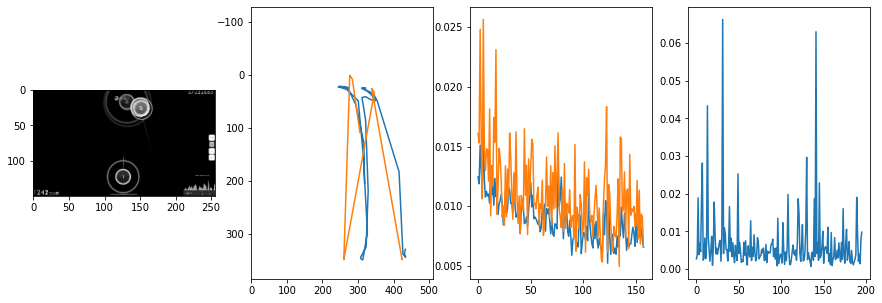


 164 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0016                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0076264284975228035
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.0051                                    
pred: 0.5756167769432068 0.45108434557914734
gt: 0.5001073479652405 0.4997836649417877
(125, 76)


<Figure size 1080x360 with 0 Axes>

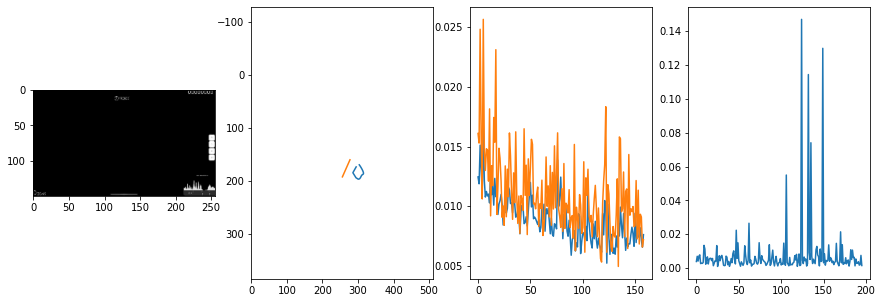


 165 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007864107481175463
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0047                                    
pred: 0.6114117503166199 0.9387926459312439
gt: 0.6177778244018555 0.8332658410072327
(143, 114)


<Figure size 1080x360 with 0 Axes>

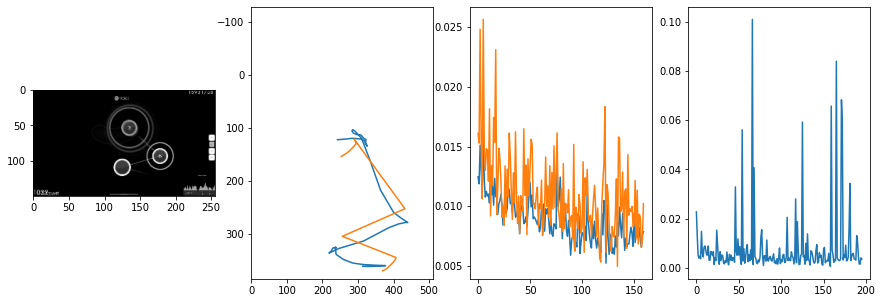


 166 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  0.0508                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008906254253964348
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0029                                    
pred: 0.6259255409240723 0.9339175224304199
gt: 0.5039059519767761 0.9609372615814209
(126, 129)


<Figure size 1080x360 with 0 Axes>

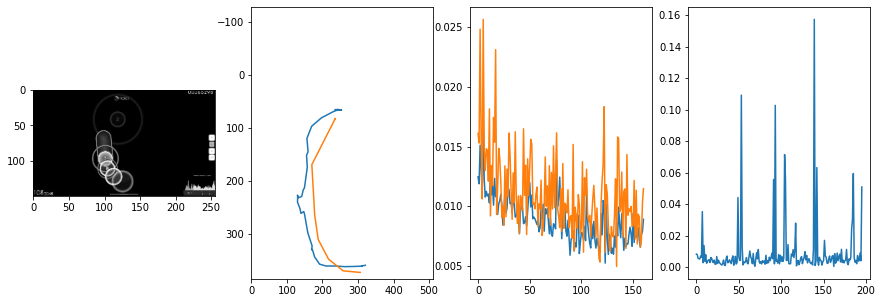


 167 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.0046                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005867460468779223
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.0037                                    
pred: 0.6583210825920105 0.7504532933235168
gt: 0.5859375 0.7916666865348816
(138, 110)


<Figure size 1080x360 with 0 Axes>

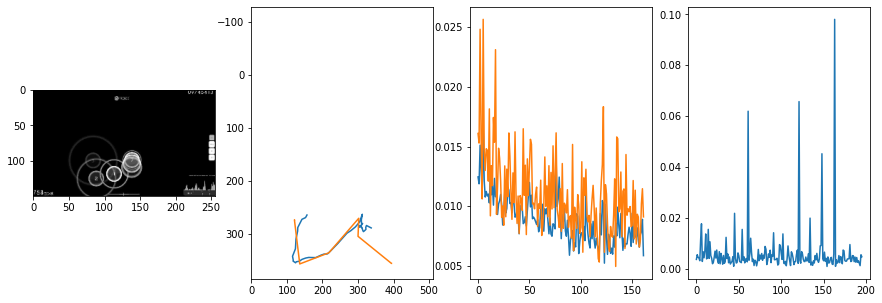


 168 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0032                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008313633925317102
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.0030                                    
pred: 0.42635950446128845 0.799360990524292
gt: 0.3496094346046448 0.47135427594184875
(102, 72)


<Figure size 1080x360 with 0 Axes>

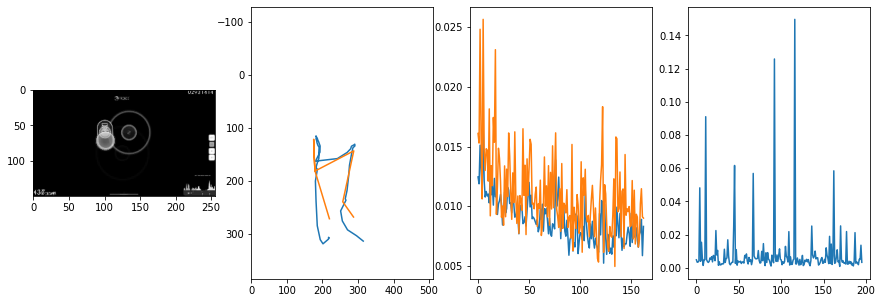


 169 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0035                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007252971505109525
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0030                                    
pred: 0.7096215486526489 0.17964813113212585
gt: 0.7764623165130615 0.16365836560726166
(168, 37)


<Figure size 1080x360 with 0 Axes>

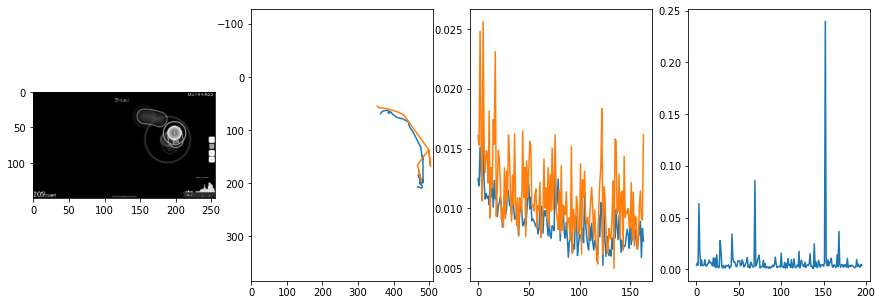


 170 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0053                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005730657300161084
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0071                                    
pred: 0.6299181580543518 0.23589655756950378
gt: 0.6023394465446472 0.1366531103849411
(141, 33)


<Figure size 1080x360 with 0 Axes>

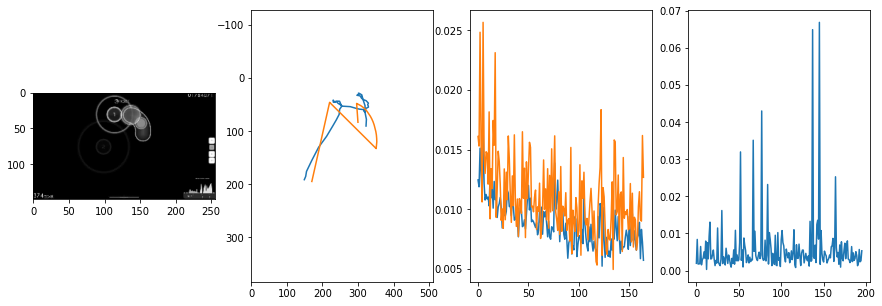


 171 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0084                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00853435373811612
outliers: 47
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.5225996971130371 0.5199570655822754
gt: 0.5814234614372253 0.571891188621521
(138, 84)


<Figure size 1080x360 with 0 Axes>

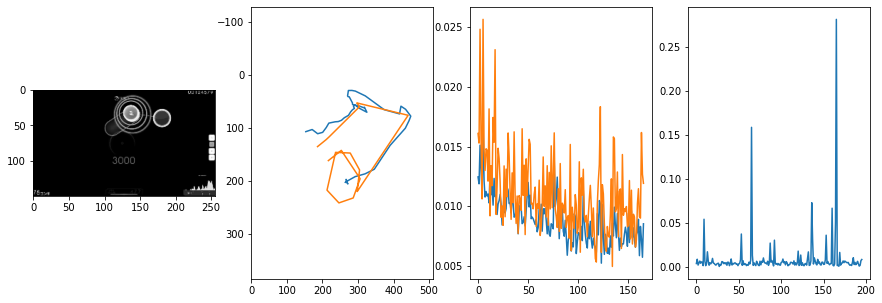


 172 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0034                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008061261059435996
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.7216103672981262 0.8987716436386108
gt: 0.5000431537628174 0.9166588187217712
(125, 124)


<Figure size 1080x360 with 0 Axes>

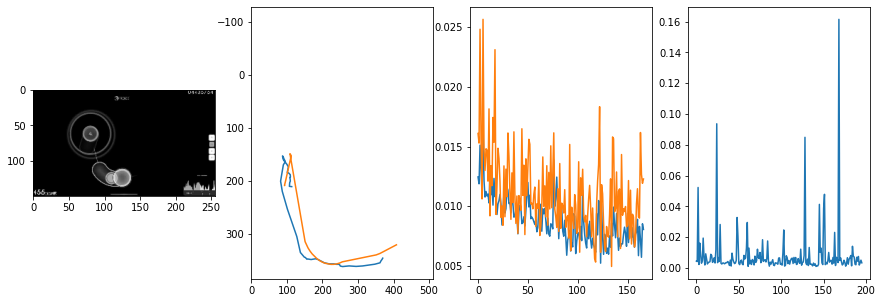


 173 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.32it/s  0.0043                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008274178379108389
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0070                                    
pred: 0.5002692341804504 0.39530932903289795
gt: 0.41471490263938904 0.6574233770370483
(112, 94)


<Figure size 1080x360 with 0 Axes>

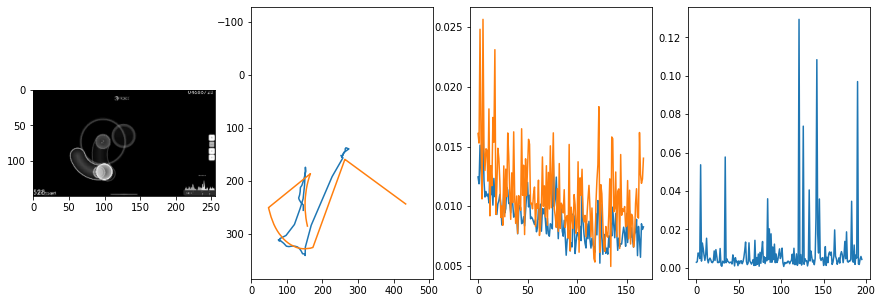


 174 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0517                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006201179949946853
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0019                                    
pred: 0.5603334903717041 0.6180524826049805
gt: 0.7583035230636597 0.6860165596008301
(165, 97)


<Figure size 1080x360 with 0 Axes>

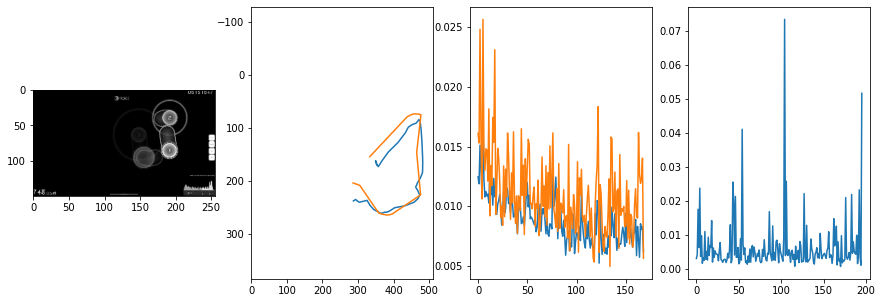


 175 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0033                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007007523014775016
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.0035                                    
pred: 0.43425634503364563 0.7380465865135193
gt: 0.3685946762561798 0.4676326811313629
(105, 72)


<Figure size 1080x360 with 0 Axes>

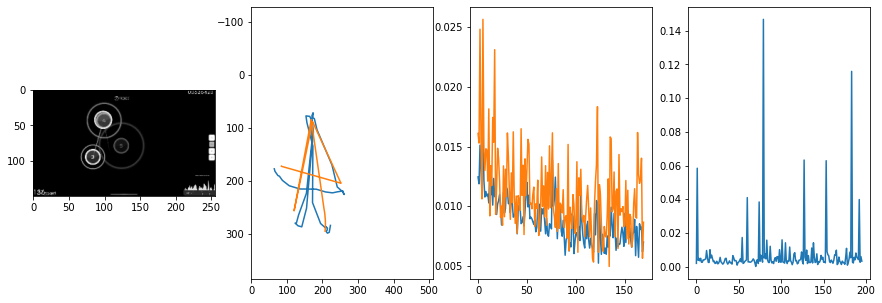


 176 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0026                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006145765334640972
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0159                                    
pred: 0.6700891256332397 0.5464338064193726
gt: 0.5973328351974487 0.4894115626811981
(140, 74)


<Figure size 1080x360 with 0 Axes>

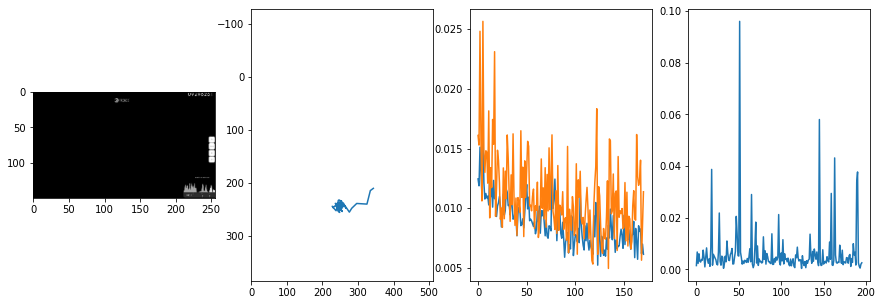


 177 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.0048                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007863883172385799
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0067                                    
pred: 0.14615117013454437 0.2916189432144165
gt: 0.2755580544471741 0.25318264961242676
(90, 47)


<Figure size 1080x360 with 0 Axes>

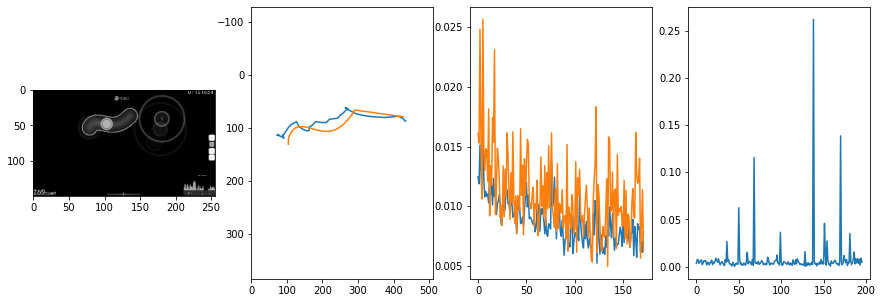


 178 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0077                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006441125117909943
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0098                                    
pred: 0.35759836435317993 0.43457499146461487
gt: 0.59765625 0.5
(140, 76)


<Figure size 1080x360 with 0 Axes>

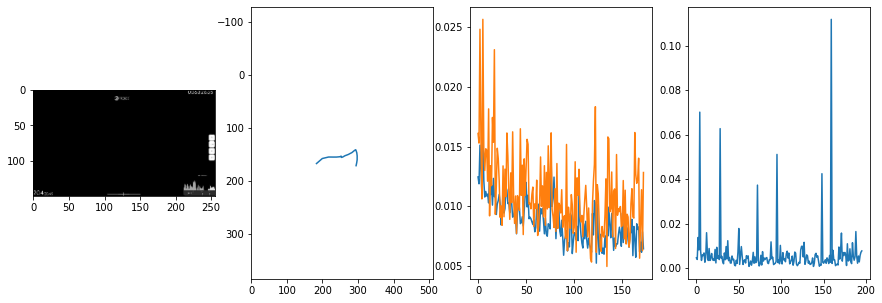


 179 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0060                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010497413876190858
outliers: 55
retrain: 4                 
val: 50/50 loss: 0.0073                                    
pred: 0.6333921551704407 0.9361783266067505
gt: 0.8116075992584229 0.905153214931488
(173, 123)


<Figure size 1080x360 with 0 Axes>

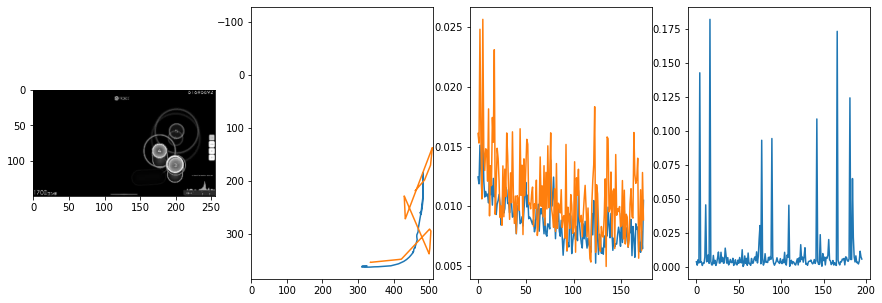


 180 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0034                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00718573814558521
outliers: 17
retrain: 4                 
val: 50/50 loss: 0.0068                                    
pred: 0.5278308987617493 0.5427904725074768
gt: 0.328125 0.625
(98, 90)


<Figure size 1080x360 with 0 Axes>

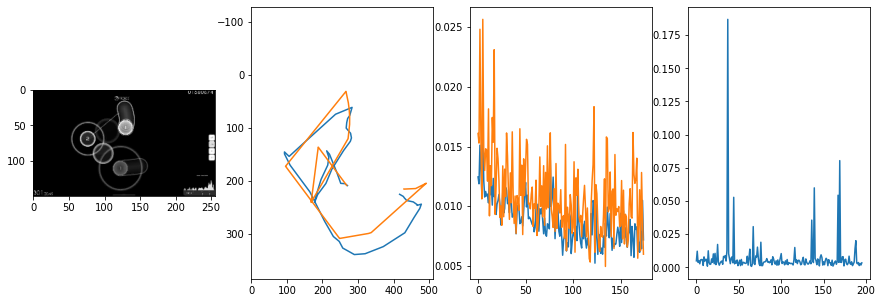


 181 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  0.0034                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006441841925950531
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0091                                    
pred: 0.826295793056488 0.4172969162464142
gt: 0.7441437840461731 0.5963462591171265
(163, 87)


<Figure size 1080x360 with 0 Axes>

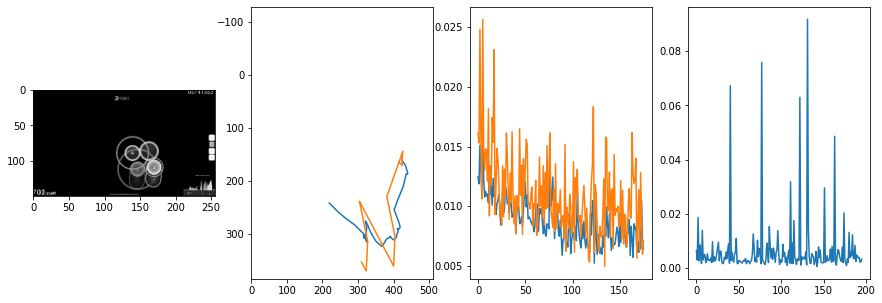


 182 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.36it/s  0.0037                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008230374342873598
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0034                                    
pred: 0.8781707882881165 0.49335977435112
gt: 0.8526989221572876 0.26739615201950073
(180, 49)


<Figure size 1080x360 with 0 Axes>

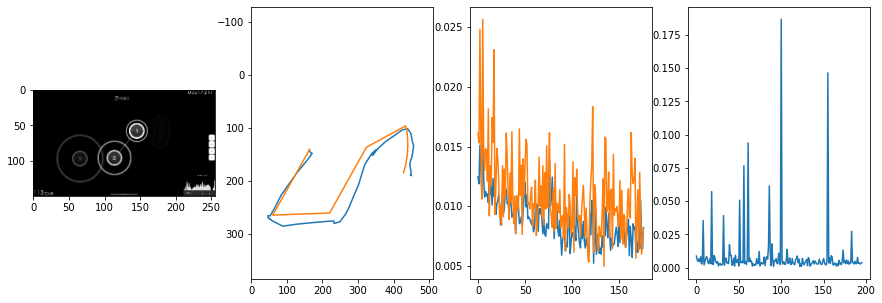


 183 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.0069                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007752041520262184
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0066                                    
pred: 0.6150833964347839 0.31587833166122437
gt: 0.640625 0.049479175359010696
(147, 23)


<Figure size 1080x360 with 0 Axes>

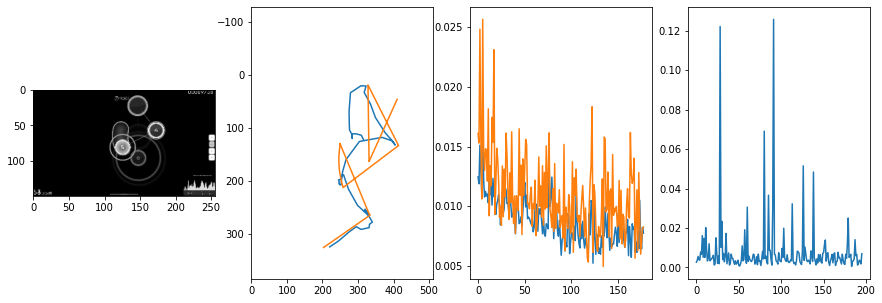


 184 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006679664601896158
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0094                                    
pred: 0.2483391910791397 0.12316392362117767
gt: 0.3174374997615814 0.1420000046491623
(97, 34)


<Figure size 1080x360 with 0 Axes>

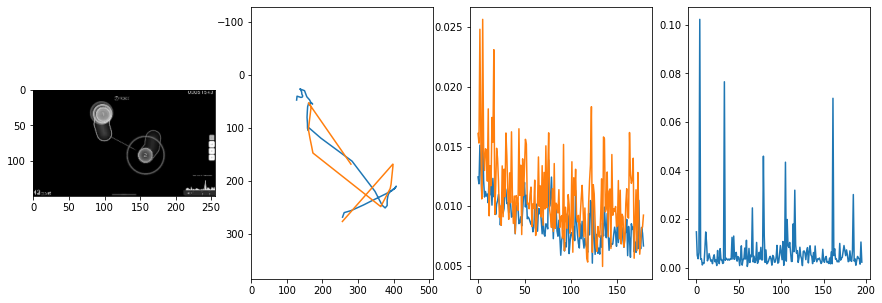


 185 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  0.0012                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006926210660413763
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0056                                    
pred: 0.4620945155620575 0.6664865612983704
gt: 0.1869892179965973 0.8092398643493652
(76, 112)


<Figure size 1080x360 with 0 Axes>

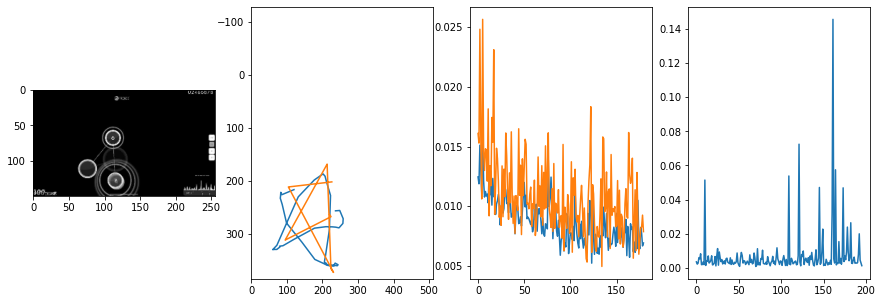


 186 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  0.0012                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006412601307193673
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0048                                    
pred: 0.6229275465011597 0.29043012857437134
gt: 0.7650825381278992 0.09912922978401184
(166, 29)


<Figure size 1080x360 with 0 Axes>

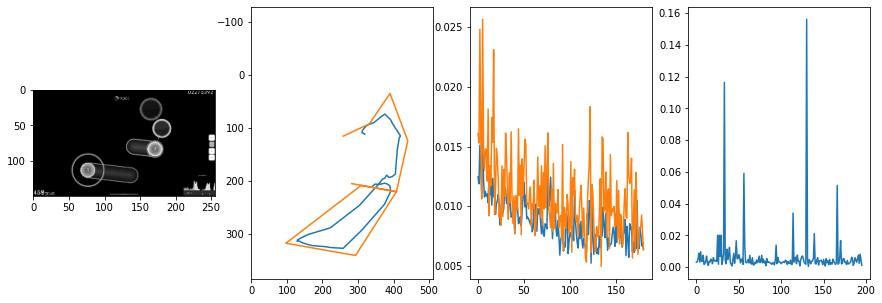


 187 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.0040                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009735936242540613
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.0055                                    
pred: 0.7203803062438965 0.4409465491771698
gt: 0.7037598490715027 0.631228506565094
(157, 91)


<Figure size 1080x360 with 0 Axes>

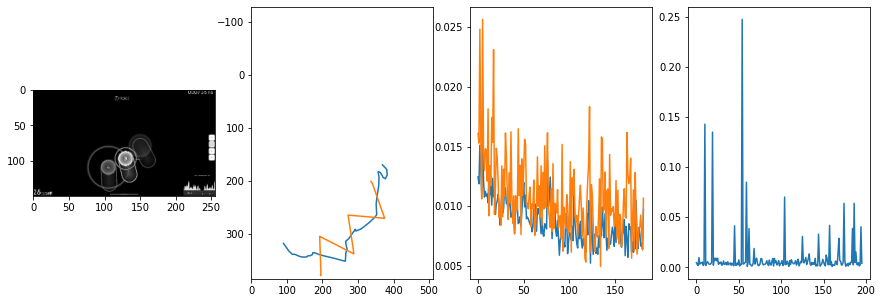


 188 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  0.0055                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.011498811969543067
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0082                                    
pred: 0.5049063563346863 0.5830337405204773
gt: 0.576764702796936 0.41951337456703186
(137, 66)


<Figure size 1080x360 with 0 Axes>

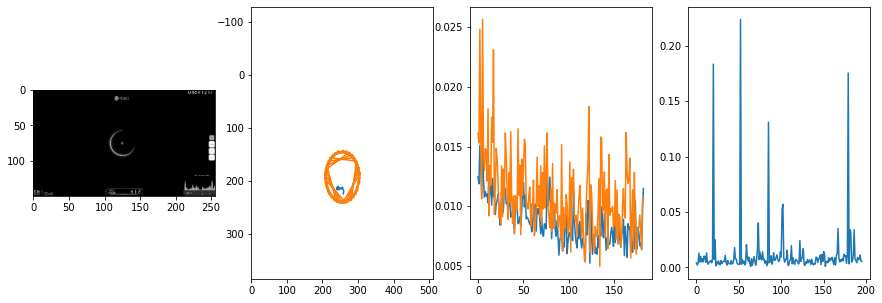


 189 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0043                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009776245129392102
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0267                                    
pred: 0.74837327003479 0.5477689504623413
gt: 0.7460945248603821 0.752598226070404
(163, 105)


<Figure size 1080x360 with 0 Axes>

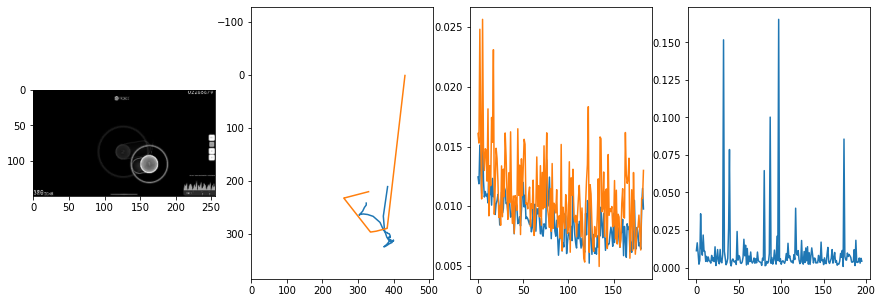


 190 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.0018                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008111494952071535
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0365                                    
pred: 0.5031101703643799 0.654567539691925
gt: 0.4554682970046997 0.5139707326889038
(118, 77)


<Figure size 1080x360 with 0 Axes>

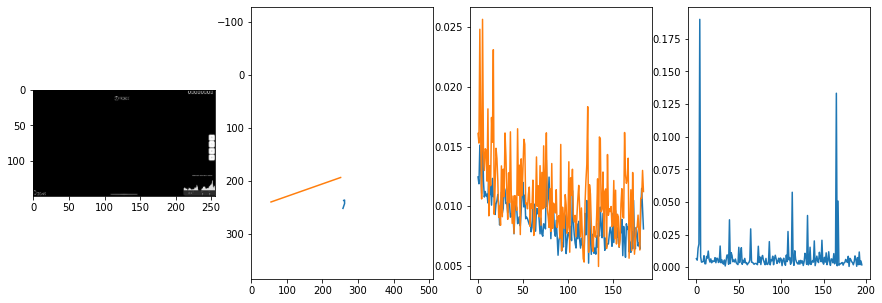


 191 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  0.0034                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010048911222244841
outliers: 56
retrain: 4                 
val: 50/50 loss: 0.0029                                    
pred: 0.5052065253257751 0.2036987692117691
gt: 0.4687489867210388 0.32031771540641785
(120, 55)


<Figure size 1080x360 with 0 Axes>

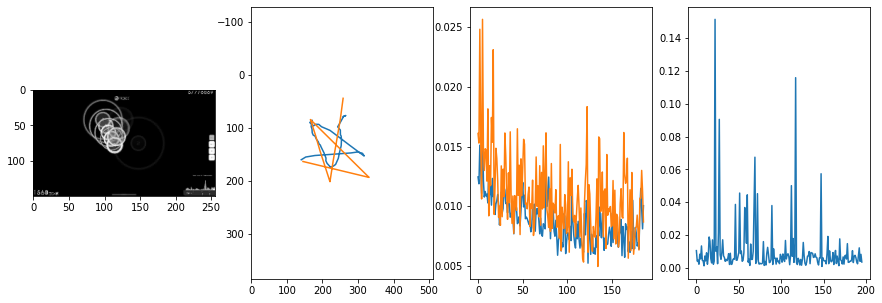


 192 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0015                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009478153572691016
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0039                                    
pred: 0.15294510126113892 0.064888596534729
gt: 0.2910154163837433 0.052083566784858704
(93, 24)


<Figure size 1080x360 with 0 Axes>

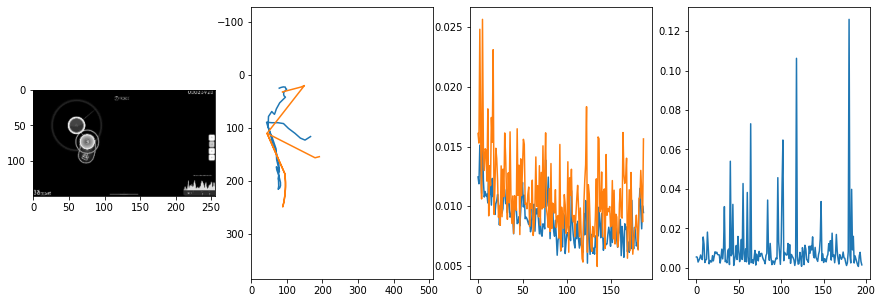


 193 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0025                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00702394937668162
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0013                                    
pred: 0.30320170521736145 0.4119010269641876
gt: 0.7812113165855408 0.18751560151576996
(169, 39)


<Figure size 1080x360 with 0 Axes>

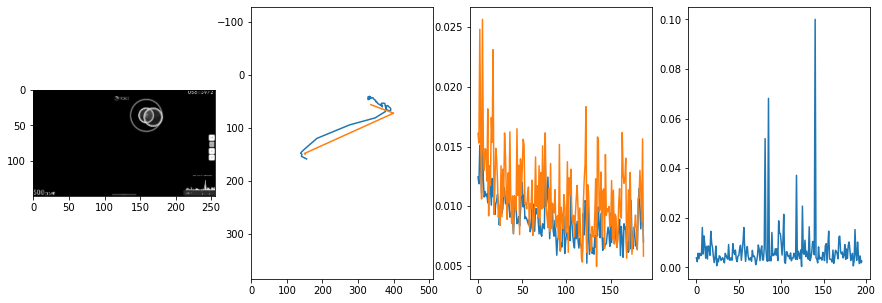


 194 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007941913082411664
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.0038                                    
pred: 0.2002900391817093 0.8885412812232971
gt: 0.19090713560581207 0.8895280957221985
(77, 121)


<Figure size 1080x360 with 0 Axes>

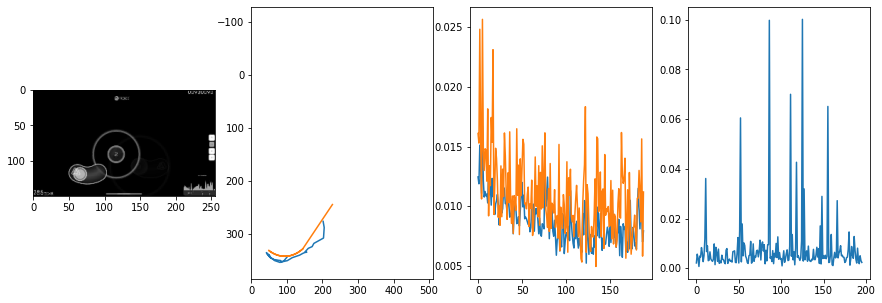


 195 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008787601463358887
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0057                                    
pred: 0.10398387908935547 0.9038344621658325
gt: 0.5234374403953552 0.765625
(129, 107)


<Figure size 1080x360 with 0 Axes>

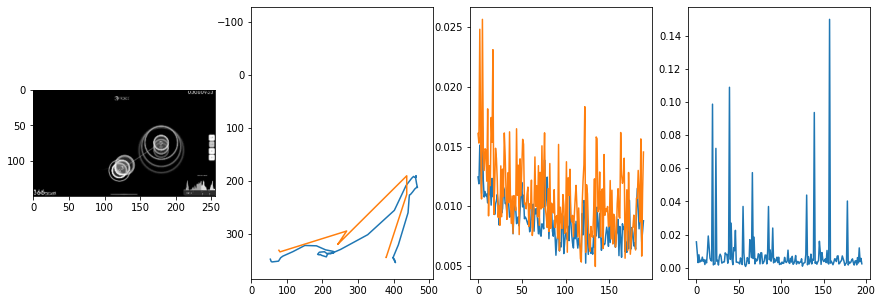


 196 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.40it/s  0.0095                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007449803984966319
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.0025                                    
pred: 0.39685431122779846 0.24704097211360931
gt: 0.40581032633781433 0.14525459706783295
(110, 34)


<Figure size 1080x360 with 0 Axes>

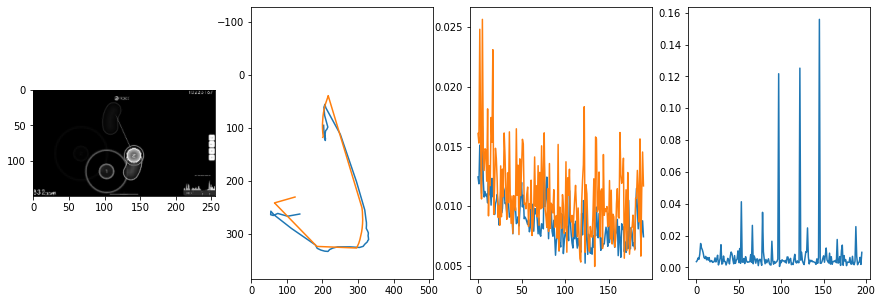


 197 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.0032                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006701525205856769
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0054                                    
pred: 0.653050422668457 0.6458250880241394
gt: 0.6453061699867249 0.6569864749908447
(148, 94)


<Figure size 1080x360 with 0 Axes>

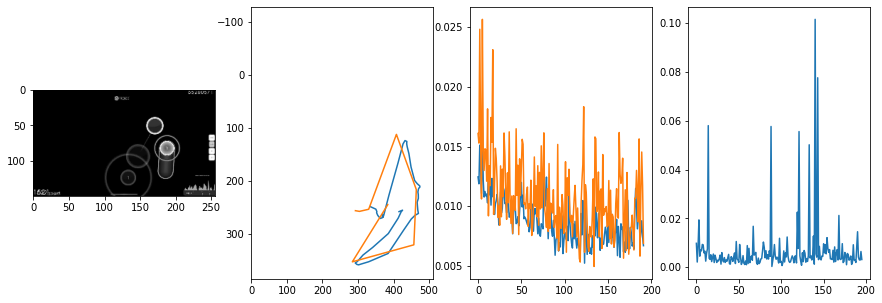


 198 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.0591                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006937209046796221
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0035                                    
pred: 0.6748046875 0.8411669135093689
gt: 0.8320696353912354 0.9291293025016785
(177, 126)


<Figure size 1080x360 with 0 Axes>

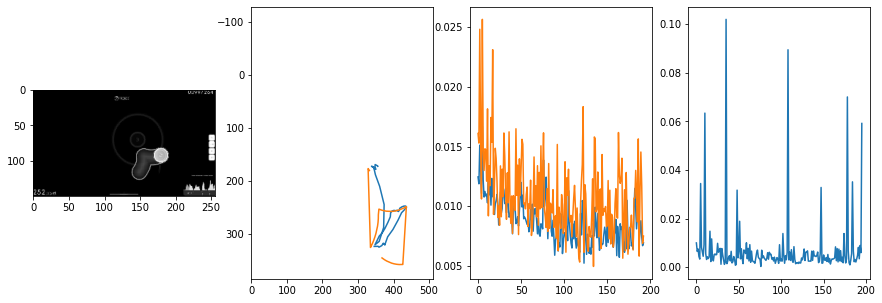


 199 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0055                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006908267896802982
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0092                                    
pred: 0.3363197445869446 0.4016282260417938
gt: 0.592285692691803 0.45741474628448486
(139, 71)


<Figure size 1080x360 with 0 Axes>

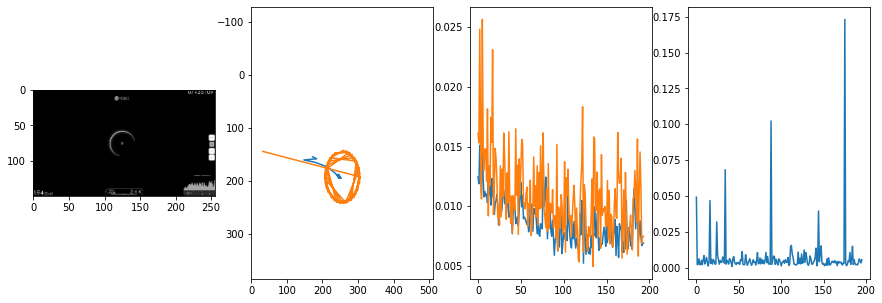


 200 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006762423773524256
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0062                                    
pred: 0.6048294901847839 0.1490209698677063
gt: 0.7607967853546143 0.17271997034549713
(165, 38)


<Figure size 1080x360 with 0 Axes>

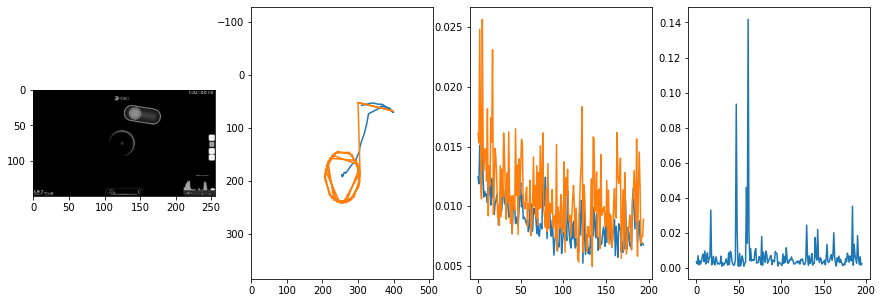


 201 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0046                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00465239318932896
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.0016                                    
pred: 0.2261713594198227 0.7668250799179077
gt: 0.133548766374588 0.7545062899589539
(68, 105)


<Figure size 1080x360 with 0 Axes>

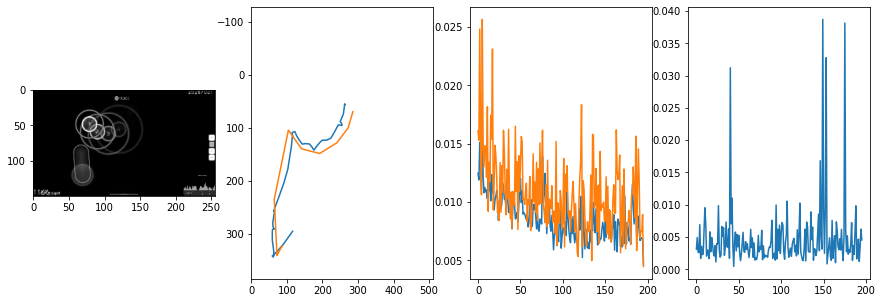


 202 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.0033                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008911352415452711
outliers: 79
retrain: 4                 
val: 50/50 loss: 0.0027                                    
pred: 0.4211736023426056 0.12275877594947815
gt: 0.35300931334495544 0.12548547983169556
(102, 32)


<Figure size 1080x360 with 0 Axes>

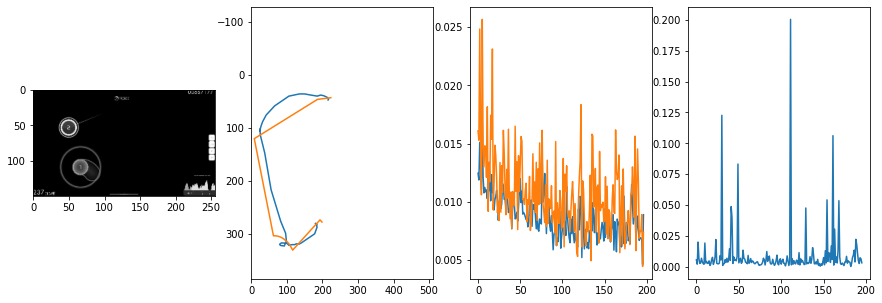


 203 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.0038                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006300758507473356
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0051                                    
pred: 0.07476090639829636 0.681977391242981
gt: 0.2265625 0.2916666567325592
(83, 51)


<Figure size 1080x360 with 0 Axes>

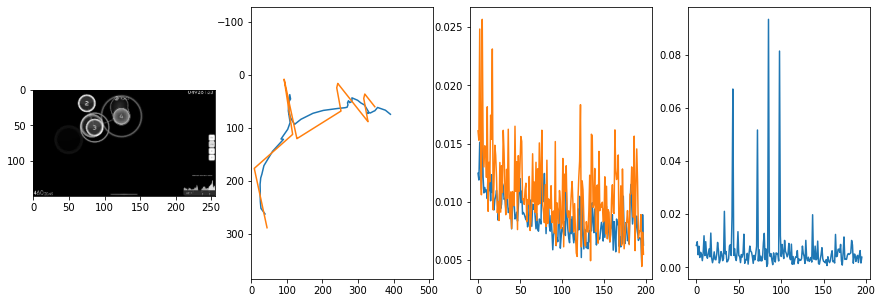


 204 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  0.0025                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006785822392866604
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.4480673670768738 0.555245041847229
gt: 0.43422484397888184 0.549059271812439
(115, 81)


<Figure size 1080x360 with 0 Axes>

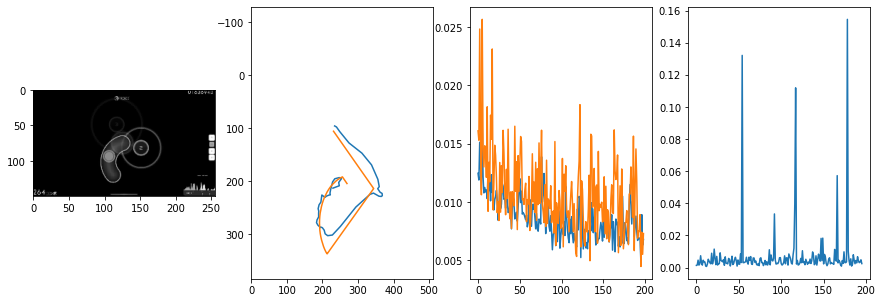


 205 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009004678750619749
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.0079                                    
pred: 0.5388713479042053 0.1771567463874817
gt: 0.8510082960128784 0.6343620419502258
(179, 91)


<Figure size 1080x360 with 0 Axes>

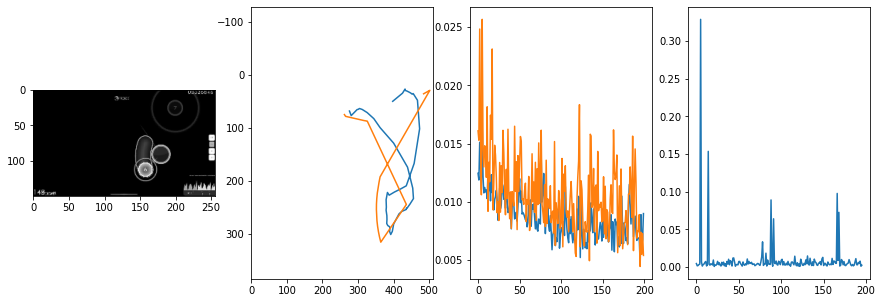


 206 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0038                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0066624067940767645
outliers: 19
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.29617246985435486 0.8019759058952332
gt: 0.26547059416770935 0.7217532992362976
(89, 101)


<Figure size 1080x360 with 0 Axes>

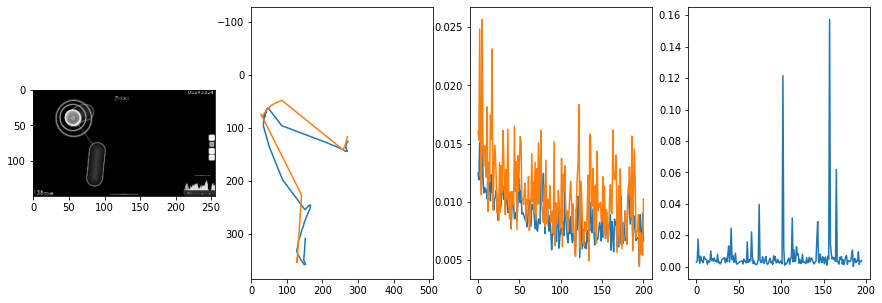


 207 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.0066                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007018554030189395
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0030                                    
pred: 0.4654238522052765 0.8103994131088257
gt: 0.248046875 0.5182291865348816
(86, 78)


<Figure size 1080x360 with 0 Axes>

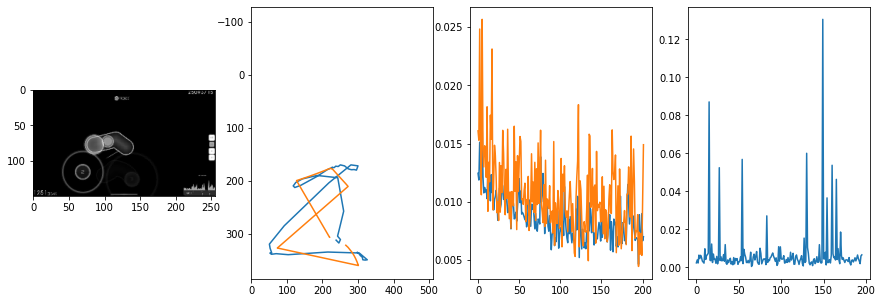


 208 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.0021                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005506771296495572
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.41889262199401855 0.6594521999359131
gt: 0.51171875 0.7265625
(127, 102)


<Figure size 1080x360 with 0 Axes>

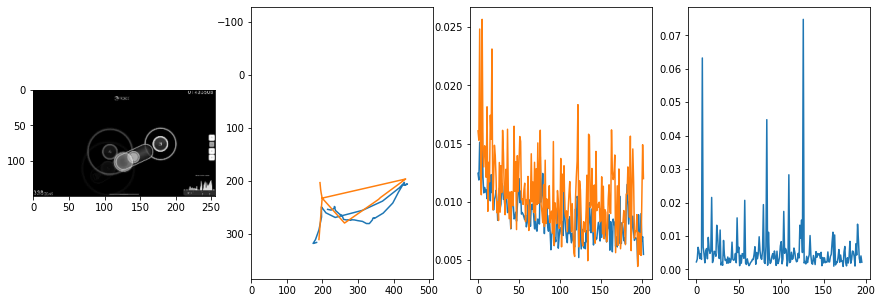


 209 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.32it/s  0.0042                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0067053054045405885
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.0009                                    
pred: 0.7087270021438599 0.4102141261100769
gt: 0.6140630841255188 0.4456634223461151
(143, 69)


<Figure size 1080x360 with 0 Axes>

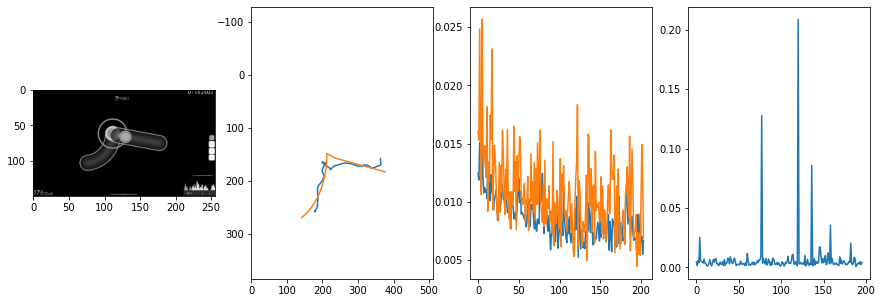


 210 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.30it/s  0.0017                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008148628318793977
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.0040                                    
pred: 0.27428656816482544 0.8843290209770203
gt: 0.314453125 0.8828125
(96, 120)


<Figure size 1080x360 with 0 Axes>

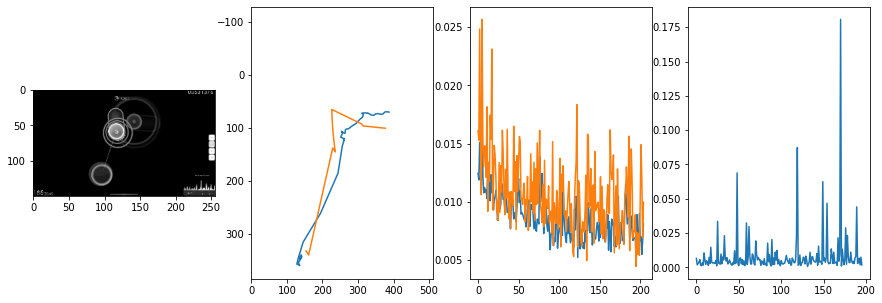


 211 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008130418787097407
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0048                                    
pred: 0.5473458170890808 0.7376838326454163
gt: 0.7441404461860657 0.5494793057441711
(163, 81)


<Figure size 1080x360 with 0 Axes>

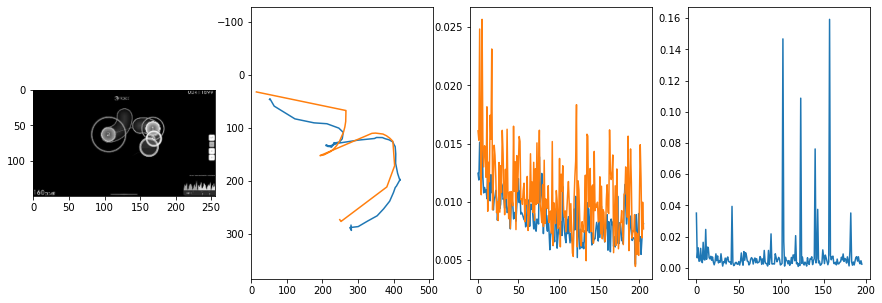


 212 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.0072                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008591234240008575
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0277                                    
pred: 0.5800482630729675 0.6233005523681641
gt: 0.376974880695343 0.6692587733268738
(106, 95)


<Figure size 1080x360 with 0 Axes>

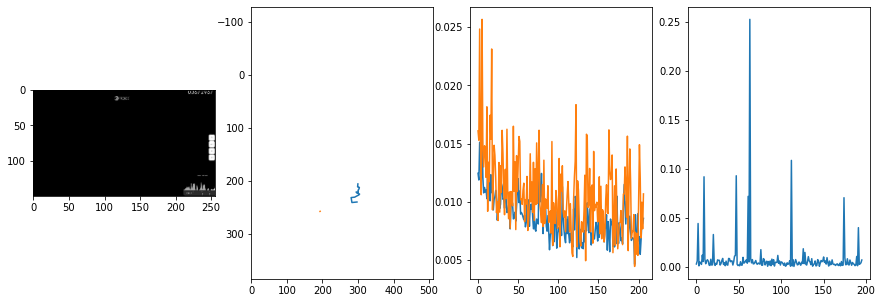


 213 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.0092                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009128567033889229
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0063                                    
pred: 0.14898332953453064 0.24537426233291626
gt: 0.24023397266864777 0.5182327628135681
(85, 78)


<Figure size 1080x360 with 0 Axes>

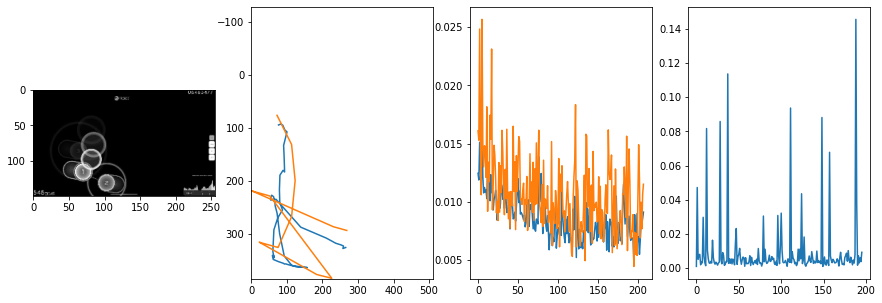


 214 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006786474610598074
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0170                                    
pred: 0.4033055305480957 0.6495282053947449
gt: 0.2265639305114746 0.8749989867210388
(83, 119)


<Figure size 1080x360 with 0 Axes>

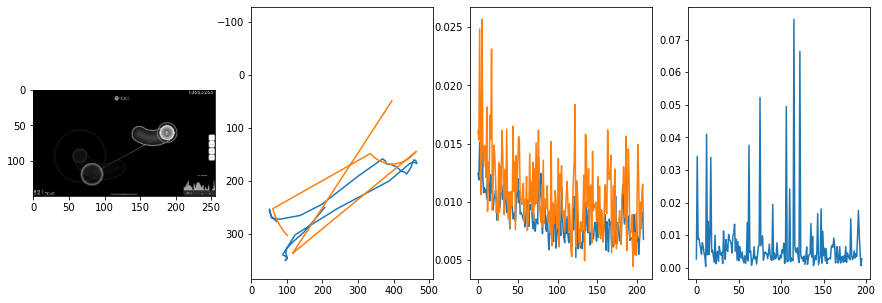


 215 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.41it/s  0.0499                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007485677848382359
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0080                                    
pred: 0.5056117177009583 0.4201211631298065
gt: 0.5738223791122437 0.41476044058799744
(136, 66)


<Figure size 1080x360 with 0 Axes>

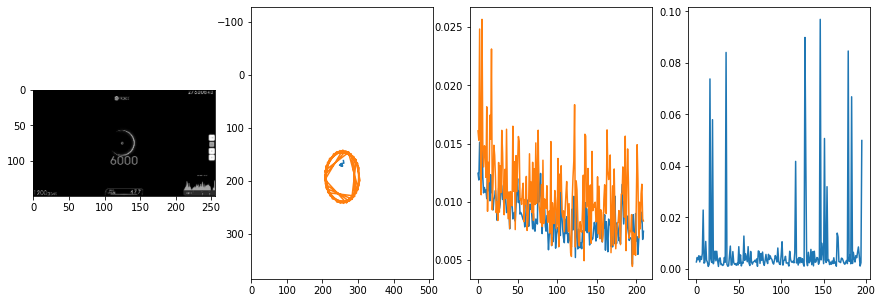


 216 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007912937595838044
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0013                                    
pred: 0.18755066394805908 0.5401582717895508
gt: 0.33366113901138306 0.4792139232158661
(99, 73)


<Figure size 1080x360 with 0 Axes>

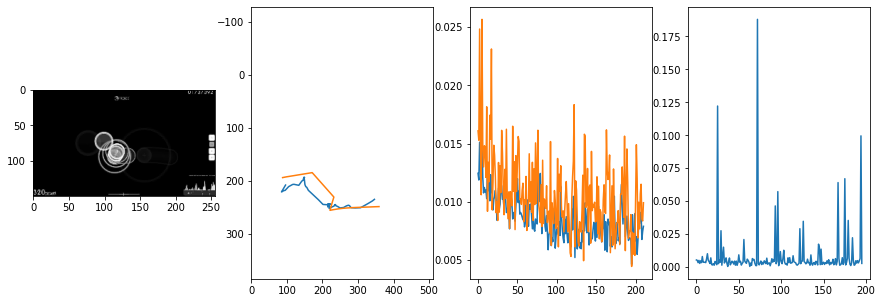


 217 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.37it/s  0.0071                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008095774411138299
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0017                                    
pred: 0.8098054528236389 0.7491971254348755
gt: 0.7434377670288086 0.5501437187194824
(163, 81)


<Figure size 1080x360 with 0 Axes>

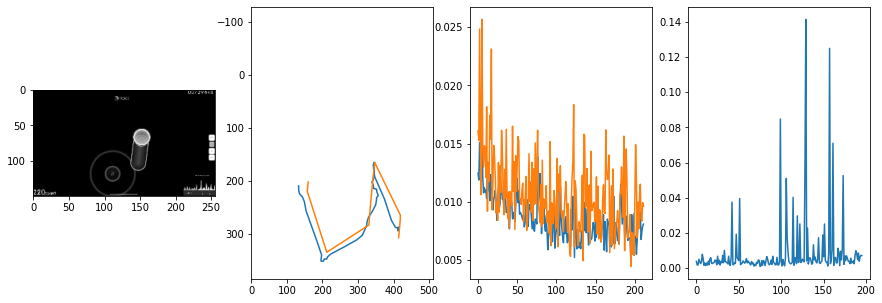


 218 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  0.0072                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008418716501256888
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0035                                    
pred: 0.8678783774375916 0.47254663705825806
gt: 0.6433374881744385 0.4975321590900421
(147, 75)


<Figure size 1080x360 with 0 Axes>

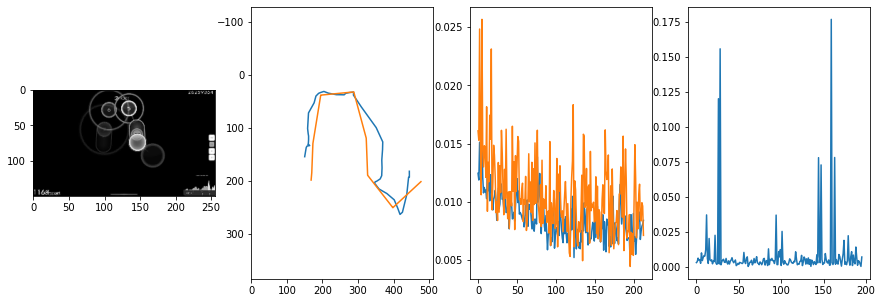


 219 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006229441716307204
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0038                                    
pred: 0.38435789942741394 0.7660265564918518
gt: 0.37461528182029724 0.8549777865409851
(106, 117)


<Figure size 1080x360 with 0 Axes>

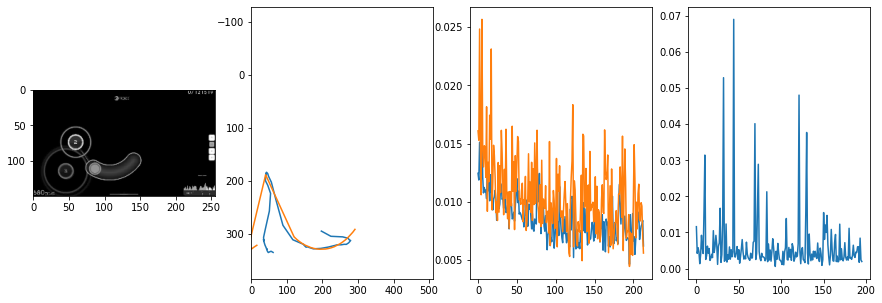


 220 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0373                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00804864681457711
outliers: 55
retrain: 4                 
val: 50/50 loss: 0.0897                                    
pred: 0.43061307072639465 0.37994465231895447
gt: 0.05859375 0.6015625
(57, 87)


<Figure size 1080x360 with 0 Axes>

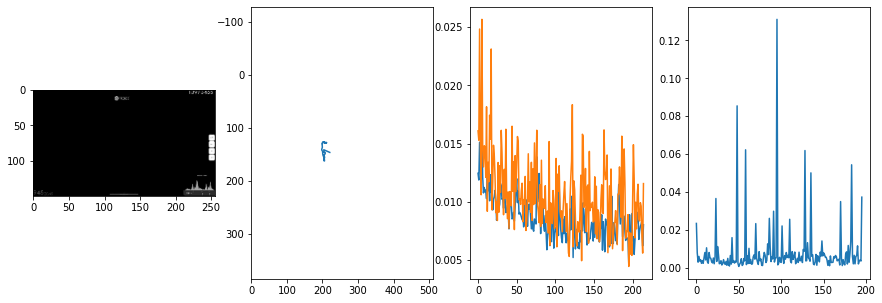


 221 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0030                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007806120169223096
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.1094621792435646 0.4215506613254547
gt: 0.15152522921562195 0.31693321466445923
(71, 54)


<Figure size 1080x360 with 0 Axes>

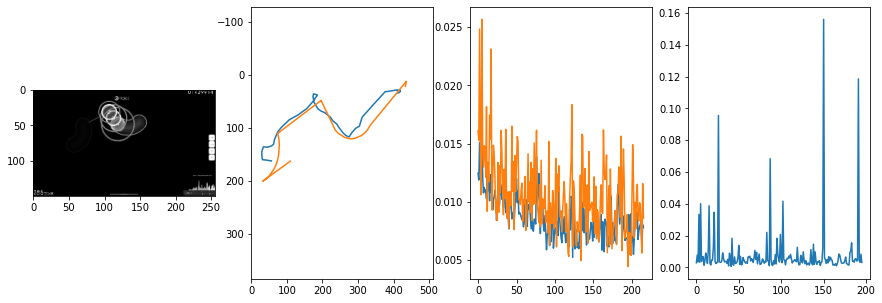


 222 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007710037605684935
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0097                                    
pred: 0.2526659369468689 0.261071115732193
gt: 0.3515625 0.1640625
(102, 37)


<Figure size 1080x360 with 0 Axes>

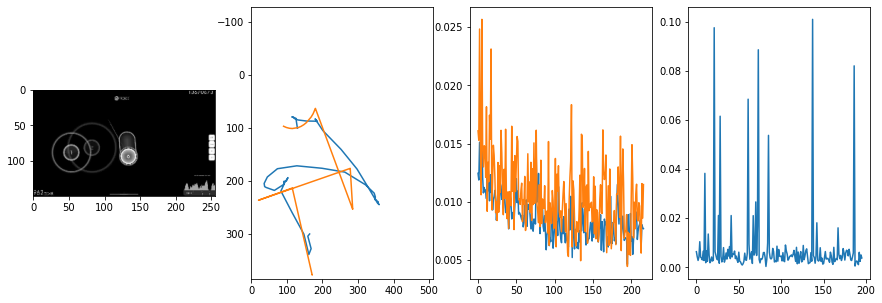


 223 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0052                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007728272831906109
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0039                                    
pred: 0.5749292969703674 0.75628662109375
gt: 0.373046875 0.90625
(105, 123)


<Figure size 1080x360 with 0 Axes>

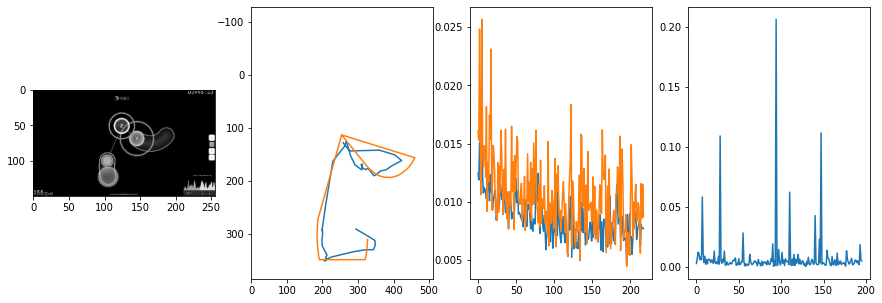


 224 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0054                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006891217291662802
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0091                                    
pred: 0.4245308041572571 0.7185987234115601
gt: 0.5292928814888 0.898435115814209
(130, 122)


<Figure size 1080x360 with 0 Axes>

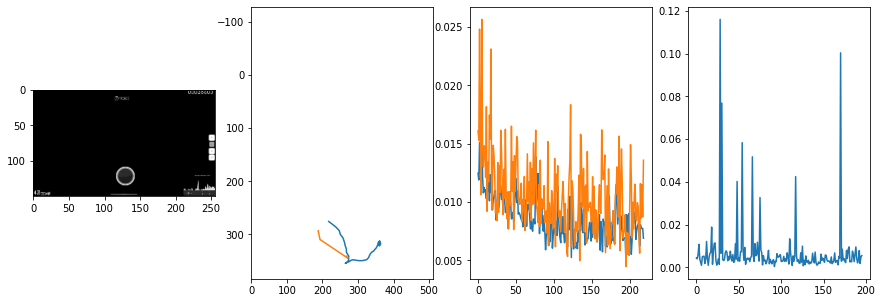


 225 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0069                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006575598295930089
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0050                                    
pred: 0.3168618381023407 0.33351796865463257
gt: 0.25 0.3958333432674408
(86, 64)


<Figure size 1080x360 with 0 Axes>

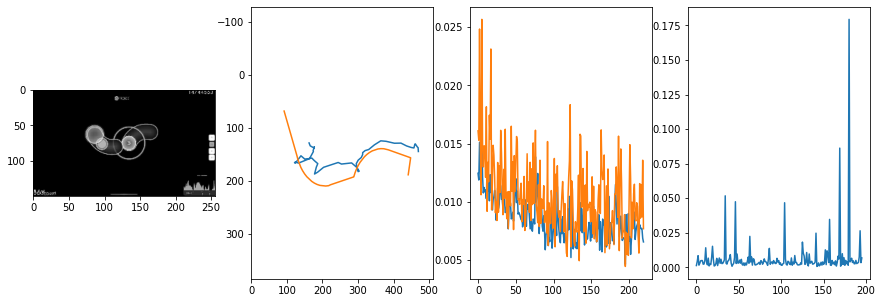


 226 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0076                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006654426214648696
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0032                                    
pred: 0.3752034902572632 0.42196598649024963
gt: 0.3827943801879883 0.7707470059394836
(107, 107)


<Figure size 1080x360 with 0 Axes>

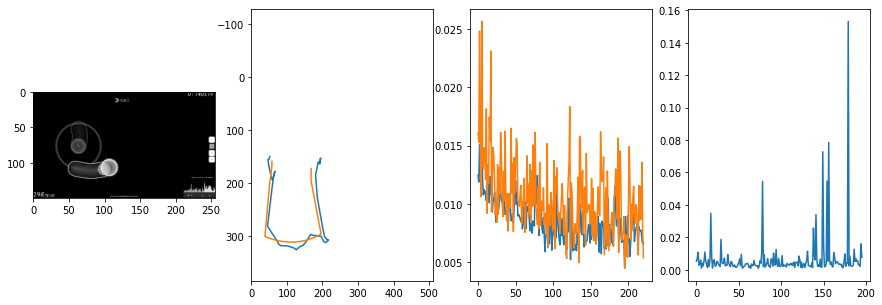


 227 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005412366252798796
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.0109                                    
pred: 0.37633267045021057 0.2218984216451645
gt: 0.45366108417510986 0.06678296625614166
(118, 25)


<Figure size 1080x360 with 0 Axes>

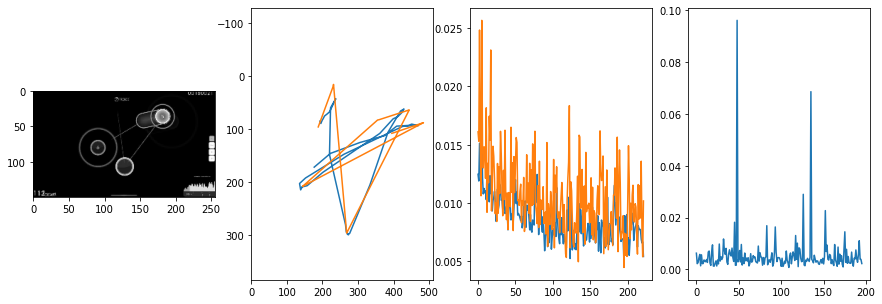


 228 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0026                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006669906687587785
outliers: 57
retrain: 4                 
val: 50/50 loss: 0.0064                                    
pred: 0.5478007793426514 0.12819220125675201
gt: 0.5449218153953552 0.40885427594184875
(132, 65)


<Figure size 1080x360 with 0 Axes>

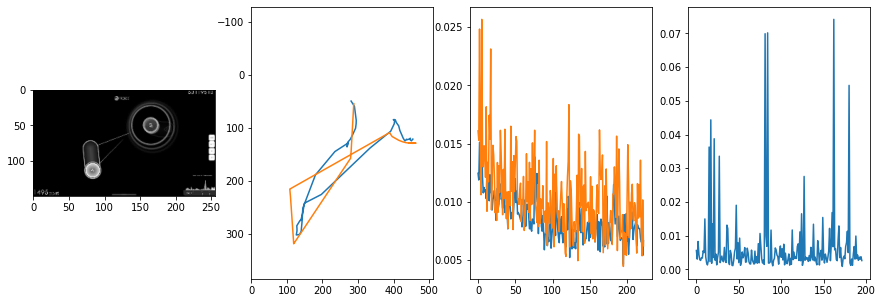


 229 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0082                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006624849896868501
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0068                                    
pred: 0.6815136075019836 0.7440476417541504
gt: 0.8358860015869141 0.7183240056037903
(177, 101)


<Figure size 1080x360 with 0 Axes>

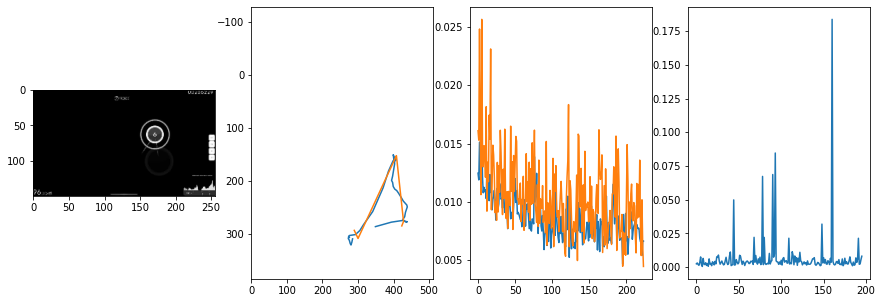


 230 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  0.0110                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008426964258934294
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0188                                    
pred: 0.3607570230960846 0.5186523795127869
gt: 0.8404035568237305 0.9138779640197754
(178, 124)


<Figure size 1080x360 with 0 Axes>

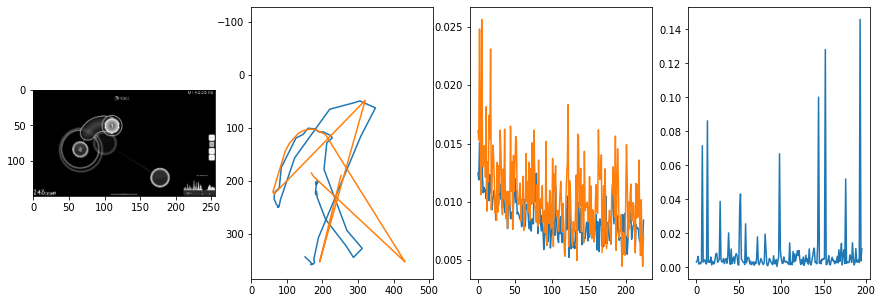


 231 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.0050                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008870992039470477
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0030                                    
pred: 0.4158655107021332 0.5955330729484558
gt: 0.4140617251396179 0.6562506556510925
(112, 94)


<Figure size 1080x360 with 0 Axes>

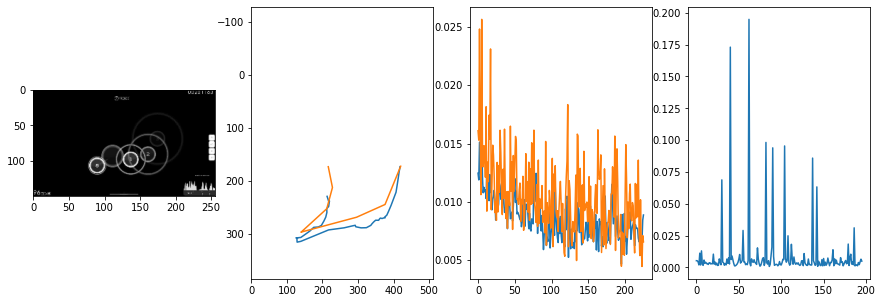


 232 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006664616161807706
outliers: 21
retrain: 4                 
val: 50/50 loss: 0.0790                                    
pred: 0.312759667634964 0.4657290279865265
gt: 0.5000019669532776 0.20833921432495117
(125, 42)


<Figure size 1080x360 with 0 Axes>

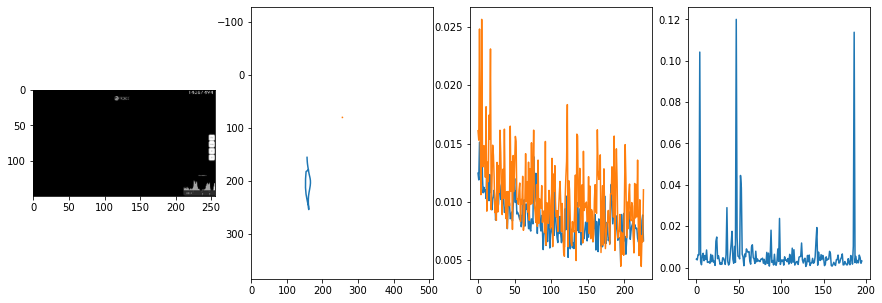


 233 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.0008                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006385526166514883
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0080                                    
pred: 0.5095316171646118 0.582736074924469
gt: 0.5047319531440735 0.3694342374801636
(126, 60)


<Figure size 1080x360 with 0 Axes>

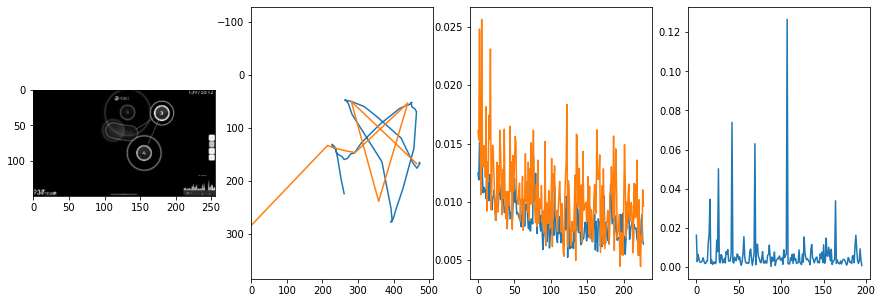


 234 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0015                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006392425465028096
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0053                                    
pred: 0.2142142951488495 0.21972715854644775
gt: 0.18619726598262787 0.18359506130218506
(76, 39)


<Figure size 1080x360 with 0 Axes>

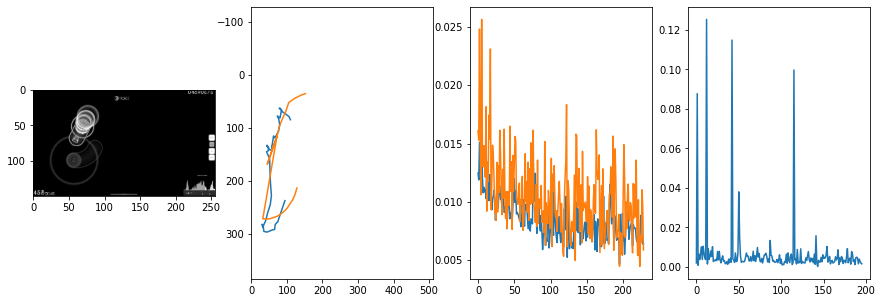


 235 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0027                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005786584319881809
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.0065                                    
pred: 0.4306843876838684 0.5200853943824768
gt: 0.4043593108654022 0.5263177752494812
(110, 79)


<Figure size 1080x360 with 0 Axes>

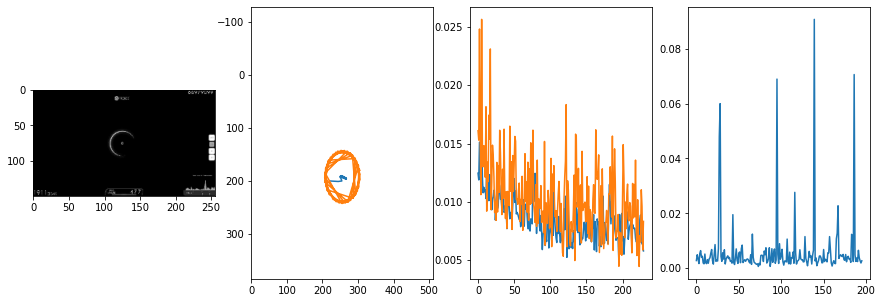


 236 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008659875185430235
outliers: 57
retrain: 4                 
val: 50/50 loss: 0.0024                                    
pred: 0.7361517548561096 0.8336820602416992
gt: 0.8626874089241028 0.6989445090293884
(181, 99)


<Figure size 1080x360 with 0 Axes>

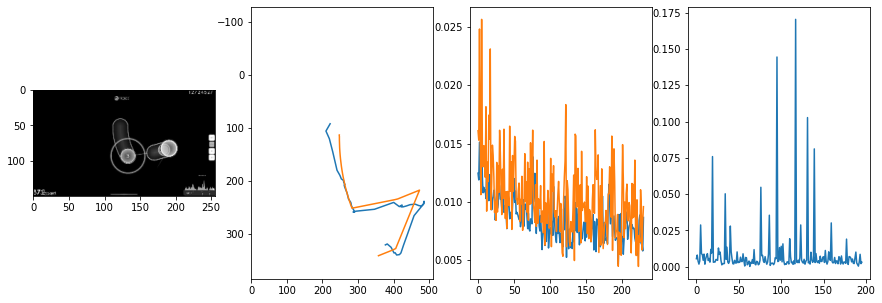


 237 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008161264760817676
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0040                                    
pred: 0.6089156866073608 0.8402313590049744
gt: 0.5569689869880676 0.6279857158660889
(134, 91)


<Figure size 1080x360 with 0 Axes>

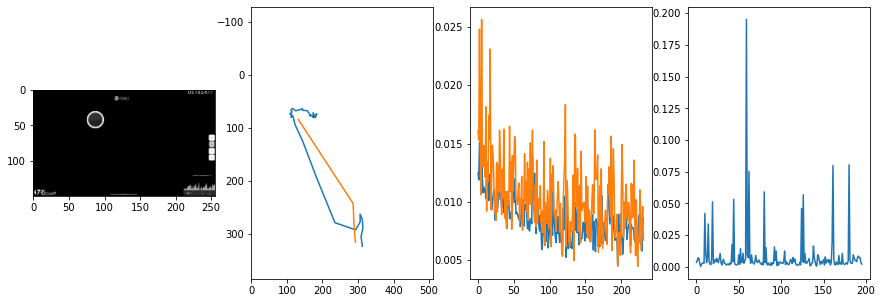


 238 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  0.0138                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005120987001609304
outliers: 16
retrain: 4                 
val: 50/50 loss: 0.0044                                    
pred: 0.7754524946212769 0.8055705428123474
gt: 0.5994414687156677 0.37942349910736084
(140, 62)


<Figure size 1080x360 with 0 Axes>

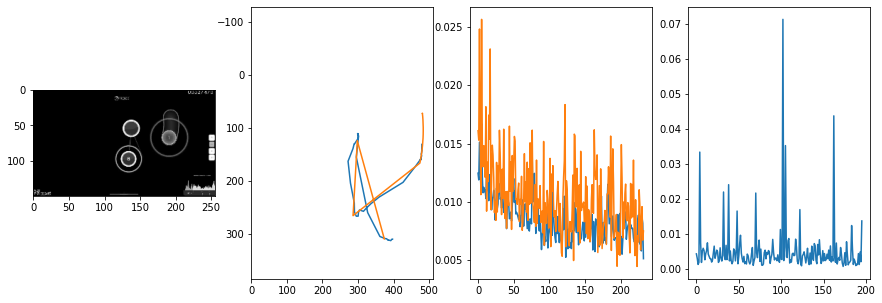


 239 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.36it/s  0.0020                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005833652655995565
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.0016                                    
pred: 0.5540373921394348 0.24896320700645447
gt: 0.5703098177909851 0.40625476837158203
(136, 65)


<Figure size 1080x360 with 0 Axes>

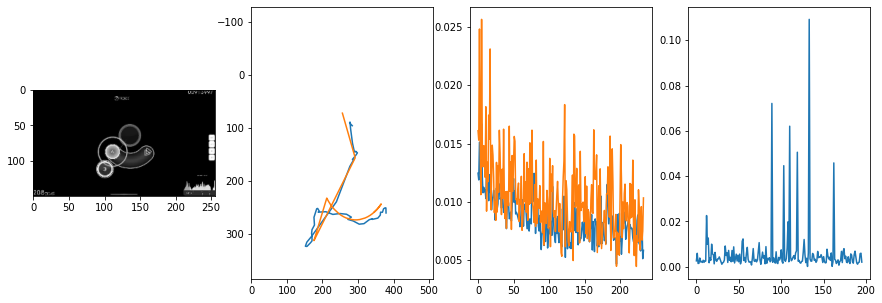


 240 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.0043                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007785236966476671
outliers: 52
retrain: 4                 
val: 50/50 loss: 0.0018                                    
pred: 0.1765308827161789 0.3372002840042114
gt: 0.15257574617862701 0.38372066617012024
(71, 62)


<Figure size 1080x360 with 0 Axes>

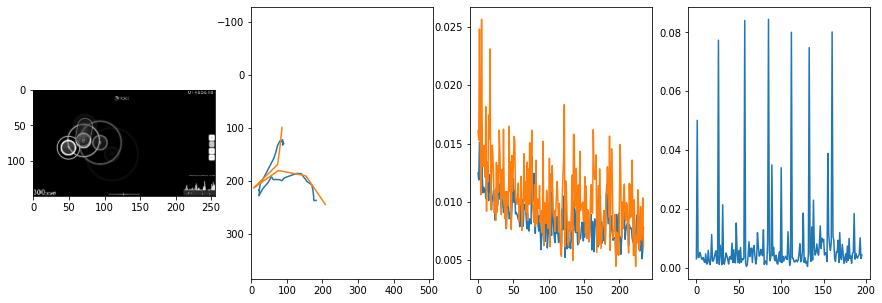


 241 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008466554001717334
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.0093                                    
pred: 0.5384926199913025 0.5435682535171509
gt: 0.5960143804550171 0.5237759351730347
(140, 78)


<Figure size 1080x360 with 0 Axes>

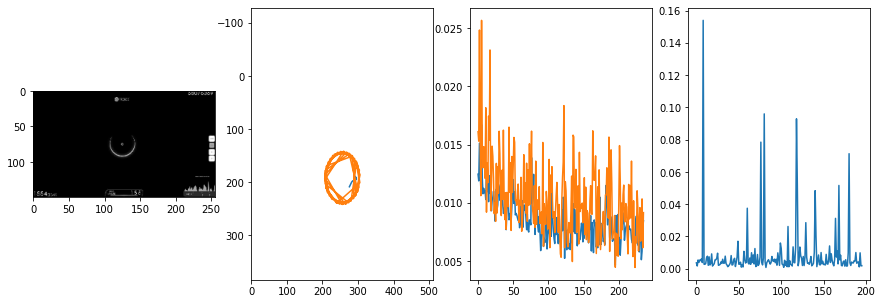


 242 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.35it/s  0.0109                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006931700529910776
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0116                                    
pred: 0.2630878984928131 0.3275163769721985
gt: 0.5000097155570984 0.49993273615837097
(125, 76)


<Figure size 1080x360 with 0 Axes>

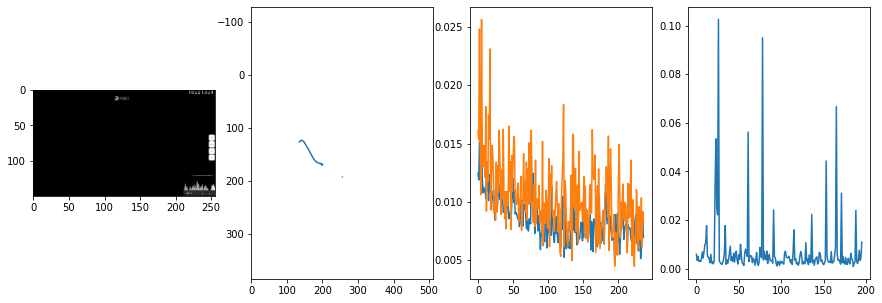


 243 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005789848701875153
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.31272414326667786 0.07973507791757584
gt: 0.2767576277256012 0.07639099657535553
(90, 26)


<Figure size 1080x360 with 0 Axes>

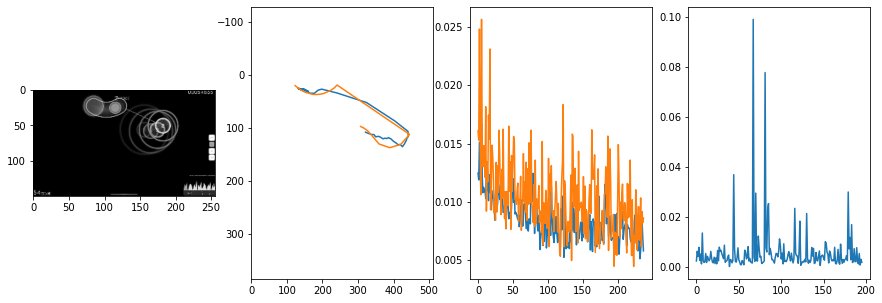


 244 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.0017                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007145741503039489
outliers: 57
retrain: 4                 
val: 50/50 loss: 0.0047                                    
pred: 0.65090012550354 0.1194942444562912
gt: 0.7285346388816833 0.09638360887765884
(160, 29)


<Figure size 1080x360 with 0 Axes>

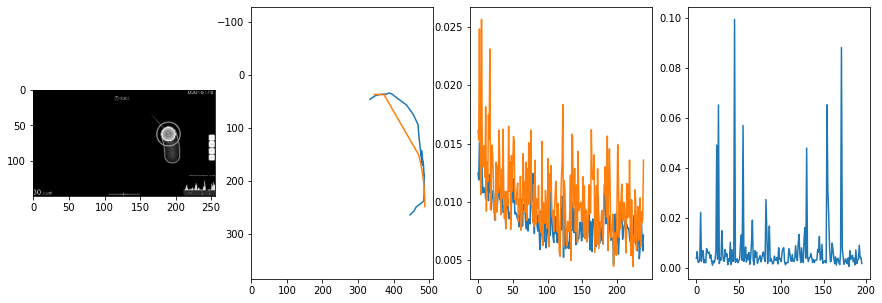


 245 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006767605778248031
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0043                                    
pred: 0.22866614162921906 0.252642959356308
gt: 0.1359485387802124 0.4428989887237549
(69, 69)


<Figure size 1080x360 with 0 Axes>

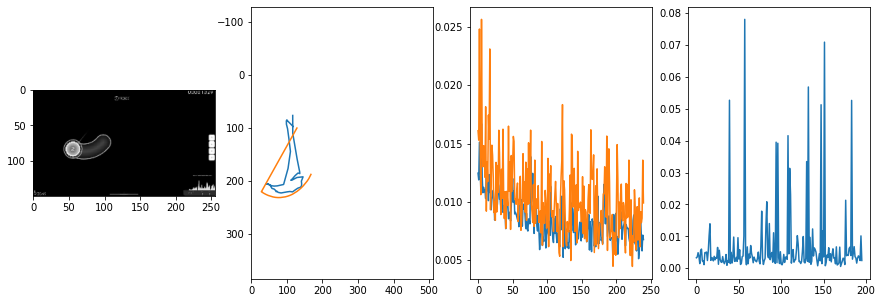


 246 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  0.0030                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00742059976990425
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.2106618583202362 0.21195559203624725
gt: 0.24595150351524353 0.09982367604970932
(86, 29)


<Figure size 1080x360 with 0 Axes>

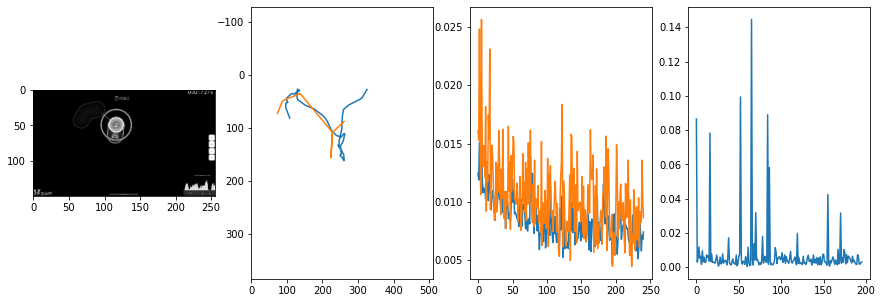


 247 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008859833916269091
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0027                                    
pred: 0.7559610605239868 0.3276735246181488
gt: 0.8549889326095581 0.43494096398353577
(180, 68)


<Figure size 1080x360 with 0 Axes>

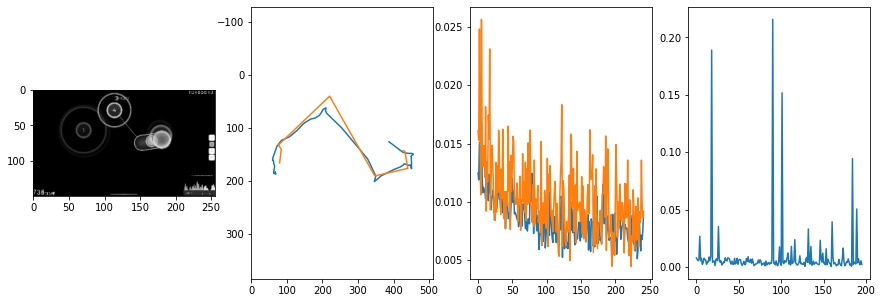


 248 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005526870062066318
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.0065                                    
pred: 0.7201149463653564 0.21554771065711975
gt: 0.4296875 0.2708333432674408
(114, 49)


<Figure size 1080x360 with 0 Axes>

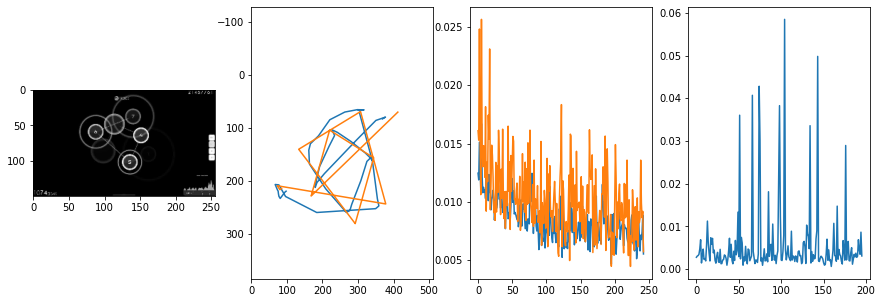


 249 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.0026                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0075302265334413485
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.0082                                    
pred: 0.2768439054489136 0.23533543944358826
gt: 0.337890625 0.2578125
(100, 47)


<Figure size 1080x360 with 0 Axes>

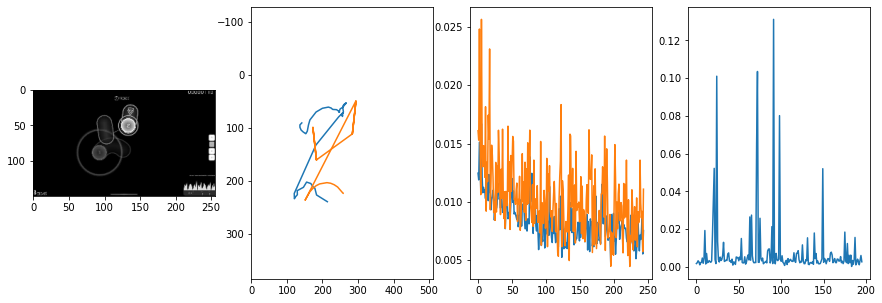


 250 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0064510148296569834
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0022                                    
pred: 0.6587293744087219 0.1203986182808876
gt: 0.6015625 0.14583337306976318
(141, 34)


<Figure size 1080x360 with 0 Axes>

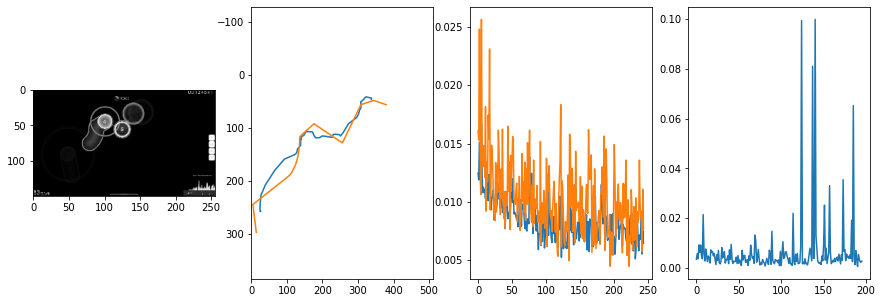


 251 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006813616347225972
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0043                                    
pred: 0.14792415499687195 0.15318229794502258
gt: 0.06671638786792755 0.35028746724128723
(58, 58)


<Figure size 1080x360 with 0 Axes>

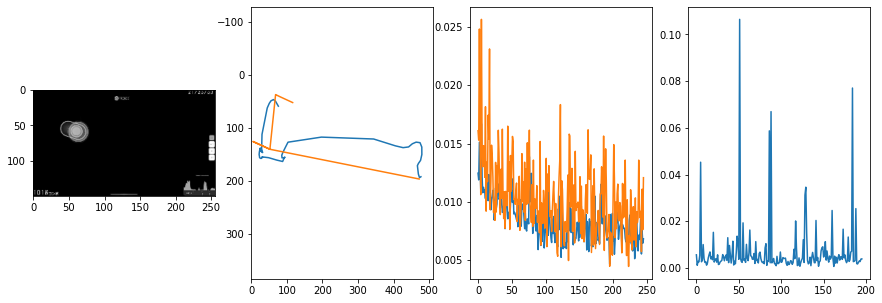


 252 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.0042                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007929331717902215
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0066                                    
pred: 0.2470519095659256 0.4481995701789856
gt: 0.3437421917915344 0.4974253177642822
(101, 75)


<Figure size 1080x360 with 0 Axes>

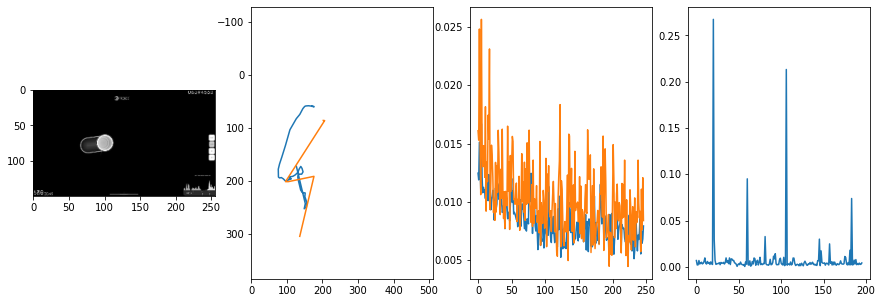


 253 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0072                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007323790445557928
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0055                                    
pred: 0.5516260862350464 0.5646349787712097
gt: 0.5743147730827332 0.43596163392066956
(137, 68)


<Figure size 1080x360 with 0 Axes>

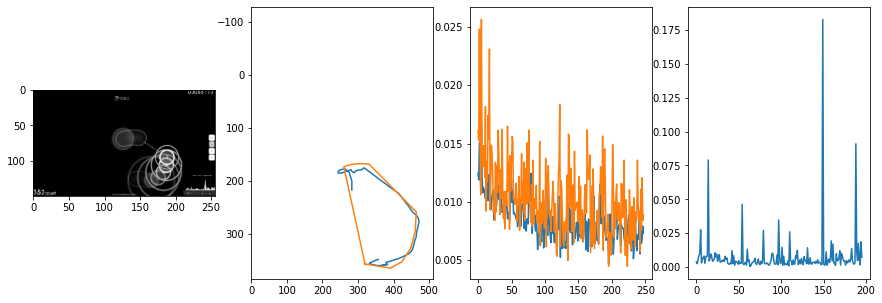


 254 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00858602722945186
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.4476652145385742 0.26390910148620605
gt: 0.5990643501281738 0.407090425491333
(140, 65)


<Figure size 1080x360 with 0 Axes>

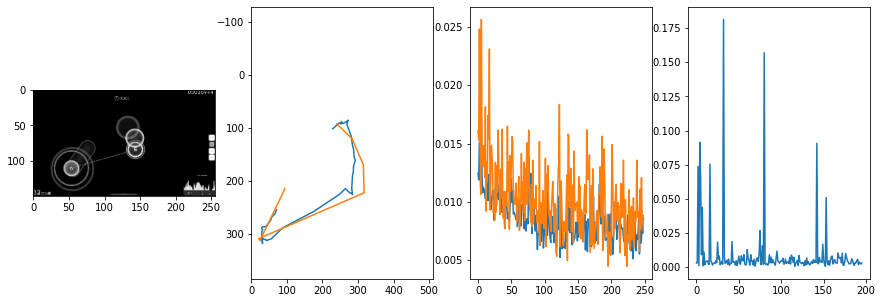


 255 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0025                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010415110227471332
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0104                                    
pred: 0.2511548399925232 0.7477214932441711
gt: 0.361328125 0.8932291865348816
(104, 121)


<Figure size 1080x360 with 0 Axes>

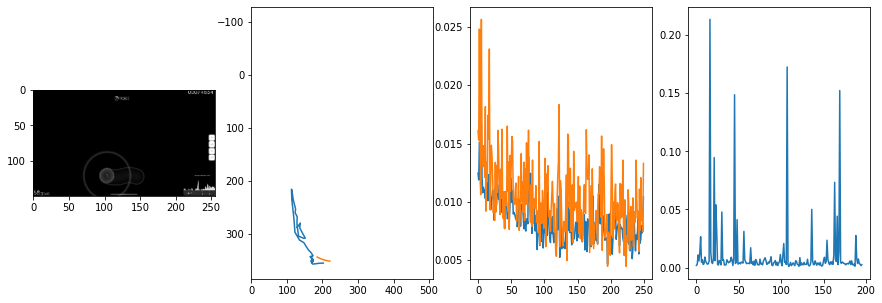


 256 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0109                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005958334535534959
outliers: 14
retrain: 4                 
val: 50/50 loss: 0.0030                                    
pred: 0.06509992480278015 0.8225839734077454
gt: 0.013128255493938923 0.7582102417945862
(50, 106)


<Figure size 1080x360 with 0 Axes>

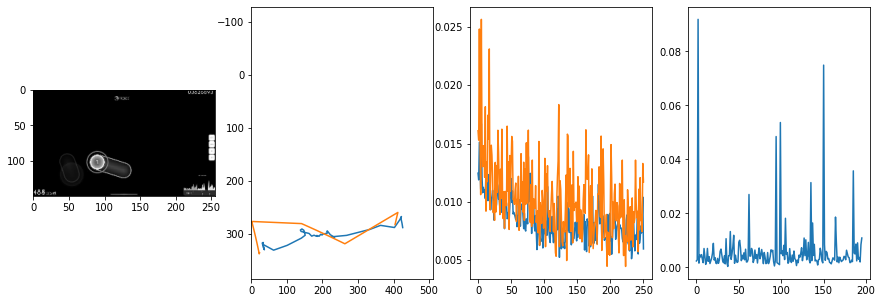


 257 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007014941287818555
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.0034                                    
pred: 0.606012761592865 0.47048303484916687
gt: 0.22636620700359344 0.6589589715003967
(83, 94)


<Figure size 1080x360 with 0 Axes>

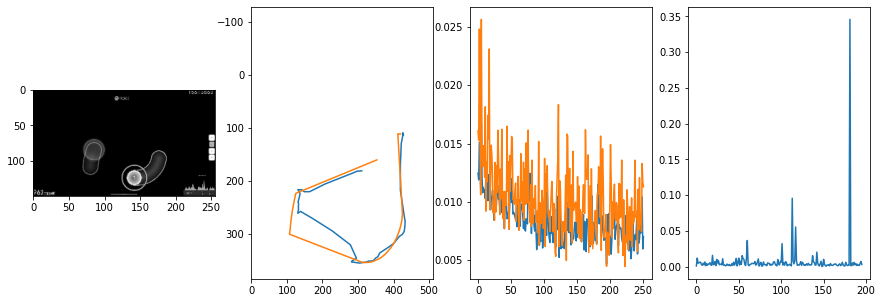


 258 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0055                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005644358115743523
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0118                                    
pred: 0.3729858696460724 0.8430273532867432
gt: 0.5703123807907104 0.9062499403953552
(136, 123)


<Figure size 1080x360 with 0 Axes>

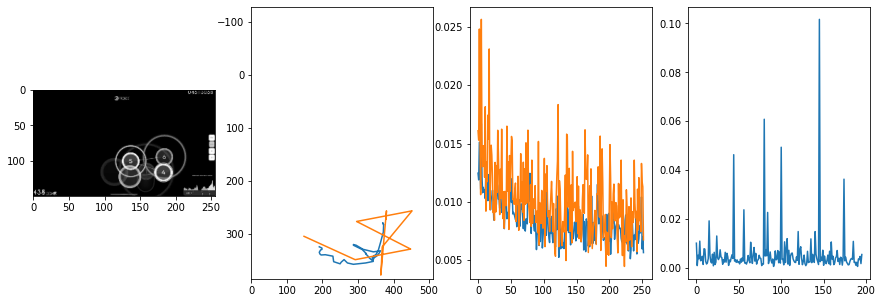


 259 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.31it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010070917594225183
outliers: 50
retrain: 4                 
val: 50/50 loss: 0.0076                                    
pred: 0.6991893649101257 0.21037083864212036
gt: 0.7545429468154907 0.3806038796901703
(165, 62)


<Figure size 1080x360 with 0 Axes>

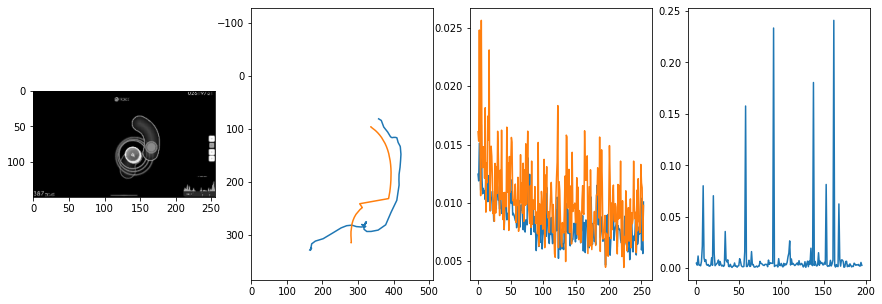


 260 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.0063                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008428969253294113
outliers: 19
retrain: 4                 
val: 50/50 loss: 0.0017                                    
pred: 0.08799508959054947 0.29063907265663147
gt: 0.13835540413856506 0.26527270674705505
(69, 48)


<Figure size 1080x360 with 0 Axes>

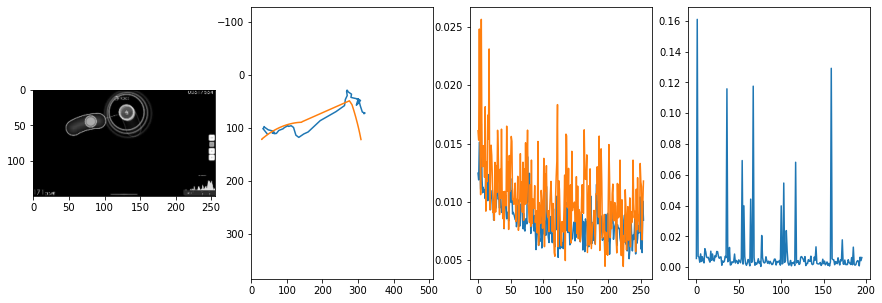


 261 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006811701179760014
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.2586000859737396 0.19390329718589783
gt: 0.25570148229599 0.13618694245815277
(87, 33)


<Figure size 1080x360 with 0 Axes>

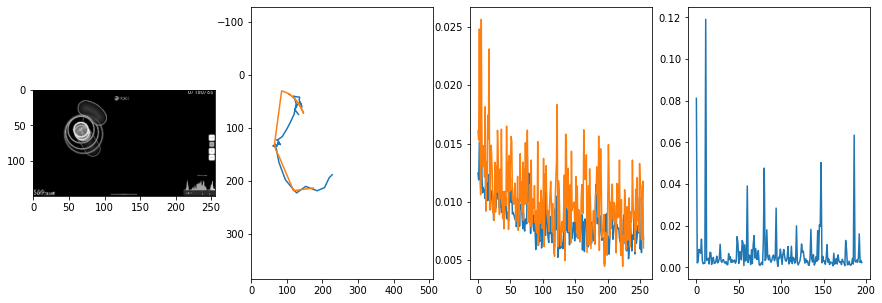


 262 of 262
2453.4348616600037 secs


In [45]:
start = time.time()

epochs = 128
loss_thresh = 0.0003
rnum_min = 4
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [46]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

0.004456234243698418


In [61]:
best_loss = 9999

1 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.36it/s  0.0016                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

avg: 0.007281389185441278
outliers: 0

val: 50/50 loss: 0.0071                                    
pred: 0.1712481826543808 0.3747568428516388
gt: 0.2930848300457001 0.39542511105537415
(93, 63)


<Figure size 1080x360 with 0 Axes>

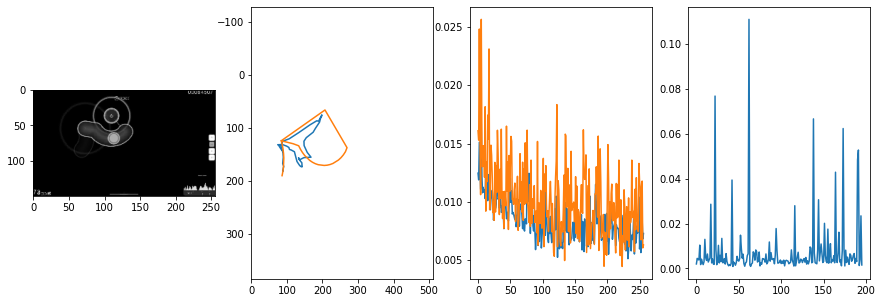


 263 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007576991305021303
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0054                                    
pred: 0.1579831838607788 0.6909722685813904
gt: 0.7319261431694031 0.4176182448863983
(161, 66)


<Figure size 1080x360 with 0 Axes>

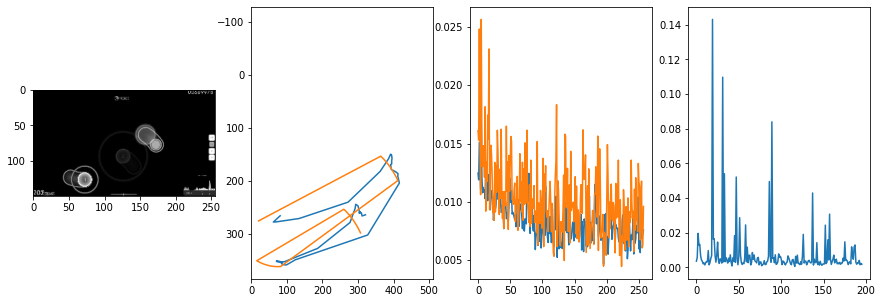


 264 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007162288519998119
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0055                                    
pred: 0.2735915184020996 0.8026872277259827
gt: 0.5468618273735046 0.5286759734153748
(132, 79)


<Figure size 1080x360 with 0 Axes>

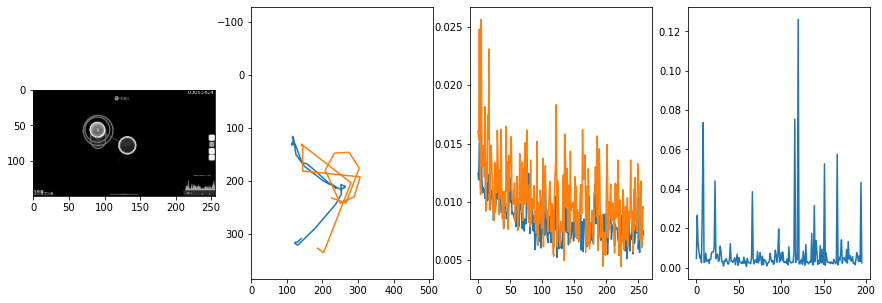


 265 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008407466987276221
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0045                                    
pred: 0.24407123029232025 0.06182287260890007
gt: 0.11328125 0.1744791716337204
(65, 38)


<Figure size 1080x360 with 0 Axes>

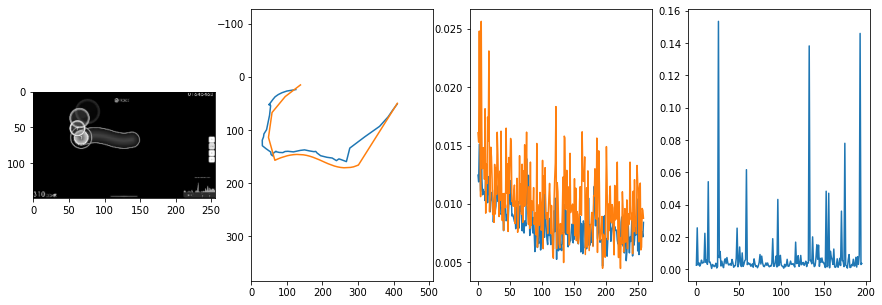


 266 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.0160                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.010348631789235455
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0017                                    
pred: 0.2435653805732727 0.16084595024585724
gt: 0.22135792672634125 0.09139367192983627
(82, 28)


<Figure size 1080x360 with 0 Axes>

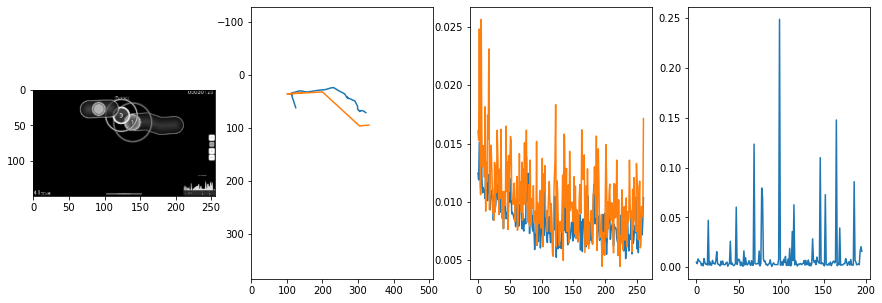


 267 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.39it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008885559916961938
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.0051                                    
pred: 0.8086045980453491 0.47258031368255615
gt: 0.48828125 0.671875
(123, 96)


<Figure size 1080x360 with 0 Axes>

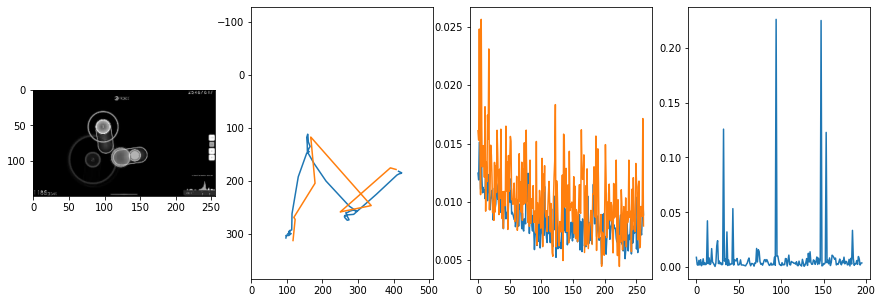


 268 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0021                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008428983936473556
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.0023                                    
pred: 0.7018709182739258 0.814777135848999
gt: 0.6376953125 0.8515625
(146, 117)


<Figure size 1080x360 with 0 Axes>

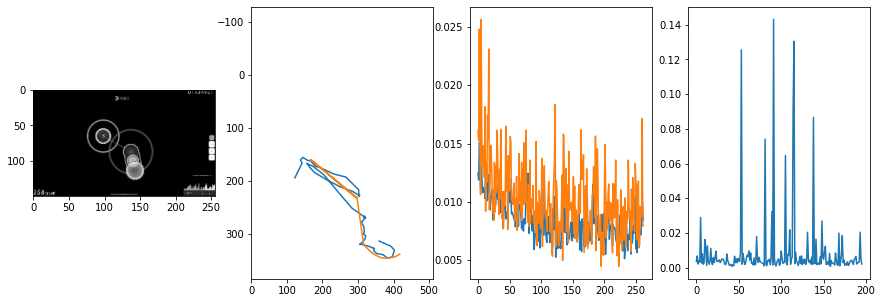


 269 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0032                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006803200747972183
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0041                                    
pred: 0.49095749855041504 0.34089988470077515
gt: 0.0546875 0.3177083432674408
(56, 54)


<Figure size 1080x360 with 0 Axes>

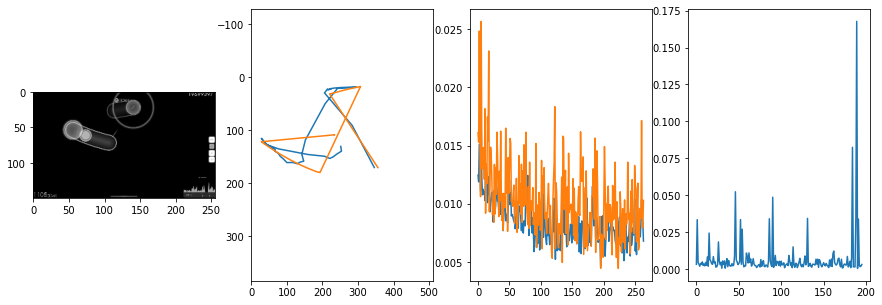


 270 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.29it/s  0.0034                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00886244613948107
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0046                                    
pred: 0.14362379908561707 0.41975176334381104
gt: 0.14638258516788483 0.3917800188064575
(70, 63)


<Figure size 1080x360 with 0 Axes>

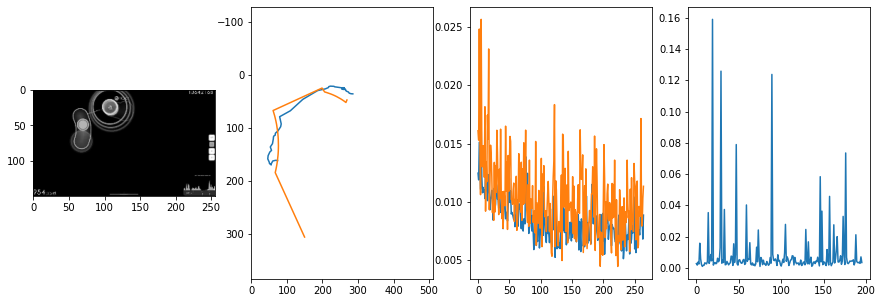


 271 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0043                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007262132220844529
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0021                                    
pred: 0.593941867351532 0.34739500284194946
gt: 0.4531256854534149 0.27343839406967163
(118, 49)


<Figure size 1080x360 with 0 Axes>

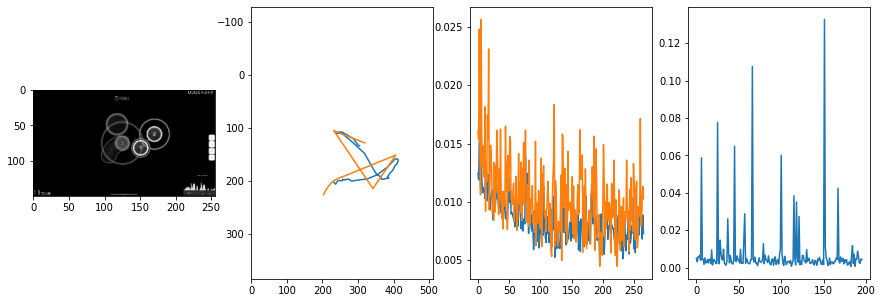


 272 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.26it/s  0.0068                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00581700512658263
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.6261163353919983 0.2851782739162445
gt: 0.5471165776252747 0.6657004356384277
(132, 95)


<Figure size 1080x360 with 0 Axes>

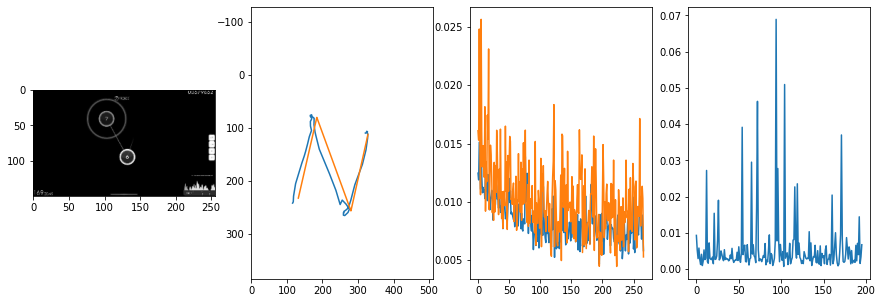


 273 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0029                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007201357033966128
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0051                                    
pred: 0.3626406490802765 0.4764748215675354
gt: 0.4786456227302551 0.41163167357444763
(122, 65)


<Figure size 1080x360 with 0 Axes>

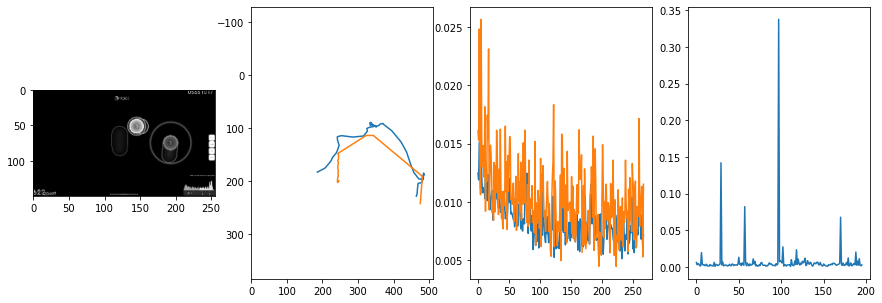


 274 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0008                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006298088893289582
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.0025                                    
pred: 0.15898583829402924 0.6343190670013428
gt: 0.625 0.8854166865348816
(144, 120)


<Figure size 1080x360 with 0 Axes>

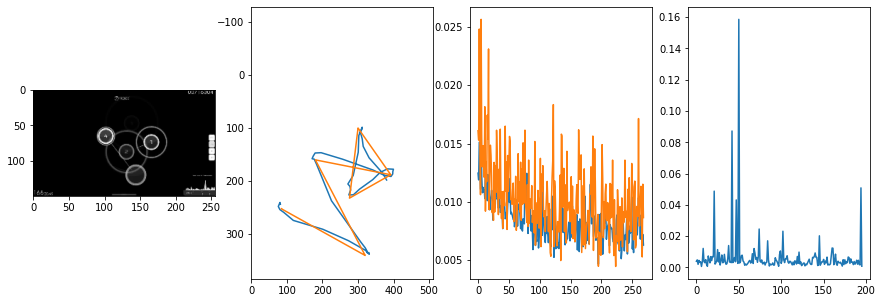


 275 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006361950417548152
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0025                                    
pred: 0.8558534383773804 0.8082090020179749
gt: 0.9594384431838989 0.6030846834182739
(196, 88)


<Figure size 1080x360 with 0 Axes>

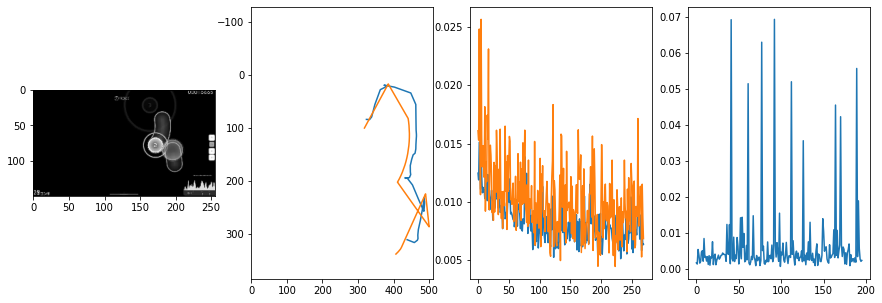


 276 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006211546468114889
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0052                                    
pred: 0.8765496015548706 0.6075184345245361
gt: 0.47770988941192627 0.4586285650730133
(122, 71)


<Figure size 1080x360 with 0 Axes>

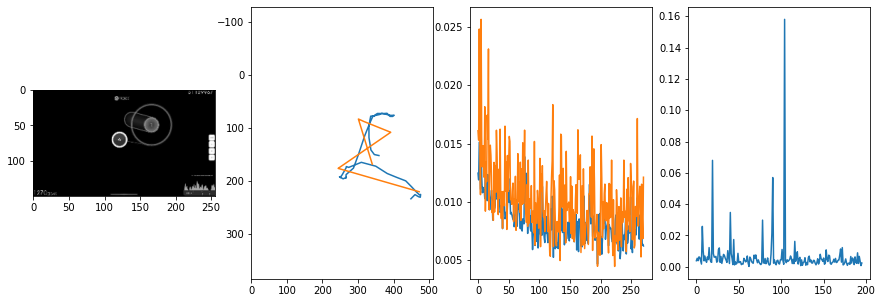


 277 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.0067                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006758289052320796
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0021                                    
pred: 0.5842211842536926 0.740949273109436
gt: 0.42383873462677 0.8958187103271484
(113, 122)


<Figure size 1080x360 with 0 Axes>

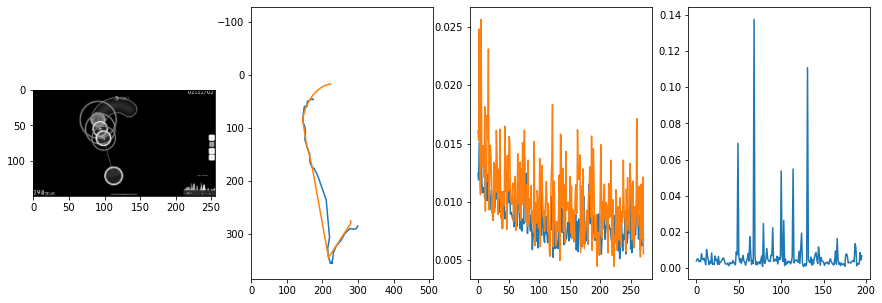


 278 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006216975367908385
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0542                                    
pred: 0.30805858969688416 0.24100962281227112
gt: 0.36871451139450073 0.741619348526001
(105, 104)


<Figure size 1080x360 with 0 Axes>

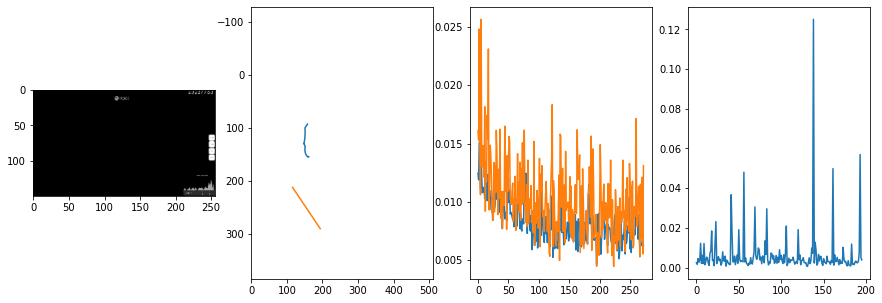


 279 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.40it/s  0.0045                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007801096566105784
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0026                                    
pred: 0.32164642214775085 0.18370164930820465
gt: 0.4238280951976776 0.4947916567325592
(113, 75)


<Figure size 1080x360 with 0 Axes>

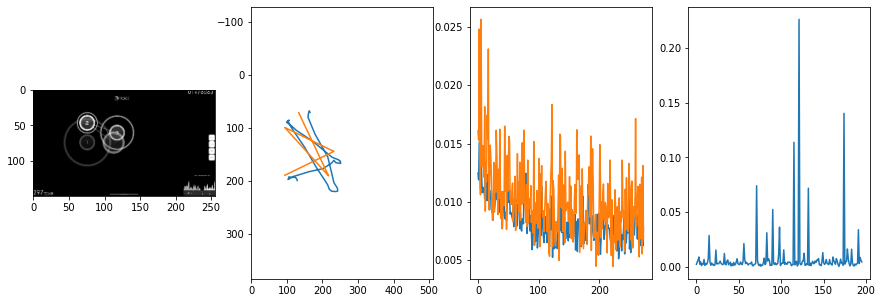


 280 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.26it/s  0.0044                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006724179183353898
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0017                                    
pred: 0.7096299529075623 0.8114799857139587
gt: 0.6602889895439148 0.8794183731079102
(150, 120)


<Figure size 1080x360 with 0 Axes>

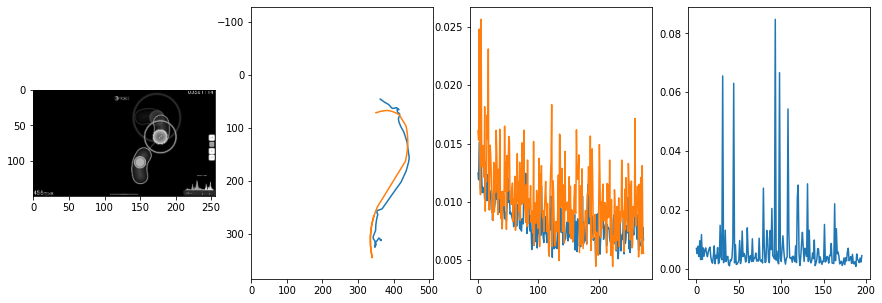


 281 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005930289312809877
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0009                                    
pred: 0.3411937355995178 0.3648262023925781
gt: 0.8593488931655884 0.5208192467689514
(181, 78)


<Figure size 1080x360 with 0 Axes>

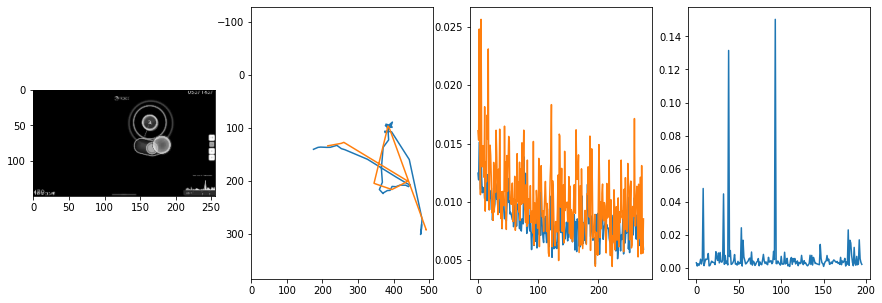


 282 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0051                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008256612207778558
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0021                                    
pred: 0.42636361718177795 0.922261655330658
gt: 0.5249760150909424 0.9583916664123535
(129, 129)


<Figure size 1080x360 with 0 Axes>

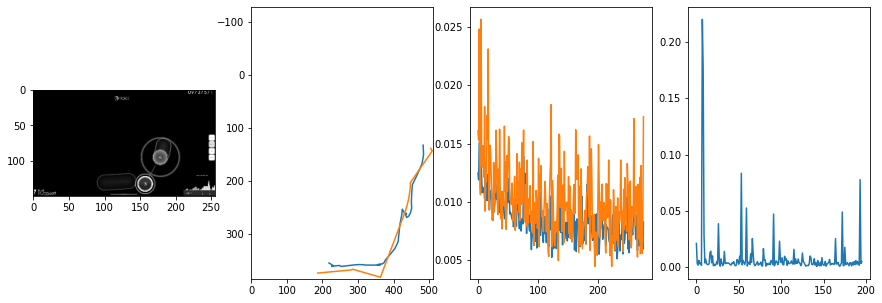


 283 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0018                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005505912496360276
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0063                                    
pred: 0.4227953553199768 0.42417171597480774
gt: 0.1775978058576584 0.8680986762046814
(75, 118)


<Figure size 1080x360 with 0 Axes>

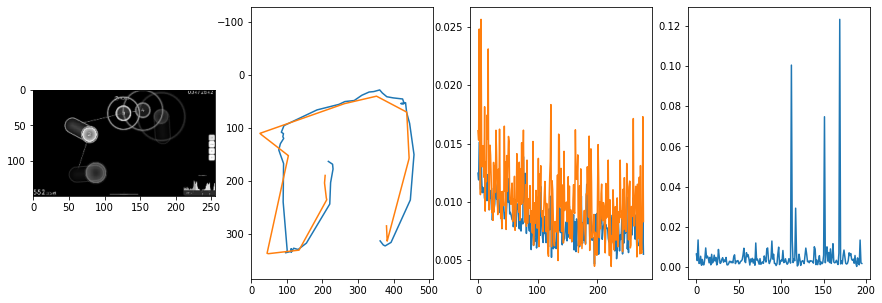


 284 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.0018                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00665935905167966
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.0043                                    
pred: 0.6174689531326294 0.9274011850357056
gt: 0.7323101162910461 0.9144312739372253
(161, 124)


<Figure size 1080x360 with 0 Axes>

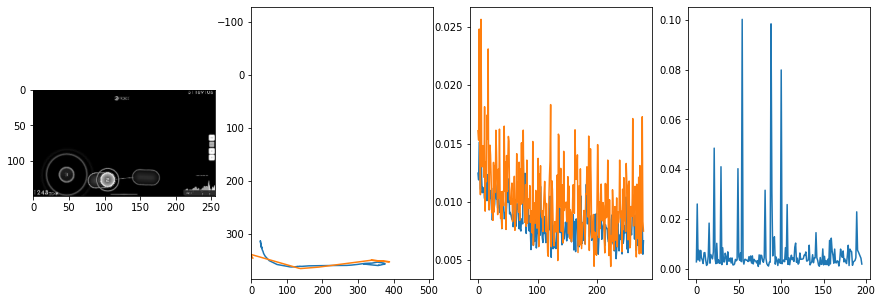


 285 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.0024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00883955399063891
outliers: 60
retrain: 4                 
val: 50/50 loss: 0.0093                                    
pred: 0.4964347779750824 0.7152670621871948
gt: 0.5917840003967285 0.7838375568389893
(139, 109)


<Figure size 1080x360 with 0 Axes>

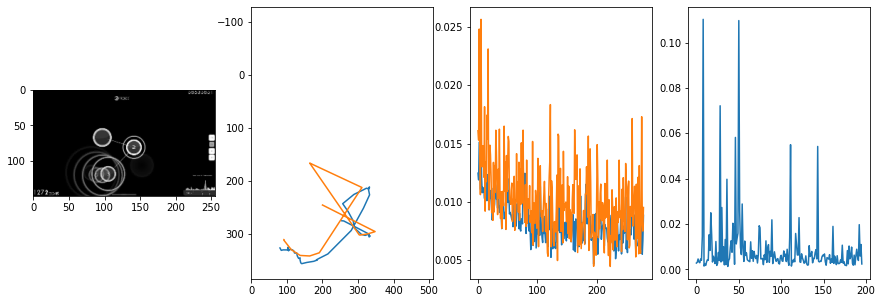


 286 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008005309366646023
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0024                                    
pred: 0.3890269100666046 0.8701581358909607
gt: 0.37109318375587463 0.843749463558197
(105, 116)


<Figure size 1080x360 with 0 Axes>

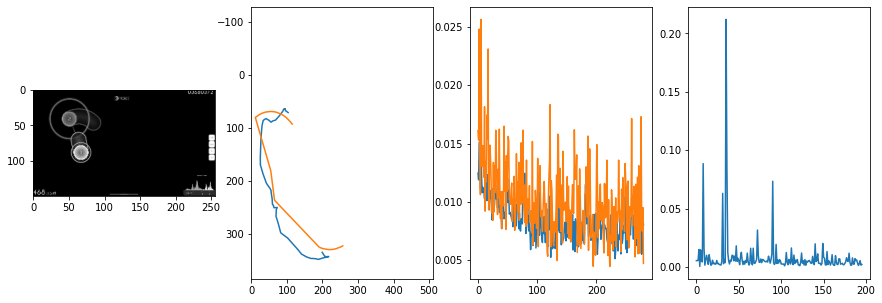


 287 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.0415                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00597441766223376
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.0032                                    
pred: 0.21242119371891022 0.24587006866931915
gt: 0.13478998839855194 0.32626673579216003
(68, 55)


<Figure size 1080x360 with 0 Axes>

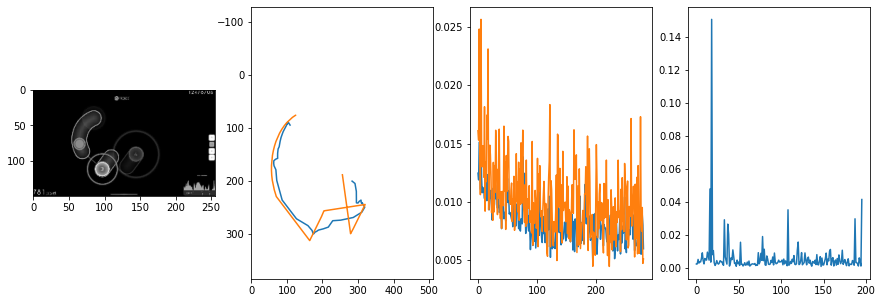


 288 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006050777289842978
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.554658830165863 0.32716605067253113
gt: 0.5934137105941772 0.5533596277236938
(140, 82)


<Figure size 1080x360 with 0 Axes>

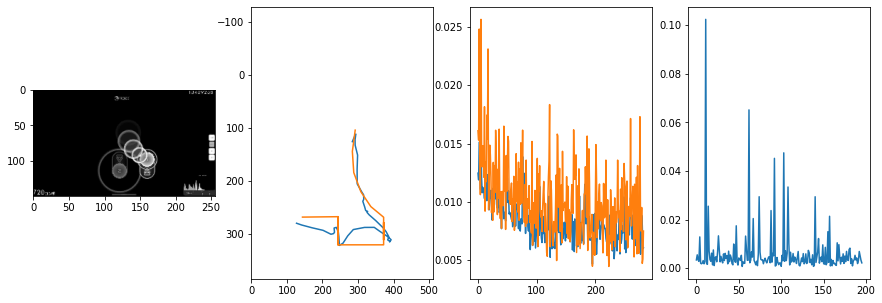


 289 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.29it/s  0.0013                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008117829379388037
outliers: 54
retrain: 4                 
val: 50/50 loss: 0.0023                                    
pred: 0.6004960536956787 0.7453628182411194
gt: 0.7039409279823303 0.7021518349647522
(157, 99)


<Figure size 1080x360 with 0 Axes>

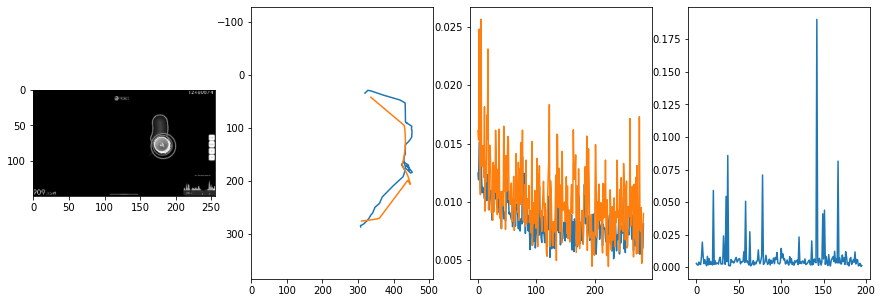


 290 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0744                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005690228854477101
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.0019                                    
pred: 0.7973167896270752 0.3445294201374054
gt: 0.8887549638748169 0.38907715678215027
(185, 63)


<Figure size 1080x360 with 0 Axes>

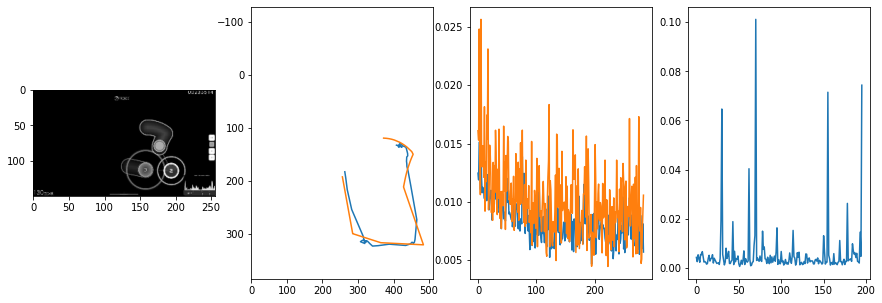


 291 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0053                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00548708516518153
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0014                                    
pred: 0.20113910734653473 0.7516732811927795
gt: 0.3255722224712372 0.5753604173660278
(98, 84)


<Figure size 1080x360 with 0 Axes>

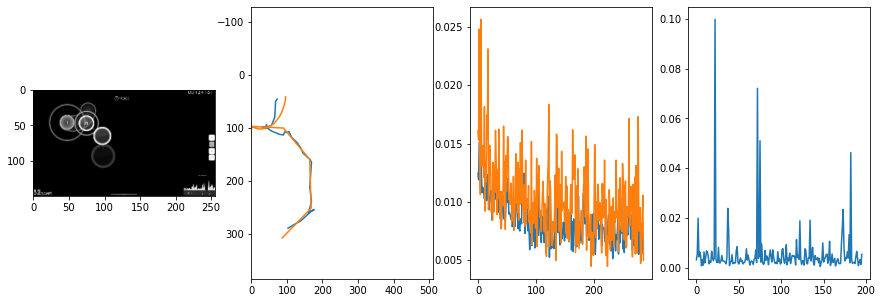


 292 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0008                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004653365698129851
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.0468                                    
pred: 0.5210024118423462 0.5101116895675659
gt: 0.16210967302322388 0.31770849227905273
(73, 54)


<Figure size 1080x360 with 0 Axes>

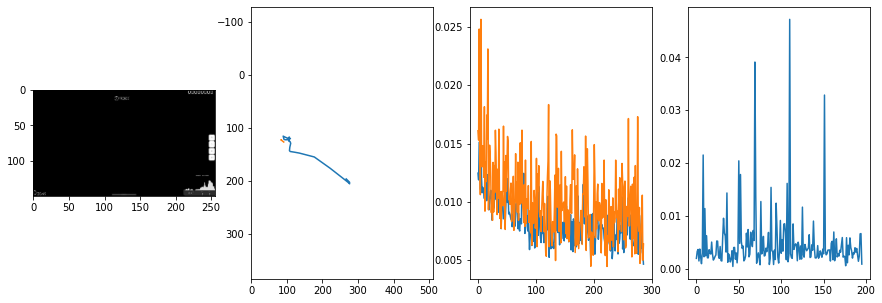


 293 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0021                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006669425461987718
outliers: 59
retrain: 4                 
val: 50/50 loss: 0.0071                                    
pred: 0.11829278618097305 0.7463834285736084
gt: 0.4296875 0.7916666865348816
(114, 110)


<Figure size 1080x360 with 0 Axes>

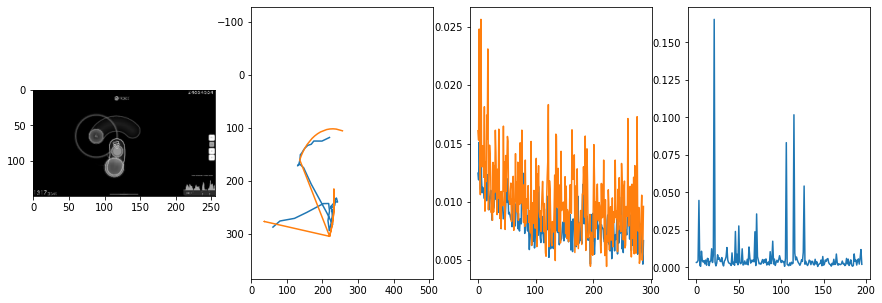


 294 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005360660174973214
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.0027                                    
pred: 0.40453770756721497 0.4853860139846802
gt: 0.3147059977054596 0.6768725514411926
(96, 96)


<Figure size 1080x360 with 0 Axes>

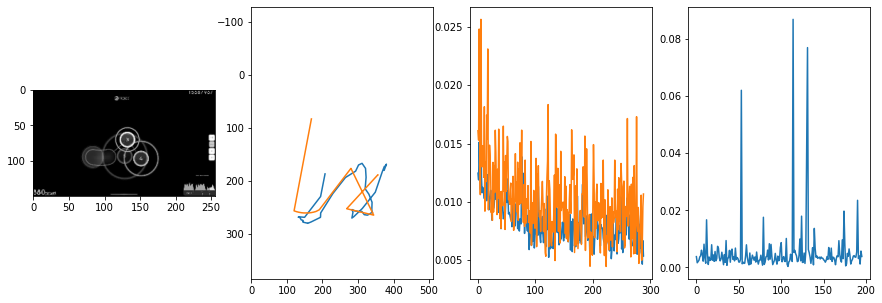


 295 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0166                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005108313463189953
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0029                                    
pred: 0.15609429776668549 0.545421302318573
gt: 0.15625 0.5169270634651184
(72, 78)


<Figure size 1080x360 with 0 Axes>

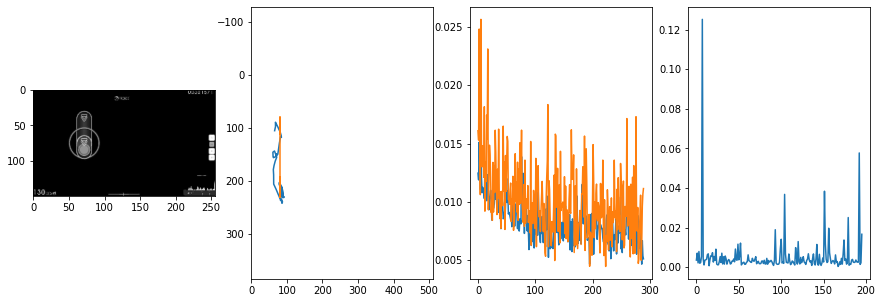


 296 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0122                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0052667572056133375
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.0073                                    
pred: 0.4384555220603943 0.9027215838432312
gt: 0.373046875 0.6796875
(105, 97)


<Figure size 1080x360 with 0 Axes>

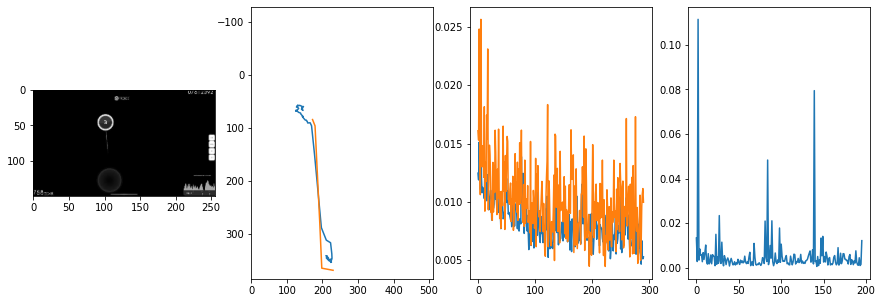


 297 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.0048                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005678126592621473
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0033                                    
pred: 0.5035404562950134 0.7259362936019897
gt: 0.53515625 0.7916666865348816
(130, 110)


<Figure size 1080x360 with 0 Axes>

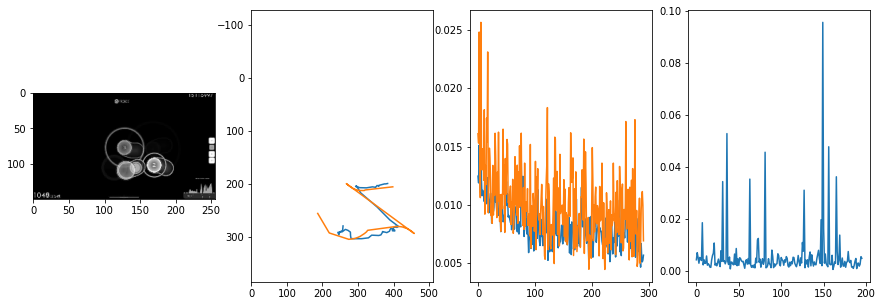


 298 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  0.0030                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007301398155746307
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.0037                                    
pred: 0.45173782110214233 0.424125611782074
gt: 0.4857500195503235 0.48099997639656067
(123, 73)


<Figure size 1080x360 with 0 Axes>

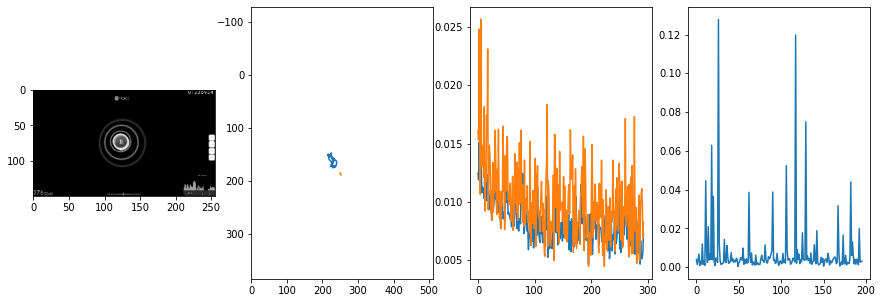


 299 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0021                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006073175908401323
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0024                                    
pred: 0.7592816352844238 0.38827911019325256
gt: 0.6010645031929016 0.48162996768951416
(141, 74)


<Figure size 1080x360 with 0 Axes>

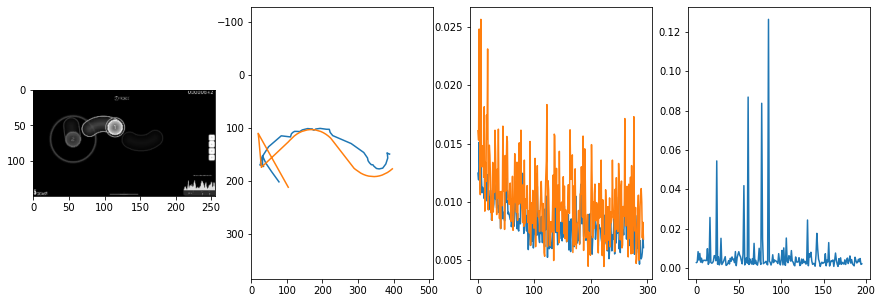


 300 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.0045                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007440526709578247
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0015                                    
pred: 0.6720622181892395 0.8686489462852478
gt: 0.7700597047805786 0.8019357323646545
(167, 111)


<Figure size 1080x360 with 0 Axes>

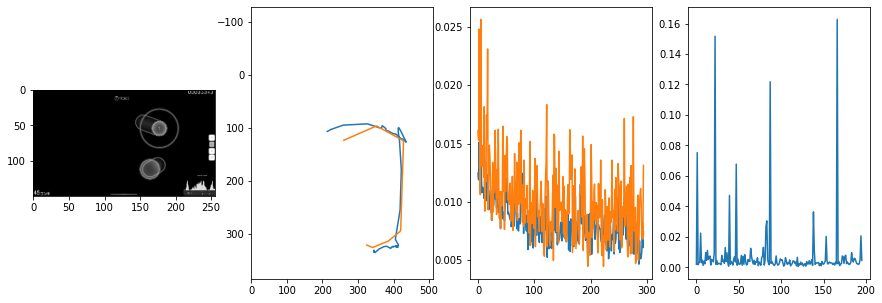


 301 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0017                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006507112613430114
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0035                                    
pred: 0.5129172205924988 0.7710051536560059
gt: 0.5077477097511292 0.8749136328697205
(126, 119)


<Figure size 1080x360 with 0 Axes>

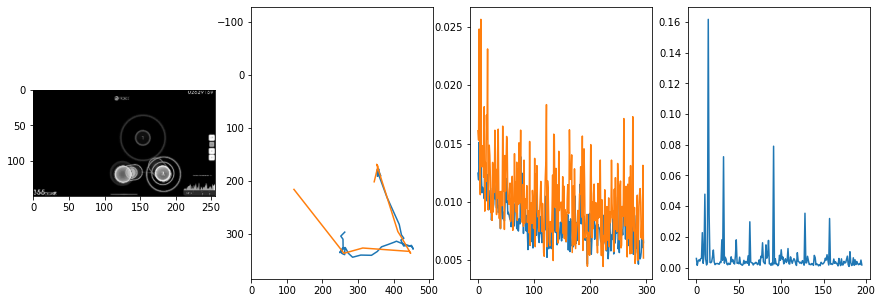


 302 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0033                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0078118123492458835
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0046                                    
pred: 0.34876748919487 0.5034869313240051
gt: 0.4042954742908478 0.4479127824306488
(110, 70)


<Figure size 1080x360 with 0 Axes>

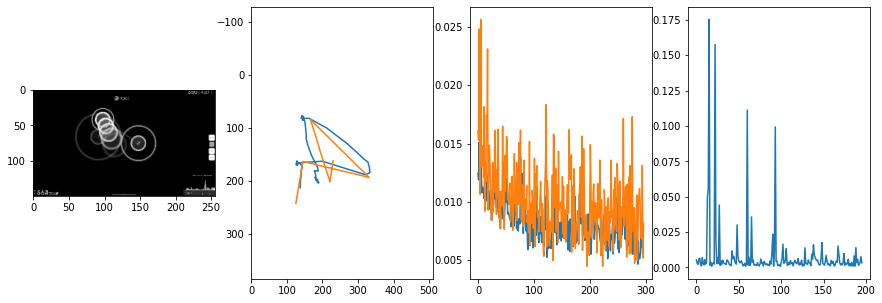


 303 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  0.0020                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006005450854510335
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0037                                    
pred: 0.5439344644546509 0.878462016582489
gt: 0.5861145257949829 0.8803372979164124
(138, 120)


<Figure size 1080x360 with 0 Axes>

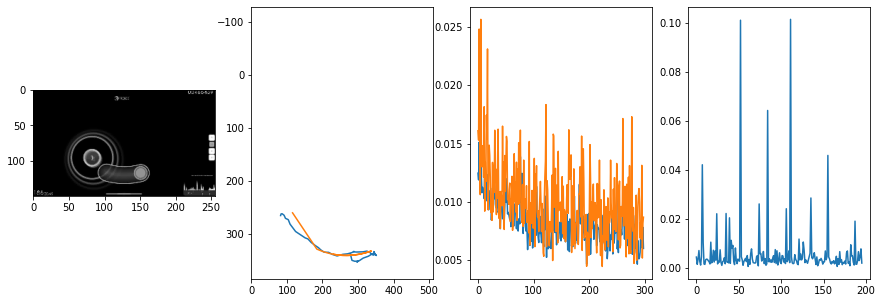


 304 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  0.0035                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006413293014368404
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0050                                    
pred: 0.24108393490314484 0.4735903739929199
gt: 0.31197091937065125 0.48402225971221924
(96, 74)


<Figure size 1080x360 with 0 Axes>

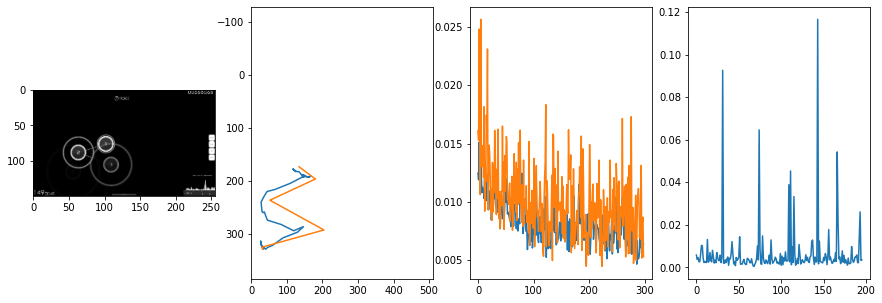


 305 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0070                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006094795706080824
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0017                                    
pred: 0.48116371035575867 0.4986116886138916
gt: 0.3697916567325592 0.5
(105, 76)


<Figure size 1080x360 with 0 Axes>

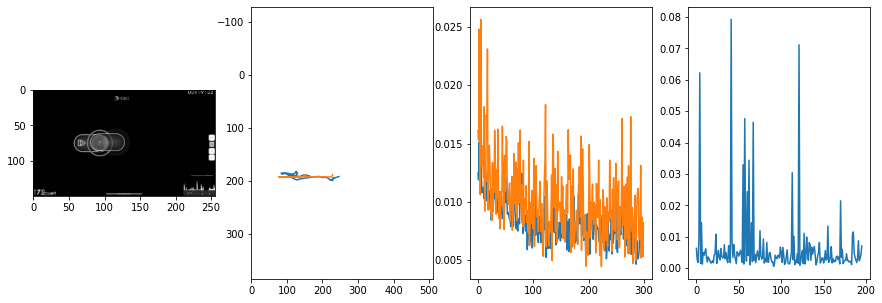


 306 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005139420701996233
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0052                                    
pred: 0.7361802458763123 0.5620127320289612
gt: 0.9921875 0.9557291865348816
(201, 129)


<Figure size 1080x360 with 0 Axes>

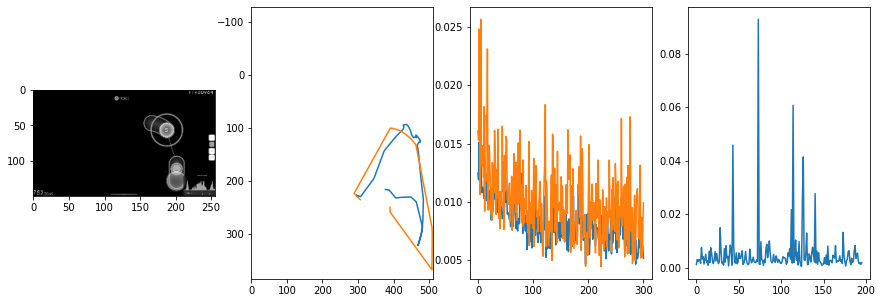


 307 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0014                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005943094112325878
outliers: 44
retrain: 4                 
val: 50/50 loss: 0.0025                                    
pred: 0.49957674741744995 0.4004588723182678
gt: 0.5264151692390442 0.2153441160917282
(129, 43)


<Figure size 1080x360 with 0 Axes>

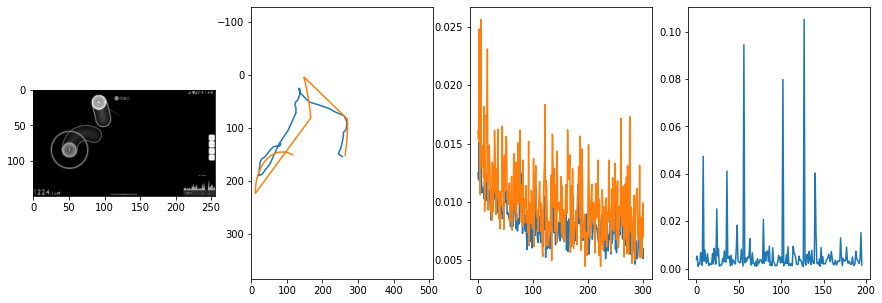


 308 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0050                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005933270893495189
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0024                                    
pred: 0.6982727646827698 0.3754872679710388
gt: 0.4921875596046448 0.28125008940696716
(124, 50)


<Figure size 1080x360 with 0 Axes>

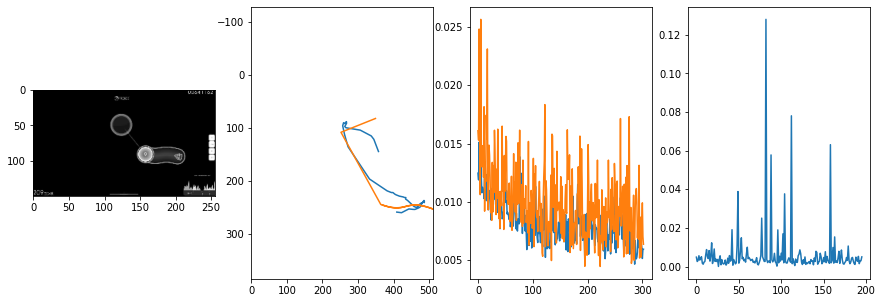


 309 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0035                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005299483600835202
outliers: 30
retrain: 4                 
val: 50/50 loss: 0.0080                                    
pred: 0.5017361044883728 0.5139837265014648
gt: 0.5369119048118591 0.379451185464859
(131, 62)


<Figure size 1080x360 with 0 Axes>

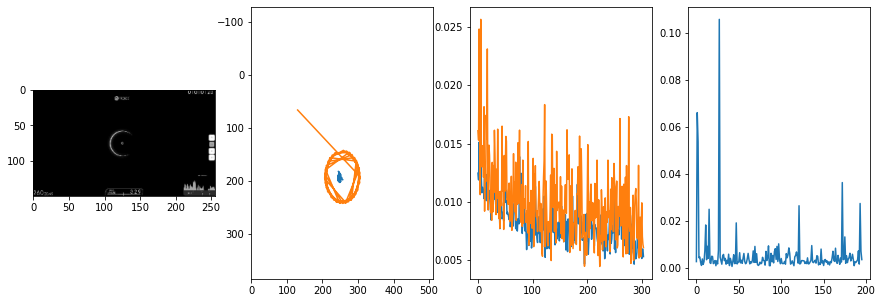


 310 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0057720712452000765
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0029                                    
pred: 0.3906199038028717 0.5094047784805298
gt: 0.3149374723434448 0.45887497067451477
(96, 71)


<Figure size 1080x360 with 0 Axes>

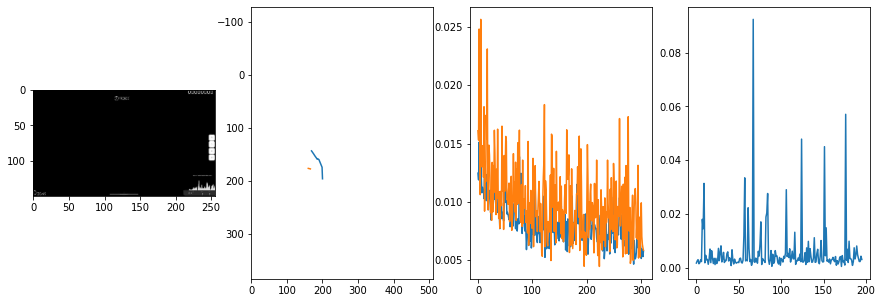


 311 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0017                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004738136758607318
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0083                                    
pred: 0.19914473593235016 0.7063283324241638
gt: 0.265625 0.7369791865348816
(89, 103)


<Figure size 1080x360 with 0 Axes>

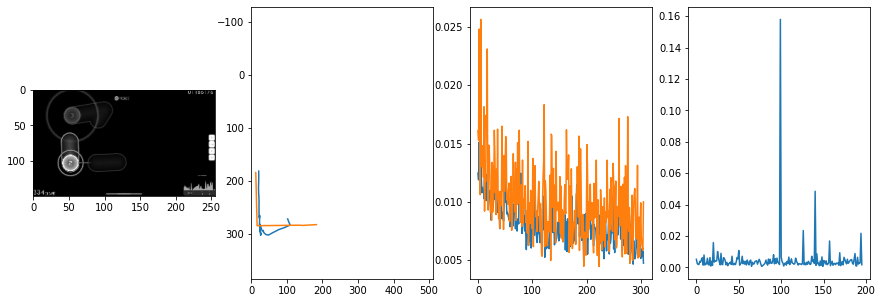


 312 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0346                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006216578048800014
outliers: 56
retrain: 4                 
val: 50/50 loss: 0.0045                                    
pred: 0.41274353861808777 0.5142102837562561
gt: 0.4062540531158447 0.7395671010017395
(111, 104)


<Figure size 1080x360 with 0 Axes>

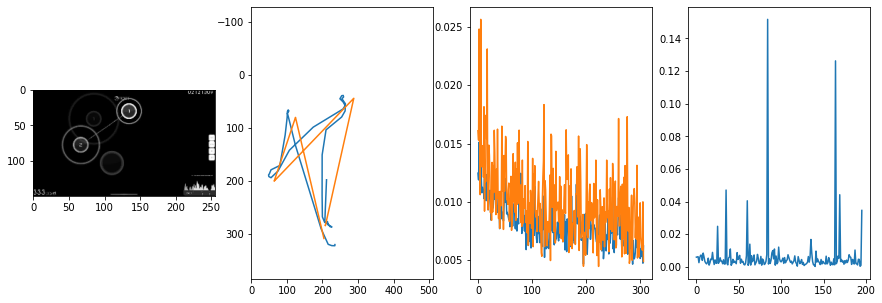


 313 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0033                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006251658201015706
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0072                                    
pred: 0.3502372205257416 0.3485153317451477
gt: 0.3107951283454895 0.6139600872993469
(96, 89)


<Figure size 1080x360 with 0 Axes>

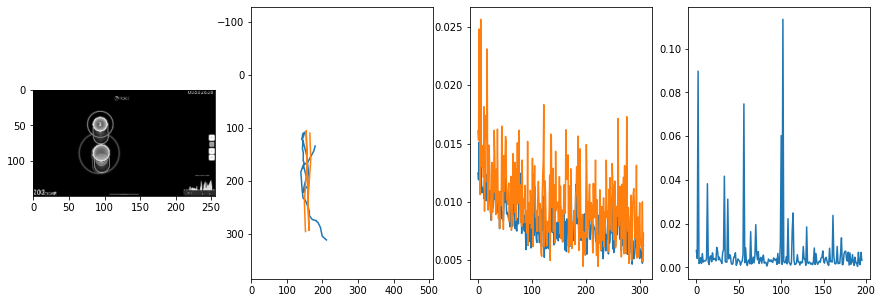


 314 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.30it/s  0.0036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0063096053187963455
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0026                                    
pred: 0.7058812975883484 0.42316508293151855
gt: 0.16330736875534058 0.5201300978660583
(73, 78)


<Figure size 1080x360 with 0 Axes>

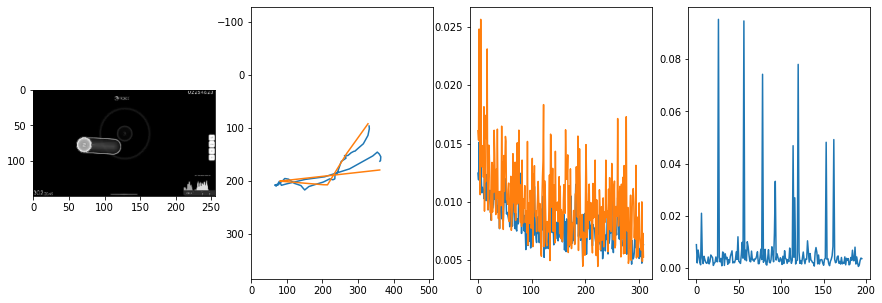


 315 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0038                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0057273870622097725
outliers: 35
retrain: 4                 
val: 50/50 loss: 0.0111                                    
pred: 0.598612368106842 0.5026308298110962
gt: 0.6094720363616943 0.29181593656539917
(142, 51)


<Figure size 1080x360 with 0 Axes>

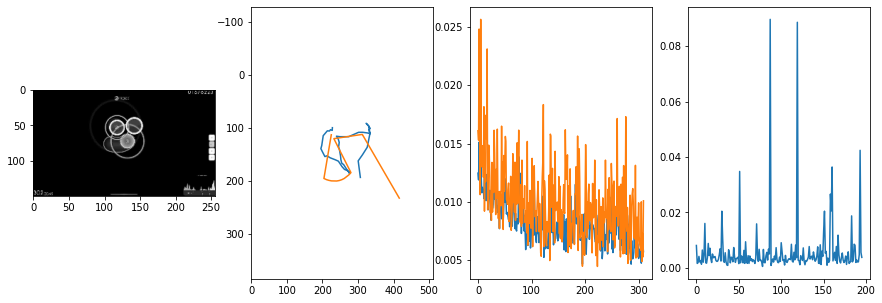


 316 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0013                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005257500466170165
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0051                                    
pred: 0.14209428429603577 0.6940845251083374
gt: 0.19622595608234406 0.6766193509101868
(78, 96)


<Figure size 1080x360 with 0 Axes>

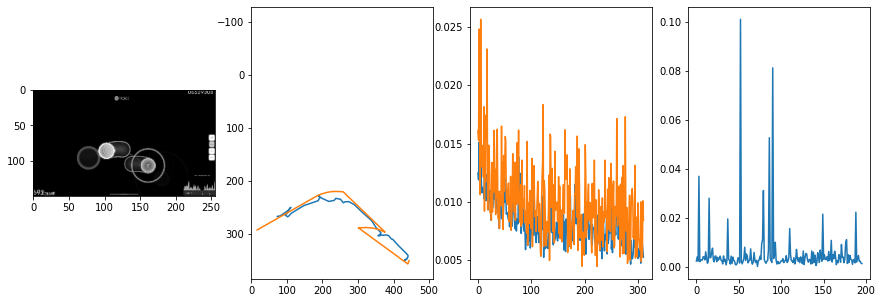


 317 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0014                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0070395442189135566
outliers: 39
retrain: 4                 
val: 50/50 loss: 0.0016                                    
pred: 0.8895969986915588 0.3256855309009552
gt: 0.9061908721923828 0.5295895338058472
(188, 79)


<Figure size 1080x360 with 0 Axes>

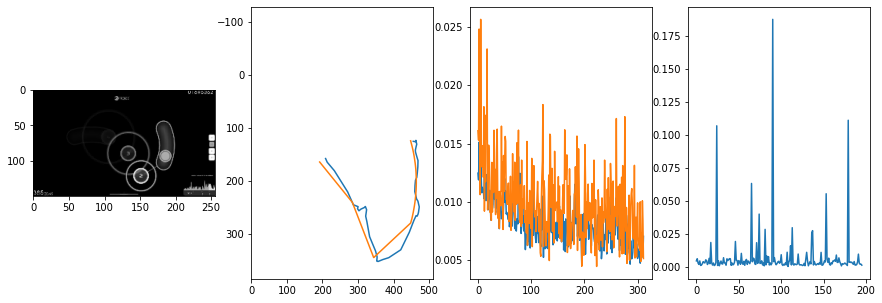


 318 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.0095                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006929262931760382
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0039                                    
pred: 0.437483012676239 0.7937092185020447
gt: 0.4190512001514435 0.6751380562782288
(112, 96)


<Figure size 1080x360 with 0 Axes>

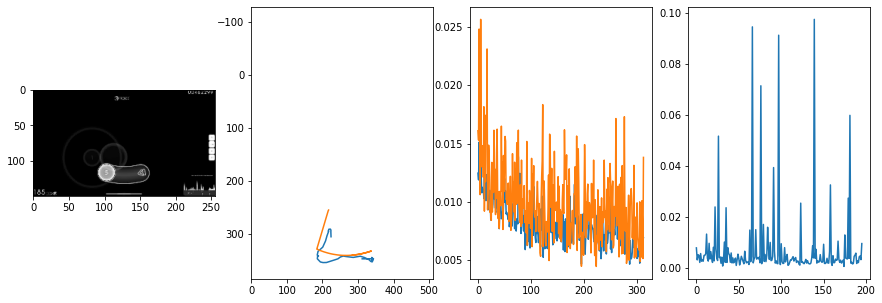


 319 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.2031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0062531447741892
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0027                                    
pred: 0.392098605632782 0.4212648272514343
gt: 0.14257818460464478 0.5026041865348816
(70, 76)


<Figure size 1080x360 with 0 Axes>

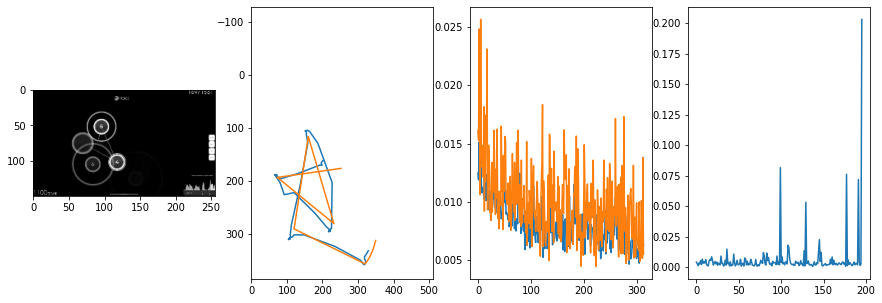


 320 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0014                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008618994986600414
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.0123                                    
pred: 0.4368571937084198 0.7854745984077454
gt: 0.8225664496421814 0.7566771507263184
(175, 106)


<Figure size 1080x360 with 0 Axes>

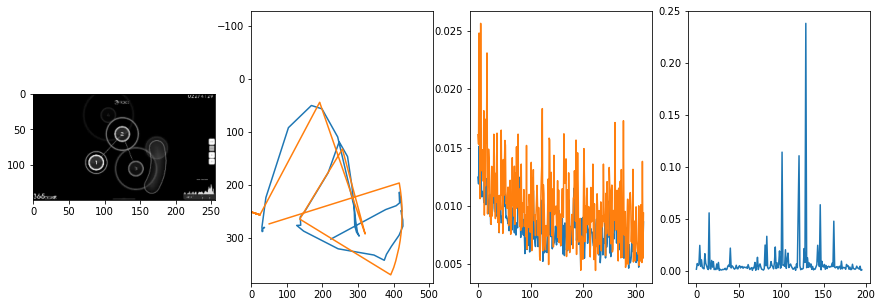


 321 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0157                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00556425712851223
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0060                                    
pred: 0.15999716520309448 0.6448966264724731
gt: 0.17777639627456665 0.5609577894210815
(75, 83)


<Figure size 1080x360 with 0 Axes>

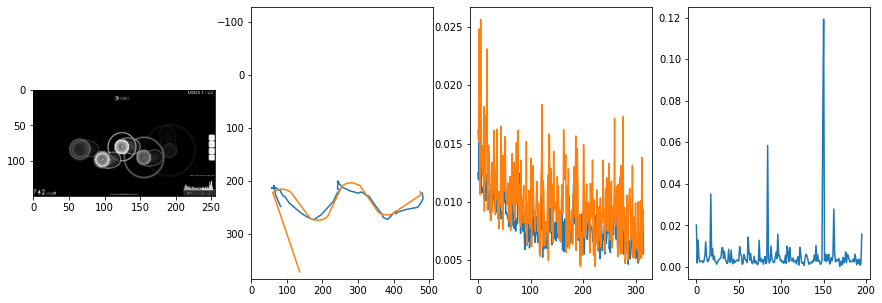


 322 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.33it/s  0.0029                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009943610251755263
outliers: 42
retrain: 4                 
val: 50/50 loss: 0.0039                                    
pred: 0.6544638872146606 0.16741172969341278
gt: 0.802971601486206 0.372712105512619
(172, 61)


<Figure size 1080x360 with 0 Axes>

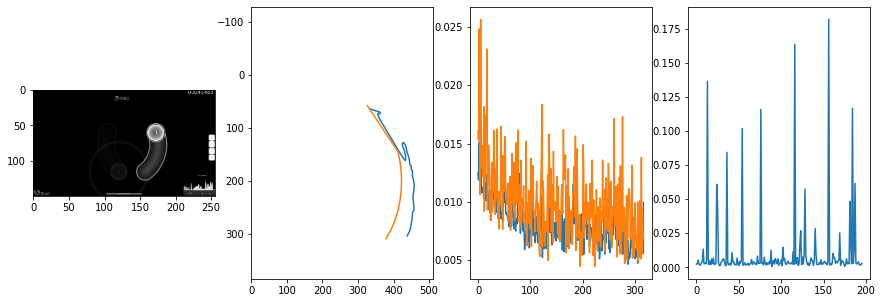


 323 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.0008                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008000277411917282
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0024                                    
pred: 0.41422009468078613 0.5838111042976379
gt: 0.62890625 0.3515625
(145, 58)


<Figure size 1080x360 with 0 Axes>

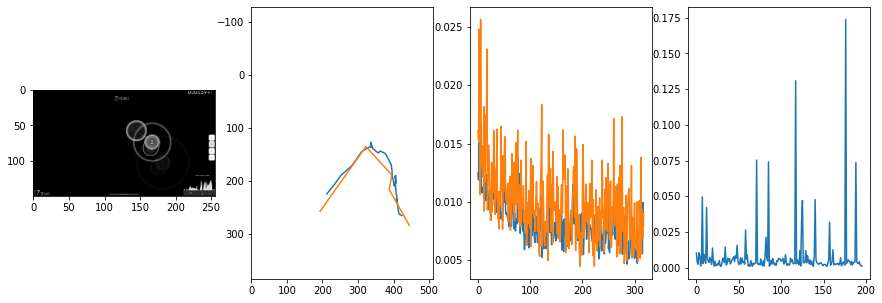


 324 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.0018                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00854432830178388
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0048                                    
pred: 0.7049424052238464 0.53932785987854
gt: 0.7046653628349304 0.40830376744270325
(157, 65)


<Figure size 1080x360 with 0 Axes>

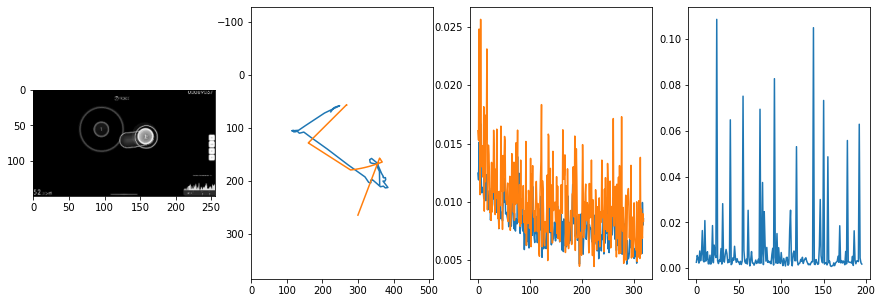


 325 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0014                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006717501403894561
outliers: 21
retrain: 4                 
val: 50/50 loss: 0.0029                                    
pred: 0.11967070400714874 0.3081957995891571
gt: 0.37109375 0.625
(105, 90)


<Figure size 1080x360 with 0 Axes>

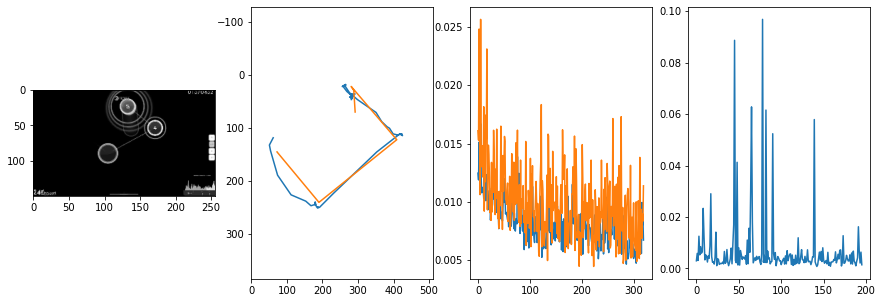


 326 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0032                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007626253676752807
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0069                                    
pred: 0.45956262946128845 0.4773293435573578
gt: 0.5814192891120911 0.5718967914581299
(138, 84)


<Figure size 1080x360 with 0 Axes>

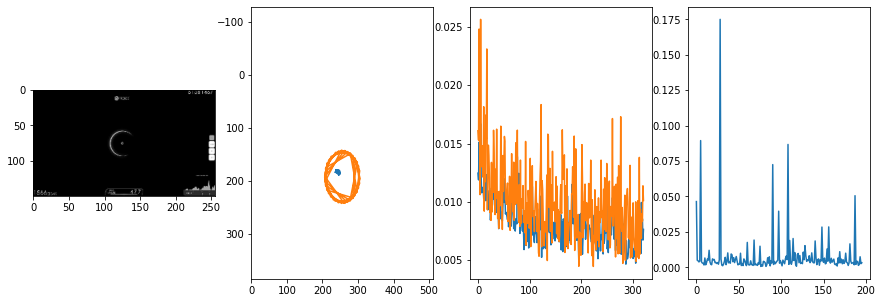


 327 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0051                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0075211094986951475
outliers: 26
retrain: 4                 
val: 50/50 loss: 0.0032                                    
pred: 0.4412914514541626 0.1489330530166626
gt: 0.4473780393600464 0.3831852376461029
(117, 62)


<Figure size 1080x360 with 0 Axes>

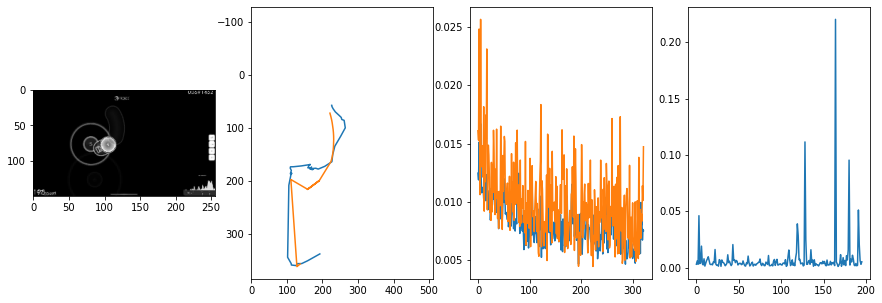


 328 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0044                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006144315952005112
outliers: 31
retrain: 4                 
val: 50/50 loss: 0.0094                                    
pred: 0.2599683105945587 0.6973018646240234
gt: 0.5135690569877625 0.2894744873046875
(127, 51)


<Figure size 1080x360 with 0 Axes>

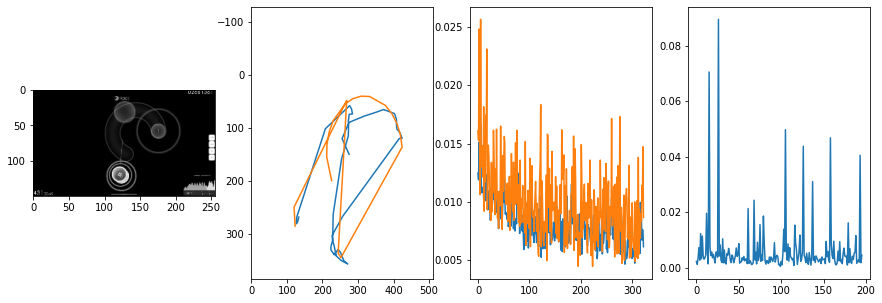


 329 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.0061                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005482217565722935
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.5011385083198547 0.8000455498695374
gt: 0.046875 0.75
(55, 105)


<Figure size 1080x360 with 0 Axes>

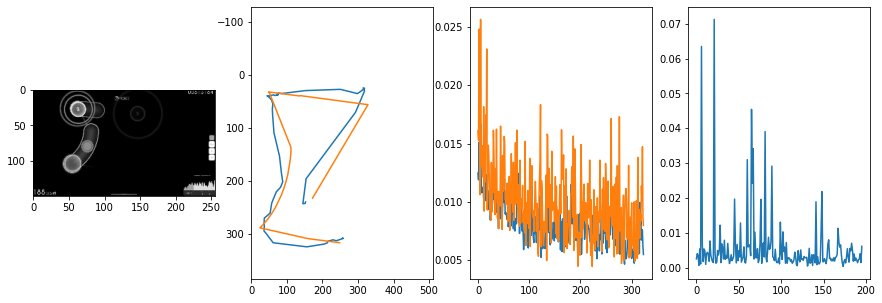


 330 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0019                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007028664293584927
outliers: 47
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.5024868249893188 0.1991528570652008
gt: 0.509211003780365 0.2155127376317978
(126, 43)


<Figure size 1080x360 with 0 Axes>

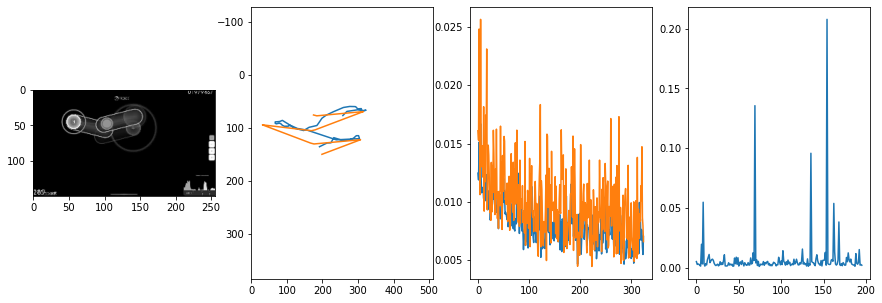


 331 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  0.0058                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004625153946999118
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0211                                    
pred: 0.40279892086982727 0.7268434762954712
gt: 0.45323485136032104 0.8639113306999207
(118, 118)


<Figure size 1080x360 with 0 Axes>

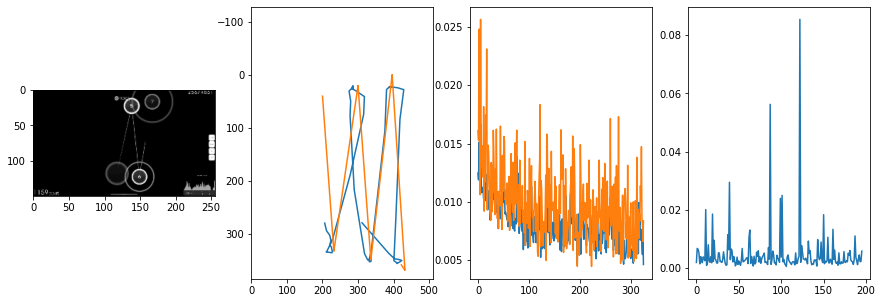


 332 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.31it/s  0.0148                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005818956424226766
outliers: 55
retrain: 4                 
val: 50/50 loss: 0.0026                                    
pred: 0.8824129700660706 0.445785790681839
gt: 0.875 0.40312501788139343
(183, 64)


<Figure size 1080x360 with 0 Axes>

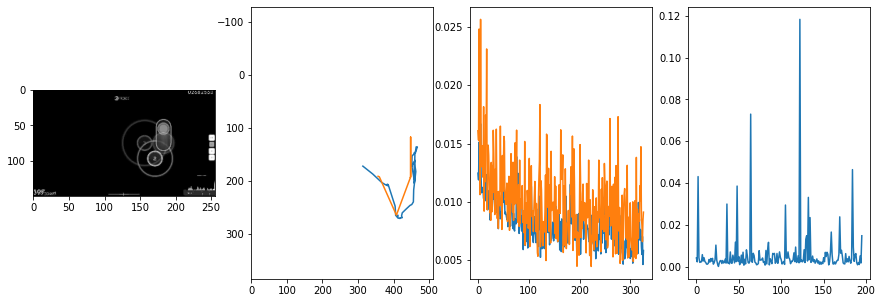


 333 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005903731411790988
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0016                                    
pred: 0.07592108100652695 0.6741557717323303
gt: 0.2695312798023224 0.90625
(89, 123)


<Figure size 1080x360 with 0 Axes>

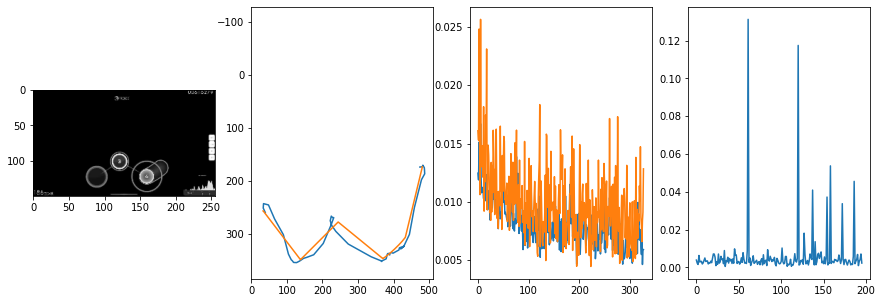


 334 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0037                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007863125280056586
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0045                                    
pred: 0.09481009095907211 0.49699997901916504
gt: 0.09375 0.6070833206176758
(62, 88)


<Figure size 1080x360 with 0 Axes>

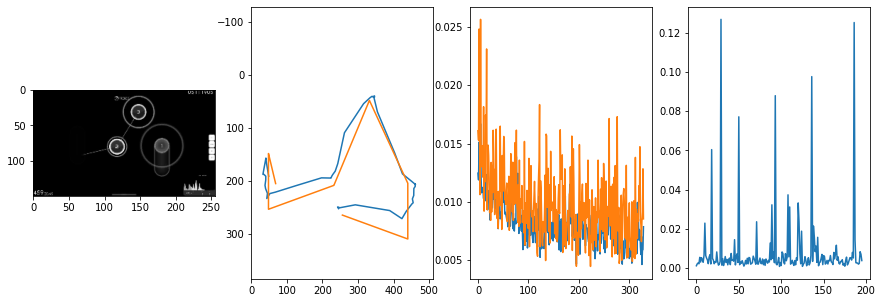


 335 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.0205                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005016504896790435
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0091                                    
pred: 0.580322802066803 0.4354154169559479
gt: 0.7032276391983032 0.0883110761642456
(157, 28)


<Figure size 1080x360 with 0 Axes>

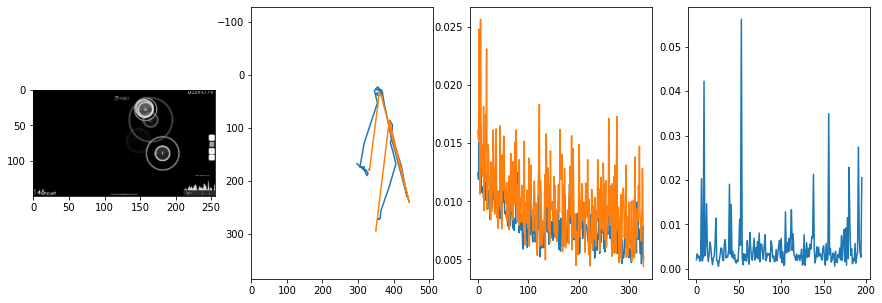


 336 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  0.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007273213344813819
outliers: 58
retrain: 4                 
val: 50/50 loss: 0.0008                                    
pred: 0.25857070088386536 0.6761219501495361
gt: 0.3906257450580597 0.6562513709068298
(108, 94)


<Figure size 1080x360 with 0 Axes>

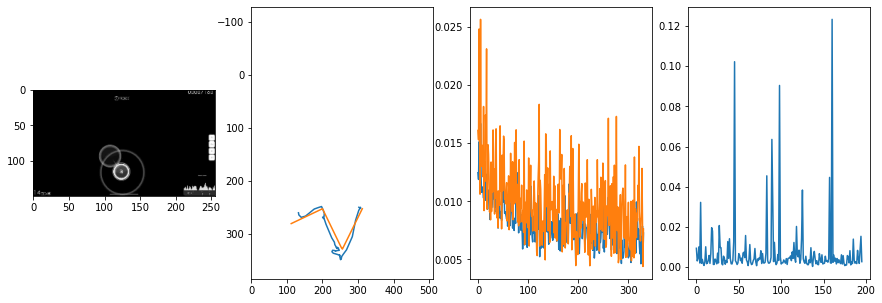


 337 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007116507785157205
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.0086                                    
pred: 0.36463069915771484 0.44239920377731323
gt: 0.1328125149011612 0.2916666567325592
(68, 51)


<Figure size 1080x360 with 0 Axes>

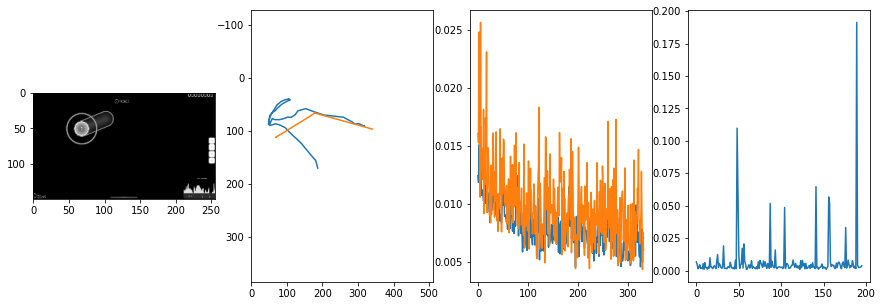


 338 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.60it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0057443026643322435
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.31725019216537476 0.14699377119541168
gt: 0.10225000232458115 0.36550000309944153
(63, 60)


<Figure size 1080x360 with 0 Axes>

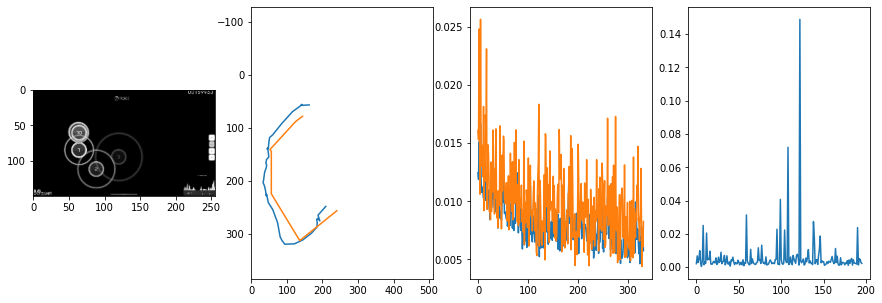


 339 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0049                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006266067324053884
outliers: 48
retrain: 4                 
val: 50/50 loss: 0.0021                                    
pred: 0.6095410585403442 0.6591100096702576
gt: 0.2583545446395874 0.46902552247047424
(88, 72)


<Figure size 1080x360 with 0 Axes>

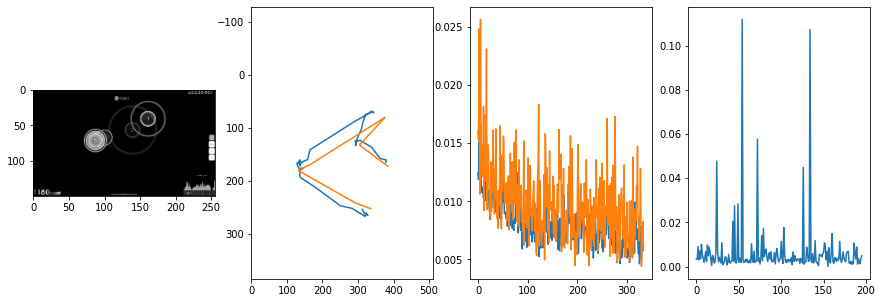


 340 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006184511584864112
outliers: 28
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.8467355966567993 0.6288303136825562
gt: 0.7949219346046448 0.8072914481163025
(171, 111)


<Figure size 1080x360 with 0 Axes>

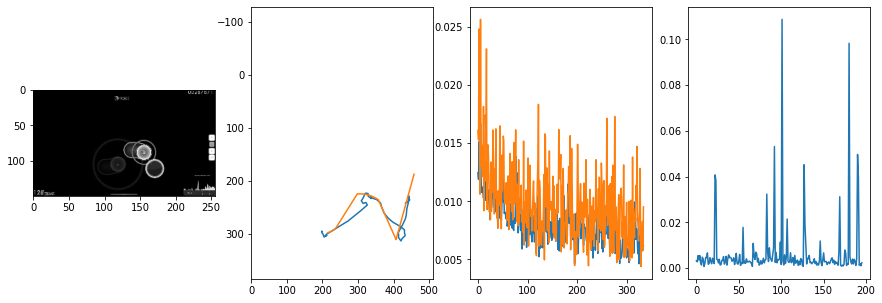


 341 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.10it/s  0.0054                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005403884056639592
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0266                                    
pred: 0.41666266322135925 0.3912404179573059
gt: 0.5000128149986267 0.5000132322311401
(125, 76)


<Figure size 1080x360 with 0 Axes>

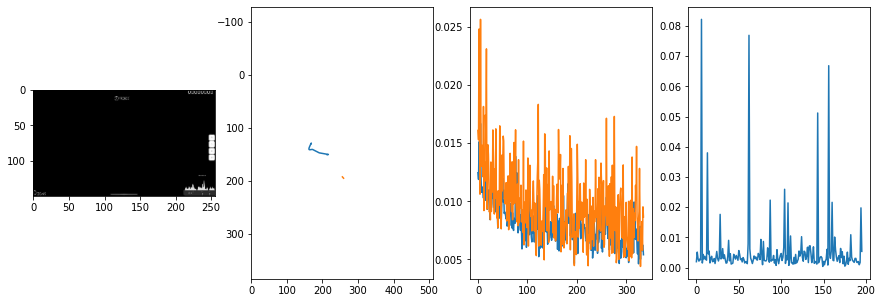


 342 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.27it/s  0.0027                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007576805370745762
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0069                                    
pred: 0.45186859369277954 0.48619046807289124
gt: 0.12528115510940552 0.6243751645088196
(67, 90)


<Figure size 1080x360 with 0 Axes>

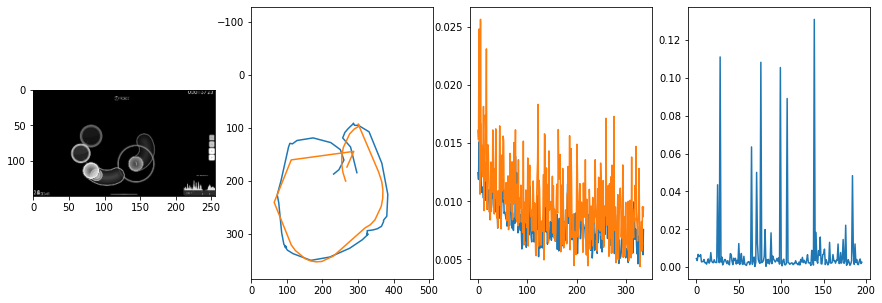


 343 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0020                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0070094999572742085
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.0040                                    
pred: 0.5079221129417419 0.8843979239463806
gt: 0.23506256937980652 0.6181042194366455
(84, 89)


<Figure size 1080x360 with 0 Axes>

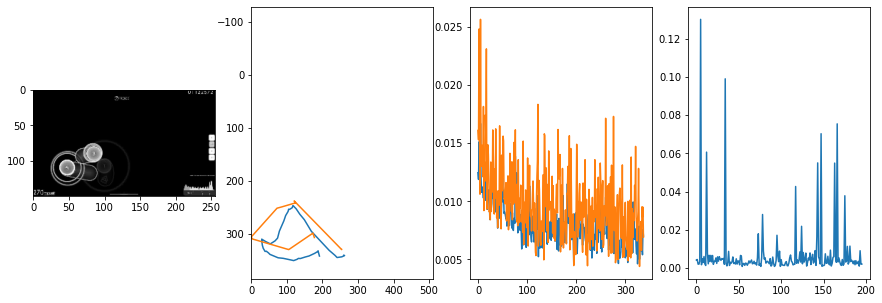


 344 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0149                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0051553209997685055
outliers: 19
retrain: 4                 
val: 50/50 loss: 0.0330                                    
pred: 0.6209935545921326 0.4669141173362732
gt: 0.5631870031356812 0.19844818115234375
(135, 41)


<Figure size 1080x360 with 0 Axes>

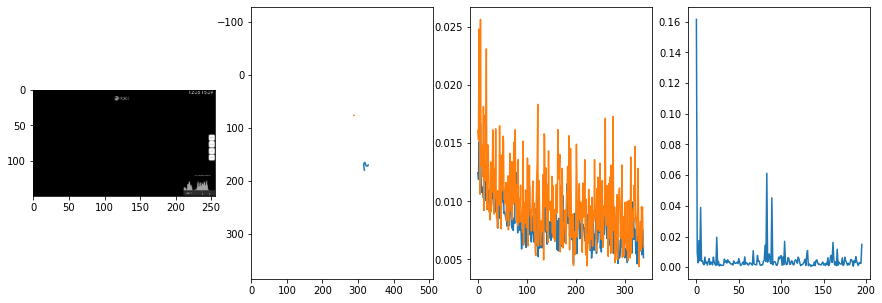


 345 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005444155632677412
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.0018                                    
pred: 0.8100737929344177 0.7956261038780212
gt: 0.8808590769767761 0.7135415077209473
(184, 100)


<Figure size 1080x360 with 0 Axes>

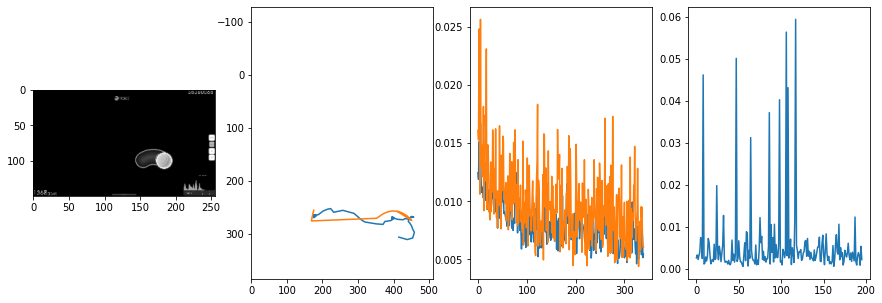


 346 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008144410973003762
outliers: 49
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.3775924742221832 0.2851007282733917
gt: 0.3800084590911865 0.3445020914077759
(106, 58)


<Figure size 1080x360 with 0 Axes>

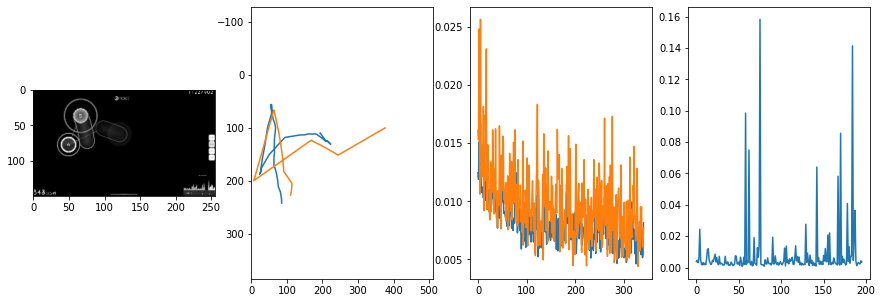


 347 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  0.0021                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0077063602057394895
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0032                                    
pred: 0.7669486999511719 0.6816884875297546
gt: 0.8794727325439453 0.7838461399078369
(184, 109)


<Figure size 1080x360 with 0 Axes>

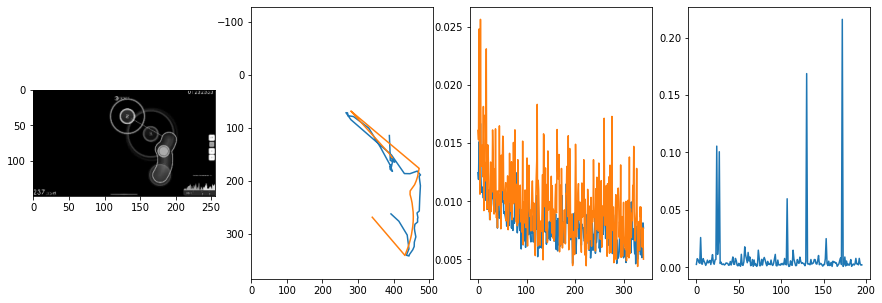


 348 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  0.0027                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004168833837736331
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0006                                    
pred: 0.4571326971054077 0.16731032729148865
gt: 0.5 0.08125000447034836
(125, 27)


<Figure size 1080x360 with 0 Axes>

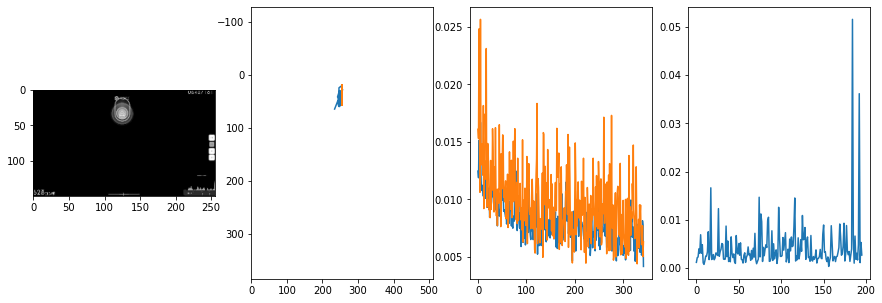


 349 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0029                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005511110789577325
outliers: 57
retrain: 4                 
val: 50/50 loss: 0.0062                                    
pred: 0.24210986495018005 0.2104341685771942
gt: 0.19861268997192383 0.33559978008270264
(78, 57)


<Figure size 1080x360 with 0 Axes>

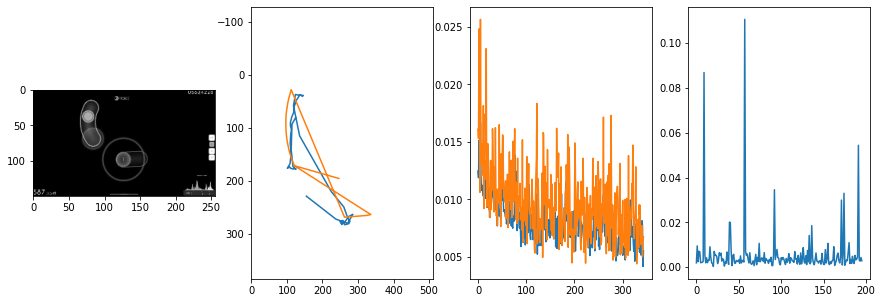


 350 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.0079                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.009361104906669684
outliers: 51
retrain: 4                 
val: 50/50 loss: 0.0024                                    
pred: 0.6709792613983154 0.5217365026473999
gt: 0.7406626343727112 0.44850805401802063
(162, 70)


<Figure size 1080x360 with 0 Axes>

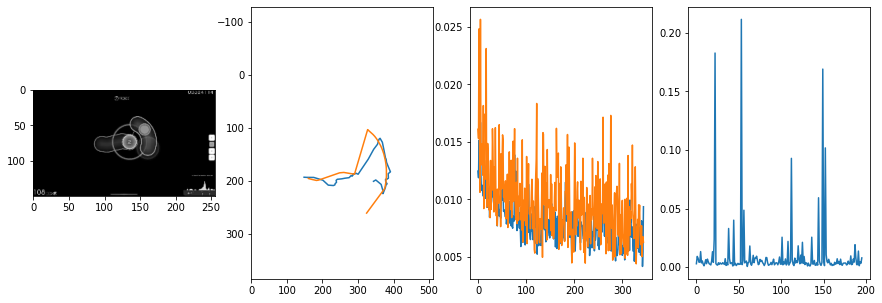


 351 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006456541521290593
outliers: 18
retrain: 4                 
val: 50/50 loss: 0.0074                                    
pred: 0.4555929899215698 0.9307752251625061
gt: 0.318359375 0.4505208432674408
(97, 70)


<Figure size 1080x360 with 0 Axes>

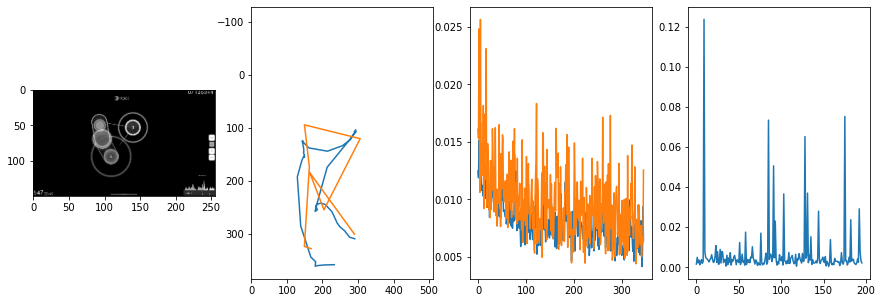


 352 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.22it/s  0.0424                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007268426910444277
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.2875708043575287 0.8900648951530457
gt: 0.3808421492576599 0.7159193158149719
(107, 101)


<Figure size 1080x360 with 0 Axes>

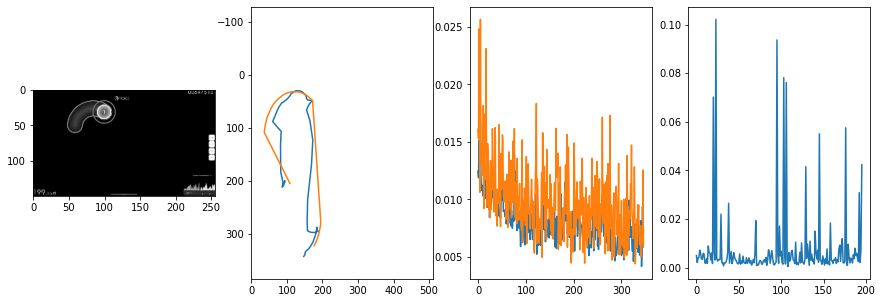


 353 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  0.0048                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00713913020578674
outliers: 21
retrain: 4                 
val: 50/50 loss: 0.0054                                    
pred: 0.0956801101565361 0.4610168933868408
gt: 0.109375 0.4513929784297943
(64, 70)


<Figure size 1080x360 with 0 Axes>

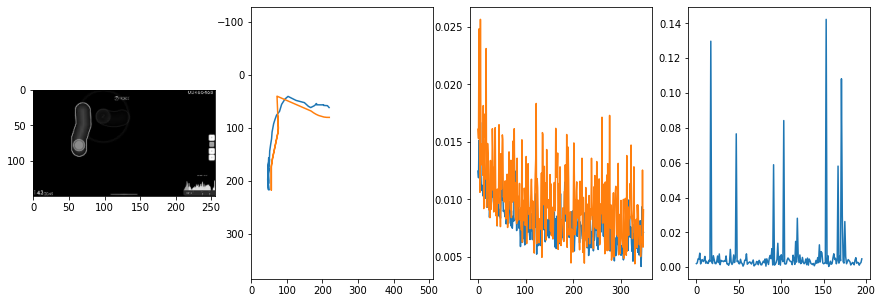


 354 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0095                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007022083253773138
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0051                                    
pred: 0.40667417645454407 0.8988743424415588
gt: 0.6837098598480225 0.8204360008239746
(154, 113)


<Figure size 1080x360 with 0 Axes>

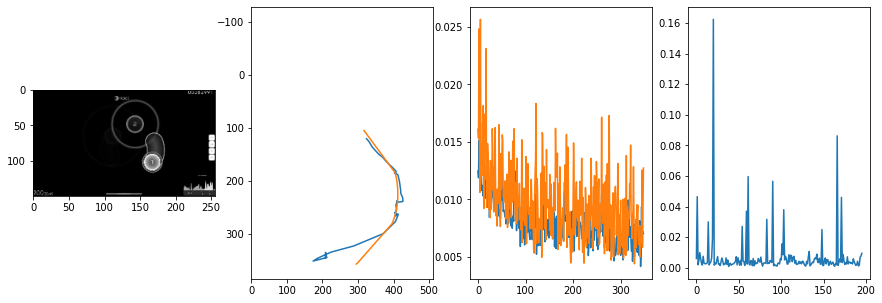


 355 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  0.0042                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005636535711439175
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0061                                    
pred: 0.13936951756477356 0.4848209023475647
gt: 0.5 0.2994791567325592
(125, 52)


<Figure size 1080x360 with 0 Axes>

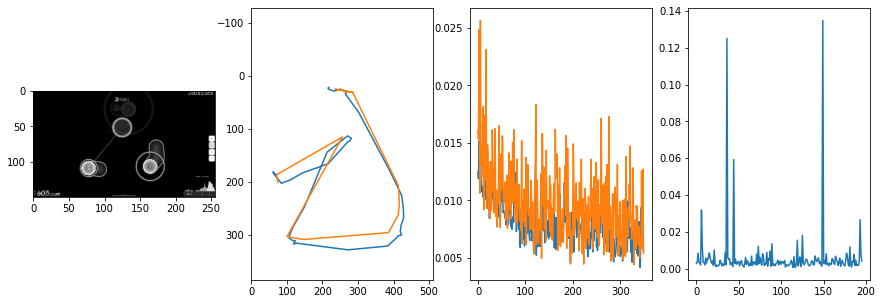


 356 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.30it/s  0.0037                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00599615008728246
outliers: 33
retrain: 4                 
val: 50/50 loss: 0.0032                                    
pred: 0.594720721244812 0.7401597499847412
gt: 0.7109430432319641 0.6041602492332458
(158, 88)


<Figure size 1080x360 with 0 Axes>

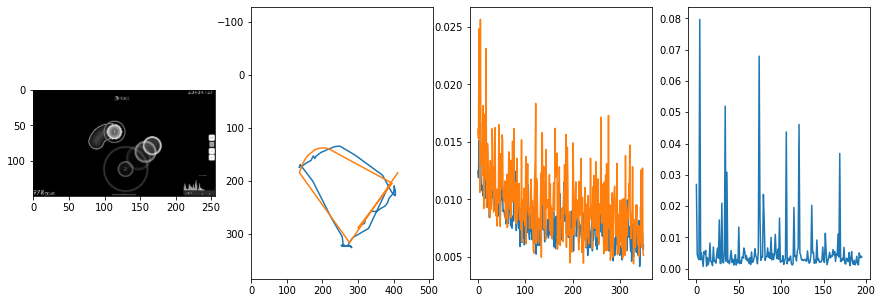


 357 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0013                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006629968951937353
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.8647215366363525 0.3686371445655823
gt: 0.9153228998184204 0.46166518330574036
(189, 71)


<Figure size 1080x360 with 0 Axes>

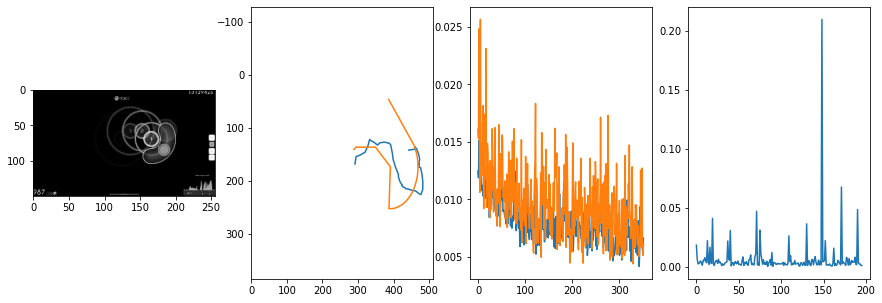


 358 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  0.0025                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006052225700173318
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0056                                    
pred: 0.8351580500602722 0.4895656704902649
gt: 0.686683714389801 0.5125385522842407
(154, 77)


<Figure size 1080x360 with 0 Axes>

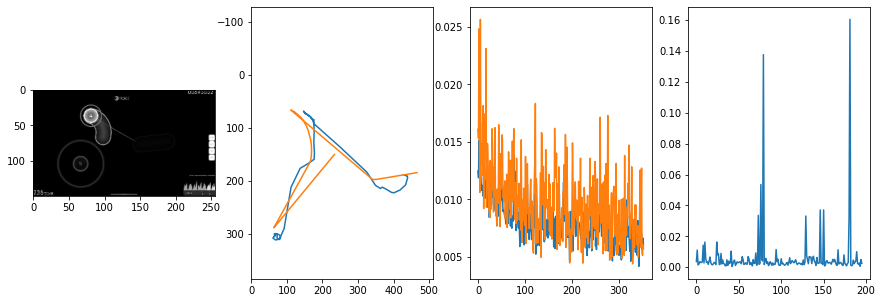


 359 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  0.0038                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006096975047530949
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.0087                                    
pred: 0.5850266218185425 0.45167163014411926
gt: 0.6657553315162659 0.6495934724807739
(151, 93)


<Figure size 1080x360 with 0 Axes>

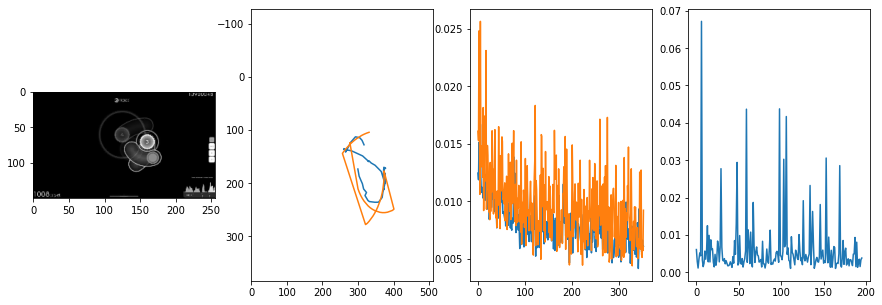


 360 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0067                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00738478143674521
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0053                                    
pred: 0.47092384099960327 0.16770659387111664
gt: 0.6194198131561279 0.14057108759880066
(144, 34)


<Figure size 1080x360 with 0 Axes>

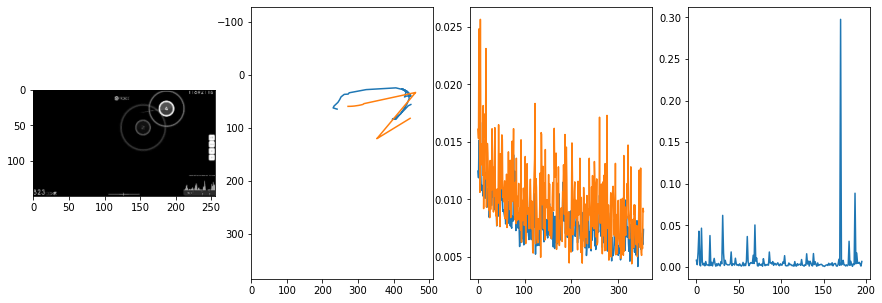


 361 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  0.0072                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005927865800319468
outliers: 21
retrain: 4                 
val: 50/50 loss: 0.0030                                    
pred: 0.6726123690605164 0.7492169141769409
gt: 0.6328125 0.7682291865348816
(146, 107)


<Figure size 1080x360 with 0 Axes>

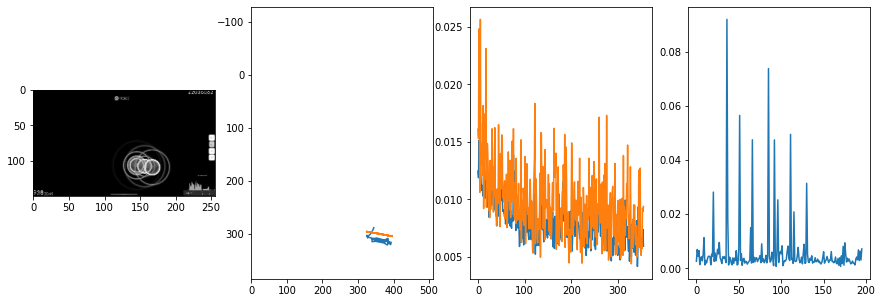


 362 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0014                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004874452885313967
outliers: 27
retrain: 4                 
val: 50/50 loss: 0.0026                                    
pred: 0.5451311469078064 0.3845570683479309
gt: 0.56640625 0.2708333432674408
(135, 49)


<Figure size 1080x360 with 0 Axes>

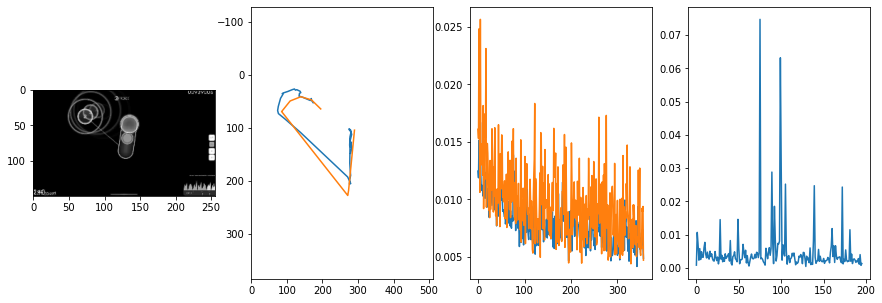


 363 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004351881727973018
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0029                                    
pred: 0.3847314715385437 0.9413654208183289
gt: 0.32486575841903687 0.9803342819213867
(98, 132)


<Figure size 1080x360 with 0 Axes>

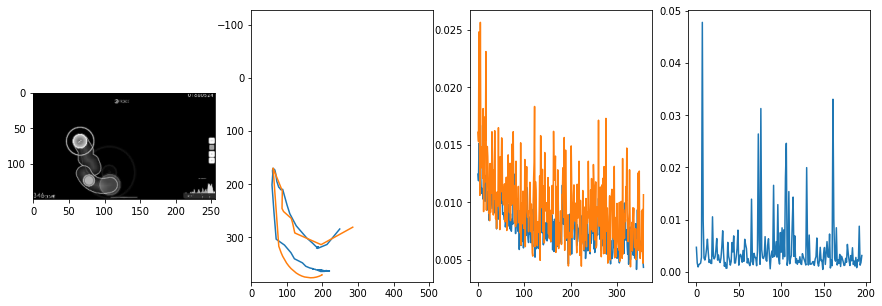


 364 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.58it/s  0.0036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004581009282947908
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.0036                                    
pred: 0.5133746266365051 0.5675110816955566
gt: 0.5307465195655823 0.6042841076850891
(130, 88)


<Figure size 1080x360 with 0 Axes>

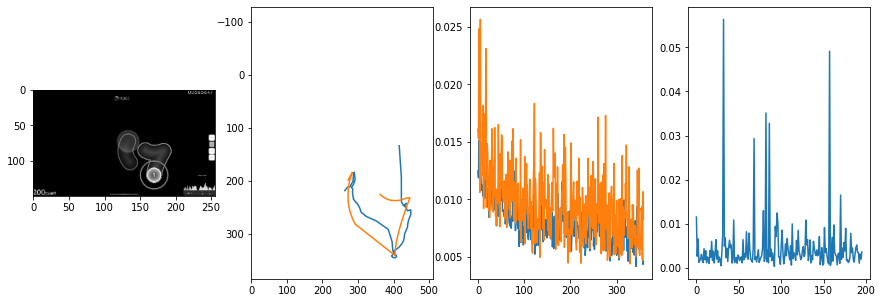


 365 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007096503951084296
outliers: 62
retrain: 4                 
val: 50/50 loss: 0.0018                                    
pred: 0.1604408174753189 0.6420247554779053
gt: 0.3125022351741791 0.6458333134651184
(96, 93)


<Figure size 1080x360 with 0 Axes>

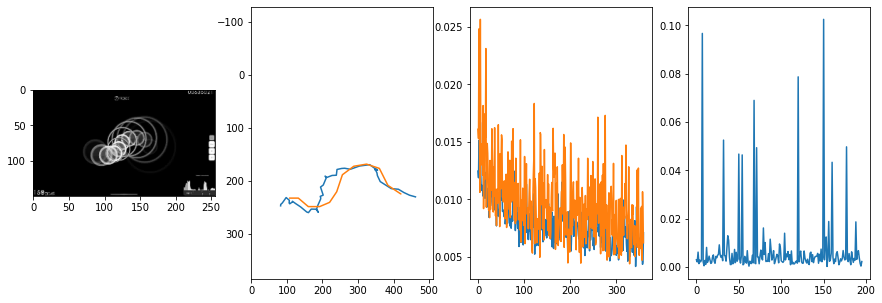


 366 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007094460587036245
outliers: 21
retrain: 4                 
val: 50/50 loss: 0.0031                                    
pred: 0.720579981803894 0.07885435223579407
gt: 0.7802793383598328 0.13755279779434204
(169, 33)


<Figure size 1080x360 with 0 Axes>

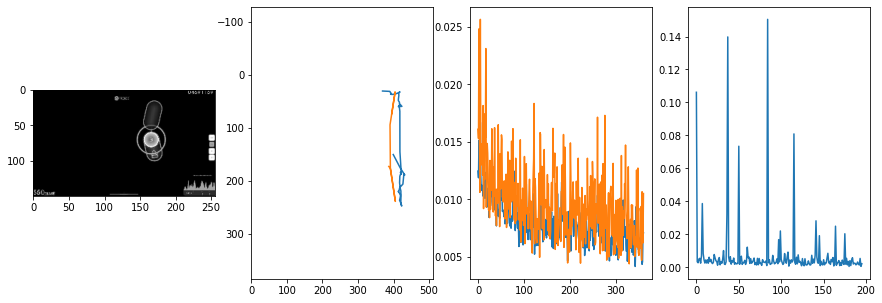


 367 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.24it/s  0.0023                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006918372985285027
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0054                                    
pred: 0.445304274559021 0.6541216373443604
gt: 0.7402343153953552 0.36718761920928955
(162, 60)


<Figure size 1080x360 with 0 Axes>

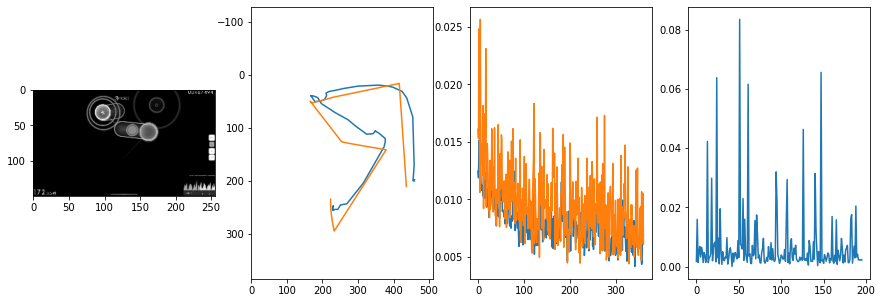


 368 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.17it/s  0.0035                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006899519500082682
outliers: 32
retrain: 4                 
val: 50/50 loss: 0.0020                                    
pred: 0.3899918496608734 0.33320292830467224
gt: 0.5068994760513306 0.4435480535030365
(126, 69)


<Figure size 1080x360 with 0 Axes>

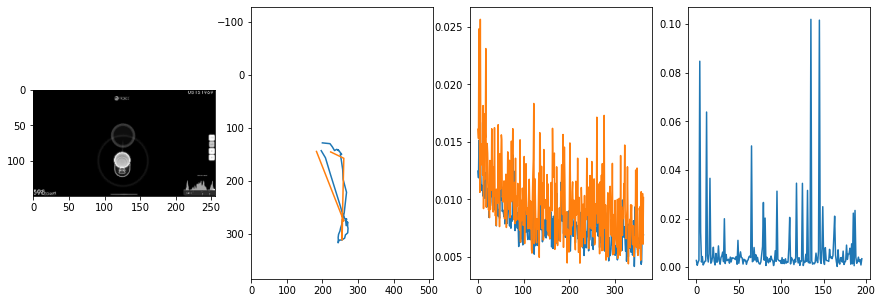


 369 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0029                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005788329584679652
outliers: 24
retrain: 4                 
val: 50/50 loss: 0.0025                                    
pred: 0.27208390831947327 0.05567960441112518
gt: 0.26096978783607483 0.07680120319128036
(88, 26)


<Figure size 1080x360 with 0 Axes>

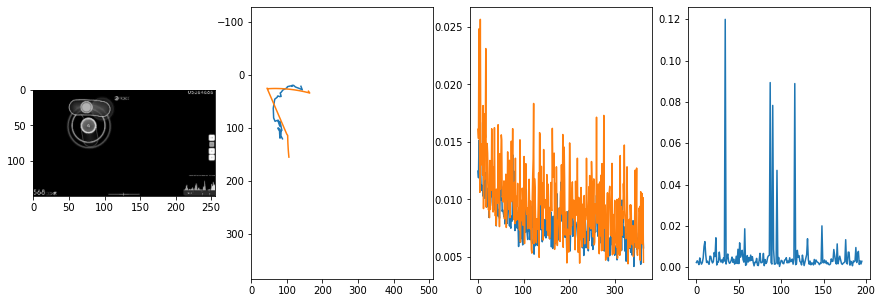


 370 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.25it/s  0.0013                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007699967964257741
outliers: 38
retrain: 4                 
val: 50/50 loss: 0.0057                                    
pred: 0.38106992840766907 0.1891355812549591
gt: 0.687076210975647 0.48586317896842957
(154, 74)


<Figure size 1080x360 with 0 Axes>

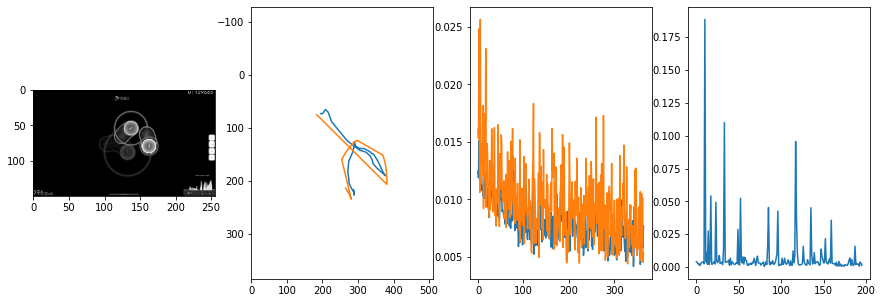


 371 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.33it/s  0.0029                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008178153885136435
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0067                                    
pred: 0.6984068155288696 0.13413485884666443
gt: 0.8351902961730957 0.14264331758022308
(177, 34)


<Figure size 1080x360 with 0 Axes>

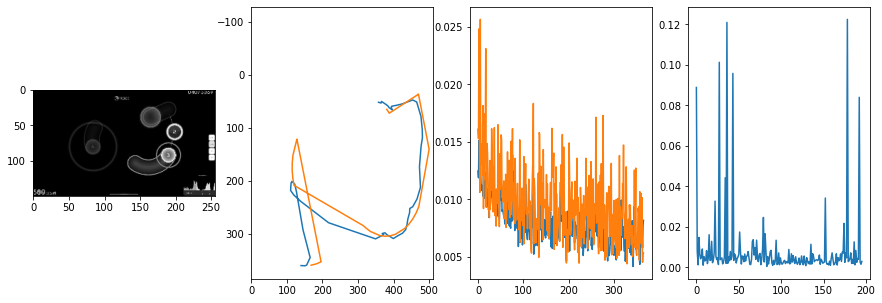


 372 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  0.0031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007438003554778668
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0061                                    
pred: 0.8161919116973877 0.5220862627029419
gt: 0.41422706842422485 0.786022961139679
(112, 109)


<Figure size 1080x360 with 0 Axes>

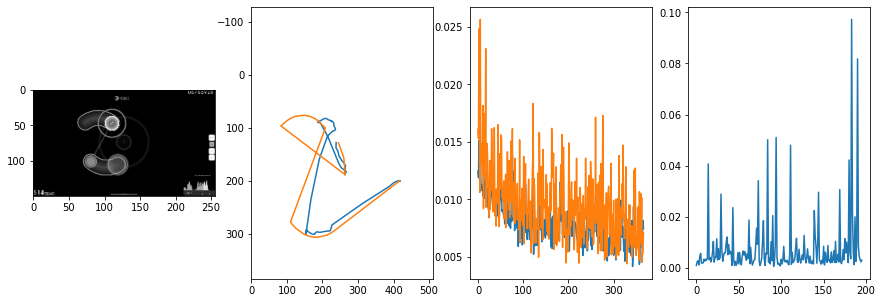


 373 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  0.0325                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005598204443008492
outliers: 22
retrain: 4                 
val: 50/50 loss: 0.0056                                    
pred: 0.5136807560920715 0.0790773406624794
gt: 0.49662095308303833 0.21513165533542633
(125, 43)


<Figure size 1080x360 with 0 Axes>

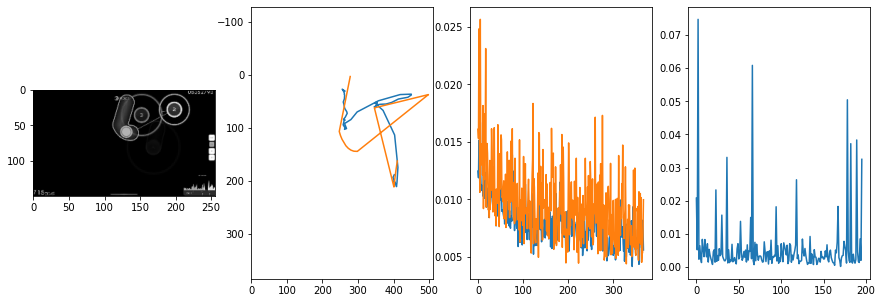


 374 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0015                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007183496401364896
outliers: 41
retrain: 4                 
val: 50/50 loss: 0.0050                                    
pred: 0.3897932171821594 0.43191951513290405
gt: 0.5 0.4999999701976776
(125, 76)


<Figure size 1080x360 with 0 Axes>

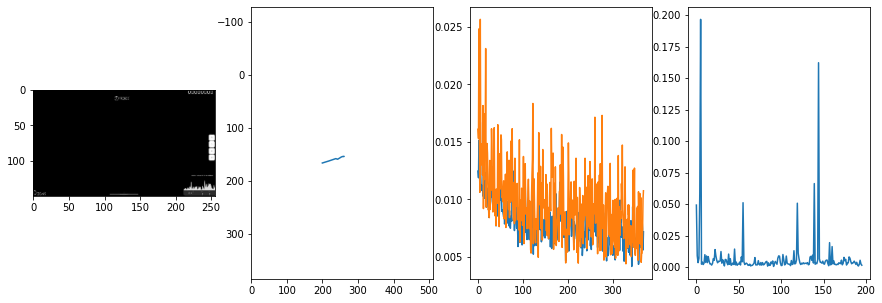


 375 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  0.0035                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.004973308361142551
outliers: 20
retrain: 4                 
val: 50/50 loss: 0.0082                                    
pred: 0.6138924360275269 0.7187198996543884
gt: 0.6660155057907104 0.9192690849304199
(151, 124)


<Figure size 1080x360 with 0 Axes>

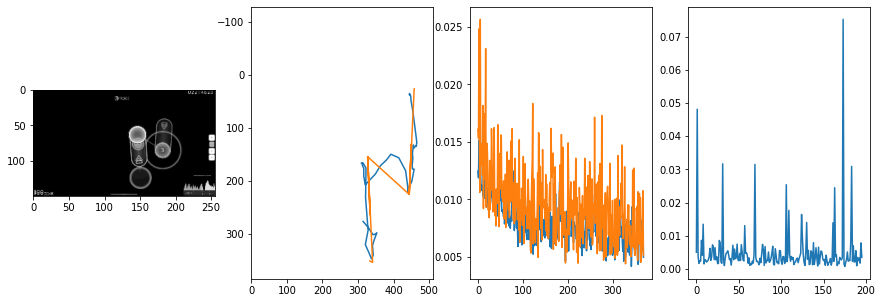


 376 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  0.0013                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0055184511774295595
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0067                                    
pred: 0.3710066080093384 0.35234469175338745
gt: 0.3535057008266449 0.4869835674762726
(102, 74)


<Figure size 1080x360 with 0 Axes>

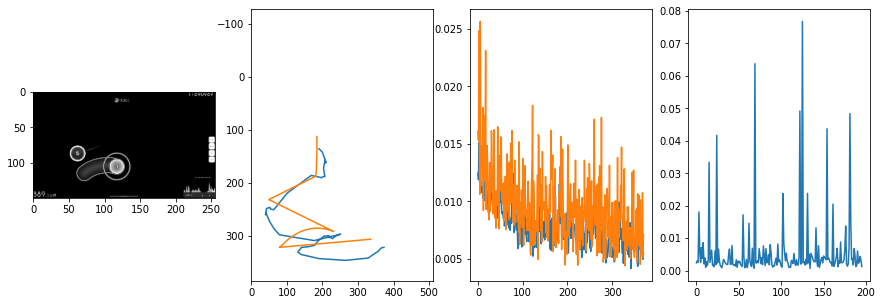


 377 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005320850353775907
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0098                                    
pred: 0.8410930037498474 0.27130961418151855
gt: 0.9537103176116943 0.38882145285606384
(195, 63)


<Figure size 1080x360 with 0 Axes>

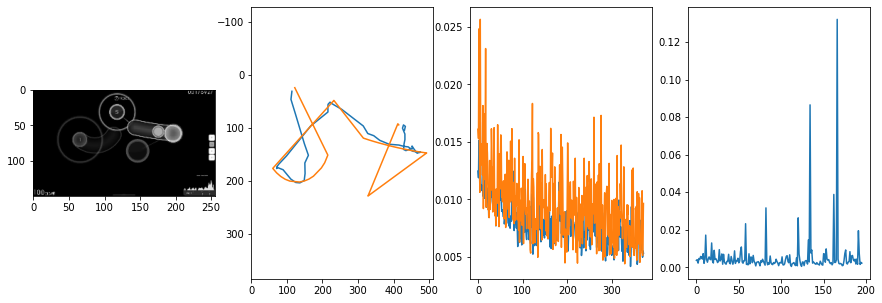


 378 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  0.0262                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.0050352062573846505
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0110                                    
pred: 0.3932246267795563 0.32604169845581055
gt: 0.4881879985332489 0.5068357586860657
(123, 76)


<Figure size 1080x360 with 0 Axes>

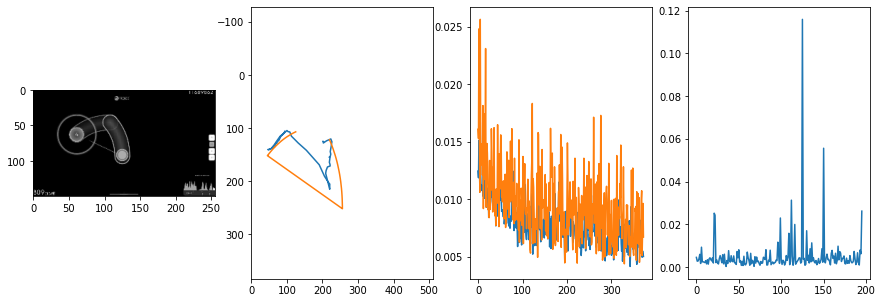


 379 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0078                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005753697979214069
outliers: 56
retrain: 4                 
val: 50/50 loss: 0.0245                                    
pred: 0.41005802154541016 0.4325159192085266
gt: 0.4403505027294159 0.6865012645721436
(116, 97)


<Figure size 1080x360 with 0 Axes>

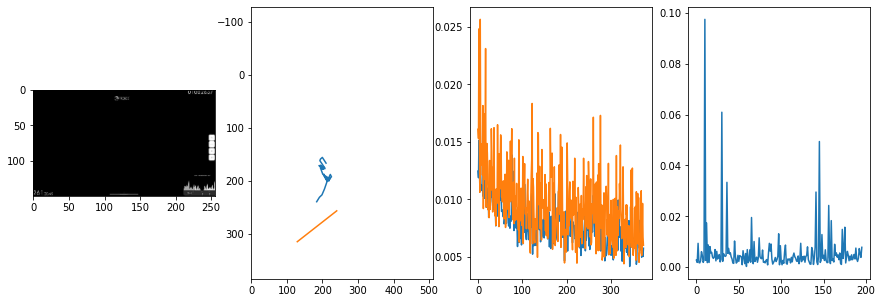


 380 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  0.0021                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00535091017415968
outliers: 37
retrain: 4                 
val: 50/50 loss: 0.0073                                    
pred: 0.6878759264945984 0.2632289528846741
gt: 0.6656421422958374 0.1744360327720642
(151, 38)


<Figure size 1080x360 with 0 Axes>

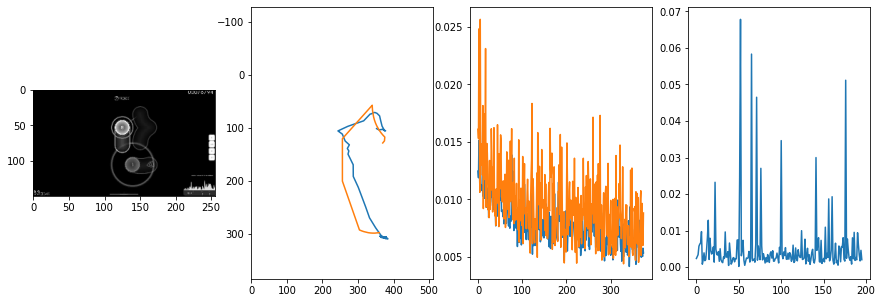


 381 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0033                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00614165222243767
outliers: 45
retrain: 4                 
val: 50/50 loss: 0.0012                                    
pred: 0.4460233747959137 0.4751266539096832
gt: 0.5000051259994507 0.49998965859413147
(125, 76)


<Figure size 1080x360 with 0 Axes>

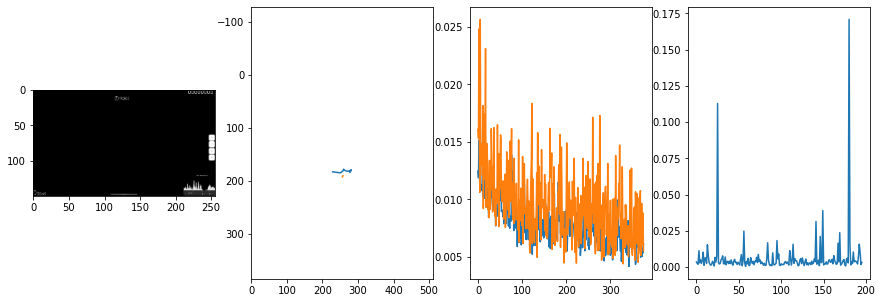


 382 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  0.0066                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007122184517876511
outliers: 40
retrain: 4                 
val: 50/50 loss: 0.0028                                    
pred: 0.6851587295532227 0.35128727555274963
gt: 0.359375 0.1666666865348816
(103, 37)


<Figure size 1080x360 with 0 Axes>

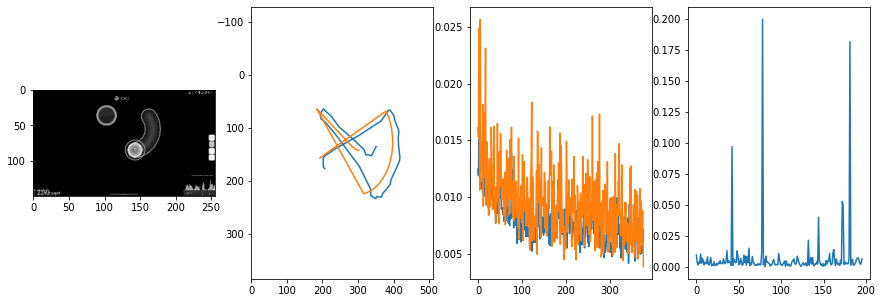


 383 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  0.0039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.00657083830328145
outliers: 25
retrain: 4                 
val: 50/50 loss: 0.0040                                    
pred: 0.7715577483177185 0.915721595287323
gt: 0.6947460770606995 0.9240128397941589
(155, 125)


<Figure size 1080x360 with 0 Axes>

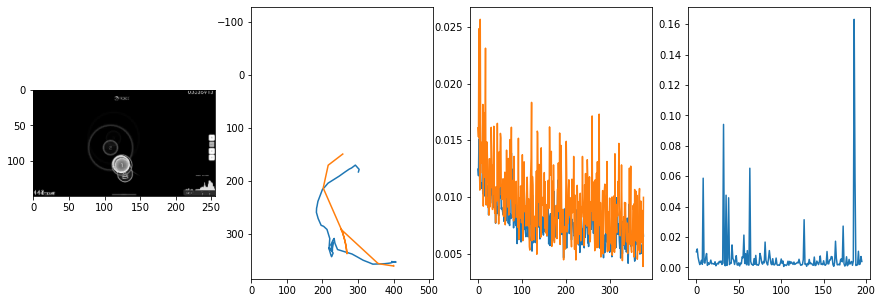


 384 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.0079                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006687658166569866
outliers: 36
retrain: 4                 
val: 50/50 loss: 0.0061                                    
pred: 0.560877799987793 0.4178861975669861
gt: 0.8437207341194153 0.5832454562187195
(178, 85)


<Figure size 1080x360 with 0 Axes>

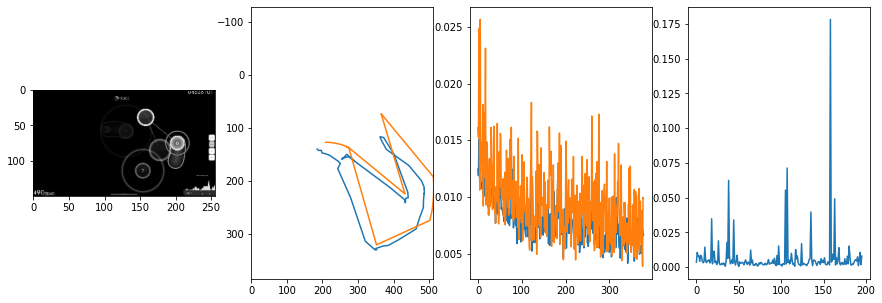


 385 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.15it/s  0.0033                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.006501138304438613
outliers: 23
retrain: 4                 
val: 50/50 loss: 0.0073                                    
pred: 0.5808752179145813 0.1932051032781601
gt: 0.5151180028915405 0.11558687686920166
(127, 31)


<Figure size 1080x360 with 0 Axes>

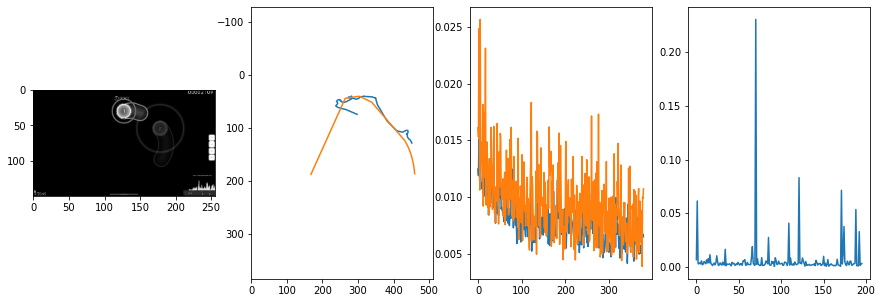


 386 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.07it/s  0.0373                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005266400016677965
outliers: 29
retrain: 4                 
val: 50/50 loss: 0.0035                                    
pred: 0.4451109766960144 0.3252301514148712
gt: 0.19969649612903595 0.326498806476593
(78, 55)


<Figure size 1080x360 with 0 Axes>

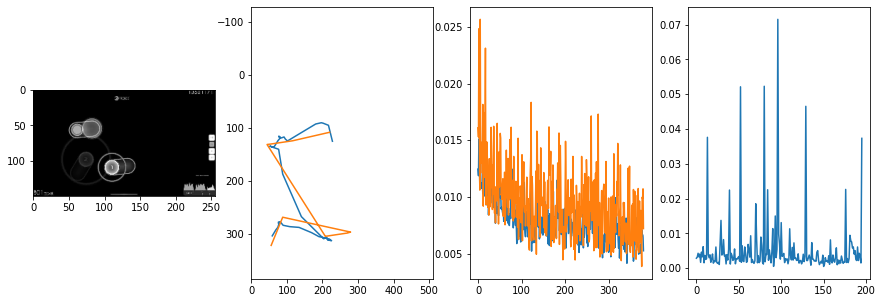


 387 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  0.0142                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.005092022811405346
outliers: 43
retrain: 4                 
val: 50/50 loss: 0.0026                                    
pred: 0.12281444668769836 0.4721188247203827
gt: 0.2601151466369629 0.37518465518951416
(88, 61)


<Figure size 1080x360 with 0 Axes>

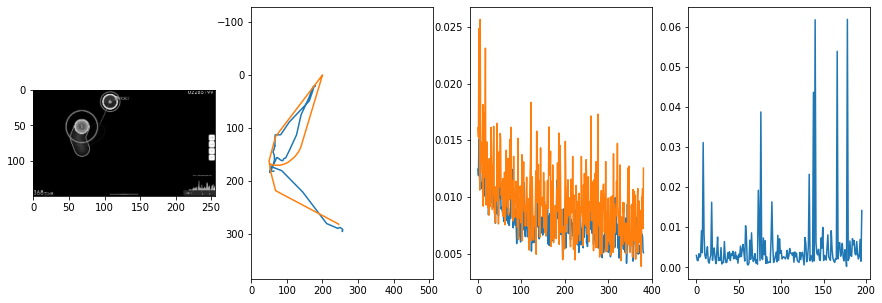


 388 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  0.0034                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.007947347199363748
outliers: 46
retrain: 4                 
val: 50/50 loss: 0.0082                                    
pred: 0.43069276213645935 0.6993007063865662
gt: 0.18752047419548035 0.6640672087669373
(77, 95)


<Figure size 1080x360 with 0 Axes>

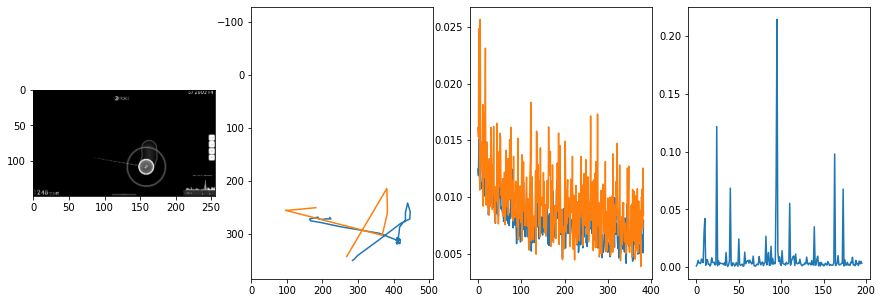


 389 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.19it/s  0.0022                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 0.008555481218517881
outliers: 34
retrain: 4                 
val: 50/50 loss: 0.0015                                    
pred: 0.5894319415092468 0.8391338586807251
gt: 0.7197667360305786 0.8268082737922668
(159, 114)


<Figure size 1080x360 with 0 Axes>

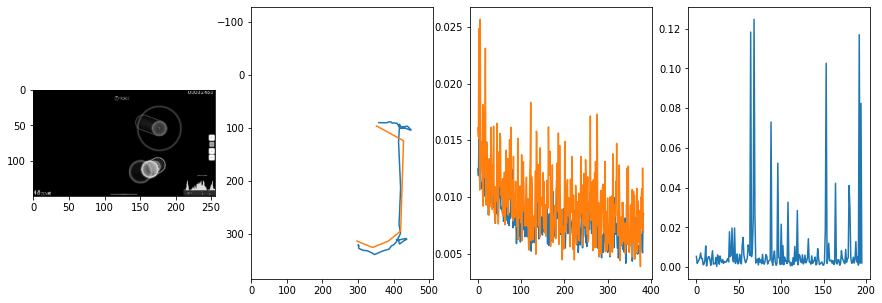


 390 of 390
2445.8464472293854 secs


In [62]:
start = time.time()

epochs = 128
loss_thresh = 0.0003
rnum_min = 4
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [64]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

0.003886806999798864


# Test Model

In [47]:
import os
import cv2
import torch
import torchvision.transforms as transforms

In [65]:
vn.load_state_dict(torch.load(model_path + str(390) + '.pt'))

<All keys matched successfully>

In [78]:
#osud = '../ex/beatmaps/567301 LamazeP - Spam Jack'
#osuf = 'LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu'
#osud = '../ex/beatmaps/252981 DJ Okawari - Flower Dance (Short Ver)'
#osuf = 'DJ Okawari - Flower Dance (Short Ver.) (-Hanayuki-) [Relax].osu'
#osud = '../ex/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku'
#osuf = 'sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-\'s Hard].osu'
#osud = '../demo/beatmaps/835194 Mili - Vulnerability'
#osuf = 'Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu'
osud = '../demo/beatmaps/653534 Panda Eyes - ILY'
osuf = 'Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu'
#osud = '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun'
#osuf = 'Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu'

In [79]:
osr = OSR(osud, osuf, sample_rate=sample_rate, hop_size=hop_size, hidden=True, vtmp='../demo/vids/')

In [80]:
osr.queue_vid()

'../demo/vids/Panda Eyes - ILY (M a r v o l l o) [Light Insane].osuhdn.avi'

In [81]:
video_path = os.path.join('../demo/vids/', osuf + '.avi')

In [82]:
vn.to(device)
vn.init_hidden(1)
vn.eval()

VN(
  (convB1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPB1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (convC1): Conv2d(4, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPC1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (lstmA): LSTM(19456, 256, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=256, out_features=256, bias=True)
  (normA): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
  (linearB): Linear(in_features=256, out_features=32, bias=True)
  (normB): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
  (linearC): Linear(in_features=32, out_features=2, bias=True)
)

In [83]:
start = time.time()

transform = transforms.ToTensor()
frames = []
vc = cv2.VideoCapture(video_path)
p = []
while True:
    r, f = vc.read()
    if r is False:
        break
    f = cv2.resize(f, (0,0), fx=scale, fy=scale)
    f = cv2.cvtColor(f, cv2.COLOR_BGR2GRAY)
    F = transform(f).to(device)
    with torch.no_grad():
        P = vn(F.unsqueeze(0).unsqueeze(0))
    p.append(P.squeeze(0).squeeze(0).cpu().detach().numpy())
    
end = time.time()
print(end - start, 'secs')

8.738163709640503 secs


In [84]:
np.save('predVN.npy', p)

# Create Replay Video

In [85]:
from IPython.display import Video

In [86]:
eosud = osud.replace('/', '\/')

In [87]:
!sed -i "s/Beatmap path.*/Beatmap path\": \"$eosud\/$osuf\",/" data.json
!sed -i "s/Output path.*/Output path\": \"videoVN.mp4\",/" data.json

In [88]:
!python create_replayVN.py predVN.npy 50

2022-04-12 21:02:35,577:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-12 21:02:35,577:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/653534 Panda Eyes - ILY/Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'videoVN.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f62e3ebc3d0>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb': [200, 214, 229], 'Alpha':

In [89]:
Video("videoVN.mp4")

In [84]:
!sed -i "s/Output path.*/Output path\": \"video.mp4\",/" data.json

In [85]:
!python create_replay.py predHN.npy predVN.npy 50 0.5

2022-04-09 22:00:10,213:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-09 22:00:10,213:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/653534 Panda Eyes - ILY/Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'video.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f721b89b640>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb': [200, 214, 229], 'Alpha': 0

In [70]:
Video("video.mp4")